___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___

<h1 style="text-align: center;">Deep Learning<br><br>Assignment-1 (ANN)<br><br>Churn Prediction for Bank Customer<br><h1>

# Dataset Info

We have a dataset in which there are details of a bank's customers and the target variable is a binary variable reflecting the fact whether the customer left the bank (closed his account) or he continues to be a customer.

The features in the given dataset are:
- **rownumber:** Row Numbers from 1 to 10000.
- **customerid:** A unique ID that identifies each customer.
- **surname:** The customer’s surname.
- **creditscore:** A credit score is a number between 300–850 that depicts a consumer's creditworthiness.
- **geography:** The country from which the customer belongs to.
- **Gender:** The customer’s gender: Male, Female
- **Age:** The customer’s current age, in years, at the time of being customer.
- **tenure:** The number of years for which the customer has been with the bank.
- **balance:** Bank balance of the customer.
- **numofproducts:** the number of bank products the customer is utilising.
- **hascrcard:** The number of credit cards given to the customer by the bank.
- **isactivemember:** Binary Flag for indicating if the client is active or not with the bank before the moment where the client exits the company (recorded in the variable "exited")
- **exited:** Binary flag 1 if the customer closed account with bank and 0 if the customer is retained.

# Improt Libraries & Data

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

plt.rcParams["figure.figsize"] = (10,6)

sns.set_style("whitegrid")
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# Set it None to display all rows in the dataframe
# pd.set_option('display.max_rows', None)

# Set it to None to display all columns in the dataframe
pd.set_option('display.max_columns', None)

In [2]:
df= pd.read_csv("Churn_Modelling.csv",index_col='RowNumber')
df.head()

,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
RowNumber,,,,,,,,,,,,,
1,15634602,Hargrave,619,France,Female,42,2,0.000,1,1,1,101348.880,1
2,15647311,Hill,608,Spain,Female,41,1,83807.860,1,0,1,112542.580,0
3,15619304,Onio,502,France,Female,42,8,159660.800,3,1,0,113931.570,1
4,15701354,Boni,699,France,Female,39,1,0.000,2,0,0,93826.630,0
5,15737888,Mitchell,850,Spain,Female,43,2,125510.820,1,1,1,79084.100,0


# Exploratory Data Analysis and Visualization

1. Implement basic steps to see how is your data looks like
2. Check for missing values
3. Drop the features that not suitable for modelling
4. Implement basic visualization steps such as histogram, countplot, heatmap
5. Convert categorical variables to dummy variables

In [3]:
df.shape

(10000, 13)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10000 entries, 1 to 10000
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   CustomerId       10000 non-null  int64  
 1   Surname          10000 non-null  object 
 2   CreditScore      10000 non-null  int64  
 3   Geography        10000 non-null  object 
 4   Gender           10000 non-null  object 
 5   Age              10000 non-null  int64  
 6   Tenure           10000 non-null  int64  
 7   Balance          10000 non-null  float64
 8   NumOfProducts    10000 non-null  int64  
 9   HasCrCard        10000 non-null  int64  
 10  IsActiveMember   10000 non-null  int64  
 11  EstimatedSalary  10000 non-null  float64
 12  Exited           10000 non-null  int64  
dtypes: float64(2), int64(8), object(3)
memory usage: 1.1+ MB


In [5]:
df.isnull().sum().any() #null deger var mi

False

In [6]:
df.duplicated().sum()#duplicate var mi 

0

In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
CustomerId,10000.000,15690940.569,71936.186,15565701.000,15628528.250,15690738.000,15753233.750,15815690.000
CreditScore,10000.000,650.529,96.653,350.000,584.000,652.000,718.000,850.000
Age,10000.000,38.922,10.488,18.000,32.000,37.000,44.000,92.000
Tenure,10000.000,5.013,2.892,0.000,3.000,5.000,7.000,10.000
Balance,10000.000,76485.889,62397.405,0.000,0.000,97198.540,127644.240,250898.090
NumOfProducts,10000.000,1.530,0.582,1.000,1.000,1.000,2.000,4.000
HasCrCard,10000.000,0.706,0.456,0.000,0.000,1.000,1.000,1.000
IsActiveMember,10000.000,0.515,0.500,0.000,0.000,1.000,1.000,1.000
EstimatedSalary,10000.000,100090.240,57510.493,11.580,51002.110,100193.915,149388.247,199992.480
Exited,10000.000,0.204,0.403,0.000,0.000,0.000,0.000,1.000


In [8]:
df.drop(['CustomerId','Surname'],axis=1, inplace=True)#bizim hedefimiz customer larin bank acount lari 
## acik mi kapatilmis mi ? O yuzden id ler ve surname ler isimize yaramaz. drop edilmeli

0    7963
1    2037
Name: Exited, dtype: int64


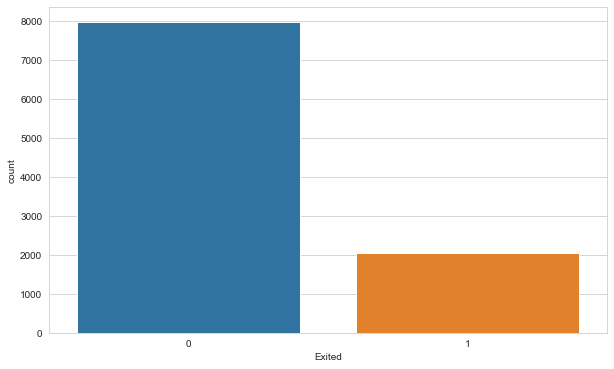

In [9]:
print(df.Exited.value_counts())
sns.countplot(df["Exited"]);   #label imizin datalarina bakalim . balance mi unbalance mi. 
##exited: Binary flag 1 if the customer closed account with bank and 0 if the customer is retained.

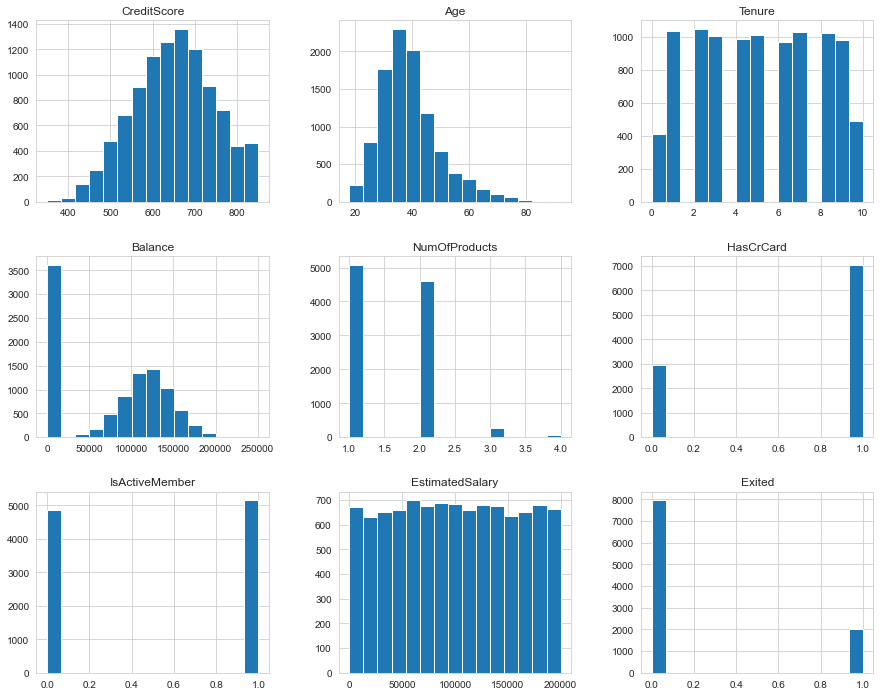

In [10]:
df.hist(figsize=(15, 12), bins=15); # tum datanin hist bakalim

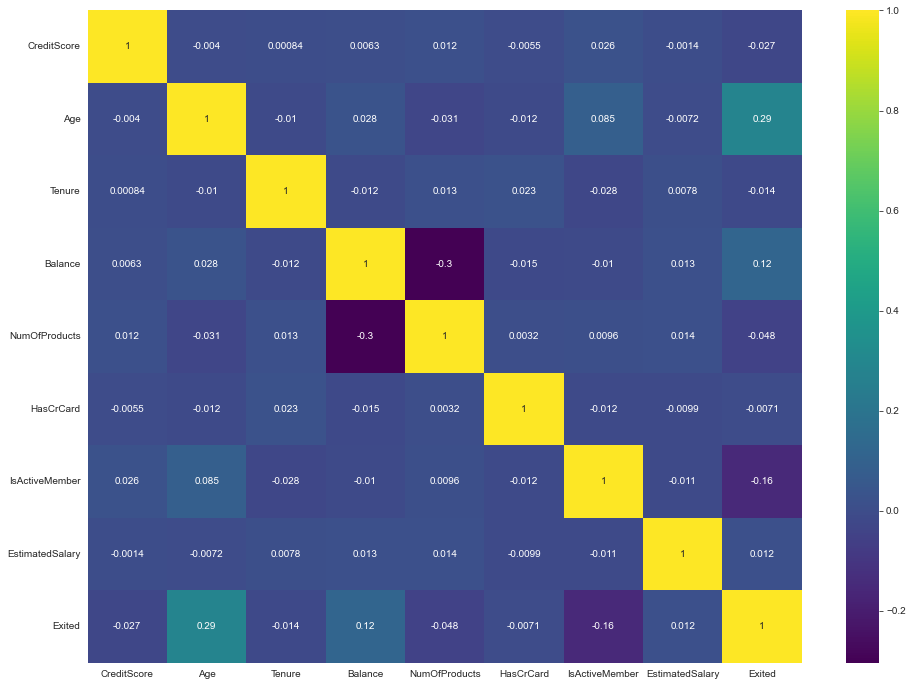

In [11]:
plt.figure(figsize=(16, 12))
sns.heatmap(df.corr(), annot=True, cmap='viridis');

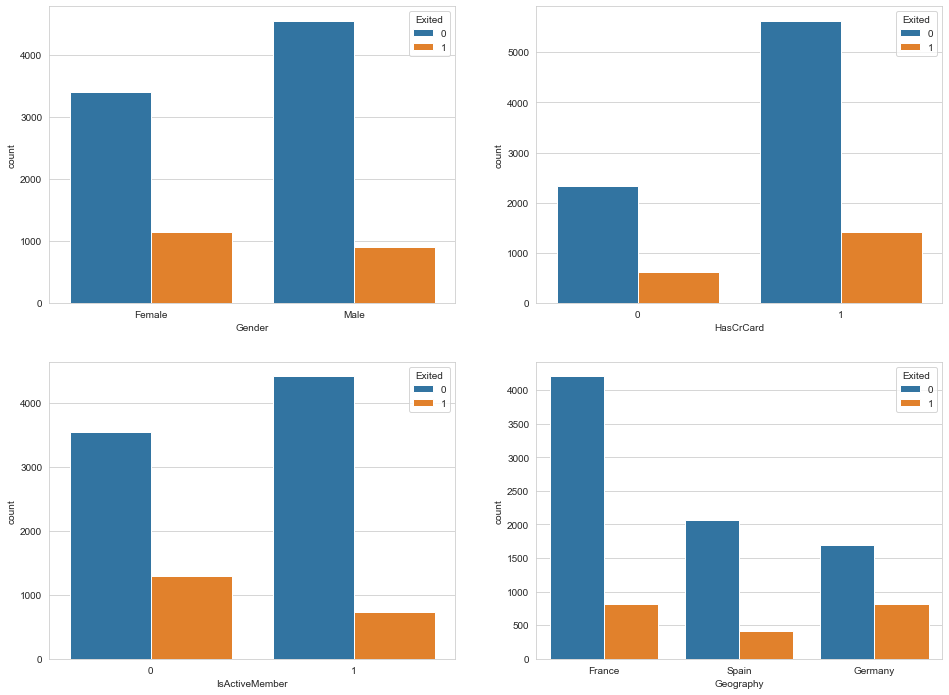

In [12]:
#categorik verilerin label ile olan iliskisi
catgrc_list = ["Gender", "HasCrCard", "IsActiveMember", "Geography"]
index = 0
plt.figure(figsize=(16, 12))
for i in catgrc_list:
    index += 1
    plt.subplot(2, 2, index)
    sns.countplot(data=df, x=i, hue="Exited")

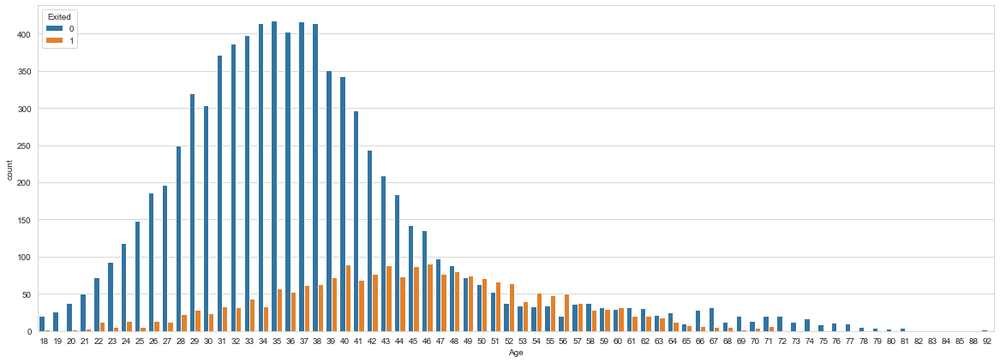

In [13]:
plt.figure(figsize=(20, 7))
sns.countplot(df.Age, hue=df.Exited);

In [14]:
##Convert categorical variables to dummy variables
df = pd.get_dummies(df, drop_first=True)#drop_first get dummies deki ilk columnu dusurur. islem yukunu azaltmak icin
df.head(3)

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Geography_Germany,Geography_Spain,Gender_Male
RowNumber,,,,,,,,,,,,
1,619,42,2,0.000,1,1,1,101348.880,1,0,0,0
2,608,41,1,83807.860,1,0,1,112542.580,0,0,1,0
3,502,42,8,159660.800,3,1,0,113931.570,1,0,0,0


# Preprocessing of Data
- Train | Test Split, Scalling

In [15]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

In [16]:
X = df.drop('Exited', axis=1)
y = df['Exited'].values
seed = 42
X_train, X_test, y_train, y_test = train_test_split(X,
                                                    y,
                                                    stratify=y,
                                                    test_size=0.1,
                                                    random_state=seed)  

In [17]:
scaler = MinMaxScaler()

In [18]:
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Modelling & Model Performance

## without class_weigth

### Create The Model

In [19]:
pip install tensorflow

Note: you may need to restart the kernel to use updated packages.


In [20]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation

In [21]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

In [22]:
def eval_metric(actual, pred):
    mae = mean_absolute_error(actual, pred)
    mse = mean_squared_error(actual, pred)
    rmse = np.sqrt(mean_squared_error(actual, pred))
    score = r2_score(actual, pred)
    return print("r2_score:", score, "\nmae:", mae, "\nmse:", mse, "\nrmse:", rmse)

In [23]:
X_train.shape

(9000, 11)

In [24]:
from tensorflow.keras.optimizers import Adam

In [25]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(16, activation="relu", input_dim = X_train.shape[1]))
model.add(Dense(12, activation="relu"))
model.add(Dense(8, activation="relu"))
model.add(Dense(4, activation="relu"))
model.add(Dense(1, activation="sigmoid"))

opt = Adam(lr=0.001)
model.compile(optimizer=opt, 
              loss="binary_crossentropy",
              metrics=["Recall"])
# Recall — the percentage of positive cases you caught
# Recall, false negative’in gözardı edilemez olduğu durumlarda önemli bir metrik. recall = TP / TP +FN
# Recall’a bakma sebebimiz tamamiyle paydadaki false negative’ler, yani hesabına devam ettiği tahmin edilen ve hesabını kapatan insanlar. 

2022-06-20 17:01:24.922349: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [26]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import roc_auc_score, roc_curve, precision_recall_curve, average_precision_score
from sklearn.model_selection import cross_val_score, cross_validate
from sklearn.model_selection import GridSearchCV

In [27]:
##overfitting engellemek icin early_stop kullanilir.
early_stop = EarlyStopping(monitor="val_loss",
                           mode="auto",
                           verbose=1,
                           patience=15)
#The patience is often set somewhere between 10 and 100 (10 or 20 is more common), 
#but it really depends on your dataset and network.

In [28]:
model.fit(x = X_train, y = y_train, validation_split = 0.10, batch_size = 128, epochs =300 )
# validation split = datamin 0.10 ini validation icin ayir. datamizin sonundan alir. kalan 0.90 
#kisim i shuffle edilecek. daha sonra 230 lik batch lere boluyo.

Epoch 1/300
64/64 [==============================] - 1s 4ms/step - loss: 0.6507 - recall: 0.1326 - val_loss: 0.5632 - val_recall: 0.0000e+00
Epoch 2/300
64/64 [==============================] - 0s 1ms/step - loss: 0.5263 - recall: 0.0000e+00 - val_loss: 0.5017 - val_recall: 0.0000e+00
Epoch 3/300
64/64 [==============================] - 0s 1ms/step - loss: 0.5018 - recall: 0.0000e+00 - val_loss: 0.4870 - val_recall: 0.0000e+00
Epoch 4/300
64/64 [==============================] - 0s 1000us/step - loss: 0.4902 - recall: 0.0000e+00 - val_loss: 0.4760 - val_recall: 0.0000e+00
Epoch 5/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4811 - recall: 0.0000e+00 - val_loss: 0.4661 - val_recall: 0.0000e+00
Epoch 6/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4731 - recall: 0.0000e+00 - val_loss: 0.4575 - val_recall: 0.0000e+00
Epoch 7/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4661 - recall: 0.0000e+00 - val_loss: 0.4472 - val_recal

64/64 [==============================] - 0s 1ms/step - loss: 0.3407 - recall: 0.4637 - val_loss: 0.2957 - val_recall: 0.5414
Epoch 61/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3414 - recall: 0.4534 - val_loss: 0.2958 - val_recall: 0.5414
Epoch 62/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3408 - recall: 0.4667 - val_loss: 0.2980 - val_recall: 0.5691
Epoch 63/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3397 - recall: 0.4607 - val_loss: 0.2962 - val_recall: 0.5801
Epoch 64/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3410 - recall: 0.4637 - val_loss: 0.2997 - val_recall: 0.6188
Epoch 65/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3393 - recall: 0.4522 - val_loss: 0.2946 - val_recall: 0.5138
Epoch 66/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3405 - recall: 0.4631 - val_loss: 0.3069 - val_recall: 0.5856
Epoch 67/300
64/64 [===========================

64/64 [==============================] - 0s 1ms/step - loss: 0.3309 - recall: 0.4685 - val_loss: 0.2989 - val_recall: 0.5470
Epoch 120/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3309 - recall: 0.4776 - val_loss: 0.2960 - val_recall: 0.5193
Epoch 121/300
64/64 [==============================] - 0s 995us/step - loss: 0.3307 - recall: 0.4746 - val_loss: 0.3001 - val_recall: 0.5746
Epoch 122/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3329 - recall: 0.4770 - val_loss: 0.2949 - val_recall: 0.4972
Epoch 123/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3309 - recall: 0.4691 - val_loss: 0.3031 - val_recall: 0.5138
Epoch 124/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3298 - recall: 0.4746 - val_loss: 0.2989 - val_recall: 0.5193
Epoch 125/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3316 - recall: 0.4843 - val_loss: 0.2953 - val_recall: 0.5138
Epoch 126/300
64/64 [==================

Epoch 178/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3283 - recall: 0.4873 - val_loss: 0.3049 - val_recall: 0.6188
Epoch 179/300
64/64 [==============================] - 0s 990us/step - loss: 0.3274 - recall: 0.4770 - val_loss: 0.2942 - val_recall: 0.4917
Epoch 180/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3269 - recall: 0.4824 - val_loss: 0.2978 - val_recall: 0.5746
Epoch 181/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3260 - recall: 0.4740 - val_loss: 0.3011 - val_recall: 0.5359
Epoch 182/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3272 - recall: 0.4909 - val_loss: 0.2942 - val_recall: 0.5083
Epoch 183/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3264 - recall: 0.4861 - val_loss: 0.2949 - val_recall: 0.5249
Epoch 184/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3263 - recall: 0.4752 - val_loss: 0.2949 - val_recall: 0.5635
Epoch 185/300
64/64 [====

Epoch 237/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3238 - recall: 0.4849 - val_loss: 0.2982 - val_recall: 0.5028
Epoch 238/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3254 - recall: 0.4818 - val_loss: 0.2925 - val_recall: 0.5691
Epoch 239/300
64/64 [==============================] - 0s 979us/step - loss: 0.3235 - recall: 0.4855 - val_loss: 0.3058 - val_recall: 0.5249
Epoch 240/300
64/64 [==============================] - 0s 976us/step - loss: 0.3244 - recall: 0.4897 - val_loss: 0.2965 - val_recall: 0.5083
Epoch 241/300
64/64 [==============================] - 0s 991us/step - loss: 0.3244 - recall: 0.4831 - val_loss: 0.2978 - val_recall: 0.5304
Epoch 242/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3250 - recall: 0.4861 - val_loss: 0.2988 - val_recall: 0.4807
Epoch 243/300
64/64 [==============================] - 0s 951us/step - loss: 0.3256 - recall: 0.4746 - val_loss: 0.3009 - val_recall: 0.6022
Epoch 244/300
64/64

64/64 [==============================] - 0s 1ms/step - loss: 0.3249 - recall: 0.4849 - val_loss: 0.3001 - val_recall: 0.5746
Epoch 296/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3246 - recall: 0.4873 - val_loss: 0.2943 - val_recall: 0.5580
Epoch 297/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3233 - recall: 0.4764 - val_loss: 0.2983 - val_recall: 0.5359
Epoch 298/300
64/64 [==============================] - 0s 995us/step - loss: 0.3218 - recall: 0.4794 - val_loss: 0.2972 - val_recall: 0.5193
Epoch 299/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3227 - recall: 0.4897 - val_loss: 0.2960 - val_recall: 0.5193
Epoch 300/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3225 - recall: 0.4831 - val_loss: 0.2976 - val_recall: 0.5304


In [29]:
model.weights

[<tf.Variable 'dense/kernel:0' shape=(11, 16) dtype=float32, numpy=
 array([[ 0.20023389,  0.14258969,  0.04529977, -0.52523905, -0.2405081 ,
          0.31194916,  0.11467834,  0.1543149 ,  0.01756272,  0.03252655,
          0.06864852,  0.23411705, -0.02052106,  0.05445544,  0.19605526,
          0.48691154],
        [-0.47894928,  0.45254827, -0.20163444, -0.43017232,  0.06992333,
         -0.64335525, -1.3867222 , -0.65953743,  0.09085176, -0.11906916,
         -0.42734197, -0.90181315,  0.49503833,  0.11277096,  0.8686393 ,
         -0.52052426],
        [ 0.3502583 ,  0.04548844, -0.12726387,  0.14516404,  0.39800337,
          0.253335  , -0.00881647,  0.03796672, -0.4392914 , -0.02438596,
          0.12465763, -0.30536008,  0.3267725 ,  0.26604882,  0.11347169,
         -0.1337129 ],
        [ 0.21741636, -0.05797713, -0.23269837, -0.00301718,  0.3692875 ,
          0.07847936,  0.01949359,  0.20745496, -1.2068264 , -0.92596895,
         -0.19265272, -0.13302597, -0.38163564, -

In [30]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 16)                192       
                                                                 
 dense_1 (Dense)             (None, 12)                204       
                                                                 
 dense_2 (Dense)             (None, 8)                 104       
                                                                 
 dense_3 (Dense)             (None, 4)                 36        
                                                                 
 dense_4 (Dense)             (None, 1)                 5         
                                                                 
Total params: 541
Trainable params: 541
Non-trainable params: 0
_________________________________________________________________


In [31]:
pd.DataFrame(model.history.history)

,loss,recall,val_loss,val_recall
0,0.651,0.133,0.563,0.000
1,0.526,0.000,0.502,0.000
2,0.502,0.000,0.487,0.000
3,0.490,0.000,0.476,0.000
4,0.481,0.000,0.466,0.000
...,...,...,...,...
295,0.325,0.487,0.294,0.558
296,0.323,0.476,0.298,0.536
297,0.322,0.479,0.297,0.519
298,0.323,0.490,0.296,0.519


### Evaluate The Model

- Plot the model history to observe the changing of metrics
- Make prediction to see "confusion matrix" and "classification report"
- Check ROC (Receiver Operating Curve) and AUC (Area Under Curve) for the model

<AxesSubplot:>

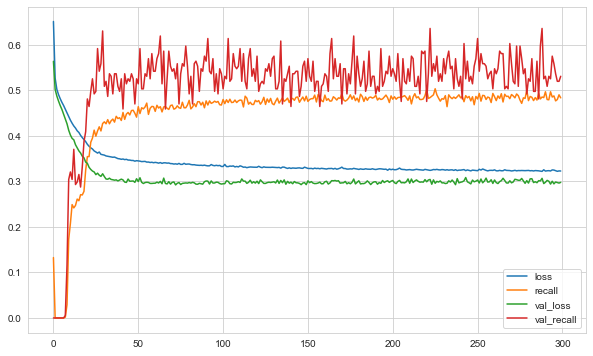

In [32]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot()

In [33]:
model.evaluate(X_test, y_test, verbose=0)

[0.34678471088409424, 0.45588234066963196]

In [34]:

y_pred = (model.predict(X_test) > 0.5).astype("int32")
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

32/32 [==============================] - 0s 527us/step
[[758  38]
 [111  93]]
              precision    recall  f1-score   support

           0       0.87      0.95      0.91       796
           1       0.71      0.46      0.56       204

    accuracy                           0.85      1000
   macro avg       0.79      0.70      0.73      1000
weighted avg       0.84      0.85      0.84      1000



# ROC (Receiver Operating Curve) and AUC (Area Under Curve) for model

32/32 [==============================] - 0s 555us/step


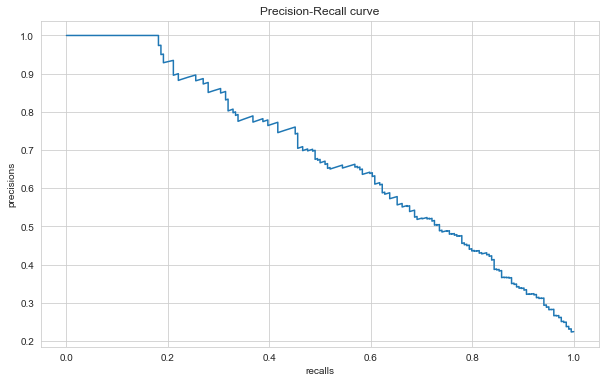

In [35]:
y_pred_proba = model.predict(X_test)
precisions, recalls, thresholds = precision_recall_curve(y_test, y_pred_proba)
plt.plot(recalls, precisions, label='ANN')
plt.xlabel('recalls')
plt.ylabel('precisions')
plt.title('Precision-Recall curve')
plt.show()
# roc curve, sınıflandırma performansını gösterir

In [36]:
average_precision_score(y_test, y_pred_proba)

0.6800278702432183

## with class_weigth

Investigate how the "class_weight" hyper-parameter is used in a Neural Network.

### Create The Model

In [37]:
model = Sequential()

tf.random.set_seed(seed)

model.add(Dense(16, activation="relu"))
model.add(Dense(12, activation="relu"))
model.add(Dense(8, activation="relu"))
model.add(Dense(4, activation="relu"))
model.add(Dense(1, activation="sigmoid"))

opt = Adam(lr=0.001)
model.compile(optimizer=opt, 
              loss="binary_crossentropy",
              metrics=["Recall"])

In [38]:
from sklearn.utils import class_weight

class_weights = class_weight.compute_class_weight('balanced',
                                                  classes=np.unique(y_train),
                                                  y=y_train)

class_weights = {0: class_weights[0], 1: class_weights[1]}
class_weights

{0: 0.6278777731268314, 1: 2.454991816693944}

In [39]:
model.fit(x=X_train,
          y=y_train,
          validation_split=.10,
          batch_size=128,
          epochs=300,
          verbose=1,
          callbacks=[early_stop],
          class_weight=class_weights)

Epoch 1/300
64/64 [==============================] - 1s 3ms/step - loss: 0.6982 - recall: 0.6314 - val_loss: 0.6989 - val_recall: 0.5967
Epoch 2/300
64/64 [==============================] - 0s 1ms/step - loss: 0.6883 - recall: 0.6404 - val_loss: 0.7083 - val_recall: 0.6796
Epoch 3/300
64/64 [==============================] - 0s 1ms/step - loss: 0.6804 - recall: 0.6580 - val_loss: 0.7009 - val_recall: 0.5691
Epoch 4/300
64/64 [==============================] - 0s 1ms/step - loss: 0.6698 - recall: 0.6616 - val_loss: 0.6918 - val_recall: 0.5801
Epoch 5/300
64/64 [==============================] - 0s 1ms/step - loss: 0.6575 - recall: 0.6628 - val_loss: 0.6966 - val_recall: 0.6796
Epoch 6/300
64/64 [==============================] - 0s 1ms/step - loss: 0.6451 - recall: 0.6889 - val_loss: 0.6580 - val_recall: 0.6022
Epoch 7/300
64/64 [==============================] - 0s 1ms/step - loss: 0.6336 - recall: 0.6743 - val_loss: 0.6604 - val_recall: 0.7238
Epoch 8/300
64/64 [======================

64/64 [==============================] - 0s 1ms/step - loss: 0.4722 - recall: 0.7500 - val_loss: 0.4382 - val_recall: 0.8122
Epoch 61/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4725 - recall: 0.7518 - val_loss: 0.4317 - val_recall: 0.8177
Epoch 62/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4712 - recall: 0.7518 - val_loss: 0.4751 - val_recall: 0.8564
Epoch 63/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4710 - recall: 0.7524 - val_loss: 0.4354 - val_recall: 0.8122
Epoch 64/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4725 - recall: 0.7512 - val_loss: 0.4594 - val_recall: 0.8564
Epoch 65/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4698 - recall: 0.7536 - val_loss: 0.4069 - val_recall: 0.8011
Epoch 66/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4716 - recall: 0.7561 - val_loss: 0.4871 - val_recall: 0.8619
Epoch 67/300
64/64 [===========================

In [40]:
model.weights

[<tf.Variable 'dense_5/kernel:0' shape=(11, 16) dtype=float32, numpy=
 array([[ 8.47512409e-02, -6.26880825e-02,  1.35796480e-02,
         -3.30049247e-01, -2.22224399e-01,  1.31941468e-01,
          3.08542073e-01,  4.09611732e-01, -9.68255848e-03,
         -1.79671407e-01,  6.86652586e-02,  2.69731909e-01,
         -2.00071812e-01, -8.40454102e-02,  1.96239173e-01,
          4.20034647e-01],
        [-4.41817135e-01,  1.07539473e-02,  5.39197028e-01,
         -2.42229149e-01,  2.00396493e-01,  5.22301972e-01,
         -1.09794348e-01,  2.92268425e-01,  1.00347662e+00,
         -8.00203860e-01,  3.28745306e-01,  2.51413852e-01,
          4.30020839e-01, -7.87798688e-02,  4.97626066e-01,
         -7.72309661e-01],
        [ 4.16027874e-01,  1.34036811e-02,  2.08956841e-02,
         -7.02207536e-03,  2.41276518e-01,  3.23293239e-01,
         -1.65787846e-01,  2.66125768e-01, -3.56822424e-02,
          2.84501612e-01,  2.47159734e-01, -3.40725988e-01,
          3.00240844e-01, -5.2422907

In [41]:
pd.DataFrame(model.history.history)

,loss,recall,val_loss,val_recall
0,0.698,0.631,0.699,0.597
1,0.688,0.640,0.708,0.680
2,0.680,0.658,0.701,0.569
3,0.670,0.662,0.692,0.580
4,0.657,0.663,0.697,0.680
...,...,...,...,...
63,0.473,0.751,0.459,0.856
64,0.470,0.754,0.407,0.801
65,0.472,0.756,0.487,0.862
66,0.472,0.758,0.412,0.807


### Evaluate The Model

- Plot the model history to observe the changing of metrics
- Make prediction to see "confusion matrix" and "classification report"
- Check ROC (Receiver Operating Curve) and AUC (Area Under Curve) for the model

<AxesSubplot:>

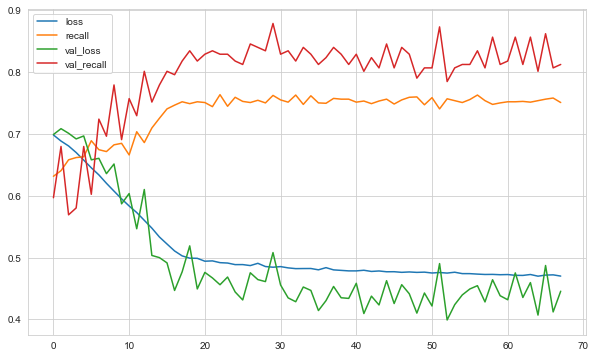

In [42]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot()

In [43]:
y_pred = (model.predict(X_test) > 0.5).astype("int32")
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

32/32 [==============================] - 0s 553us/step
[[602 194]
 [ 57 147]]
              precision    recall  f1-score   support

           0       0.91      0.76      0.83       796
           1       0.43      0.72      0.54       204

    accuracy                           0.75      1000
   macro avg       0.67      0.74      0.68      1000
weighted avg       0.82      0.75      0.77      1000



32/32 [==============================] - 0s 518us/step


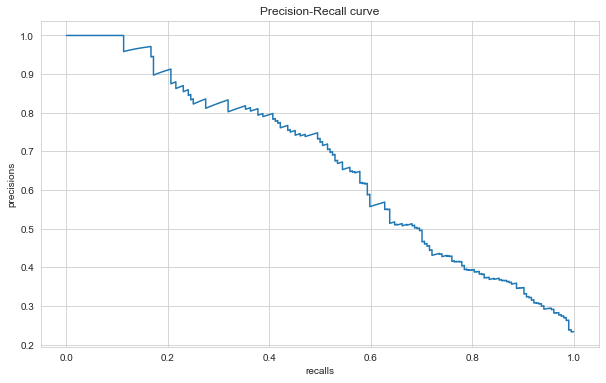

In [44]:
y_pred_proba = model.predict(X_test)
precisions, recalls, thresholds = precision_recall_curve(y_test, y_pred_proba)
plt.plot(recalls, precisions, label='ANN')
plt.xlabel('recalls')
plt.ylabel('precisions')
plt.title('Precision-Recall curve')
plt.show()
# roc curve, sınıflandırma performansını gösterir

## Implementation Different Methods to Develop The Model

- Implement the following methods on model creating with "class_weight" parameter
- Create and evaluate model for each method 

### Increase The Learning Rate and Observe The Results

In [45]:
from tensorflow.keras.optimizers import Adam

In [46]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(16, activation = 'relu', input_dim = X_train.shape[1]))
model.add(Dense(12, activation = 'relu'))
model.add(Dense(8, activation = 'relu'))
model.add(Dense(4, activation = 'relu'))
model.add(Dense(1,activation='sigmoid'))

opt = Adam(lr = 0.001) # default learning rate value is 0.001
model.compile(optimizer = opt, loss = 'binary_crossentropy',metrics=["Recall"])

In [47]:
model.fit(x = X_train, y = y_train, validation_split = 0.10, batch_size = 128, epochs = 300)

Epoch 1/300
64/64 [==============================] - 1s 3ms/step - loss: 0.6507 - recall: 0.1326 - val_loss: 0.5632 - val_recall: 0.0000e+00
Epoch 2/300
64/64 [==============================] - 0s 1ms/step - loss: 0.5263 - recall: 0.0000e+00 - val_loss: 0.5017 - val_recall: 0.0000e+00
Epoch 3/300
64/64 [==============================] - 0s 1ms/step - loss: 0.5018 - recall: 0.0000e+00 - val_loss: 0.4870 - val_recall: 0.0000e+00
Epoch 4/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4902 - recall: 0.0000e+00 - val_loss: 0.4760 - val_recall: 0.0000e+00
Epoch 5/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4811 - recall: 0.0000e+00 - val_loss: 0.4661 - val_recall: 0.0000e+00
Epoch 6/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4731 - recall: 0.0000e+00 - val_loss: 0.4575 - val_recall: 0.0000e+00
Epoch 7/300
64/64 [==============================] - 0s 1ms/step - loss: 0.4661 - recall: 0.0000e+00 - val_loss: 0.4472 - val_recall: 

Epoch 60/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3407 - recall: 0.4637 - val_loss: 0.2957 - val_recall: 0.5414
Epoch 61/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3414 - recall: 0.4534 - val_loss: 0.2958 - val_recall: 0.5414
Epoch 62/300
64/64 [==============================] - 0s 2ms/step - loss: 0.3408 - recall: 0.4667 - val_loss: 0.2980 - val_recall: 0.5691
Epoch 63/300
64/64 [==============================] - 0s 2ms/step - loss: 0.3397 - recall: 0.4607 - val_loss: 0.2962 - val_recall: 0.5801
Epoch 64/300
64/64 [==============================] - 0s 2ms/step - loss: 0.3410 - recall: 0.4637 - val_loss: 0.2997 - val_recall: 0.6188
Epoch 65/300
64/64 [==============================] - 0s 3ms/step - loss: 0.3393 - recall: 0.4522 - val_loss: 0.2946 - val_recall: 0.5138
Epoch 66/300
64/64 [==============================] - 0s 3ms/step - loss: 0.3405 - recall: 0.4631 - val_loss: 0.3069 - val_recall: 0.5856
Epoch 67/300
64/64 [==============

64/64 [==============================] - 0s 3ms/step - loss: 0.3309 - recall: 0.4685 - val_loss: 0.2989 - val_recall: 0.5470
Epoch 120/300
64/64 [==============================] - 0s 3ms/step - loss: 0.3309 - recall: 0.4776 - val_loss: 0.2960 - val_recall: 0.5193
Epoch 121/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3307 - recall: 0.4746 - val_loss: 0.3001 - val_recall: 0.5746
Epoch 122/300
64/64 [==============================] - 0s 3ms/step - loss: 0.3329 - recall: 0.4770 - val_loss: 0.2949 - val_recall: 0.4972
Epoch 123/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3309 - recall: 0.4691 - val_loss: 0.3031 - val_recall: 0.5138
Epoch 124/300
64/64 [==============================] - 0s 2ms/step - loss: 0.3298 - recall: 0.4746 - val_loss: 0.2989 - val_recall: 0.5193
Epoch 125/300
64/64 [==============================] - 0s 2ms/step - loss: 0.3316 - recall: 0.4843 - val_loss: 0.2953 - val_recall: 0.5138
Epoch 126/300
64/64 [====================

64/64 [==============================] - 0s 3ms/step - loss: 0.3283 - recall: 0.4873 - val_loss: 0.3049 - val_recall: 0.6188
Epoch 179/300
64/64 [==============================] - 0s 5ms/step - loss: 0.3274 - recall: 0.4770 - val_loss: 0.2942 - val_recall: 0.4917
Epoch 180/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3269 - recall: 0.4824 - val_loss: 0.2978 - val_recall: 0.5746
Epoch 181/300
64/64 [==============================] - 0s 5ms/step - loss: 0.3260 - recall: 0.4740 - val_loss: 0.3011 - val_recall: 0.5359
Epoch 182/300
64/64 [==============================] - 0s 3ms/step - loss: 0.3272 - recall: 0.4909 - val_loss: 0.2942 - val_recall: 0.5083
Epoch 183/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3264 - recall: 0.4861 - val_loss: 0.2949 - val_recall: 0.5249
Epoch 184/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3263 - recall: 0.4752 - val_loss: 0.2949 - val_recall: 0.5635
Epoch 185/300
64/64 [====================

64/64 [==============================] - 0s 3ms/step - loss: 0.3238 - recall: 0.4849 - val_loss: 0.2982 - val_recall: 0.5028
Epoch 238/300
64/64 [==============================] - 0s 3ms/step - loss: 0.3254 - recall: 0.4818 - val_loss: 0.2925 - val_recall: 0.5691
Epoch 239/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3235 - recall: 0.4855 - val_loss: 0.3058 - val_recall: 0.5249
Epoch 240/300
64/64 [==============================] - 0s 3ms/step - loss: 0.3244 - recall: 0.4897 - val_loss: 0.2965 - val_recall: 0.5083
Epoch 241/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3244 - recall: 0.4831 - val_loss: 0.2978 - val_recall: 0.5304
Epoch 242/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3250 - recall: 0.4861 - val_loss: 0.2988 - val_recall: 0.4807
Epoch 243/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3256 - recall: 0.4746 - val_loss: 0.3009 - val_recall: 0.6022
Epoch 244/300
64/64 [====================

64/64 [==============================] - 0s 3ms/step - loss: 0.3246 - recall: 0.4873 - val_loss: 0.2943 - val_recall: 0.5580
Epoch 297/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3233 - recall: 0.4764 - val_loss: 0.2983 - val_recall: 0.5359
Epoch 298/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3218 - recall: 0.4794 - val_loss: 0.2972 - val_recall: 0.5193
Epoch 299/300
64/64 [==============================] - 0s 3ms/step - loss: 0.3227 - recall: 0.4897 - val_loss: 0.2960 - val_recall: 0.5193
Epoch 300/300
64/64 [==============================] - 0s 4ms/step - loss: 0.3225 - recall: 0.4831 - val_loss: 0.2976 - val_recall: 0.5304


<AxesSubplot:>

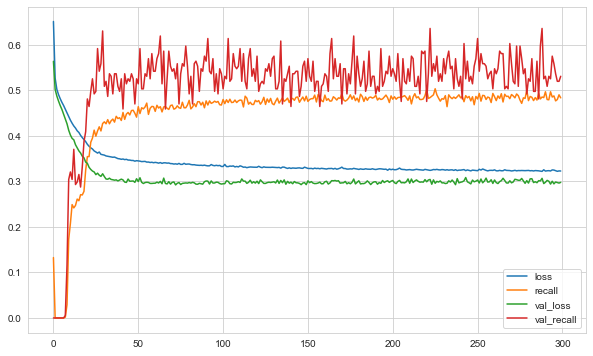

In [48]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot()

In [49]:
loss, recall = model.evaluate(X_test, y_test, verbose=0)
print("loss : ", loss)
print("recall : ", recall)

loss :  0.34678471088409424
recall :  0.45588234066963196


In [50]:
y_pred = (model.predict(X_test) > 0.5).astype("int32")
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

32/32 [==============================] - 0s 2ms/step
[[758  38]
 [111  93]]
              precision    recall  f1-score   support

           0       0.87      0.95      0.91       796
           1       0.71      0.46      0.56       204

    accuracy                           0.85      1000
   macro avg       0.79      0.70      0.73      1000
weighted avg       0.84      0.85      0.84      1000



### Add Dropout Layer

In [51]:
from tensorflow.keras.layers import Dropout

In [52]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(16, activation = 'relu', input_dim = X_train.shape[1]))
model.add(Dropout(0.2))
model.add(Dense(12, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(8, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(4, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(1, activation='sigmoid'))

opt = Adam(lr = 0.001) # default learning rate value is 0.001
model.compile(optimizer = opt, loss = 'binary_crossentropy',metrics=["Recall"])

In [54]:
model.fit(x = X_train, y = y_train, validation_split = 0.10, batch_size = 128, epochs = 300)

Epoch 1/300
64/64 [==============================] - 1s 3ms/step - loss: 0.6703 - recall: 0.2234 - val_loss: 0.5811 - val_recall: 0.0000e+00
Epoch 2/300
64/64 [==============================] - 0s 1ms/step - loss: 0.5673 - recall: 0.0194 - val_loss: 0.5131 - val_recall: 0.0000e+00
Epoch 3/300
64/64 [==============================] - 0s 1ms/step - loss: 0.5441 - recall: 0.0054 - val_loss: 0.4966 - val_recall: 0.0000e+00
Epoch 4/300
64/64 [==============================] - 0s 1ms/step - loss: 0.5363 - recall: 6.0533e-04 - val_loss: 0.4878 - val_recall: 0.0000e+00
Epoch 5/300
64/64 [==============================] - 0s 1ms/step - loss: 0.5234 - recall: 0.0018 - val_loss: 0.4852 - val_recall: 0.0000e+00
Epoch 6/300
64/64 [==============================] - 0s 1ms/step - loss: 0.5149 - recall: 0.0000e+00 - val_loss: 0.4744 - val_recall: 0.0000e+00
Epoch 7/300
64/64 [==============================] - 0s 1ms/step - loss: 0.5123 - recall: 0.0000e+00 - val_loss: 0.4738 - val_recall: 0.0000e+00
E

64/64 [==============================] - 0s 1ms/step - loss: 0.4152 - recall: 0.2863 - val_loss: 0.3373 - val_recall: 0.4972
Epoch 58/300
64/64 [==============================] - 0s 972us/step - loss: 0.4141 - recall: 0.3063 - val_loss: 0.3343 - val_recall: 0.4862
Epoch 59/300
64/64 [==============================] - 0s 969us/step - loss: 0.4135 - recall: 0.3021 - val_loss: 0.3324 - val_recall: 0.4696
Epoch 60/300
64/64 [==============================] - 0s 982us/step - loss: 0.4122 - recall: 0.3051 - val_loss: 0.3303 - val_recall: 0.4586
Epoch 61/300
64/64 [==============================] - 0s 987us/step - loss: 0.4066 - recall: 0.3099 - val_loss: 0.3278 - val_recall: 0.4751
Epoch 62/300
64/64 [==============================] - 0s 972us/step - loss: 0.4088 - recall: 0.3015 - val_loss: 0.3356 - val_recall: 0.5580
Epoch 63/300
64/64 [==============================] - 0s 980us/step - loss: 0.4092 - recall: 0.2863 - val_loss: 0.3292 - val_recall: 0.4586
Epoch 64/300
64/64 [===============

64/64 [==============================] - 0s 1ms/step - loss: 0.3920 - recall: 0.3759 - val_loss: 0.3124 - val_recall: 0.5635
Epoch 117/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3937 - recall: 0.3699 - val_loss: 0.3205 - val_recall: 0.5083
Epoch 118/300
64/64 [==============================] - 0s 978us/step - loss: 0.3890 - recall: 0.3832 - val_loss: 0.3168 - val_recall: 0.5635
Epoch 119/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3929 - recall: 0.3614 - val_loss: 0.3136 - val_recall: 0.5470
Epoch 120/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3852 - recall: 0.3765 - val_loss: 0.3116 - val_recall: 0.5525
Epoch 121/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3957 - recall: 0.3735 - val_loss: 0.3133 - val_recall: 0.5414
Epoch 122/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3900 - recall: 0.3699 - val_loss: 0.3175 - val_recall: 0.5580
Epoch 123/300
64/64 [==================

Epoch 175/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3831 - recall: 0.3632 - val_loss: 0.3065 - val_recall: 0.5746
Epoch 176/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3892 - recall: 0.3947 - val_loss: 0.3139 - val_recall: 0.5580
Epoch 177/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3830 - recall: 0.3959 - val_loss: 0.3101 - val_recall: 0.5691
Epoch 178/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3916 - recall: 0.3632 - val_loss: 0.3080 - val_recall: 0.5580
Epoch 179/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3825 - recall: 0.3856 - val_loss: 0.3059 - val_recall: 0.5635
Epoch 180/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3861 - recall: 0.3801 - val_loss: 0.3068 - val_recall: 0.5470
Epoch 181/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3908 - recall: 0.3614 - val_loss: 0.3113 - val_recall: 0.5691
Epoch 182/300
64/64 [======

Epoch 234/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3754 - recall: 0.4201 - val_loss: 0.3056 - val_recall: 0.6022
Epoch 235/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3849 - recall: 0.3862 - val_loss: 0.3114 - val_recall: 0.5470
Epoch 236/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3849 - recall: 0.3692 - val_loss: 0.3100 - val_recall: 0.5912
Epoch 237/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3802 - recall: 0.3989 - val_loss: 0.3083 - val_recall: 0.5691
Epoch 238/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3765 - recall: 0.3856 - val_loss: 0.3070 - val_recall: 0.5525
Epoch 239/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3813 - recall: 0.3735 - val_loss: 0.3074 - val_recall: 0.5856
Epoch 240/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3828 - recall: 0.4050 - val_loss: 0.3148 - val_recall: 0.5525
Epoch 241/300
64/64 [======

Epoch 293/300
64/64 [==============================] - 0s 970us/step - loss: 0.3761 - recall: 0.3844 - val_loss: 0.3094 - val_recall: 0.5856
Epoch 294/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3809 - recall: 0.3814 - val_loss: 0.3093 - val_recall: 0.5912
Epoch 295/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3793 - recall: 0.4038 - val_loss: 0.3105 - val_recall: 0.5580
Epoch 296/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3746 - recall: 0.3953 - val_loss: 0.3070 - val_recall: 0.5801
Epoch 297/300
64/64 [==============================] - 0s 989us/step - loss: 0.3781 - recall: 0.3898 - val_loss: 0.3048 - val_recall: 0.6022
Epoch 298/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3800 - recall: 0.3820 - val_loss: 0.3075 - val_recall: 0.5635
Epoch 299/300
64/64 [==============================] - 0s 1ms/step - loss: 0.3781 - recall: 0.3838 - val_loss: 0.3107 - val_recall: 0.5691
Epoch 300/300
64/64 [==

<AxesSubplot:>

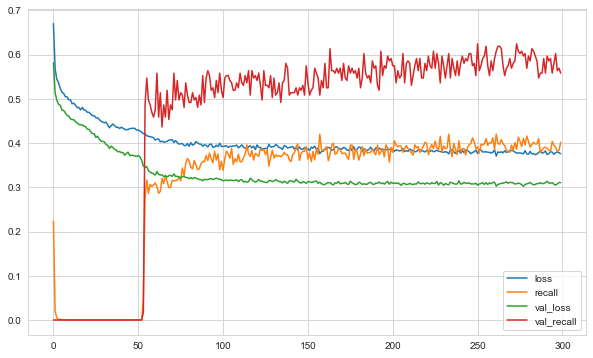

In [55]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot()

In [56]:
loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
print("loss : ", loss)
print("recall : ", recall)

loss :  0.3469896614551544
recall :  0.45588234066963196


### Add Early Stop

#### Monitor the "val_loss" as metric

In [57]:
early_stop = EarlyStopping(monitor = "val_loss", 
                           mode = "min", 
                           verbose = 1, 
                           patience = 25, 
                           restore_best_weights = True)

#### Monitor the "val_recall" as metric

In [59]:
early_stop = EarlyStopping(monitor = "val_recall", 
                           mode = "min", 
                           verbose = 1, 
                           patience = 25, 
                           restore_best_weights = True)

## GridSearchCV

In [64]:
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier
from tensorflow.keras.optimizers import Adadelta, RMSprop, Nadam, Adam, SGD

In [65]:
def build_classifier(optimizer,learn_rate):
    classifier = Sequential()
    classifier.add(Dense(units=16, activation='relu'))
    classifier.add(Dense(units=12, activation='relu'))
    classifier.add(Dense(units=8, activation='relu'))
    classifier.add(Dense(units=4, activation='relu'))
    classifier.add(Dense(units=1, activation='sigmoid'))
    classifier.compile(optimizer=optimizer(learn_rate),
                       loss='binary_crossentropy',
                       metrics=['Recall'])
    return classifier

In [66]:
class_weights

{0: 0.6278777731268314, 1: 2.454991816693944}

In [67]:
tf.random.set_seed(seed)

classifier = KerasClassifier(build_fn=build_classifier, epochs=200)
parameters = {
    'batch_size': [128, 256],
    'optimizer': [Adam, RMSprop, Nadam, Adadelta, SGD],
    'learn_rate': [0.001, 0.003, 0.005]
}
grid_model = GridSearchCV(estimator=classifier,
                          param_grid=parameters,
                          scoring='recall',
                          cv=5,
                          n_jobs=-1,
                          verbose=0).fit(X_train,
                                         y_train,
                                         class_weight=class_weights)

2022-06-20 17:28:50.320856: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-06-20 17:28:50.324607: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-06-20 17:28:50.329298: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the ap

Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
Epoch 1/200
57/57 [==============================] - 1s 2ms/step - loss: 0.6945 - recall: 0.54170
Epoch 2/200
57/57 [==============================] - 1s 2ms/step - loss: 0.6824 - recall: 0.1708
Epoch 2/200
Epoch 2/200
57/57 [==============================] - 1s 2ms/step - loss: 0.6837 - recall: 0.0820
Epoch 2/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6640 - recall: 0.4144
Epoch 3/200
Epoch 3/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6687 - recall: 0.5028
Epoch 3/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6700 - recall: 0.3251
Epoch 3/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6708 - recall: 0.5330
Epoch 4/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6390 - recall: 0.5937
Epoch 4/200
57/57 [==============================] - 0s 2ms/step - 

57/57 [==============================] - 0s 3ms/step - loss: 0.5891 - recall: 0.6866
Epoch 9/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6004 - recall: 0.6846
Epoch 9/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5974 - recall: 0.6776
Epoch 9/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6035 - recall: 0.6931
Epoch 9/200
57/57 [==============================] - 3s 2ms/step - loss: 0.6873 - recall: 0.9160
Epoch 2/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5648 - recall: 0.7335
Epoch 13/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5549 - recall: 0.7476
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5178 - recall: 0.7576
Epoch 13/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5666 - recall: 0.6920
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5940 - recall: 0.6900
Epoch 10/200
Epoch 10/200
Epoch 10/200

57/57 [==============================] - 0s 4ms/step - loss: 0.5439 - recall: 0.7452
Epoch 15/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5480 - recall: 0.7222
Epoch 15/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5039 - recall: 0.7486
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5811 - recall: 0.7128
Epoch 12/200
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5865 - recall: 0.6952
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6590 - recall: 0.4580
Epoch 4/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5356 - recall: 0.7544
Epoch 16/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5425 - recall: 0.7215
Epoch 16/200
41/57 [====================>.........] - ETA: 0s - loss: 0.5552 - recall: 0.6919Epoch 16/200
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5764 - recall: 0.7066
Epoch 13/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6480 - recall: 0.5489
Epoch 5/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5989 - recall: 0.6543
Epoch 6/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4937 - recall: 0.7534
Epoch 17/200
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5787 - recall: 0.6884
Epoch 14/200
Epoch 14/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5504 - recall: 0.7073
Epoch 14/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6397 - recall: 0.6315
Epoch 6/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5316 - recall: 0.7359


57/57 [==============================] - 0s 3ms/step - loss: 0.5261 - recall: 0.7665
Epoch 18/200
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5822 - recall: 0.6722
Epoch 7/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4897 - recall: 0.7528
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5300 - recall: 0.7707
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5664 - recall: 0.7064
Epoch 15/200
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5754 - recall: 0.6911
Epoch 15/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5448 - recall: 0.6935
Epoch 15/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5284 - recall: 0.7358
Epoch 15/200
 1/57 [..............................] - ETA: 0s - loss: 0.3888 - recall: 0.7826Epoch 19/200
Epoch 8/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5315 - recall: 0.7278
E

57/57 [==============================] - 0s 3ms/step - loss: 0.5643 - recall: 0.7064
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6225 - recall: 0.6846
Epoch 8/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5199 - recall: 0.7719
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5633 - recall: 0.6853
Epoch 9/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5178 - recall: 0.7782
Epoch 20/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4834 - recall: 0.7576
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5568 - recall: 0.7259
Epoch 17/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5705 - recall: 0.6985
Epoch 17/200
 1/57 [..............................] - ETA: 0s - loss: 0.6080 - recall: 0.6667Epoch 17/200
Epoch 17/200
 1/57 [..............................] - ETA: 0s - loss: 0.4880 - recall: 0.8636Epoch 17/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6120 - recall: 0.6915
Epoch 9/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4837 - recall: 0.7576
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5169 - recall: 0.7773
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5549 - recall: 0.6763
Epoch 10/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5690 - recall: 0.6830
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5176 - recall: 0.7399
Epoch 18/200
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5580 - recall: 0.7085
Epoch 18/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5476 - recall: 0.6832
Epoch 11/200


57/57 [==============================] - 0s 3ms/step - loss: 0.5488 - recall: 0.7259
Epoch 19/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5170 - recall: 0.7840
Epoch 22/200
Epoch 22/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4822 - recall: 0.7603
Epoch 22/200
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5179 - recall: 0.7449
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5014 - recall: 0.7621
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5537 - recall: 0.7016
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5234 - recall: 0.7231
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5103 - recall: 0.7813
Epoch 23/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4798 - recall: 0.7590
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5153 - recall: 0.7435
Epoch 2

57/57 [==============================] - 0s 3ms/step - loss: 0.4975 - recall: 0.7642
Epoch 12/200
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5456 - recall: 0.7245
Epoch 20/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5783 - recall: 0.7163
Epoch 12/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5320 - recall: 0.6977
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5631 - recall: 0.6918
Epoch 24/200
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4773 - recall: 0.7569
Epoch 21/200
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5105 - recall: 0.7414
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4952 - recall: 0.7588
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5074 - recall: 0.7893
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5150 - recall: 0

57/57 [==============================] - 0s 3ms/step - loss: 0.5356 - recall: 0.7273
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5618 - recall: 0.6810
Epoch 22/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5055 - recall: 0.7813
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4755 - recall: 0.7665
Epoch 25/200
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4930 - recall: 0.7608
Epoch 22/200
Epoch 22/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5201 - recall: 0.7094
Epoch 14/200
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4759 - recall: 0.7645
Epoch 23/200
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5055 - recall: 0.7907
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5062 - recall: 0.7169
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.515

57/57 [==============================] - 0s 3ms/step - loss: 0.5560 - recall: 0.6783
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5007 - recall: 0.7586
Epoch 28/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4995 - recall: 0.7955
Epoch 28/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5372 - recall: 0.7305
Epoch 25/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5443 - recall: 0.7603
Epoch 16/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5090 - recall: 0.7328
Epoch 17/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5010 - recall: 0.7665
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5208 - recall: 0.7314
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5376 - recall: 0.7686
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5076 - recall: 0.7238
Epoch 26/200
Epoch 18/200
57/57 [

57/57 [==============================] - 0s 2ms/step - loss: 0.4853 - recall: 0.7369
Epoch 28/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4961 - recall: 0.7634
Epoch 31/200
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5279 - recall: 0.7497
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4952 - recall: 0.7762
Epoch 31/200
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5489 - recall: 0.6682
Epoch 29/200
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4834 - recall: 0.7431
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4935 - recall: 0.7545
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5212 - recall: 0.7789
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4918 - recall: 0.7445
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5246 - recall: 0

57/57 [==============================] - 0s 3ms/step - loss: 0.5088 - recall: 0.7500
Epoch 30/200
Epoch 30/200
Epoch 30/200
21/57 [==========>...................] - ETA: 0s - loss: 0.4700 - recall: 0.7849Epoch 30/200
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5165 - recall: 0.7865
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4895 - recall: 0.7404
Epoch 22/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4728 - recall: 0.7645
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4744 - recall: 0.7540
Epoch 33/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4938 - recall: 0.7853
Epoch 33/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5068 - recall: 0.7493
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4783 - recall: 0.7445
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4892 - recall: 0.7675

28/57 [=============>................] - ETA: 0s - loss: 0.5487 - recall: 0.7023Epoch 32/200
Epoch 23/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4725 - recall: 0.7547
Epoch 35/200
Epoch 35/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4851 - recall: 0.7417
Epoch 24/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4909 - recall: 0.7847
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5392 - recall: 0.6965
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4747 - recall: 0.7548
Epoch 33/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4827 - recall: 0.7424
Epoch 36/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4933 - recall: 0.7873
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5118 - recall: 0.7435
Epoch 33/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4919 - recall: 0.7920
Epoch 36/200

57/57 [==============================] - 0s 2ms/step - loss: 0.4816 - recall: 0.7534
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5380 - recall: 0.6783
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4843 - recall: 0.7682
Epoch 37/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4900 - recall: 0.7817
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5083 - recall: 0.7510
Epoch 26/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4686 - recall: 0.7658
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4890 - recall: 0.7806
Epoch 37/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4727 - recall: 0.7581
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4708 - recall: 0.7569
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4979 - recall: 0.7534
Epoch 35/200
57/57 [=============

57/57 [==============================] - 0s 2ms/step - loss: 0.4820 - recall: 0.7606
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5045 - recall: 0.7510
Epoch 36/200
15/57 [======>.......................] - ETA: 0s - loss: 0.4882 - recall: 0.7687Epoch 27/200
Epoch 39/200
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4797 - recall: 0.7493
Epoch 28/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4709 - recall: 0.7576
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5296 - recall: 0.6945
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4805 - recall: 0.7551
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4881 - recall: 0.7748
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4833 - recall: 0.7860
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4945 - recall: 0.7831
Epoch 29/200

57/57 [==============================] - 0s 4ms/step - loss: 0.4904 - recall: 0.7572
Epoch 43/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4762 - recall: 0.7606
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4674 - recall: 0.7520
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4758 - recall: 0.7534
Epoch 44/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4820 - recall: 0.7769
Epoch 46/200
Epoch 44/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4873 - recall: 0.7514
Epoch 44/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4878 - recall: 0.7627
Epoch 44/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4820 - recall: 0.7748
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4812 - recall: 0.7748
Epoch 36/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4860 - recall: 0.7610
Epoch 45/200
 1/57 [..............................] - ETA: 0s - loss: 0.4624 - recall: 0.9286Epoch 47/200
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4637 - recall: 0.7534
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4754 - recall: 0.7493
Epoch 45/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4658 - recall: 0.7594
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4737 - recall: 0.7517
Epoch 48/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4751 - recall: 0.7528
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4782 - recall: 0.7851
Epoch 37/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4751 - recall: 0.7500
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5066 - recall: 0.7100
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4711 - recall: 0.7927
Epoch 48/200
Epoch 48/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4856 - recall: 0.7565
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4648 - recall: 0.7576
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4631 - recall: 0.7540
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4797 - recall: 0.7824
Epoch 49/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4710 - recall: 0.7833
Epoch 47/200
57/57 [

57/57 [==============================] - 0s 3ms/step - loss: 0.4718 - recall: 0.7606
Epoch 50/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4834 - recall: 0.7631
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4742 - recall: 0.7500
Epoch 38/200
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4799 - recall: 0.7810
Epoch 48/200
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4703 - recall: 0.7894
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4638 - recall: 0.7748
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5020 - recall: 0.7133
Epoch 48/200
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4699 - recall: 0.7757
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4838 - recall: 0.7479
Epoch 51/200
51/57 [=========================>....] - ETA: 0s - loss: 0.4746 - recall: 0.742

57/57 [==============================] - 0s 3ms/step - loss: 0.4617 - recall: 0.7652
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4821 - recall: 0.7675
Epoch 49/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4640 - recall: 0.7513
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4830 - recall: 0.7514
Epoch 50/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4728 - recall: 0.7865
Epoch 40/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4771 - recall: 0.7803
Epoch 52/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4673 - recall: 0.7773
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4795 - recall: 0.7675
Epoch 50/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4739 - recall: 0.7574
Epoch 50/200
Epoch 50/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4624 - recall: 0.7514
Epoch 50/200
57/57 [

57/57 [==============================] - 0s 3ms/step - loss: 0.4680 - recall: 0.7709
Epoch 56/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4765 - recall: 0.7627
Epoch 54/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4680 - recall: 0.7872
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4607 - recall: 0.7514
Epoch 54/200
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4722 - recall: 0.7500
Epoch 54/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4725 - recall: 0.7500
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4634 - recall: 0.7562
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4611 - recall: 0.7567
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4678 - recall: 0.7771
Epoch 57/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4660 - recall: 0.7858
Epoch 45/200
57/57 [

57/57 [==============================] - 0s 3ms/step - loss: 0.4584 - recall: 0.7648
Epoch 61/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4644 - recall: 0.7689
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4617 - recall: 0.7789
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4708 - recall: 0.7507
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4581 - recall: 0.7603
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4709 - recall: 0.7521
Epoch 51/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4582 - recall: 0.7547
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4773 - recall: 0.7548
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4579 - recall: 0.7569
Epoch 60/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4615 - recall: 0.7886
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4712 - recall: 0.7500
Epoch 61/200
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4728 - recall: 0.7837
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4695 - recall: 0.7479
Epoch 52/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4572 - recall: 0.7665
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4613 - recall: 0.7887
Epoch 63/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4585 - recall: 0.7734
Epoch 63/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4597 - recall: 0.7628
Epoch 63/200
34/57 [================>.............] - ETA: 0s - loss: 0.4789 - recall: 0.7560Epoch 64/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4602 - recall: 0.7927
Epoch 52/200
 1/57 [..............................] - ETA: 0s - loss: 0.4840 - recall: 0.7273Epoch 64/200
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4695 - recall: 0.7561
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4719 - recall: 0.7689
Epoch 62/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4578 - recall: 0.7631
Epoch 53/200
Epoch 64/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4580 - recall: 0.7642
Epoch 64/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4773 - recall: 0.7541
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4702 - recall: 0.7554
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4589 - recall: 0.7803
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4636 - recall: 0.7613
Epoch 65/200

57/57 [==============================] - 0s 3ms/step - loss: 0.4564 - recall: 0.7547
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4766 - recall: 0.7443
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4704 - recall: 0.7661
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4678 - recall: 0.7520
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4584 - recall: 0.7824
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4566 - recall: 0.7555
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4705 - recall: 0.7893
Epoch 66/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4703 - recall: 0.7541
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4573 - recall: 0.7668
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4606 - recall: 0.7723
Epoch 67/200
57/57 [=============

57/57 [==============================] - 0s 4ms/step - loss: 0.4550 - recall: 0.7900
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4567 - recall: 0.7658
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4758 - recall: 0.7590
Epoch 66/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4727 - recall: 0.7436
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4686 - recall: 0.7593
Epoch 56/200
Epoch 68/200
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4694 - recall: 0.7762
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4584 - recall: 0.7734
Epoch 67/200
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4537 - recall: 0.7840
Epoch 68/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4557 - recall: 0.7682
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4623 - recall: 0.7709
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4708 - recall: 0.7723
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4672 - recall: 0.7540
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4558 - recall: 0.7769
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4731 - recall: 0.7920
Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4729 - recall: 0.7389
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4595 - recall: 0.7583
Epoch 58/200
20/57 [=========>....................] - ETA: 0s - loss: 0.4576 - recall: 0.7960Epoch 69/200
Epoch 68/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4571 - recall: 0.7588
Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4698 - recall: 0.7572
Epoch 70/200
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4538 - recall: 0.7799
Epoch 68/200
 1/57 [..............................] - ETA: 0s - loss: 0.5358 - recall: 0.7000Epoch 68/200
Epoch 70/200
15/57 [======>.......................] - ETA: 0s - loss: 0.4899 - recall: 0.7556Epoch 70/200
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4566 - recall: 0.7601
Epoch 70/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4601 - recall: 0.7689
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4539 - recall: 0.7596
Epoch 69/200
Epoch 59/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4556 - recall: 0.7954
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4576 - recall: 0.7555
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4734 - recall: 0.7672
Epoch 69/200
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4686 - recall: 0.7479
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4553 - recall: 0.7628
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4689 - recall: 0.7689
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4553 - recall: 0.7672
Epoch 70/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4588 - recall: 0.7606
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4689 - recall: 0.7402
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4685 - recall: 0.7810
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4567 - recall: 0.7658
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4537 - recall: 0.7920
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4734 - recall: 0.7610
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4682 - recall: 0.7452
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4685 - recall: 0.7627
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4532 - recall: 0.7658
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4595 - recall: 0.7716


29/57 [==============>...............] - ETA: 0s - loss: 0.4567 - recall: 0.7749Epoch 71/200
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4677 - recall: 0.7540
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4539 - recall: 0.7927
Epoch 73/200
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4669 - recall: 0.7416
Epoch 74/200
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4533 - recall: 0.7927
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4521 - recall: 0.7851
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4699 - recall: 0.8010
Epoch 74/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4680 - recall: 0.7576
Epoch 63/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4558 - recall: 0.7707
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4659 - recall: 0.7689
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4680 - recall: 0.7466
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4521 - recall: 0.7860
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4583 - recall: 0.7620
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4715 - recall: 0.7610
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4517 - recall: 0.7824
Epoch 63/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4663 - recall: 0.7362
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4552 - recall: 0.7668
Epoch 75/200
57/57 [=============

57/57 [==============================] - 0s 3ms/step - loss: 0.4625 - recall: 0.7517
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4677 - recall: 0.7513
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4557 - recall: 0.7757
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4561 - recall: 0.7693
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4707 - recall: 0.7624
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4672 - recall: 0.7583
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4570 - recall: 0.7764
Epoch 77/200
Epoch 79/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4641 - recall: 0.7510
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4726 - recall: 0.7638
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4653 - recall: 0.7851
Epoch 79/200
Epoch 7

57/57 [==============================] - 0s 3ms/step - loss: 0.4644 - recall: 0.7709
Epoch 83/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4712 - recall: 0.7583
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4468 - recall: 0.7867
Epoch 73/200
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4659 - recall: 0.7466
Epoch 85/200
Epoch 84/200
54/57 [===========================>..] - ETA: 0s - loss: 0.4602 - recall: 0.7836Epoch 74/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4633 - recall: 0.7675
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4542 - recall: 0.7689
Epoch 85/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4546 - recall: 0.7723
Epoch 86/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4485 - recall: 0.7907
Epoch 86/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4442 - recall: 0.7734
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4630 - recall: 0.7594
Epoch 85/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4492 - recall: 0.7713
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4657 - recall: 0.7576
Epoch 86/200
23/57 [===========>..................] - ETA: 0s - loss: 0.4436 - recall: 0.7890Epoch 75/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4661 - recall: 0.7647
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4557 - recall: 0.7520
Epoch 86/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4695 - recall: 0.7665
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4432 - recall: 0.7796
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4630 - recall: 0.7561
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4621 - recall: 0.7955
Epoch 76/200
Epoch 87/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4632 - recall: 0.7668
Epoch 86/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4485 - recall: 0.7734
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4537 - recall: 0.7628
Epoch 87/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4560 - recall: 0.7598
Epoch 86/200
57/57 [

57/57 [==============================] - 0s 3ms/step - loss: 0.4438 - recall: 0.7755
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4656 - recall: 0.7555
Epoch 88/200
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4639 - recall: 0.7661
Epoch 87/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4451 - recall: 0.7799
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4520 - recall: 0.7608
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4699 - recall: 0.7569
Epoch 88/200
41/57 [====================>.........] - ETA: 0s - loss: 0.4691 - recall: 0.7486Epoch 89/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4555 - recall: 0.7651
Epoch 87/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4470 - recall: 0.7921
Epoch 89/200
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4637 - recall: 0.7507
Epoch 88/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4647 - recall: 0.7459
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4633 - recall: 0.7872
Epoch 89/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4561 - recall: 0.7530
Epoch 88/200
52/57 [==========================>...] - ETA: 0s - loss: 0.4579 - recall: 0.7696Epoch 89/200
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4574 - recall: 0.7723
Epoch 90/200


45/57 [======================>.......] - ETA: 0s - loss: 0.4520 - recall: 0.7584Epoch 78/200
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4478 - recall: 0.7734
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7631
Epoch 90/200
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4593 - recall: 0.7886
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4450 - recall: 0.7934
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4564 - recall: 0.7611
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4618 - recall: 0.7737
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4413 - recall: 0.7865
Epoch 79/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4626 - recall: 0.7507
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4596 - recall: 0.7872
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4529 - recall: 0.7631
Epoch 90/200
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4542 - recall: 0.7544
Epoch 90/200
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4512 - recall: 0.7574
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4465 - recall: 0.7645
Epoch 91/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4543 - recall: 0.7652
Epoch 92/200
50/57 [=========================>....] - ETA: 0s - loss: 0.4640 - recall: 0.7684Epoch 91/200
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4617 - recall: 0.7695
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4593 - recall: 0.7975
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4677 - recall: 0.7603
Epoch 92/200
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4516 - recall: 0.7675
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4440 - recall: 0.7741
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4404 - recall: 0.7844
Epoch 92/200
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4583 - recall: 0.7438
Epoch 93/200
53/57 [==========================>...] - ETA: 0s - loss: 0.4631 - recall: 0.7952Epoc

57/57 [==============================] - 0s 3ms/step - loss: 0.4645 - recall: 0.7583
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4506 - recall: 0.7601
Epoch 93/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4621 - recall: 0.7579
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4469 - recall: 0.7720
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4403 - recall: 0.7755
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4579 - recall: 0.7858
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4503 - recall: 0.7693
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4444 - recall: 0.7806
Epoch 94/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4554 - recall: 0.7598
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4538 - recall: 0.7613
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4513 - recall: 0.7621
Epoch 94/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4448 - recall: 0.7658
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4614 - recall: 0.7500
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4590 - recall: 0.7831
Epoch 95/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4640 - recall: 0.7534
Epoch 94/200
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4667 - recall: 0.7658
Epoch 95/200
42/57 [=====================>........] - ETA: 0s - loss: 0.4449 - recall: 0.7577Epoch 95/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4446 - recall: 0.7954
Epoch 95/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4540 - recall: 0.7584
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4512 - recall: 0.7581
Epoch 95/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4493 - recall: 0.7702
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4397 - recall: 0.7796
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4604 - recall: 0.7588
Epoch 95/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4515 - recall: 0.7672
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4438 - recall: 0.7713
Epoch 95/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4447 - recall: 0.7853
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4640 - recall: 0.7603
Epoch 85/200
57/57 [=============

57/57 [==============================] - 0s 3ms/step - loss: 0.4496 - recall: 0.7682
Epoch 96/200
Epoch 97/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4610 - recall: 0.7594
Epoch 96/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4441 - recall: 0.7831
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4395 - recall: 0.7858
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4620 - recall: 0.7641
Epoch 96/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4581 - recall: 0.7879
Epoch 86/200
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4453 - recall: 0.7880
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4679 - recall: 0.7672
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4517 - recall: 0.7550
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4519 - recall: 0.7693
Epoch 9

57/57 [==============================] - 0s 4ms/step - loss: 0.4507 - recall: 0.7695
Epoch 98/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4615 - recall: 0.7473
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4632 - recall: 0.7528
Epoch 87/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4384 - recall: 0.7851
Epoch 86/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4579 - recall: 0.7927
Epoch 98/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4421 - recall: 0.7840
Epoch 98/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4666 - recall: 0.7755
Epoch 97/200
Epoch 98/200
 1/57 [..............................] - ETA: 0s - loss: 0.3369 - recall: 0.7500Epoch 98/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4502 - recall: 0.7661
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4440 - recall: 0.7720
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4552 - recall: 0.7948
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4660 - recall: 0.7645
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4513 - recall: 0.7686
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4378 - recall: 0.7824
Epoch 98/200
Epoch 87/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4519 - recall: 0.7584
Epoch 99/200
Epoch 98/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4503 - recall: 0.7736
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4606 - recall: 0.7675
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4608 - recall: 0.7513
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4554 - recall: 0.7844
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4374 - recall: 0.7886
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4515 - recall: 0.7720
Epoch 100/200
Epoch 100/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4412 - recall: 0.7665
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4612 - recall: 0.7654
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4371 - recall: 0.7769
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4607 - recall: 0.7628
Epoch 100/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4566 - recall: 0.7879
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4423 - recall: 0.7907
Epoch 101/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4631 - recall: 0.7548
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4521 - recall: 0.7617
Epoch 101/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4499 - recall: 0.7655
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4590 - recall: 0.7628
Epoch 101/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4607 - recall: 0.7702
Epoch 101/200
 1/57 [..............................] - ETA: 0s - loss: 0.5322 - recall: 0.6538Epoch 90/200
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4419 - recall: 0.7948
Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4560 - recall: 0.7955
Epoch 102/200
25/57 [============>.................] - ETA: 0s - loss: 0.4585 - recall: 0.7579Epoch 102/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4421 - recall: 0.7693
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4504 - recall: 0.7785
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4610 - recall: 0.7567
Epoch 102/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4551 - recall: 0.7899
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4603 - recall: 0.7675
Epoch 102/200
15/57 [======>.......................] - ETA: 0s - loss: 0.4379 - recall: 0.7876Epoch 91/200
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4660 - recall: 0.7686
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4528 - recall: 0.7591
Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4401 - recall: 0.7995
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4489 - recall: 0.7665
Epoch 103/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4599 - recall: 0.7737
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4512 - recall: 0.7540
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4591 - recall: 0.7655
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4550 - recall: 0.7893
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4625 - recall: 0.7534
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4647 - recall: 0.7713
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4359 - recall: 0.7851
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4518 - recall: 0.7618
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4418 - recall: 0.7934
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4431 - recall: 0.7727
Epoch 104/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4589 - recall: 0.7634
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4500 - recall: 0.7642
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4625 - recall: 0.7638
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4544 - recall: 0.7955
Epoch 93/200
Epoch 105/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4411 - recall: 0.7752
Epoch 105/200
30/57 [==============>...............] - ETA: 0s - loss: 0.4541 - recall: 0.7588Epoch 105/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4501 - recall: 0.7750
Epoch 106/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4600 - recall: 0.7702
Epoch 105/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4602 - recall: 0.7487
Epoch 105/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4425 - recall: 0.7927
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4554 - recall: 0.7906
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4395 - recall: 0.7817
Epoch 106/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4476 - recall: 0.7771
Epoch 107/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4468 - recall: 0.7763
Epoch 106/200
Epoch 106/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4647 - recall: 0.7645
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4551 - recall: 0.7899
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4492 - recall: 0.7548
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4623 - recall: 0.7645
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4417 - recall: 0.7769
Epoch 107/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4486 - recall: 0.7730
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4482 - recall: 0.7621
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4595 - recall: 0.7642
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4586 - recall: 0.7675
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4637 - recall: 0.7652
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4493 - recall: 0.7564
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4533 - recall: 0.7899
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4343 - recall: 0.7899
Epoch 96/200
 1/57 [..............................] - ETA: 0s - loss: 0.4107 - recall: 0.7727Epoch 97/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4594 - recall: 0.7723
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4486 - recall: 0.7655
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4587 - recall: 0.7621
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4650 - recall: 0.7713
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4560 - recall: 0.7968
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4348 - recall: 0.7872
Epoch 97/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4406 - recall: 0.7880
Epoch 109/200
34/57 [================>.............] - ETA: 0s - loss: 0.4494 - recall: 0.7820Epoch 109/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4404 - recall: 0.7665
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4481 - recall: 0.7594
Epoch 109/200
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4411 - recall: 0.7988
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4492 - recall: 0.7651
Epoch 98/200
Epoch 109/200
 1/57 [..............................] - ETA: 0s - loss: 0.5121 - recall: 0.7586Epoch 110/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4497 - recall: 0.7596
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4584 - recall: 0.7675
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4496 - recall: 0.7723
Epoch 111/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4489 - recall: 0.7689
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4615 - recall: 0.7493
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4402 - recall: 0.7713
Epoch 111/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4344 - recall: 0.7899
Epoch 111/200
Epoch 99/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4574 - recall: 0.7716
Epoch 111/200
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4483 - recall: 0.7604
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4489 - recall: 0.7709
Epoch 111/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4518 - recall: 0.7844
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4395 - recall: 0.7934
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4398 - recall: 0.7762
Epoch 112/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4469 - recall: 0.7716
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4595 - recall: 0.7757
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4643 - recall: 0.7720
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4615 - recall: 0.7631
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4385 - recall: 0.7927
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4338 - recall: 0.7865
Epoch 113/200
Epoch 101/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4488 - recall: 0.7624
Epoch 113/200
43/57 [=====================>........] - ETA: 0s - loss: 0.4647 - recall: 0.7701Epoch 113/200


15/57 [======>.......................] - ETA: 0s - loss: 0.4531 - recall: 0.8058Epoch 114/200
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4493 - recall: 0.7561
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4316 - recall: 0.7899
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4610 - recall: 0.7672
Epoch 103/200
Epoch 114/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4397 - recall: 0.7810
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4481 - recall: 0.7624
Epoch 114/200
51/57 [=========================>....] - ETA: 0s - loss: 0.4569 - recall: 0.7651Epoch 115/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4487 - recall: 0.7678
Epoch 114/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4464 - recall: 0.7757
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4488 - recall: 0.7682
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4388 - recall: 0.7762
Epoch 115/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4480 - recall: 0.7645
Epoch 115/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4322 - recall: 0.7837
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4581 - recall: 0.7737
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4465 - recall: 0.7618
Epoch 115/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4457 - recall: 0.7682
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4511 - recall: 0.7851
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4606 - recall: 0.7534
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4388 - recall: 0.7789
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4377 - recall: 0.8001
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4480 - recall: 0.7631
Epoch 116/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4583 - recall: 0.7648
Epoch 116/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4450 - recall: 0.7627
Epoch 117/200
38/57 [===================>..........] - ETA: 0s - loss: 0.4353 - recall: 0.7911Epoch 117/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4390 - recall: 0.7769
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4610 - recall: 0.7624
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4496 - recall: 0.7872
Epoch 117/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4576 - recall: 0.7723
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4492 - recall: 0.7624
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4464 - recall: 0.7712
Epoch 117/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4625 - recall: 0.7658
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4467 - recall: 0.7778
Epoch 118/200
18/57 [========>.....................] - ETA: 0s - loss: 0.4572 - recall: 0.7828Epoch 117/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4512 - recall: 0.7837
Epoch 118/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4380 - recall: 0.7948
Epoch 118/200
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4600 - recall: 0.7562
Epoch 118/200
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4326 - recall: 0.7817
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4575 - recall: 0.7613
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4617 - recall: 0.7679
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4453 - recall: 0.7712
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4438 - recall: 0.7709
Epoch 119/200
36/57 [=================>............] - ETA: 0s - loss: 0.4514 - recall: 0.7773Epoch 118/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4607 - recall: 0.7617
Epoch 119/200
Epoch 108/200
47/57 [=======================>......] - ETA: 0s - loss: 0.4471 - recall: 0.7765Epoch 119/200
Epoch 119/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4567 - recall: 0.7574
Epoch 119/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4627 - recall: 0.7645
Epoch 120/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4459 - recall: 0.7678
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4595 - recall: 0.7610
Epoch 109/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4503 - recall: 0.7934
Epoch 120/200
22/57 [==========>...................] - ETA: 0s - loss: 0.4506 - recall: 0.7679Epoch 108/200
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4624 - recall: 0.7707
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4457 - recall: 0.7645
Epoch 121/200
Epoch 120/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4485 - recall: 0.7486
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4386 - recall: 0.7775
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4614 - recall: 0.7617
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7837
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4369 - recall: 0.7934
Epoch 121/200
 1/57 [..............................] - ETA: 0s - loss: 0.4938 - recall: 0.8387Epoch 

57/57 [==============================] - 0s 3ms/step - loss: 0.4624 - recall: 0.7665
Epoch 122/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4473 - recall: 0.7734
Epoch 121/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4567 - recall: 0.7668
Epoch 121/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4431 - recall: 0.7709
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4369 - recall: 0.7748
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4600 - recall: 0.7596
Epoch 111/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4570 - recall: 0.7689
Epoch 122/200
 1/57 [..............................] - ETA: 0s - loss: 0.5188 - recall: 0.7391Epoch 122/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4626 - recall: 0.7707
Epoch 122/200
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4310 - recall: 0.7906
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4464 - recall: 0.7598
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4551 - recall: 0.7628
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4450 - recall: 0.7689
Epoch 122/200
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4507 - recall: 0.7837
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4302 - recall: 0.7803
Epoch 111/200
21/57 [==========>...................] - ETA: 0s - loss: 0.4411 - recall: 0.7657Epoch 123/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4548 - recall: 0.7716
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4596 - recall: 0.7652
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4384 - recall: 0.7968
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4621 - recall: 0.7713
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4384 - recall: 0.7789
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4463 - recall: 0.7574
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4618 - recall: 0.7672
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4555 - recall: 0.7757
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4550 - recall: 0.7615
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4397 - recall: 0.7894
Epoch 113/200
Epoch 124/

57/57 [==============================] - 0s 3ms/step - loss: 0.4437 - recall: 0.7766
Epoch 124/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4380 - recall: 0.7796
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4484 - recall: 0.7831
Epoch 125/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4453 - recall: 0.7716
Epoch 125/200
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7851
Epoch 113/200
14/57 [======>.......................] - ETA: 0s - loss: 0.4563 - recall: 0.7579Epoch 126/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4457 - recall: 0.7658
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4491 - recall: 0.7689
Epoch 126/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4466 - recall: 0.7736
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4373 - recall: 0.7652
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4556 - recall: 0.7750
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4591 - recall: 0.7638
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4542 - recall: 0.7675
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4456 - recall: 0.7743


Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4480 - recall: 0.7624
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4460 - recall: 0.7705
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4437 - recall: 0.7682
Epoch 126/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4612 - recall: 0.7762
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4499 - recall: 0.7975
Epoch 127/200
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4592 - recall: 0.7555
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4540 - recall: 0.7682
Epoch 127/200
21/57 [==========>...................] - ETA: 0s - loss: 0.4611 - recall: 0.7462Epoch 128/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4542 - recall: 0.7654
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4581 - recall: 0.7624
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4458 - recall: 0.7803
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4602 - recall: 0.7837
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4460 - recall: 0.7693
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4289 - recall: 0.7879
Epoch 116/200
42/57 [=====================>........] - ETA: 0s - loss: 0.4339 - recall: 0.7822Epoch 129/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4363 - recall: 0.7803
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4541 - recall: 0.7764
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4486 - recall: 0.7879
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4498 - recall: 0.7668
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4612 - recall: 0.7713
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4442 - recall: 0.7739
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4289 - recall: 0.7851
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4441 - recall: 0.7785
Epoch 130/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4354 - recall: 0.7782
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4585 - recall: 0.7700
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4282 - recall: 0.7906
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4440 - recall: 0.7672
Epoch 130/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4552 - recall: 0.7764
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4454 - recall: 0.7527
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4584 - recall: 0.7624
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4356 - recall: 0.7873
Epoch 132/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4458 - recall: 0.7652
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4541 - recall: 0.7655
Epoch 131/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4439 - recall: 0.7692
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4462 - recall: 0.7886
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4284 - recall: 0.7858
Epoch 119/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4544 - recall: 0.7695
Epoch 132/200
57/57 [===

Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4550 - recall: 0.7620
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4583 - recall: 0.7782
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4478 - recall: 0.7652
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4343 - recall: 0.7775
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4543 - recall: 0.7716
Epoch 132/200
Epoch 133/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4600 - recall: 0.7700
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4347 - recall: 0.7799
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4583 - recall: 0.7583
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4274 - recall: 0.7927
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4474 - recall: 0.7621
Epoch 133/200
40/57 [====================>.........] - ETA: 0s - loss: 0.4424 - recall: 0.7560Epoch 134/200
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4445 - recall: 0.7785
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4607 - recall: 0.7707
Epoch 135/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4578 - recall: 0.7569
Epoch 134/200
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4491 - recall: 0.7851
Epoch 134/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4411 - recall: 0.7771
Epoch 135/200
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4268 - recall: 0.7906
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4525 - recall: 0.7709
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4539 - recall: 0.7668
Epoch 134/200
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4593 - recall: 0.7707
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4437 - recall: 0.7719
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4563 - recall: 0.7610
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4473

57/57 [==============================] - 0s 4ms/step - loss: 0.4469 - recall: 0.7865
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4435 - recall: 0.7860
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4535 - recall: 0.7642
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4529 - recall: 0.7840
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4419 - recall: 0.7588
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4440 - recall: 0.7719
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4474 - recall: 0.7603
Epoch 136/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4268 - recall: 0.7872
Epoch 124/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4426 - recall: 0.7689
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4541 - recall: 0.7730
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4518 - recall: 0.7668
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4338 - recall: 0.7995
Epoch 138/200
Epoch 126/200
Epoch 137/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4446 - recall: 0.7796
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4497 - recall: 0.7534
Epoch 137/200
 1/57 [..............................] - ETA: 0s - loss: 0.5459 - recall: 0.6957Epoch 137/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7778
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4562 - recall: 0.7755
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4519 - recall: 0.7675
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4423 - recall: 0.7705
Epoch 138/200
Epoch 138/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4350 - recall: 0.7894
Epoch 138/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4452 - recall: 0.7865
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4416 - recall: 0.7709
Epoch 139/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4335 - recall: 0.7837
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4255 - recall: 0.7899
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4520 - recall: 0.7675
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4526 - recall: 0.7716
Epoch 138/200
41/57 [====================>.........] - ETA: 0s - loss: 0.4406 - recall: 0.7652Epoch 139/200
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4560 - recall: 0.7672
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4440 - recall: 0.7685
Epoch 139/200
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4349 - recall: 0.7934
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4439 - recall: 0.7782
Epoch 139/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4411 - recall: 0.7668
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4340 - recall: 0.7789
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4596 - recall: 0.7775
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4422 - recall: 0.7675
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4355 - recall: 0.7900
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4441 - recall: 0.7665
Epoch 140/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4447 - recall: 0.7886
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4424 - recall: 0.7791
Epoch 141/200
55/57 [===========================>..] - ETA: 0s - loss: 0.4588 - recall: 0.7667Epoch 141/200
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4560 - recall: 0.7624
Epoch 141/200
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4414 - recall: 0.7689
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4457 - recall: 0.7851
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4331 - recall: 0.7824
Epoch 142/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4533 - recall: 0.7723
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4591 - recall: 0.7796
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4407 - recall: 0.7764
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4518 - recall: 0.7655
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4396 - recall: 0.7702
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4489 - recall: 0.7803
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4441 - recall: 0.7548
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4408 - recall: 0.7812


57/57 [==============================] - 0s 4ms/step - loss: 0.4339 - recall: 0.7810
Epoch 143/200
Epoch 143/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4589 - recall: 0.7769
Epoch 144/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4528 - recall: 0.7635
Epoch 143/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4421 - recall: 0.7672
Epoch 143/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4560 - recall: 0.7638
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4442 - recall: 0.7865
Epoch 143/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4533 - recall: 0.7743
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4536 - recall: 0.7709
Epoch 144/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4343 - recall: 0.7789
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4333 - recall: 0.7907
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4557 - recall: 0.7631
Epoch 133/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4447 - recall: 0.7672
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4529 - recall: 0.7661
Epoch 145/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4383 - recall: 0.7730
Epoch 145/200
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4578 - recall: 0.7665
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4434 - recall: 0.7732
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4416 - recall: 0.7675
Epoch 145/200
Epoch 144/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4507 - recall: 0.7763
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4486 - recall: 0.7789
Epoch 145/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4585 - recall: 0.7762
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4336 - recall: 0.7762
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4519 - recall: 0.7737
Epoch 146/200
22/57 [==========>...................] - ETA: 0s - loss: 0.4456 - recall: 0.7682E

57/57 [==============================] - 0s 3ms/step - loss: 0.4424 - recall: 0.7749
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4551 - recall: 0.7645
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4346 - recall: 0.7914
Epoch 146/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4331 - recall: 0.7782
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4422 - recall: 0.7820
Epoch 146/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4543 - recall: 0.7730
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4432 - recall: 0.7858
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4522 - recall: 0.7662
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4394 - recall: 0.7798
Epoch 147/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4427 - recall: 0.7773


Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4247 - recall: 0.7803
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4418 - recall: 0.7668
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4313 - recall: 0.7762
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4461 - recall: 0.7934
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7709
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4485 - recall: 0.7521
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4506 - recall: 0.7615
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4397 - recall: 0.7812
Epoch 148/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4417 - recall: 0.7705
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4341 - recall: 0.7921
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4550 - recall: 0.7658
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4511 - recall: 0.7695
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4447 - recall: 0.7817
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4395 - recall: 0.7778
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4233 - recall: 0.7872
Epoch 136/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4446 - recall: 0.7682
Epoch 149/200
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4443 - recall: 0.7624
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4564 - recall: 0.7693
Epoch 151/200
Epoch 138/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4338 - recall: 0.7831
Epoch 150/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4439 - recall: 0.7796
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4519 - recall: 0.7675
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4407 - recall: 0.7752
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4243 - recall: 0.7886
Epoch 137/200
 1/57 [..............................] - ETA: 0s - loss: 0.3163 - recall: 0.8182Epoch 150/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4327 - recall: 0.7748
Epoch 150/200
Epoch 151/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4400 - recall: 0.7722
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4444 - recall: 0.7576
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4525 - recall: 0.7723
Epoch 151/200
Epoch 152/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4497 - recall: 0.7729
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4465 - recall: 0.7874
Epoch 151/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4434 - recall: 0.7934
Epoch 150/200
 1/57 [..............................] - ETA: 0s - loss: 0.3721 - recall: 0.8667Epoch 151/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4542 - recall: 0.7665
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4331 - recall: 0.7748
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4330 - recall: 0.8015
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4569 - recall: 0.7789
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4455 - recall: 0.7693
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4510 - recall: 0.7756
Epoch 152/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4389 - recall: 0.7655
Epoch 151/200
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4408 - recall: 0.7682
Epoch 152/200
47/57 [=======================>......] - ETA: 0s - loss: 0.4467 - recall: 0.7786Epoch 152/200


33/57 [================>.............] - ETA: 0s - loss: 0.4471 - recall: 0.7845Epoch 152/200
Epoch 151/200
Epoch 152/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4560 - recall: 0.7755
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4421 - recall: 0.7789
Epoch 152/200
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4407 - recall: 0.7779
Epoch 153/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4235 - recall: 0.7872
Epoch 140/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4430 - recall: 0.7672
Epoch 153/200
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7702
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4322 - recall: 0.7865
Epoch 142/200
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4381 - recall: 0.7770
Epoch 152/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4582 - recall: 0.7769
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4406 - recall: 0.7764
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4533 - recall: 0.7679
Epoch 143/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4427 - recall: 0.7596
Epoch 154/200
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4504 - recall: 0.7764
Epoch 155/200
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4396 - recall: 0.7752
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4401 - recall: 0.7791
Epoch 155/200
32/57 [===============>..............] - ETA: 0s - loss: 0.4413 - recall: 0.7787Epoch 156/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4229 - recall: 0.7831
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4320 - recall: 0.7894
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4503 - recall: 0.7757
Epoch 154/200
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4567 - recall: 0.7693
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4426 - recall: 0.7665
Epoch 155/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4229 - recall: 0.7872
Epoch 143/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4393 - recall: 0.7695


57/57 [==============================] - 0s 3ms/step - loss: 0.4506 - recall: 0.7689
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4571 - recall: 0.7796
Epoch 157/200
23/57 [===========>..................] - ETA: 0s - loss: 0.4410 - recall: 0.7763Epoch 156/200
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4542 - recall: 0.7610
Epoch 145/200
26/57 [============>.................] - ETA: 0s - loss: 0.4630 - recall: 0.7482Epoch 157/200
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4219 - recall: 0.7913
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4306 - recall: 0.7831
Epoch 158/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4526 - recall: 0.7665
Epoch 157/200
Epoch 146/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4557 - recall: 0.7782
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4508 - recall: 0.7654
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4437 - recall: 0.7851
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4404 - recall: 0.7793
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4233 - recall: 0.7920
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4386 - recall: 0.7791
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4489 - recall: 0.7790
Epoch 159/200
47/57 [=======================>......] - ETA: 0s - loss: 0.4534 - recall: 0.7883Epoch 147/200
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4442 - recall: 0.7583


57/57 [==============================] - 0s 4ms/step - loss: 0.4505 - recall: 0.7826
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4383 - recall: 0.7716
Epoch 160/200
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4401 - recall: 0.7719
Epoch 159/200
Epoch 158/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4579 - recall: 0.7748
Epoch 161/200
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4228 - recall: 0.7941
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4492 - recall: 0.7736
Epoch 160/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4312 - recall: 0.8022
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4430 - recall: 0.7810
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4383 - recall: 0.7826
Epoch 160/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4308 - recall: 0.7831
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4552 - recall: 0.7796
Epoch 162/200
37/57 [==================>...........] - ETA: 0s - loss: 0.4390 - recall: 0.7792Epoch 161/200


57/57 [==============================] - 0s 5ms/step - loss: 0.4223 - recall: 0.7906
Epoch 147/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4490 - recall: 0.7716
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4431 - recall: 0.7645
Epoch 160/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4382 - recall: 0.7817
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4405 - recall: 0.7746
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4406 - recall: 0.7853
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4315 - recall: 0.7817
Epoch 162/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4513 - recall: 0.7716
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4549 - recall: 0.7796
Epoch 163/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4217 - recall: 0.7934
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4500 - recall: 0.7722
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4432 - recall: 0.7665
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4399 - recall: 0.7692
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4414 - recall: 0.7824
Epoch 161/200
37/57 [==================>...........] - ETA: 0s - loss: 0.4263 - recall: 0.7971Epoch 163/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4509 - recall: 0.7743
Epoch 163/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4371 - recall: 0.7803
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4495 - recall: 0.7682
Epoch 163/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4405 - recall: 0.7865
Epoch 151/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4306 - recall: 0.7894
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4496 - recall: 0.7723
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4554 - recall: 0.7741


57/57 [==============================] - 0s 4ms/step - loss: 0.4301 - recall: 0.7748
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7658
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4362 - recall: 0.8015
Epoch 163/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4390 - recall: 0.7865
Epoch 163/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4376 - recall: 0.7771
Epoch 164/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4370 - recall: 0.7722
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4499 - recall: 0.7709
Epoch 165/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4479 - recall: 0.7642
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4527 - recall: 0.7631
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4315 - recall: 0.7981
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4207 - recall: 0.7893
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4443 - recall: 0.7645
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4406 - recall: 0.7844
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4314 - recall: 0.7844
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4509 - recall: 0.7757
Epoch 166/200
45/57 [======================>.......] - ETA: 0s - loss: 0.4498 - recall: 0.7823Epoch 167/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4480 - recall: 0.7763
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4208 - recall: 0.7899
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4536 - recall: 0.7769
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4289 - recall: 0.7867
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4439 - recall: 0.7569
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4381 - recall: 0.7830
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4382 - recall: 0.7806
Epoch 166/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4402 - recall: 0.7899
Epoch 165/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4361 - recall: 0.7888
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4512 - recall: 0.7645
Epoch 153/200
57/57 [===

57/57 [==============================] - 0s 3ms/step - loss: 0.4369 - recall: 0.7803
Epoch 165/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4557 - recall: 0.7713
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4358 - recall: 0.7812
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4499 - recall: 0.7723
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4485 - recall: 0.7743
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4203 - recall: 0.7886
Epoch 154/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4508 - recall: 0.7700
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4315 - recall: 0.8001
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4393 - recall: 0.7712
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4443 - recall: 0.7638
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4542 - recall: 0.7720
Epoch 170/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4504 - recall: 0.7757
Epoch 169/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4209 - recall: 0.7920
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4311 - recall: 0.7914
Epoch 169/200
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4439 - recall: 0.7590
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4289 - recall: 0.7803
Epoch 170/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4498 - recall: 0.7695
Epoch 170/200
28/57 [=============>................] - ETA: 0s - loss: 0.4284 - recall: 0.7880Epoch 170/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4203 - recall: 0.7906
Epoch 169/200
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4551 - recall: 0.7775
Epoch 172/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4435 - recall: 0.7679
Epoch 169/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4374 - recall: 0.7756
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4297 - recall: 0.7886
Epoch 169/200
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4486 - recall: 0.7737
Epoch 171/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4207 - recall: 0.7831
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4491 - recall: 0.7763
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4518 - recall: 0.7624
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4309 - recall: 0.7880
Epoch 170/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4398 - recall: 0.7793
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4438 - recall: 0.7610
Epoch 170/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4559 - recall: 0.7775
Epoch 171/200
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4506 - recall: 0.7716
Epoch 172/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4475 - recall: 0.7722
Epoch 172/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4185 - recall: 0.7927
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4424 - recall: 0.7631
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4312 - recall: 0.8001
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4546 - recall: 0.7734
Epoch 174/200
21/57 [==========>...................] - ETA: 0s - loss: 0.4127 - recall: 0.7951Epoch 161/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4310 - recall: 0.7981
Epoch 172/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4383 - recall: 0.7806
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4420 - recall: 0.7679
Epoch 172/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4277 - recall: 0.7810
Epoch 172/200
Epoch 174/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4359 - recall: 0.7853
Epoch 173/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4481 - recall: 0.7722
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4474 - recall: 0.7791
Epoch 174/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4503 - recall: 0.7638
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4293 - recall: 0.7988
Epoch 173/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4190 - recall: 0.7920
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.7851
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4375 - recall: 0.7793
Epoch 174/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4555 - recall: 0.7796
Epoch 176/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4435 - recall: 0.7652
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4401 - recall: 0.7879
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4389 - recall: 0.7785
Epoch 174/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4500 - recall: 0.7682
Epoch 161/200
57/57 [===

57/57 [==============================] - 0s 4ms/step - loss: 0.4475 - recall: 0.7749
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4294 - recall: 0.7867
Epoch 174/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4505 - recall: 0.7672
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4363 - recall: 0.7675
Epoch 173/200
Epoch 174/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4484 - recall: 0.7722
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4499 - recall: 0.7716
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4297 - recall: 0.8001
Epoch 175/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4373 - recall: 0.7743
Epoch 176/200
Epoch 174/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4181 - recall: 0.7865
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4512 - recall: 0.7720
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4427 - recall: 0.7596
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4275 - recall: 0.7865
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4358 - recall: 0.7846
Epoch 176/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4482 - recall: 0.7730
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4465 - recall: 0.7770
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4295 - recall: 0.7921
Epoch 165/200
Epoch 176/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4385 - recall: 0.7773
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4419 - recall: 0.7603
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4293 - recall: 0.7837
Epoch 178/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4194 - recall: 0.7865
Epoch 163/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4467 - recall: 0.7763
Epoch 178/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4493 - recall: 0.7785
Epoch 178/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4509 - recall: 0.7652
Epoch 166/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4196 - recall: 0.7837


57/57 [==============================] - 0s 4ms/step - loss: 0.4298 - recall: 0.8028
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4343 - recall: 0.7689
Epoch 176/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4385 - recall: 0.7799
Epoch 178/200
50/57 [=========================>....] - ETA: 0s - loss: 0.4442 - recall: 0.7550Epoch 180/200
Epoch 179/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4427 - recall: 0.7624
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4360 - recall: 0.7831
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4362 - recall: 0.7764
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4498 - recall: 0.7730
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4293 - recall: 0.8048
Epoch 178/200


25/57 [============>.................] - ETA: 0s - loss: 0.4363 - recall: 0.7984Epoch 177/200
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.7796
Epoch 180/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4441 - recall: 0.7528
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4379 - recall: 0.7766
Epoch 180/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4506 - recall: 0.7590
Epoch 168/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4292 - recall: 0.8015
Epoch 179/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4353 - recall: 0.7810
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4543 - recall: 0.7762
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4415 - recall: 0.7652
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4350 - recall: 0.7826
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4398 - recall: 0.7955
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4188 - recall: 0.7886
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4493 - recall: 0.7707
Epoch 169/200
19/57 [=========>....................] - ETA: 0s - loss: 0.4585 - recall: 0.7525Epoch 182/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4344 - recall: 0.7796
Epoch 180/200
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4534 - recall: 0.7645
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4424 - recall: 0.7672
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4365 - recall: 0.7824
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4484 - recall: 0.7743
Epoch 182/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4292 - recall: 0.7961
Epoch 181/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4351 - recall: 0.7682
Epoch 180/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4491 - recall: 0.7590
Epoch 170/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4288 - recall: 0.7920
Epoch 183/200
 1/57 [..............................] - ETA: 0s - loss: 0.3859 - recall: 0.8400Epoch 184/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4400 - recall: 0.7658
Epoch 181/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4379 - recall: 0.7786
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4281 - recall: 0.7782
Epoch 184/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4171 - recall: 0.7934
Epoch 169/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4536 - recall: 0.7824
Epoch 185/200


53/57 [==========================>...] - ETA: 0s - loss: 0.4347 - recall: 0.7797Epoch 182/200
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4369 - recall: 0.7743
Epoch 183/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4284 - recall: 0.7995
Epoch 183/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4369 - recall: 0.7759
Epoch 184/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4351 - recall: 0.7722
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4528 - recall: 0.7720
Epoch 186/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4509 - recall: 0.7727
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4375 - recall: 0.7888
Epoch 184/200
 1/57 [..............................] - ETA: 0s - loss: 0.3612 - recall: 0.8000Epoch 183/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4458 - recall: 0.7648
Epoch 185/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4276 - recall: 0.7941
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4183 - recall: 0.7858
Epoch 171/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4462 - recall: 0.7756
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4470 - recall: 0.7750
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4363 - recall: 0.7858
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4453 - recall: 0.7576
Epoch 184/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4351 - recall: 0.7785
Epoch 185/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4367 - recall: 0.7826
Epoch 186/200
Epoch 184/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4276 - recall: 0.8082
Epoch 185/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4282 - recall: 0.7762
Epoch 187/200
34/57 [================>.............] - ETA: 0s - loss: 0.4363 - recall: 0.8004Epoch 174/200
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4466 - recall: 0.7689
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4337 - recall: 0.7888
Epoch 186/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4485 - recall: 0.7730
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4412 - recall: 0.7548
Epoch 185/200
Epoch 185/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4367 - recall: 0.7783
Epoch 185/200
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4522 - recall: 0.7789
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4497 - recall: 0.7679
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4362 - recall: 0.7873
Epoch 187/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4376 - recall: 0.7893
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4453 - recall: 0.7763
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4377 - recall: 0.7846
Epoch 186/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4287 - recall: 0.7810
Epoch 189/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4538 - recall: 0.7775
Epoch 190/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4294 - recall: 0.7880
Epoch 187/

57/57 [==============================] - 0s 3ms/step - loss: 0.4480 - recall: 0.7638
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4170 - recall: 0.7879
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4489 - recall: 0.7785
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4333 - recall: 0.7915
Epoch 188/200
33/57 [================>.............] - ETA: 0s - loss: 0.4293 - recall: 0.7854Epoch 189/200
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4337 - recall: 0.8001
Epoch 188/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4286 - recall: 0.7913
Epoch 190/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4540 - recall: 0.7748
Epoch 191/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4489 - recall: 0.7727
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4168 - recall: 0.7858
Epoch 190/200
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4334 - recall: 0.7789
Epoch 188/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4425 - recall: 0.7624
Epoch 188/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4349 - recall: 0.7771
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4263 - recall: 0.7927
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4527 - recall: 0.7748
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4485 - recall: 0.7652
Epoch 178/200


Epoch 176/200
 1/57 [..............................] - ETA: 0s - loss: 0.4463 - recall: 0.7647Epoch 191/200
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4340 - recall: 0.7970
Epoch 189/200
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4269 - recall: 0.7879
Epoch 192/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4289 - recall: 0.8035
Epoch 190/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4328 - recall: 0.7796
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4484 - recall: 0.7645
Epoch 177/200
Epoch 179/200
43/57 [=====================>........] - ETA: 0s - loss: 0.4439 - recall: 0.7735Epoch 192/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4335 - recall: 0.7913
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4413 - recall: 0.7652
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4362 - recall: 0.7793
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4273 - recall: 0.7858
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4343 - recall: 0.7682
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4479 - recall: 0.7617
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.7968
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4470 - recall: 0.7757
Epoch 193/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4331 - recall: 0.7975
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4368 - recall: 0.7894
Epoch 193/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4269 - recall: 0.8008
Epoch 192/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4265 - recall: 0.7893
Epoch 194/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4483 - recall: 0.7748
Epoch 194/200
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4338 - recall: 0.7872
Epoch 192/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4346 - recall: 0.7901
Epoch 193/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4380 - recall: 0.7712
Epoch 194/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4353 - recall: 0.7796
Epoch 192/200
Epoch 180/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4482 - recall: 0.7617
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4363 - recall: 0.7860
Epoch 194/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4354 - recall: 0.7880
Epoch 193/200
Epoch 195/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4352 - recall: 0.7961
Epoch 193/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4276 - recall: 0.7886
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4334 - recall: 0.7790
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4461 - recall: 0.7791
Epoch 196/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4453 - recall: 0.7796
Epoch 196/200
 1/57 [..............................] - ETA: 0s - loss: 0.4503 - recall: 0.6538Epoch 194/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4325 - recall: 0.7888
Epoch 195/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4354 - recall: 0.7860
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4260 - recall: 0.7927
Epoch 197/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4282 - recall: 0.7907
Epoch 195/200
Epoch 194/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4467 - recall: 0.7894
Epoch 184/200
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4267 - recall: 0.7934
Epoch 182/200
Epoch 198/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4344 - recall: 0.7819
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4281 - recall: 0.7995
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4473 - recall: 0.7672
Epoch 185/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4473 - recall: 0.7776
Epoch 198/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4464 - recall: 0.7785
Epoch 183/200
Epoch 198/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4315 - recall: 0.7941
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4416 - recall: 0.7631
Epoch 199/200
Epoch 196/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4532 - recall: 0.7824
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4259 - recall: 0.8001
Epoch 197/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4350 - recall: 0.7888
Epoch 197/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4326 - recall: 0.7736
Epoch 196/200
 1/57 [..............................] - ETA: 0s - loss: 0.5062 - recall: 0.7000Epoch 199/200
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4157 - recall: 0.7886
Epoch 184/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4317 - recall: 0.7894
Epoch 198/200
38/57 [===================>..........] - ETA: 0s - loss: 0.4545 - recall: 0.7644Epoch 197/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4279 - recall: 0.7872
Epoch 200/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4311 - recall: 0.7860
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4449 - recall: 0.7764
Epoch 197/200
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4439 - recall: 0.7662
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4469 - recall: 0.7672
Epoch 187/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4145 - recall: 0.7872
Epoch 185/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4319 - recall: 0.7840
Epoch 199/200
27/57 [=============>................] - ETA: 0s - loss: 0.4141 - recall: 0.7849Epoch 198/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4258 - recall: 0.7981
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4475 - recall: 0.7716
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4146 - recall: 0.7955
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4319 - recall: 0.7942
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4410 - recall: 0.7645
Epoch 199/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4253 - recall: 0.8022
Epoch 200/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4339 - recall: 0.7844
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4478 - recall: 0.7741
Epoch 189/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4161 - recall: 0.7879
Epoch 187/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4390 - recall: 0.7610
Epoch 200/200
57/57 [===

57/57 [==============================] - 0s 2ms/step - loss: 0.7016 - recall: 0.0040
Epoch 4/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7038 - recall: 1.0000
Epoch 5/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7032 - recall: 0.0000e+00
Epoch 4/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7038 - recall: 0.0000e+00
Epoch 6/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7049 - recall: 0.8814
Epoch 5/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7016 - recall: 0.0040
Epoch 5/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6870 - recall: 0.7782
Epoch 6/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7019 - recall: 0.9979
Epoch 6/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7032 - recall: 0.0000e+00
Epoch 5/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7037 - recall: 0.0000e+00
Epoch 7/200
57/57 [=======

57/57 [==============================] - 0s 4ms/step - loss: 0.6025 - recall: 0.6568
Epoch 6/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6928 - recall: 0.8657
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7043 - recall: 0.8693
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7012 - recall: 0.0047
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6868 - recall: 0.7769
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6547 - recall: 0.6783
Epoch 6/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5850 - recall: 0.6871
Epoch 7/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7028 - recall: 0.0000e+00
Epoch 15/200
57/57 [==============================] - 0s 1ms/step


57/57 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.8485
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7012 - recall: 0.0047
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6472 - recall: 0.6783
Epoch 5/200
Epoch 7/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7027 - recall: 0.0000e+00
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5713 - recall: 0.6918
Epoch 8/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6920 - recall: 0.8306
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7041 - recall: 0.8659
Epoch 17/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7012 - recall: 0.0047
Epoch 6/200
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6049 - recall: 0.7244
Epoch 8/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6399 - recall: 0.6838
Epoch 8/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5612 - recall: 0.6931
Epoch 9/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6867 - recall: 0.7769
Epoch 18/200
57/57 [==============================] - 2s 2ms/step - loss: 0.6966 - recall: 0.9764
Epoch 17/200
Epoch 2/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.8120
Epoch 19/200
30/57 [==============>...............] - ETA: 0s - loss: 0.7005 - recall: 0.0038Epoch 7/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6867 - recall: 0.7769
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5959 - recall: 0.7102
Epoch 9/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7012 - recall: 0.0047
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6316 - recall: 0.6770
Epoch 9/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5549 - recall: 0.6972
Epoch 10/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7030 - recall: 0.0000e+00
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.7948
Epoch 20/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6966 - recall: 0.9845
Epoch 3/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7011 - recall: 0.0047
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6867 - recall: 0.7762


57/57 [==============================] - 0s 3ms/step - loss: 0.6235 - recall: 0.6824
Epoch 10/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6966 - recall: 1.0000
Epoch 4/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5886 - recall: 0.7062
Epoch 11/200
Epoch 10/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7029 - recall: 0.0000e+00
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7039 - recall: 0.8619
Epoch 20/200
27/57 [=============>................] - ETA: 0s - loss: 0.6962 - recall: 0.7570Epoch 21/200
Epoch 11/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6155 - recall: 0.6893
Epoch 11/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 5/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7026 - recall: 0.0000e+00
Epoch 20/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5400 - recall: 0.6972
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7039 - recall: 0.8578
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6866 - recall: 0.7762
Epoch 21/200
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 6/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5325 - recall: 0.7153
Epoch 13/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7028 - recall: 0.0000e+00
Epoch 23/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7038 - recall: 0.8565
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7010 - recall: 0.0047
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 7/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6007 - recall: 0.6879
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5259 - recall: 0.7147
Epoch 14/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7028 - recall: 0.0000e+00
Epoch 22/200
16/57 [=======>......................] - ETA: 0s - loss: 0.6991 - recall: 0.0071    Epoch 24/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6943 - recall: 0.9924
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 8/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6902 - recall: 0.7142
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6866 - recall: 0.7755
Epoch 23/200
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5941 - recall: 0.6838
Epoch 14/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6942 - recall: 0.9910
Epoch 23/200
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7027 - recall: 0.0000e+00
Epoch 25/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5191 - recall: 0.7093
Epoch 15/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7037 - recall: 0.8518
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7010 - recall: 0.0047
Epoch 24/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6966 - recall: 1.0000
Epoch 9/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6866 - recall: 0.7755
Epoch 25/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5617 - recall: 0.6920
Epoch 15/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5877 - recall: 0.6763
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7027 - recall: 0.0000e+00
Epoch 26/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6941 - recall: 0.9862
Epoch 14/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7024 - recall: 0.0000e+00
Epoch 24/200
39/57 [===================>..........] - ETA: 0s - loss: 0.6882 - recall: 0.7735Epoch 10/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6898 - recall: 0.6853
Epoch 27/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7009 - recall: 0.0047
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6866 - recall: 0.7748
Epoch 17/200
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5566 - recall: 0.6927
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7024 - recall: 0.0000e+00
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6940 - recall: 0.9800
Epoch 15/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7026 - recall: 0.0000e+00
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 11/200
25/57 [============>.................] - ETA: 0s - loss: 0.5414 - recall: 0.7080Epoch 26/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6897 - recall: 0.6598
Epoch 28/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6939 - recall: 0.9718
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5731 - recall: 0.7085
Epoch 17/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5513 - recall: 0.7022
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 12/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7035 - recall: 0.8497
Epoch 27/200
18/57 [========>.....................] - ETA: 0s - loss: 0.6925 - recall: 1.0000Epoch 27/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.7748
Epoch 28/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4969 - recall: 0.7295
Epoch 18/200
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5476 - recall: 0.6995
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7023 - recall: 0.0000e+00
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7009 - recall: 0.0047
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7034 - recall: 0.8491
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6937 - recall: 0.9566
Epoch 18/200
45/57 [======================>.......] - ETA: 0s - loss: 0.4853 - recall: 0.7358Epoch 28/200


57/57 [==============================] - 0s 3ms/step - loss: 0.5424 - recall: 0.7028
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 14/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7034 - recall: 0.8477
Epoch 29/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7008 - recall: 0.0047
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.7727
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4876 - recall: 0.7362
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5382 - recall: 0.7055
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5430 - recall: 0.7305
Epoch 20/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7022 - recall: 0.0000e+00


Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 15/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6890 - recall: 0.5937
Epoch 32/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6936 - recall: 0.9298
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7008 - recall: 0.0047
Epoch 30/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7033 - recall: 0.8450
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.7727
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 16/200
17/57 [=======>......................] - ETA: 0s - loss: 0.6791 - recall: 0.7783Epoch 21/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6889 - recall: 0.5744
Epoch 33/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6935 - recall: 0.9146
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7008 - recall: 0.0047
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.7720
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7022 - recall: 0.0000e+00
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5286 - recall: 0.7129
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.5640
Epoch 34/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5271 - recall: 0.7311
Epoch 22/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7023 - recall: 0.0000e+00
Epoch 33/200


57/57 [==============================] - 0s 2ms/step - loss: 0.7032 - recall: 0.8430
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7007 - recall: 0.0047
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4782 - recall: 0.7436
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6864 - recall: 0.7720
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7021 - recall: 0.0000e+00
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5216 - recall: 0.7394
Epoch 23/200
Epoch 23/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6934 - recall: 0.8905
Epoch 35/200
Epoch 23/200
Epoch 34/200
37/57 [==================>...........] - ETA: 0s - loss: 0.6826 - recall: 0.7834Epoch 33/200


57/57 [==============================] - 0s 4ms/step - loss: 0.7031 - recall: 0.8423
Epoch 33/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6864 - recall: 0.7720
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7021 - recall: 0.0000e+00
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6886 - recall: 0.5269
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5195 - recall: 0.7230
Epoch 24/200
Epoch 24/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4757 - recall: 0.7463
Epoch 25/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6933 - recall: 0.8815
Epoch 24/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7031 - recall: 0.8403
Epoch 34/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6864 - recall: 0.7720
Epoch 35/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4747 - recall: 0.7396
Epoch 26/200


57/57 [==============================] - 0s 4ms/step - loss: 0.7007 - recall: 0.0047
Epoch 34/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6966 - recall: 1.0000
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6885 - recall: 0.5262
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5148 - recall: 0.7284
Epoch 25/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6932 - recall: 0.8547
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5126 - recall: 0.7387
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7022 - recall: 0.0000e+00
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7030 - recall: 0.8396
Epoch 35/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6966 - recall: 1.0000
Epoch 21/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7007 - recall: 0.0047
Epoch 35/200
57/57 [=========

57/57 [==============================] - 0s 3ms/step - loss: 0.5105 - recall: 0.7257
Epoch 26/200
57/57 [==============================] - 3s 2ms/step - loss: 0.6988 - recall: 0.9495
Epoch 2/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4733 - recall: 0.7476
Epoch 27/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6932 - recall: 0.8382
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7030 - recall: 0.8396
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7006 - recall: 0.0047
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7020 - recall: 0.0000e+00
Epoch 36/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4725 - recall: 0.7362
Epoch 28/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6931 - recall: 0.8223
Epoch 27/200
57/57 [==========

57/57 [==============================] - 0s 4ms/step - loss: 0.6984 - recall: 0.9171
Epoch 3/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6966 - recall: 1.0000
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7029 - recall: 0.8389
Epoch 37/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6881 - recall: 0.5041
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6863 - recall: 0.7707
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7006 - recall: 0.0047
Epoch 37/200
51/57 [=========================>....] - ETA: 0s - loss: 0.5041 - recall: 0.7374Epoch 37/200
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5042 - recall: 0.7352
Epoch 39/200
 1/57 [..............................] - ETA: 0s - loss: 0.6399 - recall: 0.0000e+00Epoch 28/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7028 - recall: 0.8389
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6863 - recall: 0.7707
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7006 - recall: 0.0047
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6880 - recall: 0.4945
Epoch 41/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7020 - recall: 6.8871e-04
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6930 - recall: 0.7872
Epoch 29/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6977 - recall: 0.8639
Epoch 5/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7028 - recall: 0.8383


57/57 [==============================] - 0s 2ms/step - loss: 0.6879 - recall: 0.4855
Epoch 39/200
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7006 - recall: 0.0047
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6863 - recall: 0.7707
Epoch 40/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7019 - recall: 6.8871e-04
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 26/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4982 - recall: 0.7439
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7027 - recall: 0.8376
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5000 - recall: 0.7359
Epoch 30/200
 1/57 [..............................] - ETA: 0s - loss: 0.6561 - recall: 0.6957Epoch 43/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6929 - recall: 0.7479
Epoch 31/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7018 - recall: 0.0000e+00
Epoch 40/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6878 - recall: 0.4821
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7005 - recall: 0.0054
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7027 - recall: 0.8369
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6863 - recall: 0.7700
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6969 - recall: 0.8167
Epoch 8/200
Epoch 32/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7018 - recall: 0.0014
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7018 - recall: 0.0000e+00
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6877 - recall: 0.4766
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4963 - recall: 0.7394
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7005 - recall: 0.0054
Epoch 42/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6862 - recall: 0.7693
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7017 - recall: 0.0000e+00
Epoch 42/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6967 - recall: 0.7925
Epoch 9/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6966 - recall: 1.0000
Epoch 29/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7018 - recall: 0.0014
Epoch 33/200
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7004 - recall: 0.0054
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6928 - recall: 0.6839
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 0.7743
Epoch 10/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4654 - recall: 0.7497
Epoch 35/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7017 - recall: 0.0034
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 30/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4893 - recall: 0.7500
Epoch 47/200
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4921 - recall: 0.7311
Epoch 34/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7025 - recall: 0.8322
Epoch 44/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6862 - recall: 0.7679
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6964 - recall: 0.7554
Epoch 11/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7017 - recall: 0.0034
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 1.0000
Epoch 31/200
28/57 [=============>................] - ETA: 0s - loss: 0.6913 - recall: 0.6504Epoch 48/200
Epoch 35/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4916 - recall: 0.7407
Epoch 36/200
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7025 - recall: 0.8288
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6862 - recall: 0.7679
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 0.7352
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7016 - recall: 0.0034
Epoch 32/200
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4636 - recall: 0.7503
Epoch 37/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4861 - recall: 0.7527
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6927 - recall: 0.6419
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.7217
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4905 - recall: 0.7414


57/57 [==============================] - 0s 4ms/step - loss: 0.7024 - recall: 0.8275
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7016 - recall: 0.0034
Epoch 48/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6872 - recall: 0.4483
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6926 - recall: 0.6212
Epoch 38/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7023 - recall: 0.8275
Epoch 47/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6861 - recall: 0.7679
Epoch 48/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.7035
Epoch 14/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7003 - recall: 0.0061
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7016 - recall: 0.0000e+00
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6966 - recall: 1.0000
Epoch 34/200
55/57 [===========================>..] - ETA: 0s - loss: 0.6874 - recall: 0.4469Epoch 39/200
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6926 - recall: 0.6116
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4876 - recall: 0.7414
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 0.6900
Epoch 15/200
 1/57 [..............................] - ETA: 0s - loss: 0.7905 - recall: 1.0000Epoch 48/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7015 - recall: 0.0034
Epoch 50/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7003 - recall: 0.0067
Epoch 52/200
Epoch 48/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7023 - recall: 0.8255
Epoch 40/200
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6926 - recall: 0.5792
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4860 - recall: 0.7462
Epoch 39/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7003 - recall: 0.0067
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6861 - recall: 0.7686
Epoch 49/200
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7014 - recall: 0.0041
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7015 - recall: 0.0000e+00


Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4607 - recall: 0.7618
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.5634
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4803 - recall: 0.7567
Epoch 40/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6957 - recall: 0.6833
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7003 - recall: 0.0067
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7022 - recall: 0.8228
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6861 - recall: 0.7686
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4621 - recall: 0.7598
Epoch 42/200


33/57 [================>.............] - ETA: 0s - loss: 0.6960 - recall: 1.0000Epoch 42/200
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4792 - recall: 0.7608
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4835 - recall: 0.7394
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6861 - recall: 0.7686
Epoch 52/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7021 - recall: 0.8187
Epoch 51/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7013 - recall: 0.0041
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6868 - recall: 0.4428
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7014 - recall: 0.0000e+00
Epoch 43/200
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.5358
Epoch 43

57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 39/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6955 - recall: 0.6678
Epoch 53/200
Epoch 19/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4830 - recall: 0.7380
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6867 - recall: 0.4401
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4765 - recall: 0.7601
Epoch 43/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4828 - recall: 0.7545
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6860 - recall: 0.7700
Epoch 54/200
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7002 - recall: 0.0074
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7020 - recall: 0.8174
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6866 - recall: 0.4353
Epoch 57/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7013 - recall: 0.0000e+00
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4594 - recall: 0.7598
Epoch 45/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6953 - recall: 0.6550
Epoch 41/200
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4757 - recall: 0.7642
Epoch 44/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6860 - recall: 0.7700
Epoch 55/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6865 - recall: 0.4353
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7020 - recall: 0.8167
Epoch 44/200
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7013 - recall: 0.0000e+00
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4591 - recall: 0.7557
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7012 - recall: 0.0041
Epoch 56/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6924 - recall: 0.5069
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6952 - recall: 0.6516
Epoch 22/200
28/57 [=============>................] - ETA: 0s - loss: 0.6922 - recall: 0.4945Epoch 45/200


57/57 [==============================] - 0s 2ms/step - loss: 0.7012 - recall: 0.0041
Epoch 55/200
Epoch 57/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7019 - recall: 0.8167
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4585 - recall: 0.7544
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7013 - recall: 0.0000e+00
Epoch 55/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6951 - recall: 0.6482
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4743 - recall: 0.7588
Epoch 46/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6860 - recall: 0.7700
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6863 - recall: 0.4318
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7001 - recall: 0.0087


Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7019 - recall: 0.8140
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4577 - recall: 0.7571
Epoch 48/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6950 - recall: 0.6429
Epoch 24/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4732 - recall: 0.7588
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4786 - recall: 0.7455
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6859 - recall: 0.7700
Epoch 61/200
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7018 - recall: 0.8133
Epoch 57/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6923 - recall: 0.4711
Epoch 49/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7011 - recall: 0.0041
Epoch 59/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4588 - recall: 0.7577
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6950 - recall: 0.6388
Epoch 25/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 45/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6862 - recall: 0.4311
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4731 - recall: 0.7628
Epoch 48/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7000 - recall: 0.0087
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.4545
Epoch 58/200
Epoch 50/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7012 - recall: 0.0000e+00
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7010 - recall: 0.0041
Epoch 26/200
Epoch 46/200
Epoch 60/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4715 - recall: 0.7635
Epoch 49/200
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6861 - recall: 0.4360
Epoch 63/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4777 - recall: 0.7462
Epoch 49/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6859 - recall: 0.7693
Epoch 60/200
44/57 [======================>.......] - ETA: 0s - loss: 0.4534 - recall: 0.7673Epoch 59/200
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7017 - recall: 0.8120
Epoch 59/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6922 - recall: 0.4380
Epoch 51/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7011 - recall: 0.0000e+00
Epoch 27/200
Epoch 59/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4707 - recall: 0.7621
Epoch 50/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6860 - recall: 0.4284
Epoch 64/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4762 - recall: 0.7428
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6947 - recall: 0.6375
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7011 - recall: 0.0000e+00
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7009 - recall: 0.0041
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4559 - recall: 0.7651
Epoch 52/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4697 - recall: 0.7581
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6859 - recall: 0.7693
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4753 - recall: 0.7373
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.4118
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7016 - recall: 0.8106
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6946 - recall: 0.6361
Epoch 29/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7000 - recall: 0.0101
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7011 - recall: 0.0000e+00
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7009 - recall: 0.0041
Epoch 63/200
57/57 [=========

57/57 [==============================] - 0s 4ms/step - loss: 0.4688 - recall: 0.7655
Epoch 52/200
42/57 [=====================>........] - ETA: 0s - loss: 0.6973 - recall: 0.6444Epoch 63/200
Epoch 54/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7016 - recall: 0.8093
Epoch 62/200
 1/57 [..............................] - ETA: 0s - loss: 0.6754 - recall: 0.5000Epoch 62/200
Epoch 64/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7010 - recall: 0.0000e+00
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6857 - recall: 0.4346
Epoch 67/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6858 - recall: 0.7672
Epoch 64/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4676 - recall: 0.7695
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4748 - recall: 0.7503
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4545 - recall: 0.7618
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7010 - recall: 0.0000e+00
Epoch 63/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6856 - recall: 0.4360
Epoch 68/200
30/57 [==============>...............] - ETA: 0s - loss: 0.6857 - recall: 0.4466Epoch 56/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 32/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7015 - recall: 0.8073
Epoch 64/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4732 - recall: 0.7428
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7009 - recall: 0.0000e+00
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7008 - recall: 0.0041
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4672 - recall: 0.7581
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6858 - recall: 0.7672
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6921 - recall: 0.3829
Epoch 57/200
Epoch 55/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6943 - recall: 0.6341
Epoch 33/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7014 - recall: 0.8039
Epoch 65/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6999 - recall: 0.0101
Epoch 65/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6855 - recall: 0.4380
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7007 - recall: 0.0041
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7009 - recall: 0.0000e+00
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4531 - recall: 0.7604
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4731 - recall: 0.7476
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6942 - recall: 0.6348
Epoch 34/200
42/57 [=========

57/57 [==============================] - 0s 2ms/step - loss: 0.7009 - recall: 0.0000e+00
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7013 - recall: 0.8026
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7007 - recall: 0.0041
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4530 - recall: 0.7658
Epoch 58/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6920 - recall: 0.3671
Epoch 59/200
49/57 [========================>.....] - ETA: 0s - loss: 0.7016 - recall: 0.7998Epoch 57/200
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6998 - recall: 0.0108
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6853 - recall: 0.4525


57/57 [==============================] - 0s 4ms/step - loss: 0.7008 - recall: 0.0000e+00
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4539 - recall: 0.7672
Epoch 59/200
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.3506
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7006 - recall: 0.0048
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4644 - recall: 0.7635
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6941 - recall: 0.6354
Epoch 36/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4715 - recall: 0.7414
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6998 - recall: 0.0108
Epoch 68/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7012 - recall: 0.8026
Epoch 68/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6852 - recall: 0.4511
Epoch 73/200
57/

57/57 [==============================] - 0s 3ms/step - loss: 0.7008 - recall: 0.0000e+00
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4521 - recall: 0.7651
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 61/200
Epoch 57/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4714 - recall: 0.7490
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6857 - recall: 0.7631
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7012 - recall: 0.8012
Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4646 - recall: 0.7655
Epoch 59/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6998 - recall: 0.0108
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.3478
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000


57/57 [==============================] - 0s 3ms/step - loss: 0.4638 - recall: 0.7695
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4703 - recall: 0.7517
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6857 - recall: 0.7631
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6997 - recall: 0.0108
Epoch 70/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7005 - recall: 0.0048
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4530 - recall: 0.7665
Epoch 63/200
Epoch 70/200
19/57 [=========>....................] - ETA: 0s - loss: 0.6935 - recall: 0.7909Epoch 62/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6939 - recall: 0.6402
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4631 - recall: 0.7648
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6857 - recall: 0.7624
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6849 - recall: 0.4539
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4700 - recall: 0.7483
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7011 - recall: 0.7972
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7005 - recall: 0.0055
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7007 - recall: 0.0000e+00
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4509 - recall: 0.7658
Epoch 63/200
31/57 [===============>..............] - ETA: 0s - loss: 0.7037 - recall: 0.0108Epoch 40/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4629 - recall: 0.7722
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.4532
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6997 - recall: 0.0108
Epoch 72/200
57/57 [==============================] - 0s 5ms/step - loss: 0.6857 - recall: 0.7624
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4503 - recall: 0.7685
Epoch 64/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6937 - recall: 0.6375
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7004 - recall: 0.0069
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.4559
Epoch 78/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4698 - recall: 0.7435
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4622 - recall: 0.7648
Epoch 63/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6856 - recall: 0.7624
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6997 - recall: 0.0121
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7010 - recall: 0.7945
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6919 - recall: 0.3230
Epoch 66/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7006 - recall: 0.0000e+00
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6936 - recall: 0.6348
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6847 - recall: 0.4587
Epoch 79/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7004 - recall: 0.0069
Epoch 75/200
57/57 [=========

57/57 [==============================] - 0s 3ms/step - loss: 0.6996 - recall: 0.0121
Epoch 74/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6919 - recall: 0.3189
Epoch 74/200
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7006 - recall: 0.0000e+00
Epoch 74/200
30/57 [==============>...............] - ETA: 0s - loss: 0.4644 - recall: 0.7664Epoch 43/200
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6846 - recall: 0.4587
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6996 - recall: 0.0128
Epoch 75/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6918 - recall: 0.3134
Epoch 68/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4691 - recall: 0.7531
Epoch 65/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6856 - recall: 0.7617
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7006 - recall: 0.0000e+00
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7003 - recall: 0.0069
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.4587
Epoch 81/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4602 - recall: 0.7642
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6996 - recall: 0.0135
Epoch 76/200
 1/57 [..............................] - ETA: 0s - loss: 0.6761 - recall: 0.1200Epoch 69/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7009 - recall: 0.7925
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7005 - recall: 0.0000e+00
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4678 - recall: 0.7483
Epoch 66/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6856 - recall: 0.7603
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6934 - recall: 0.6321
Epoch 45/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4678 - recall: 0.7483
Epoch 66/200
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.3037
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4603 - recall: 0.7574
Epoch 77/200
Epoch 67/200
 1/57 [..............................] - ETA: 0s - loss: 0.5113 - recall: 0.7143Epoch 78/200


57/57 [==============================] - 0s 4ms/step - loss: 0.7008 - recall: 0.7898
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4486 - recall: 0.7739
Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7002 - recall: 0.0076
Epoch 79/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6918 - recall: 0.2989
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4599 - recall: 0.7716
Epoch 68/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6856 - recall: 0.7603
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7008 - recall: 0.7884
Epoch 78/200
 1/57 [..............................] - ETA: 0s - loss: 0.6343 - recall: 0.7368Epoch 47/200


57/57 [==============================] - 0s 2ms/step - loss: 0.7001 - recall: 0.0083
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7005 - recall: 0.0000e+00
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4490 - recall: 0.7624
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 68/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6995 - recall: 0.0141
Epoch 79/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4589 - recall: 0.7702
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4678 - recall: 0.7538
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6855 - recall: 0.7603
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7007 - recall: 0.7877
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6841 - recall: 0.4635
Epoch 85/200
57/57 [=========

57/57 [==============================] - 0s 3ms/step - loss: 0.4483 - recall: 0.7678
Epoch 71/200
12/57 [=====>........................] - ETA: 0s - loss: 0.6838 - recall: 0.6184Epoch 73/200
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4581 - recall: 0.7635
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4675 - recall: 0.7469
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.4683
Epoch 81/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7004 - recall: 0.0000e+00
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7007 - recall: 0.7871
Epoch 80/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4478 - recall: 0.7699
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6917 - recall: 0.2886
Epoch 74/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6839 - recall: 0.4738
Epoch 87/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6855 - recall: 0.7603
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6995 - recall: 0.0148
Epoch 81/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4581 - recall: 0.7655
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4660 - recall: 0.7503
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6931 - recall: 0.6334
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7000 - recall: 0.0083
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4481 - recall: 0.7705
Epoch 73/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.2782
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4579 - recall: 0.7749
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6838 - recall: 0.4731
Epoch 88/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6855 - recall: 0.7596
Epoch 82/200
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7006 - recall: 0.7844
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7003 - recall: 0.0000e+00
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4663 - recall: 0.7476
Epoch 72/200
39/57 [===================>..........] - ETA: 0s - loss: 0.6873 - recall: 0.4927Epoch 74/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.2720
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6994 - recall: 0.0162
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4576 - recall: 0.7716
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6837 - recall: 0.4773
Epoch 89/200
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6855 - recall: 0.7590
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7003 - recall: 0.0000e+00
Epoch 85/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6917 - recall: 0.2775
Epoch 77/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 73/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4479 - recall: 0.7719
Epoch 75/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6994 - recall: 0.0162
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4570 - recall: 0.7642
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6928 - recall: 0.6375
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6854 - recall: 0.7590
Epoch 84/200
Epoch 85/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6999 - recall: 0.0083
Epoch 86/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7003 - recall: 0.0000e+00
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4479 - recall: 0.7638
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6916 - recall: 0.2652
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6835 - recall: 0.4738


Epoch 91/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6854 - recall: 0.7590
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4562 - recall: 0.7783
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4651 - recall: 0.7490
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7002 - recall: 0.0000e+00
Epoch 85/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6928 - recall: 0.6341
Epoch 54/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4471 - recall: 0.7712
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.2645
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.4787
Epoch 92/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6854 - recall: 0.7590
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7002 - recall: 0.0000e+00
Epoch 86/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6916 - recall: 0.2665
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4644 - recall: 0.7462
Epoch 76/200
Epoch 93/200
29/57 [==============>...............] - ETA: 0s - loss: 0.7039 - recall: 0.7822Epoch 78/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6993 - recall: 0.0182
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7003 - recall: 0.7803
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7002 - recall: 0.0000e+00
Epoch 77/200
Epoch 87/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6998 - recall: 0.0096
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6832 - recall: 0.4835
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4457 - recall: 0.7773
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6993 - recall: 0.0182
Epoch 57/200
Epoch 88/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.2638
Epoch 82/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4637 - recall: 0.7524
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6831 - recall: 0.4842
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 95/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7001 - recall: 0.0000e+00
Epoch 88/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4445 - recall: 0.7759
Epoch 80/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7003 - recall: 0.7776
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6925 - recall: 0.6388
Epoch 58/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6854 - recall: 0.7569
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4545 - recall: 0.7709
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6997 - recall: 0.0103
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6830 - recall: 0.4842
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4459 - recall: 0.7678
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.6442
Epoch 59/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7002 - recall: 0.7770
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7001 - recall: 0.0000e+00


Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6996 - recall: 0.0103
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6992 - recall: 0.0188
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4537 - recall: 0.7756
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4638 - recall: 0.7593
Epoch 84/200
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6829 - recall: 0.4842
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.6489
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6992 - recall: 0.0195
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4540 - recall: 0.7763


Epoch 81/200
11/57 [====>.........................] - ETA: 0s - loss: 0.6901 - recall: 0.7653Epoch 93/200
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4633 - recall: 0.7551
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.6550
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.2521
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6853 - recall: 0.7562
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6992 - recall: 0.0195
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4534 - recall: 0.7756
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4640 - recall: 0.7503
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6827 - recall: 0.4876
Epoch 99/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4448 - recall: 0.7665
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7001 - recall: 0.7729
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.2493
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6853 - recall: 0.7548
Epoch 94/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6995 - recall: 0.0103
Epoch 93/200
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6826 - recall: 0.4917
Epoch 100/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4523 - recall: 0.7743
Epoch 83/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4632 - recall: 0.7545
Epoch 83/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6921 - recall: 0.6523
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 88/200
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7000 - recall: 0.7716
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6992 - recall: 0.0195
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6995 - recall: 0.0103
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6853 - recall: 0.7548
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7000 - recall: 0.0000e+00
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4532 - recall: 0.7756
Epoch 84/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 85/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4626 - recall: 0.7551
Epoch 84/200
 1/

57/57 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.6543
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.2514
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6991 - recall: 0.0202
Epoch 95/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6824 - recall: 0.4931
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7000 - recall: 0.7709
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4522 - recall: 0.7689
Epoch 85/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6999 - recall: 0.0000e+00
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 86/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7000 - recall: 0.7695
Epoch 96/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6823 - recall: 0.4993
Epoch 103/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6994 - recall: 0.0103
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6999 - recall: 0.0000e+00
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4526 - recall: 0.7796
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.2514
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4444 - recall: 0.7712
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6822 - recall: 0.4993
Epoch 104/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6991 - recall: 0.0215
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6999 - recall: 0.0000e+00
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 88/200
Epoch 87/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6994 - recall: 0.0103
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.6637
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.2569
Epoch 92/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6821 - recall: 0.5034
Epoch 98/200
Epoch 105/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6993 - recall: 0.0103
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6998 - recall: 0.0000e+00
Epoch 98/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4511 - recall: 0.7776
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4616 - recall: 0.7510
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4435 - recall: 0.7773
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6820 - recall: 0.5034
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6990 - recall: 0.0229
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6852 - recall: 0.7555
Epoch 100/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6914 - recall: 0.2583
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6993 - recall: 0.0110
Epoch 101/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6998 - recall: 0.0000e+00
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4440 - recall: 0.7725
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6998 - recall: 0.7642
Epoch 100/200
 1/57 [..............................] - ETA: 0s - loss: 0.6621 - recall: 0.7273Epoch 101/200
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6990 - recall: 0.0236
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 91/200
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.2555
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4426 - recall: 0.7759


Epoch 92/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6997 - recall: 0.7628
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6990 - recall: 0.0236
Epoch 103/200
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.6739
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4502 - recall: 0.7756
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.2562
Epoch 109/200
Epoch 96/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4433 - recall: 0.7739
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6997 - recall: 0.7621
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6992 - recall: 0.0117
Epoch 102/200
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6851 - recall: 0.7534
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.6772
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4502 - recall: 0.7743
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6815 - recall: 0.5110
Epoch 110/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6997 - recall: 0.7594
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6991 - recall: 0.0117
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.6786
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6997 - recall: 0.0000e+00
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6989 - recall: 0.0229
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.2583
Epoch 98/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6814 - recall: 0.5096
Epoch 111/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4507 - recall: 0.7823
Epoch 93/200
Epoch 93/200
26/57 [============>.................] - ETA: 0s - loss: 0.4566 - recall: 0.7596Epoch 95/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6997 - recall: 0.0000e+00
Epoch 105/200
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.2562
Epoch 99/200
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4602 - recall: 0.7545
Epoch 94/200
 9/57 [===>..........................] - ETA: 0s - loss: 0.4524 - recall: 0.7672Epoch 96/200
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 96/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6989 - recall: 0.0229
Epoch 105/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.2583
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6812 - recall: 0.5131
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4497 - recall: 0.7749
Epoch 95/200
26/57 [============>.................] - ETA: 0s - loss: 0.7030 - recall: 0.7743Epoch 95/200
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.6846
Epoch 106/200
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6990 - recall: 0.0131
Epoch 108/200
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.2603
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6811 - recall: 0.5193
Epoch 114/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6850 - recall: 0.7528
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6996 - recall: 0.0000e+00
Epoch 106/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4492 - recall: 0.7770
Epoch 107/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 96/200
Epoch 98/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4591 - recall: 0.7668
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4415 - recall: 0.7847
Epoch 98/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6908 - recall: 0.6867
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.2569
Epoch 102/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6850 - recall: 0.7528
Epoch 107/200
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6990 - recall: 0.01

57/57 [==============================] - 0s 2ms/step - loss: 0.4418 - recall: 0.7820
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6995 - recall: 0.7561
Epoch 108/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6989 - recall: 0.0131
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.6954
Epoch 78/200
 1/57 [..............................] - ETA: 0s - loss: 0.6920 - recall: 0.7037Epoch 116/200
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6912 - recall: 0.2541
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6995 - recall: 0.0000e+00
Epoch 108/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4414 - recall: 0.7813
Epoch 100/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4479 - recall: 0.7756
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6807 - recall: 0.5152
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.2562
Epoch 104/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6850 - recall: 0.7528
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6995 - recall: 0.0000e+00
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6989 - recall: 0.0131
Epoch 111/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4478 - recall: 0.7736
Epoch 101/200
 1/57 [..............................] - ETA: 0s - loss: 0.6729 - recall: 1.0000Epoch 99/200
Epoch 110/200
45/57 [======================>.......] - ETA: 0s - loss: 0.6936 - recall: 0.2551Epoch 80/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6912 - recall: 0.2555
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6806 - recall: 0.5186
Epoch 118/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6988 - recall: 0.0131
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6988 - recall: 0.0249
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4585 - recall: 0.7586
Epoch 102/200
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4477 - recall: 0.7783
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6994 - recall: 0.7540
Epoch 111/200
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.2576
Epoch 106/200
 1/57 [..............................] - ETA: 0s - loss: 0.7315 - recall: 0.2667Ep

57/57 [==============================] - 0s 3ms/step - loss: 0.6850 - recall: 0.7528
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6994 - recall: 0.0000e+00
Epoch 111/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6903 - recall: 0.6968
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4590 - recall: 0.7627
Epoch 103/200
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6993 - recall: 0.7534
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6804 - recall: 0.5275
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6987 - recall: 0.0262
Epoch 112/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6911 - recall: 0.2590
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6988 - recall: 0.0138
Epoch 114/200
29/57 [==============>...............] - ETA: 0s - loss: 0.4436 - recall: 0.7581Epoch 112/200
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6902 - recall: 0.7015
Epoch 83/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.2624
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4397 - recall: 0.7799
Epoch 102/200
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6802 - recall: 0.5262
Epoch 102/200
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6987 - recall: 0.0262
Epoch 113/200
 1/57 [..............................] - ETA: 0s - loss: 0.7405 - recall: 0.7097Epoch 113/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6987 - recall: 0.0138
Epoch 115/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6901 - recall: 0.7028
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6992 - recall: 0.7513
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.2596
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4584 - recall: 0.7586
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6801 - recall: 0.5303
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6987 - recall: 0.0262
Epoch 116/200
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6849 - recall: 0.7521
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6994 - recall: 0.0000e+00
Epoch 114/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4587 - recall: 0.7524
Epoch 106/200
19/57 [=========>....................] - ETA: 0s - loss: 0.6900 - recall: 0.0105Epoch 85/200
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6992 - recall: 0.7500
Epoch 110/200
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4470 - recall: 0.7770
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6986 - recall: 0.0138
Epoch 117/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6899 - recall: 0.7075
Epoch 86/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6910 - recall: 0.2583
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6799 - recall: 0.5296
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4457 - recall: 0.7763
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6986 - recall: 0.0269
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6849 - recall: 0.7528
Epoch 117/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6993 - recall: 0.0000e+00
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6992 - recall: 0.7500
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 108/200
34/57 [================>.............] - ETA: 0s - loss: 0.4587 - recall: 0.7471Epoch 112/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6797 - recall: 0.5282
Epoch 125/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4397 - recall: 0.7853
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4464 - recall: 0.7803
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.7528
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6986 - recall: 0.0276
Epoch 117/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6986 - recall: 0.0138
Epoch 119/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6991 - recall: 0.7480
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4574 - recall: 0.7551
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4462 - recall: 0.7763
Epoch 107/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6985 - recall: 0.0165
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.7514
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6986 - recall: 0.0283
Epoch 119/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6795 - recall: 0.5303
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4577 - recall: 0.7524
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4392 - recall: 0.7786


57/57 [==============================] - 0s 3ms/step - loss: 0.6991 - recall: 0.7460
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4450 - recall: 0.7837
Epoch 108/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6793 - recall: 0.5310
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6895 - recall: 0.7197
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.2555
Epoch 115/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6990 - recall: 0.7460
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4395 - recall: 0.7779
Epoch 111/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4571 - recall: 0.7579
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4457 - recall: 0.7763
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6992 - recall: 0.0000e+00
Epoch 121/200
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6986 - recall: 0.0276
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6894 - recall: 0.7271
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.2555
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6990 - recall: 0.7439
Epoch 121/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4383 - recall: 0.7887
Epoch 112/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4568 - recall: 0.7627
Epoch 110/200
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4450 - recall: 0.7817
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.7514
Epoch 117/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6985 - recall: 0.0276
Epoch 121/200
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6990 - recall: 0.7446
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4382 - recall: 0.7799
Epoch 113/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6790 - recall: 0.5420
Epoch 131/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6984 - recall: 0.0179
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4563 - recall: 0.75

57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.2624
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4451 - recall: 0.7823
Epoch 111/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6848 - recall: 0.7514
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6985 - recall: 0.0276
Epoch 122/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4378 - recall: 0.7873
Epoch 114/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6909 - recall: 0.2576
Epoch 112/200
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6788 - recall: 0.5413
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6890 - recall: 0.7271
Epoch 94/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4439 - recall: 0.7810
Epoch 112/2

57/57 [==============================] - 0s 4ms/step - loss: 0.6983 - recall: 0.0179
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6989 - recall: 0.7439
Epoch 124/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6787 - recall: 0.5455
Epoch 133/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6889 - recall: 0.7318
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4378 - recall: 0.7746
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4446 - recall: 0.7749
Epoch 126/200
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4567 - recall: 0.7565
Epoch 120/200
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6985 - recall: 0.0276
Epoch 124/200
39/57 [===================>..........] - ETA: 0s - loss: 0.7063 - recall: 0.7502Ep

57/57 [==============================] - 0s 3ms/step - loss: 0.6989 - recall: 0.7426
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.7372
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4382 - recall: 0.7948
Epoch 121/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6847 - recall: 0.7528
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6983 - recall: 0.0186
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6991 - recall: 0.0000e+00
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6988 - recall: 0.7406
Epoch 126/200
 1/57 [..............................] - ETA: 0s - loss: 0.6324 - recall: 0.8000Epoch 135/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6887 - recall: 0.7345
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.2679
Epoch 122/200
 1/57 [..............................] - ETA: 0s - loss: 0.5436 - recall: 0.8387Epoch 127/200
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4454 - recall: 0.7763
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6984 - recall: 0.0276
Epoch 126/200
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6886 - recall: 0.7345
Epoch 98/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4566 - recall: 0.7641
Epoch 116/200
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6847 - recall: 0.7528
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6990 - recall: 0.0000e+00
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6988 - recall: 0.7406
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.2727
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4371 - recall: 0.7826
Epoch 119/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6990 - recall: 0.0000e+00
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4557 - recall: 0.7524
Epoch 130/200
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4441 - recall: 0.7783
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6984 - recall: 0.0303
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6884 - recall: 0.7352
Epoch 100/200
14/57 [======>.......................] - ETA: 0s - loss: 0.4107 - recall: 0.7861Epoch 138/200
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.2824
Epoch 125/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4369 - recall: 0.7880
Epoch 120/200
Epoch 122/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6981 - recall: 0.0193
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4554 - recall: 0.7579
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4438 - recall: 0.7783
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6990 - recall: 0.0000e+00
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6987 - recall: 0.7385
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.2796
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6883 - recall: 0.7385
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6981 - recall: 0.0193
Epoch 132/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6846 - recall: 0.7528
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4562 - recall: 0.7634
Epoch 119/200
57/57 

57/57 [==============================] - 0s 3ms/step - loss: 0.6983 - recall: 0.0316
Epoch 130/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6882 - recall: 0.7352
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6777 - recall: 0.5544
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6987 - recall: 0.7379
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.2879
Epoch 127/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6989 - recall: 0.0000e+00
Epoch 132/200
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4556 - recall: 0.7661
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6983 - recall: 0.0323
Epoch 131/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6776 - recall: 0.5565
Epoch 

57/57 [==============================] - 0s 3ms/step - loss: 0.6881 - recall: 0.7352
Epoch 120/200
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.2927
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4368 - recall: 0.7860
Epoch 123/200
41/57 [====================>.........] - ETA: 0s - loss: 0.6875 - recall: 0.7310Epoch 133/200
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6983 - recall: 0.0323
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6980 - recall: 0.0193
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4423 - recall: 0.7783
Epoch 121/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4568 - recall: 0.7668
Epoch 121/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6774 - recall: 0.5503
E

57/57 [==============================] - 0s 3ms/step - loss: 0.6986 - recall: 0.7365
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.2968
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4361 - recall: 0.7907
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6988 - recall: 0.0000e+00
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6983 - recall: 0.0316
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6878 - recall: 0.7399
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6986 - recall: 0.7338
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4555 - recall: 0.7593
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.2955
Epoch 143/200
Epoch 

57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6979 - recall: 0.0193
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.7514
Epoch 134/200
Epoch 135/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6771 - recall: 0.5544
Epoch 144/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4549 - recall: 0.7647
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6877 - recall: 0.7392
Epoch 134/200
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4416 - recall: 0.7743
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.2989
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 128/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6845 - recall: 0.7514
Epoch 136/200
57/57 [==============================] - 0s 5ms/step - loss: 0.6985 - recall: 0.7325
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6988 - recall: 0.0000e+00
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6876 - recall: 0.7399
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6982 - recall: 0.0323
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6979 - recall: 0.0200
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6770 - recall: 0.5599
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4548 - recall: 0.7572
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4424 - recall: 0.7749
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 129/200
57/57 

57/57 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.7514
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4348 - recall: 0.7853
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6875 - recall: 0.7412
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6982 - recall: 0.0323
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4421 - recall: 0.7803
Epoch 125/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.2948
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6979 - recall: 0.0200
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4549 - recall: 0.7627
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6985 - recall: 0.7305
Epoch 137/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.7507
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6874 - recall: 0.7392
Epoch 137/200
53/57 [==========================>...] - ETA: 0s - loss: 0.6985 - recall: 0.0321Epoch 131/200
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6978 - recall: 0.0200
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6984 - recall: 0.7284
Epoch 138/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.3044
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4365 - recall: 0.7900
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.7507


57/57 [==============================] - 0s 4ms/step - loss: 0.6987 - recall: 0.0000e+00
Epoch 138/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6978 - recall: 0.0200
Epoch 140/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6982 - recall: 0.0336
Epoch 139/200
Epoch 138/200
33/57 [================>.............] - ETA: 0s - loss: 0.6878 - recall: 0.7426Epoch 127/200
Epoch 148/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.3051
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4413 - recall: 0.7763
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6872 - recall: 0.7412
Epoch 111/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4358 - recall: 0.7887


Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6982 - recall: 0.0336
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.3106
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4413 - recall: 0.7796
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4546 - recall: 0.7510
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6984 - recall: 0.7271
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6870 - recall: 0.7433
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6762 - recall: 0.5647
Epoch 150/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6844 - recall: 0.7493
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6986 - recall: 0.0000e+00
Epoch 

57/57 [==============================] - 0s 3ms/step - loss: 0.4542 - recall: 0.7641
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6981 - recall: 0.0343
Epoch 137/200
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4399 - recall: 0.7770
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6983 - recall: 0.7271
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6869 - recall: 0.7419
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6760 - recall: 0.5640
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6844 - recall: 0.7479
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6977 - recall: 0.0207
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.3127


57/57 [==============================] - 0s 3ms/step - loss: 0.6981 - recall: 0.0336
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4407 - recall: 0.7763
Epoch 130/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6759 - recall: 0.5647
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4350 - recall: 0.7900
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 143/200
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6976 - recall: 0.0213
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6986 - recall: 0.0000e+00
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.3154
Epoch 139/200
 1/57 [..............................] - ETA: 0s - loss: 0.6508 - recall: 0.0000e+00Epoch 142/200


30/57 [==============>...............] - ETA: 0s - loss: 0.6988 - recall: 1.0000Epoch 115/200
Epoch 143/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6844 - recall: 0.7472
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4357 - recall: 0.7907
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6976 - recall: 0.0213
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6981 - recall: 0.0343
Epoch 143/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4395 - recall: 0.7763
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6982 - recall: 0.7237
Epoch 144/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4538 - recall: 0.7593
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6866 - recall: 0.7439
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6756 - recall: 0.5647
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6985 - recall: 0.0000e+00
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.3264
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6980 - recall: 0.0343
Epoch 144/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4399 - recall: 0.7776
Epoch 133/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6975 - recall: 0.0220
Epoch 147/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.3299
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6985 - recall: 0.0000e+00
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4391 - recall: 0.7823
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4541 - recall: 0.7586
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6863 - recall: 0.7419
Epoch 118/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6752 - recall: 0.5716
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6982 - recall: 0.7210
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6843 - recall: 0.7466
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6904 - recall: 0.3271
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4338 - recall: 0.7934
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6862 - recall: 0.7439
Epoch 119/200
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4399 - recall: 0.7783
Epoch 135/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6751 - recall: 0.5640
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6981 - recall: 0.7190
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6843 - recall: 0.7466
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6904 - recall: 0.3313
Epoch 144/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6985 - recall: 0.0000e+00
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4345 - recall: 0.7860
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6980 - recall: 0.0350
Epoch 147/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4530 - recall: 0.7538
Epoch 120/200
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6981 - recall: 0.7190
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.3251
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6984 - recall: 0.0000e+00
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4347 - recall: 0.7853
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6974 - recall: 0.0220
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4531 - recall: 0.7675
Epoch 137/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 143/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6843 - recall: 0.7459
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.3313
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4349 - recall: 0.7887
Epoch 140/200
57/57 [==============================] - 0s 5ms/step - loss: 0.6984 - recall: 0.0000e+00
Epoch 149/200
 1/57 [..............................] - ETA: 0s - loss: 0.6831 - recall: 0.0000e+00Epoch 151/200


57/57 [==============================] - 0s 5ms/step - loss: 0.6980 - recall: 0.7177
Epoch 150/200
Epoch 138/200
57/57 [==============================] - 0s 6ms/step - loss: 0.6858 - recall: 0.7433
Epoch 122/200
57/57 [==============================] - 0s 6ms/step - loss: 0.6746 - recall: 0.5675
Epoch 160/200
Epoch 144/200
57/57 [==============================] - 0s 6ms/step - loss: 0.4387 - recall: 0.7763
Epoch 138/200
57/57 [==============================] - 0s 7ms/step - loss: 0.6903 - recall: 0.3402
Epoch 147/200
57/57 [==============================] - 0s 7ms/step - loss: 0.4341 - recall: 0.7853
Epoch 141/200
57/57 [==============================] - 0s 8ms/step - loss: 0.6842 - recall: 0.7452
Epoch 151/200
57/57 [==============================] - 0s 5ms/step - loss: 0.6857 - recall: 0.7439
Epoch 123/200
57/57 [==============================] - 0s 6ms/step - loss: 0.6979 - recall: 0.0363
Epoch 150/200
57/57 [==============================] - 0s 5ms/step - loss: 0.6744 - recall: 0.5

57/57 [==============================] - 0s 2ms/step - loss: 0.6841 - recall: 0.7431
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4339 - recall: 0.7907
Epoch 147/200
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 158/200
Epoch 151/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6849 - recall: 0.7460
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6978 - recall: 0.7123
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6902 - recall: 0.3595
Epoch 154/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6848 - recall: 0.7473
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6982 - recall: 0.0000e+00
Epoch 157/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4327 - recall: 0.7981
Epoch 148/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6978 - recall: 0.0377
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6971 - recall: 0.0248
Epoch 159/200
50/57 [=========================>....] - ETA: 0s - loss: 0.6836 - recall: 0.7469Epoch 146/200
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4378 - recall: 0.7709
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6982 - recall: 0.0000e+00
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 153/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6971 - recall: 0.0248


57/57 [==============================] - 0s 3ms/step - loss: 0.6730 - recall: 0.5826
Epoch 160/200
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4327 - recall: 0.7826
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6978 - recall: 0.0384
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.7453
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6841 - recall: 0.7445
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6978 - recall: 0.7109
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4522 - recall: 0.7572
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6728 - recall: 0.5826
Epoch 147/200
 1/57 [..............................] - ETA: 0s - loss: 0.4173 - recall: 0.8611Epoch 170/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6970 - recall: 0.0248
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.3788
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4330 - recall: 0.7914
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6977 - recall: 0.0390
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6844 - recall: 0.7493
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4512 - recall: 0.7579
Epoch 161/200
50/57 [=========================>....] - ETA: 0s - loss: 0.6969 - recall: 0.0000e+00Epoch 155/200
Epoch 148/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4341 - recall: 0.7873
Epoch 151/200
20/57 [=========>....................] - ETA: 0s - loss: 0.4642 - recall: 0.7633Epoch 158/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6970 - recall: 0.0248
Epoch 162/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4368 - recall: 0.7817
Epoch 161/200
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4522 - recall: 0.7634
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6981 - recall: 6.8587e-04
Epoch 172/200
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4336 - recall: 0.7867
Epoch 152/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 162/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6970 - recall: 0.0248
Epoch 163/200
28/57 [=============>................] - ETA: 0s - loss: 0.6886 - recall: 0.7414Epoch 159/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6841 - recall: 0.7480
Epoch 161/200
Epoch 135/200
 1/57 [..............................] - ETA: 0s - loss: 0.7024 - recall: 0.5517Epoch 150/200
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6981 - recall: 6.8587e-04
Epoch 153/200
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.7445
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.7487
Epoch 136/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4510 - recall: 0.7709
Epoch 158/200
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6720 - recall: 0.5902
Epoch 164/200
Epoch 174/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6977 - recall: 0.7055
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6980 - recall: 6.8587e-04
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4322 - recall: 0.7860
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6969 - recall: 0.0248
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6900 - recall: 0.3836
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6838 - recall: 0.7480
Epoch 137/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6718 - recall: 0.5882
Epoch 175/200
Epoch 164/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4521 - recall: 0.7565
Epoch 152/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6900 - recall: 0.3967
Epoch 166/200
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6980 - recall: 6.8587e-04
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6976 - recall: 0.0390
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6717 - recall: 0.5895
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6976 - recall: 0.7028
Epoch 165/200
12/57 [=====>........................] - ETA: 0s - loss: 0.6694 - recall: 0.7575Epoch 160/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4512 - recall: 0.7497
Epoch 153/200
Epoch 153/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6840 - recall: 0.7438
Epoch 166/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6968 - recall: 0.0262
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6900 - recall: 0.4050
Epoch 163/200
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.7480
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6976 - recall: 0.0390
Epoch 165/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6715 - recall: 0.5875
Epoch 177/200
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6976 - recall: 0.7028
Epoch 166/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4356 - recall: 0.7790
Epoch 166/200
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4323 - recall: 0.7860
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 0.4029
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6834 - recall: 0.7466
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4503 - recall: 0.7599
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6975 - recall: 0.7022
Epoch 168/200
Epoch 167/200
55/57 [===========================>..] - ETA: 0s - loss: 0.6880 - recall: 0.4038Epoch 155/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4317 - recall: 0.7927
Epoch 158/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6833 - recall: 0.7480
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6975 - recall: 0.7015
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4516 - recall: 0.7689
Epoch 167/200
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 0.4105
Epoch 156/200
Epoch 166/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6839 - recall: 0.7438
Epoch 159/200


Epoch 169/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 1.0000
Epoch 164/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6976 - recall: 0.0397
Epoch 168/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6839 - recall: 0.7438
Epoch 170/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4502 - recall: 0.7606
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6975 - recall: 0.7015
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6979 - recall: 6.8587e-04
Epoch 169/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6899 - recall: 0.4174
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4349 - recall: 0.7837
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6967 - recall: 0.0275
Epoch 160/200
Epoch 171/200
 1/57 [..............................] - ETA: 0s - loss: 0.5239 - recall: 0.7

Epoch 165/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6975 - recall: 0.0397
Epoch 169/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6839 - recall: 0.7431
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4503 - recall: 0.7613
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6979 - recall: 6.8587e-04
Epoch 170/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6828 - recall: 0.7466
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4367 - recall: 0.7810
Epoch 158/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6705 - recall: 0.5916
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6974 - recall: 0.7008
Epoch 171/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6898 - recall: 0.4249
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6978 - recall: 6.8587e-04
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4352 - recall: 0.7837
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4315 - recall: 0.7907
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6703 - recall: 0.5950
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 0.0282
Epoch 173/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6975 - recall: 0.0417
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6838 - recall: 0.7417
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4504 - recall: 0.7620
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6974 - recall: 0.7001
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6825 - recall: 0.7466
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4305 - recall: 0.7934
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6701 - recall: 0.5923
Epoch 184/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6978 - recall: 6.8587e-04
Epoch 147/200
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6974 - recall: 0.7001
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4504 - recall: 0.7702
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6898 - recall: 0.4353
Epoch 171/200
14/57 [======>.......................] - ETA: 0s - loss: 0.6803 - recall: 0.0029    Epoch 175/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6838 - recall: 0.7410
Epoch 173/200
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6822 - recall: 0.7466
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6978 - recall: 6.8587e-04
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6697 - recall: 0.5944
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7981
Epoch 165/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4509 - recall: 0.7682
Epoch 174/200
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6897 - recall: 0.4366
Epoch 172/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4345 - recall: 0.7891
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6974 - recall: 0.0417
Epoch 174/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6897 - recall: 0.4373
Epoch 175/200
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6838 - recall: 0.7410
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6694 - recall: 0.5888
Epoch 187/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6978 - recall: 6.8587e-04
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6974 - recall: 0.0424
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 0.0296
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 172/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6838 - recall: 0.7410
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6897 - recall: 0.4449
Epoch 174/200
 1/57 [..............................] - ETA: 0s - loss: 0.6517 - recall: 0.4091Epoch 150/2

57/57 [==============================] - 0s 3ms/step - loss: 0.4490 - recall: 0.7716
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6692 - recall: 0.5964
Epoch 188/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6973 - recall: 0.6981
Epoch 176/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 0.0303
Epoch 178/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4308 - recall: 0.7961
Epoch 167/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6838 - recall: 0.7404
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6818 - recall: 0.7446
Epoch 151/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6897 - recall: 0.4394
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6690 - recall: 0.5999
Epoch 189/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4309 - recall: 0.7907
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4344 - recall: 0.7796
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6964 - recall: 0.0303
Epoch 179/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6896 - recall: 0.4477
Epoch 176/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6816 - recall: 0.7453
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6974 - recall: 0.0437
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6837 - recall: 0.7404
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6688 - recall: 0.5985
Epoch 190/200
57/57 [===

 1/57 [..............................] - ETA: 0s - loss: 0.6447 - recall: 0.7273Epoch 166/200
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4299 - recall: 0.7941
Epoch 169/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6964 - recall: 0.0310
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6814 - recall: 0.7453
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6974 - recall: 0.0444
Epoch 178/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6896 - recall: 0.4559
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6837 - recall: 0.7404
Epoch 191/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4498 - recall: 0.7620
Epoch 167/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4307 - recall: 0.7813
Epoch 170/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6964 - recall: 0.0310
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6973 - recall: 0.0444
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6813 - recall: 0.7480
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6684 - recall: 0.5992
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6972 - recall: 0.6974
Epoch 168/200
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 177/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4345 - recall: 0.7756
Epoch 168/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6895 - recall: 0.4580
Epoch 179/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6963 - recall: 0.0310
Epoch 182/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6973 - recall: 0.0444
Epoch 193/200
Epoch 180/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6837 - recall: 0.7390
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4489 - recall: 0.7689
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 178/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6963 - recall: 0.0310
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4339 - recall: 0.7823
Epoch 169/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6810 - recall: 0.7439
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6895 - recall: 0.4635
Epoch 180/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6680 - recall: 0.5985
Epoch 194/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6973 - recall: 0.0444
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6837 - recall: 0.7397
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 0.0317
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7867
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4340 - recall: 0.7837
Epoch 170/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6895 - recall: 0.4711


Epoch 181/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6677 - recall: 0.6061
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6976 - recall: 6.8587e-04
Epoch 183/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4492 - recall: 0.7668
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4302 - recall: 0.7873
Epoch 174/200
23/57 [===========>..................] - ETA: 0s - loss: 0.6898 - recall: 0.0017    Epoch 196/200
Epoch 171/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6973 - recall: 0.0464
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.7397
Epoch 185/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6975 - recall: 6.8587e-04
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6805 - recall: 0.7446
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 0.0324
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6673 - recall: 0.6040
Epoch 197/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4493 - recall: 0.7565
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4327 - recall: 0.7823
Epoch 172/200
19/57 [=========>....................] - ETA: 0s - loss: 0.4251 - recall: 0.8115Epoch 186/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6975 - recall: 6.8587e-04
Epoch 185/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6894 - recall: 0.4814
Epoch 184/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4497 - recall: 0.7709
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7954
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 0.0324
Epoch 187/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6803 - recall: 0.7419
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6671 - recall: 0.6067
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.7390
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6972 - recall: 0.0471
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 183/200
46/57 

57/57 [==============================] - 0s 3ms/step - loss: 0.4283 - recall: 0.7880
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4326 - recall: 0.7817
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6972 - recall: 0.0478
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.7390
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6970 - recall: 0.6920
Epoch 187/200
23/57 [===========>..................] - ETA: 0s - loss: 0.6850 - recall: 0.7683Epoch 187/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6800 - recall: 0.7433
Epoch 162/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6961 - recall: 0.0331
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6972 - recall: 0.0485
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6970 - recall: 0.6907
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6975 - recall: 6.8587e-04
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6798 - recall: 0.7433
Epoch 163/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4489 - recall: 0.7675
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4299 - recall: 0.7927
Epoch 179/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6835 - recall: 0.7383
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4326 - recall: 0.7823
Epoch 176/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6971 - recall: 0.0491
Epoch 188/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6970 - recall: 0.6907
Epoch 189/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6974 - recall: 6.8587e-04
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.0331
Epoch 191/200
24/57 [===========>..................] - ETA: 0s - loss: 0.7008 - recall: 0.6656Epoch 180/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4329 - recall: 0.7864
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6835 - recall: 0.7383
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6971 - recall: 0.0491
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6794 - recall: 0.7406
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6969 - recall: 0.6894
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6893 - recall: 0.4945
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.0331
Epoch 189/200
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4286 - recall: 0.7867
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 188/

57/57 [==============================] - 0s 1ms/step
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6835 - recall: 0.7369
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.0331
Epoch 193/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6793 - recall: 0.7419
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4490 - recall: 0.7593
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6835 - recall: 0.7376
Epoch 193/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4291 - recall: 0.7887
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6971 - recall: 0.0498


57/57 [==============================] - 0s 4ms/step - loss: 0.6892 - recall: 0.5021
Epoch 191/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6791 - recall: 0.7412
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6974 - recall: 6.8587e-04
Epoch 192/200
27/57 [=============>................] - ETA: 0s - loss: 0.6944 - recall: 0.5225Epoch 180/200
Epoch 192/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4284 - recall: 0.7847
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6835 - recall: 0.7376
Epoch 194/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4323 - recall: 0.7864
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6971 - recall: 0.0511
Epoch 192/200
 1/57 [..............................] - ETA: 0s - loss: 0.7610 - recall: 0.4848Epoch 192/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6969 - recall: 0.6867
Epoch 193/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6974 - recall: 6.8587e-04
Epoch 193/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4489 - recall: 0.7620
Epoch 181/200
Epoch 191/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4287 - recall: 0.7995
Epoch 184/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6835 - recall: 0.7376
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4325 - recall: 0.7823
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6891 - recall: 0.5076
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6788 - recall: 0.7412
Epoch 169/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6970 - recall: 0.0511
Epoch 193/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6968 - recall: 0.6860
Epoch 194/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6973 - recall: 6.8587e-04
Epoch 194/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4314 - recall: 0.7918
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4271 - recall: 0.7914
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.7376
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6891 - recall: 0.5131
Epoch 194/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6970 - recall: 0.0518
Epoch 194/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6968 - recall: 0.6853
Epoch 195/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4481 - recall: 0.7613
Epoch 183/200
Epoch 193/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4323 - recall: 0.7945
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4285 - recall: 0.7921
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.7383
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6891 - recall: 0.5165
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6784 - recall: 0.7392
Epoch 195/200
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6968 - recall: 0.6846
Epoch 196/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 194/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6973 - recall: 6.8587e-04
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6958 - recall: 0.0344
Epoch 198/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4285 - recall: 0.7981
Epoch 187/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6782 - recall: 0.7399
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6890 - recall: 0.5165
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6970 - recall: 0.0525
Epoch 196/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6958 - recall: 0.0344
Epoch 197/200
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6973 - recall: 6.8587e-04
Ep

57/57 [==============================] - 0s 2ms/step - loss: 0.4477 - recall: 0.7654
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4327 - recall: 0.7796
Epoch 185/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4268 - recall: 0.7954
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6780 - recall: 0.7392
Epoch 173/200
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.7369
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6970 - recall: 0.0525
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6968 - recall: 0.6833
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6957 - recall: 0.0344
Epoch 198/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6890 - recall: 0.5186
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6778 - recall: 0.7412
Epoch 174/

57/57 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.7383
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6969 - recall: 0.0525
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6967 - recall: 0.6833
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6972 - recall: 6.8587e-04
Epoch 199/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4261 - recall: 0.7853
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4487 - recall: 0.7634
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6777 - recall: 0.7379
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4307 - recall: 0.7830
Epoch 187/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6889 - recall: 0.5248
Epoch 199/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6969 - recall: 0.0525
Epoch 198/200
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6967 - recall: 0.6840
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6972 - recall: 6.8587e-04
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4472 - recall: 0.7737
Epoch 188/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6889 - recall: 0.5207
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6775 - recall: 0.7385
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4324 - recall: 0.7918
Epoch 188/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4288 - recall: 0.7954
Epoch 191/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6969 - recall: 0.0525
Epoch 

57/57 [==============================] - 0s 2ms/step - loss: 0.6773 - recall: 0.7392
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4477 - recall: 0.7723
Epoch 189/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 1.0000
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4314 - recall: 0.7810
Epoch 189/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4265 - recall: 0.7900
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4470 - recall: 0.7702
Epoch 190/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4267 - recall: 0.7927
Epoch 194/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4481 - recall: 0.7593
Epoch 191/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4307 - recall: 0.7864
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4254 - recall: 0.7921
Epoch 195/200
57/57 [===

57/57 [==============================] - 0s 2ms/step - loss: 0.6912 - recall: 0.6433
Epoch 12/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6741 - recall: 0.7278
Epoch 193/200
57/57 [==============================] - 2s 2ms/step - loss: 0.6615 - recall: 0.7190
Epoch 2/200
57/57 [==============================] - 2s 2ms/step - loss: 0.6885 - recall: 0.4952
Epoch 2/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6739 - recall: 0.7311
Epoch 194/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6109 - recall: 0.6598
Epoch 3/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6501 - recall: 0.5916
Epoch 3/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.6344
Epoch 14/200
57/57 [==============================] - 2s 3ms/step - loss: 0.6539 - recall: 0.6934
Epoch 2/200
Epoch 2/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6737 - recall: 0.7311
Epoch 195/200
57/57 [===

57/57 [==============================] - 0s 2ms/step - loss: 0.4722 - recall: 0.7521
Epoch 13/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4813 - recall: 0.7466
Epoch 13/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4926 - recall: 0.7554
Epoch 12/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.5665
Epoch 25/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5379 - recall: 0.7273
Epoch 10/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4798 - recall: 0.7672
Epoch 14/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4927 - recall: 0.7429
Epoch 13/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.5610
Epoch 26/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5291 - recall: 0.7204
Epoch 11/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4879 - recall: 0.7407
Epoch 13/200
Epoch 13/200
57/57 [

57/57 [==============================] - 0s 3ms/step - loss: 0.4917 - recall: 0.7548
Epoch 19/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4668 - recall: 0.7594
Epoch 21/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4793 - recall: 0.7483
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4698 - recall: 0.7497
Epoch 21/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5712 - recall: 0.7042
Epoch 6/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.5158
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4475 - recall: 0.7672
Epoch 23/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4931 - recall: 0.7603
Epoch 20/200
Epoch 23/200
 1/57 [..............................] - ETA: 0s - loss: 0.4882 - recall: 0.7778Epoch 22/200


43/57 [=====================>........] - ETA: 0s - loss: 0.4393 - recall: 0.7748Epoch 22/200
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.5110
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5605 - recall: 0.7116
Epoch 7/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4474 - recall: 0.7652
Epoch 24/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5655 - recall: 0.7176
Epoch 12/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4893 - recall: 0.7569
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4770 - recall: 0.7524
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4657 - recall: 0.7462
Epoch 23/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5497 - recall: 0.6978
Epoch 37/200
Epoch 9/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5464 - recall: 0.7190
Epoch 8/200
57

57/57 [==============================] - 0s 3ms/step - loss: 0.4620 - recall: 0.7645
Epoch 44/200
Epoch 31/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4947 - recall: 0.7470
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4932 - recall: 0.7500
Epoch 15/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4542 - recall: 0.7648
Epoch 30/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4614 - recall: 0.7421
Epoch 30/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5134 - recall: 0.7562
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4397 - recall: 0.7789
Epoch 32/200
18/57 [========>.....................] - ETA: 0s - loss: 0.4619 - recall: 0.7901Epoch 45/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4641 - recall: 0.7469
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4534 - recall: 0.7675
Epoch 31/200
57/57 [==============================] - 3s 2ms/step - loss: 0.6780 - recall: 0.6763
Epoch 2/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5098 - recall: 0.7638
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4405 - recall: 0.7700
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4705 - recall: 0.7610
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4592 - recall: 0.7538
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4891 - recall: 0.7416
Epoch 32/200
Epoch 18/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4893 - recall: 0.7534
Epoch 32/200
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5085 - recall: 0.7528
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4386 - recall: 0.7748
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.4719
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4698 - recall: 0.7507
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4593 - recall: 0.7658
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4570 - recall: 0.7531
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4658 - recall: 0.7456
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4547 - recall: 0.7695
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5066 - recall: 0.7569
Epoch 23/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6030 - recall: 0.6742
Epoch 4/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6911 - recall: 0.4691
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4800 - recall: 0.7517
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4844 - recall: 0.7561
Epoch 19/200
46/57 [=======================>......] - ETA: 0s - loss: 0.4571 - recall: 0.7674Epoch 34/200
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4514 - recall: 0.7655
Epoch 34/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5890 - recall: 0.6955
Epoch 5/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5068 - recall: 0.7603
Epoch 24/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.4671
Epoch 49/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4701 - recall: 0.7645
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4575 - recall: 0.7583
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4562 - recall: 0.7613
Epoch 35/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4838 - recall: 0.7416
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4582
Epoch 50/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4590 - recall: 0.7727
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4363 - recall: 0.7810
Epoch 37/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4849 - recall: 0.7493
Epoch 21/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4771 - recall: 0.7510
Epoch 22/200
 1/57 [..............................] - ETA: 0s - loss: 0.4939 - recall: 0.8065Epoch 26/200
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4500 - recall: 0.7682
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4636
Epoch 7/200
Epoch 51/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4664 - recall: 0.7727
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4381 - recall: 0.7720
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4605 - recall: 0.7645
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4813 - recall: 0.7668
Epoch 22/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4768 - recall: 0.7322
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4539 - recall: 0.7545
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4700 - recall: 0.7436
Epoch 37/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6910 - recall: 0.4561
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5714 - recall: 0.6927
Epoch 37/200
Epoch 8/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4979 - recall: 0.7658
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4670 - recall: 0.7576
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4329 - recall: 0.7789
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4579 - recall: 0.7679
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4807 - recall: 0.7581
Epoch 23/200
57/57 [=

57/57 [==============================] - 0s 3ms/step - loss: 0.4532 - recall: 0.7634
Epoch 38/200
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5644 - recall: 0.7051
Epoch 9/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4980 - recall: 0.7590
Epoch 28/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4568 - recall: 0.7741
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4357 - recall: 0.7665
Epoch 40/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.4527
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4796 - recall: 0.7648
Epoch 24/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4640 - recall: 0.7638
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4747 - recall: 0.7409
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4626 - recall: 0.7503
Epoch 39/200
57/57 [=

57/57 [==============================] - 0s 2ms/step - loss: 0.6910 - recall: 0.4506
Epoch 54/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4644 - recall: 0.7596
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4346 - recall: 0.7762
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4550 - recall: 0.7755
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4763 - recall: 0.7628
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4746 - recall: 0.7611
Epoch 26/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6910 - recall: 0.4472
Epoch 55/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4930 - recall: 0.7583
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4627 - recall: 0.7476
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7675
Epoch 40/200
57/57 [=============

57/57 [==============================] - 0s 2ms/step - loss: 0.4797 - recall: 0.7722
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4583 - recall: 0.7593
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4942 - recall: 0.7548
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4465
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4646 - recall: 0.7603
Epoch 40/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4547 - recall: 0.7645
Epoch 43/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5540 - recall: 0.7222
Epoch 12/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4774 - recall: 0.7635
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4723 - recall: 0.7483
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4558 - recall: 0.7429
Epoch 42/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5497 - recall: 0.7147
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4479
Epoch 57/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4919 - recall: 0.7507
Epoch 32/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4614 - recall: 0.7638
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4549 - recall: 0.7734
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4751 - recall: 0.7668
Epoch 28/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6910 - recall: 0.4390
Epoch 58/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4699 - recall: 0.7429
Epoch 29/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4925 - recall: 0.7500
Epoch 33/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4545 - recall: 0.7730
Epoch 43/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4561 - recall: 0.7510
Epoch 43/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4472 - recall: 0.7695
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4590 - recall: 0.7555
Epoch 42/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5375 - recall: 0.7284
Epoch 14/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4786 - recall: 0.7581
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4690 - recall: 0.7423


57/57 [==============================] - 0s 4ms/step - loss: 0.4551 - recall: 0.7679
Epoch 45/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.4424
Epoch 59/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5334 - recall: 0.7318
Epoch 15/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4528 - recall: 0.7551
Epoch 44/200
Epoch 44/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4451 - recall: 0.7648
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4316 - recall: 0.7769
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4744 - recall: 0.7547
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4566 - recall: 0.7748
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4673 - recall: 0.7537
Epoch 31/200
30/57 [==============>...............] - ETA: 0s - loss: 0.4620 - recall: 0.7787Epoch 60/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4495 - recall: 0.7661
Epoch 45/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4526 - recall: 0.7537
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5241 - recall: 0.7421
Epoch 16/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4868 - recall: 0.7596
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4593 - recall: 0.7624
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4312 - recall: 0.7734
Epoch 47/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6910 - recall: 0.4355
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4778 - recall: 0.7527
Epoch 31/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4871 - recall: 0.7617
Epoch 36/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4673 - recall: 0.7550
Epoch 32/200
57/57 [=============

57/57 [==============================] - 0s 4ms/step - loss: 0.5205 - recall: 0.7414
Epoch 17/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4578 - recall: 0.7528
Epoch 45/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.4383
Epoch 62/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4668 - recall: 0.7490
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4468 - recall: 0.7648


57/57 [==============================] - 0s 4ms/step - loss: 0.4512 - recall: 0.7517
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4479 - recall: 0.7606
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4326 - recall: 0.7927
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4705 - recall: 0.7642
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4348
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4651 - recall: 0.7577
Epoch 34/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4531 - recall: 0.7672
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4849 - recall: 0.7569
Epoch 38/200
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5112 - recall: 0.7325
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4484 - recall: 0.7790
Epoch 48/200
57/57 [

57/57 [==============================] - 0s 3ms/step - loss: 0.4728 - recall: 0.7655
Epoch 50/200
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4307
Epoch 64/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4506 - recall: 0.7734
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4648 - recall: 0.7476
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4529 - recall: 0.7571
Epoch 39/200
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5046 - recall: 0.7339
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4464 - recall: 0.7628
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4574 - recall: 0.7617
Epoch 48/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7865
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4287
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4531 - recall: 0.7652
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4644 - recall: 0.7537
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4842 - recall: 0.7500
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4489 - recall: 0.7557
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4456 - recall: 0.7729
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4568 - recall: 0.7658
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4273
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4747 - recall: 0.7662
Epoch 52/200
Epoch 36/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4655 - recall: 0.7550
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4807 - recall: 0.7479
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4441 - recall: 0.7736
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4482 - recall: 0.7634
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4711 - recall: 0.7662
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4251 - recall: 0.7796
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4512 - recall: 0.7782
Epoch 53/200
Epoch 38/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4482 - recall: 0.7618
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4970 - recall: 0.7462
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4497 - recall: 0.7586
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4580 - recall: 0.7507
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4703 - recall: 0.7615
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4252
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4645 - recall: 0.7524
Epoch 39/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4262 - recall: 0.7782
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4530 - recall: 0.7571
Epoch 43/200
39/57 [===================>..........] - ETA: 0s - loss: 0.4528 - recall: 0.7616Epoch 53/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4973 - recall: 0.7366
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4487 - recall: 0.7520
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4684 - recall: 0.7615
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4262 - recall: 0.7789
Epoch 55/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4440 - recall: 0.7689
Epoch 40/200
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4799 - recall: 0.7479
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4487 - recall: 0.7658
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4971 - recall: 0.7298
Epoch 25/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4551 - recall: 0.7700
Epoch 53/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4456 - recall: 0.7871
Epoch 54/200
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4252
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4689 - recall: 0.7621
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4264 - recall: 0.7796
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4500 - recall: 0.7879
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4797 - recall: 0.7590
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4941 - recall: 0.7435
Epoch 55/200
Epoch 26/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6910 - recall: 0.4225
Epoch 71/200
 1/57 [..............................] - ETA: 0s - loss: 0.4337 - recall: 0.7576Epoch 55/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4697 - recall: 0.7574
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4458 - recall: 0.7634
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.7817
Epoch 57/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4777 - recall: 0.7514
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4493 - recall: 0.7755
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4423 - recall: 0.7743
Epoch 56/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4486 - recall: 0.7577
Epoch 56/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4473 - recall: 0.7579
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4667 - recall: 0.7729
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4531 - recall: 0.7590
Epoch 55/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4564 - recall: 0.7598
Epoch 43/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4936 - recall: 0.7346
Epoch 28/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4520 - recall: 0.7530
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4468 - recall: 0.7727
Epoch 58/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4556 - recall: 0.7741
Epoch 47/200
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4453 - recall: 0.7722
Epoch 57/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4465 - recall: 0.7593
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4684 - recall: 0.7709
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4550 - recall: 0.7773
Epoch 44/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4241 - recall: 0.7707
Epoch 59/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4464 - recall: 0.7755
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4868 - recall: 0.7469
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4478 - recall: 0.7584
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4150
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4427 - recall: 0.7776
Epoch 58/200
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4661 - recall: 0.7594
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4208 - recall: 0.7824
Epoch 60/200
19/57 [=========>....................] - ETA: 0s - loss: 0.4651 - recall: 0.7756Epoch 49/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6910 - recall: 0.4156
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4487 - recall: 0.7544
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4430 - recall: 0.7837
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4464 - recall: 0.7586
Epoch 59/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4901 - recall: 0.7462
Epoch 30/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4269 - recall: 0.7810
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4732 - recall: 0.7610
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4506 - recall: 0.7762
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4444 - recall: 0.7678
Epoch 60/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4857 - recall: 0.7558
Epoch 31/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.4163
Epoch 59/200
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4445 - recall: 0.7702
Epoch 46/200
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4523 - recall: 0.7732
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4238 - recall: 0.7824
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4728 - recall: 0.7562
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4893 - recall: 0.7401
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4442 - recall: 0.7775
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4419 - recall: 0.7665
Epoch 61/200
Epoch 60/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4421 - recall: 0.7709
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4637 - recall: 0

57/57 [==============================] - 0s 3ms/step - loss: 0.4541 - recall: 0.7678
Epoch 48/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4275 - recall: 0.7789
Epoch 63/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4715 - recall: 0.7383
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4143
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4877 - recall: 0.7490
Epoch 63/200
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4539 - recall: 0.7665
Epoch 62/200
Epoch 61/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4489 - recall: 0.7668
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4430 - recall: 0.7743
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4553 - recall: 0.7651
Epoch 49/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4095
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4854 - recall: 0.7421
Epoch 64/200
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4535 - recall: 0.7658
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4415 - recall: 0.7766
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4638 - recall: 0.7668
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4468 - recall: 0.7620
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4538 - recall: 0.7658
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4242 - recall: 0.7775
Epoch 65/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4702 - recall: 0.7610
Epoch 80/200
37/57 [==================>...........] - ETA: 0s - loss: 0.4497 - recall: 0.7758Epoch 54/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4860 - recall: 0.7421
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4514 - recall: 0.7679
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4418 - recall: 0.7837
Epoch 64/200
Epoch 64/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4443 - recall: 0.7641
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4519 - recall: 0.7678
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4646 - recall: 0.7635
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4220 - recall: 0.7851
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4703 - recall: 0.7521
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4074
Epoch 81/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4445 - recall: 0.7734
Epoch 66/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4630 - recall: 0.7675
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4831 - recall: 0.7449
Epoch 36/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4412 - recall: 0.7736
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4518 - recall: 0.7685
Epoch 52/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6910 - recall: 0.4033
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4242 - recall: 0.7844
Epoch 67/200
48/57 [========================>.....] - ETA: 0s - loss: 0.4427 - recall: 0.7709Epoch 65/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4395 - recall: 0.7648
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4511 - recall: 0.7712
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4067
Epoch 83/200
Epoch 66/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4201 - recall: 0.7879
Epoch 57/200
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4840 - recall: 0.7483
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7727
Epoch 66/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4433 - recall: 0.7762
Epoch 68/200
46/57 [=======================>......] - ETA: 0s - loss: 0.4412 - recall: 0.7722Epoch 53/200
Epoch 67/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4407 - recall: 0.7796
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4435 - recall: 0.7695
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4477 - recall: 0.7719
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4670 - recall: 0.7514
Epoch 58/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.4074
Epoch 84/200
57/57 [==============================] - 5s 3ms/step - loss: 0.6840 - recall: 0.4353
Epoch 2/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4818 - recall: 0.7435
Epoch 39/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4509 - recall: 0.7686
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4450 - recall: 0.7782
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4623 - recall: 0.7648
Epoch 54/200
57/57 [==============

57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4053
Epoch 68/200
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4254 - recall: 0.7886
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4665 - recall: 0.7521
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4816 - recall: 0.7469
Epoch 68/200
Epoch 40/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4445 - recall: 0.7689
Epoch 70/200
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4620 - recall: 0.7770
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4399 - recall: 0.7739
Epoch 69/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4408 - recall: 0.7647
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4501 - recall: 0.7651
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4060
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5915 - recall: 0.6921
Epoch 4/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4822 - recall: 0.7449
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4682 - recall: 0.7534
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4229 - recall: 0.7851
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4390 - recall: 0.7665
Epoch 70/200
Epoch 56/200
19/57 [=========>....................] - ETA: 0s - loss: 0.4457 - recall: 0.7689Epoch 70/200
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4033
Epoch 87/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4645 - recall: 0.7534
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4427 - recall: 0.7634
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4496 - recall: 0.7678
Epoch 5/200
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4220 - recall: 0.7906
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4605 - recall: 0.7567
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4387 - recall: 0.7783
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4047
Epoch 88/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4467 - recall: 0.7752
Epoch 58/200
38/57 [===================>..........] - ETA: 0s - loss: 0.4521 - recall: 0.7771Epoch 71/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4505 - recall: 0.7686
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4798 - recall: 0.7394
Epoch 43/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4636 - recall: 0.7562
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4403 - recall: 0.7668
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4040
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4613 - recall: 0.7702
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4488 - recall: 0.7645
Epoch 59/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4641 - recall: 0.7603
Epoch 63/200


57/57 [==============================] - 0s 4ms/step - loss: 0.5591 - recall: 0.7128
Epoch 7/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4802 - recall: 0.7497
Epoch 44/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.4047
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4466 - recall: 0.7651
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4614 - recall: 0.7631
Epoch 64/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4441 - recall: 0.7593
Epoch 73/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4220 - recall: 0.7831
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4495 - recall: 0.7645
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5514 - recall: 0.7238
Epoch 8/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4808 - recall: 0.7428
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4407 - recall: 0.7741
Epoch 75/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4398 - recall: 0.7647
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4487 - recall: 0.7759
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4617 - recall: 0.7541
Epoch 65/200
 1/57 [..............................] - ETA: 0s - loss: 0.4721 - recall: 0.8421Epoch 74/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4495 - recall: 0.7796
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4181 - recall: 0.7893
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5409 - recall: 0.7293
Epoch 9/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4590 - recall: 0.7702
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.4019
Epoch 92/200
16/57 [=======>......................] - ETA: 0s - loss: 0.5674 - recall: 0.7324Epoch 75/200
Epoch 75/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4390 - recall: 0.7654
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4489 - recall: 0.7679
Epoch 75/200
 1/57 [..............................] - ETA: 0s - loss: 0.4869 - recall: 0.6071Epoch 77/200


57/57 [==============================] - 0s 3ms/step - loss: 0.5312 - recall: 0.7376
Epoch 10/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3951
Epoch 76/200
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4596 - recall: 0.7662
Epoch 62/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4445 - recall: 0.7668
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4354 - recall: 0.7672
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4603 - recall: 0.7576
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4492 - recall: 0.7707
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5166 - recall: 0.7348
Epoch 11/200
 1/57 [..............................] - ETA: 0s - loss: 0.4550 - recall: 0.6400Epoch 78/200
Epoch 48/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3978
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4589 - recall: 0.7736
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4447 - recall: 0.7840
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4391 - recall: 0.7647
Epoch 77/200
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4606 - recall: 0.7541
Epoch 68/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4201 - recall: 0.7865
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4585 - recall: 0.7689
Epoch 64/200
 1/57 [..............................] - ETA: 0s - loss: 0.6362 - recall: 0.7812Epoch 95/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4390 - recall: 0.7749
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5077 - recall: 0.7321
Epoch 12/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4767 - recall: 0.7394
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4614 - recall: 0.7562
Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4361 - recall: 0.7739
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4450 - recall: 0.7699
Epoch 65/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4412 - recall: 0.7723
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4191 - recall: 0.7858
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3930
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4978 - recall: 0.7521
Epoch 50/200
Epoch 13/200


57/57 [==============================] - 0s 5ms/step - loss: 0.4395 - recall: 0.7817
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4213 - recall: 0.7796
Epoch 81/200
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3930
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4571 - recall: 0.7729
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4861 - recall: 0.7521
Epoch 14/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4432 - recall: 0.7608
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4399 - recall: 0.7682
Epoch 81/200
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4583 - recall: 0.7548
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4473 - recall: 0.7658
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4177 - recall: 0.7803
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3916
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4824 - recall: 0.7486
Epoch 15/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4370 - recall: 0.7705
Epoch 81/200
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4410 - recall: 0.7757
Epoch 81/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4600 - recall: 0.7534
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4569 - recall: 0.7756
Epoch 68/200
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4198 - recall: 0.7941
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4379 - recall: 0.7756
Epoch 82/200
 1/57 [..............................] - ETA: 0s - loss: 0.4232 - recall: 0.7200Epoch 82/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4433 - recall: 0.7665
Epoch 69/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4557 - recall: 0.7590
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4347 - recall: 0.7748
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3923
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4564 - recall: 0.7621
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4742 - recall: 0.7469
Epoch 54/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4436 - recall: 0.7762
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4700 - recall: 0.7658
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4454 - recall: 0.7752
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4593 - recall: 0.7507
Epoch 74/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4365 - recall: 0.7817
Epoch 84/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4471 - recall: 0.7762
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3903
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4546 - recall: 0.7736
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4744 - recall: 0.7394
Epoch 55/200
51/57 [=========================>....] - ETA: 0s - loss: 0.4517 - recall: 0.7488Epoch 84/200
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4438 - recall: 0.7739
Epoch 71/200
 1/57 [..............................] - ETA: 0s - loss: 0.4672 - recall: 0.8387Epoch 85/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4426 - recall: 0.7599
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4458 - recall: 0.7686
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4549 - recall: 0.7675
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4165 - recall: 0.7982
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4739 - recall: 0.7462
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4358 - recall: 0.7823
Epoch 19/200
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4419 - recall: 0.7725
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4374 - recall: 0.7641
Epoch 85/200
 1/57 [..............................] - ETA: 0s - loss: 0.4142 - recall: 0.7727Epoch 85/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3903
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4479 - recall: 0.7824
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4548 - recall: 0.7716
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4744 - recall: 0.7517
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4558 - recall: 0.7534
Epoch 77/200
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4445 - recall: 0.7813
Epoch 87/200
Epoch 20/200
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4373 - recall: 0.7689
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3909
Epoch 104/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4451 - recall: 0.7603
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4568 - recall: 0.7796
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4715 - recall: 0.7524
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4342 - recall: 0.7817
Epoch 87/200
28/57 [=============>................] - ETA: 0s - loss: 0.4377 - recall: 0.7500Epoch 74/200
Epoch 21/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4172 - recall: 0.7968
Epoch 88/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4571 - recall: 0.7562
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3896
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4472 - recall: 0.7762
Epoch 87/200
 1/57 [..............................] - ETA: 0s - loss: 0.5493 - recall: 0.7500Epoch 87/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4539 - recall: 0.7770
Epoch 59/200
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4194 - recall: 0.7769
Epoch 89/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4552 - recall: 0.7603
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4357 - recall: 0.7796
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4349 - recall: 0.7748
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4358 - recall: 0.7658
Epoch 88/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6909 - recall: 0.3889
Epoch 106/200
49/57 [========================>.....] - ETA: 0s - loss: 0.4681 - recall: 0.7450Epoch 75/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4208 - recall: 0.7782
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4431 - recall: 0.7773
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4548 - recall: 0.7583
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4330 - recall: 0.7872
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4341 - recall: 0.7759
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4398 - recall: 0.7641
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4467 - recall: 0.7596
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3896
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4532 - recall: 0.7823
Epoch 76/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4718 - recall: 0.7531
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4167 - recall: 0.7941
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4442 - recall: 0.7813
Epoch 77/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4561 - recall: 0.7645
Epoch 24/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6909 - recall: 0.3909
Epoch 81/200
23/57 [===========>..................] - ETA: 0s - loss: 0.4084 - recall: 0.7888Epoch 108/200
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4376 - recall: 0.7741
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4526 - recall: 0.7722
Epoch 77/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4555 - recall: 0.7583
Epoch 82/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4715 - recall: 0.7428
Epoch 62/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4365 - recall: 0.7830
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4178 - recall: 0.7886
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4437 - recall: 0.7773
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4532 - recall: 0.7796
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4334 - recall: 0.7824
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4441 - recall: 0.7693
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4384 - recall: 0.7654
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4510 - recall: 0.7817
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4687 - recall: 0.7394
Epoch 63/200
57/57 [=============

57/57 [==============================] - 0s 3ms/step - loss: 0.4335 - recall: 0.7749
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4310 - recall: 0.7741
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4324 - recall: 0.7719
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4510 - recall: 0.7679
Epoch 79/200
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4685 - recall: 0.7490
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4144 - recall: 0.7920
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4530 - recall: 0.7624
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3868
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4336 - recall: 0.7790
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4450 - recall: 0.7746
Epoch 80/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7803
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4448 - recall: 0.7658
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4341 - recall: 0.7730
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4695 - recall: 0.7545
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4464 - recall: 0.7739
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4366 - recall: 0.7783
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3861
Epoch 112/200
11/57 [====>.........................] - ETA: 0s - loss: 0.4523 - recall: 0.7703Epoch 28/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4496 - recall: 0.7844
Epoch 81/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4309 - recall: 0.7837
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4522 - recall: 0.7686
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4421 - recall: 0.7725
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4367 - recall: 0.7770
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3903
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4482 - recall: 0.7748
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4444 - recall: 0.7672
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4365 - recall: 0.7668
Epoch 96/200
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4316 - recall: 0.7705
Epoch 95/200
57/57 

57/57 [==============================] - 0s 2ms/step - loss: 0.4516 - recall: 0.7514
Epoch 87/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4690 - recall: 0.7483
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4153 - recall: 0.7968
Epoch 97/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6909 - recall: 0.3896
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4414 - recall: 0.7766
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4332 - recall: 0.7756
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4494 - recall: 0.7783
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4477 - recall: 0.7796
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4445 - recall: 0.7757
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4305 - recall: 0.7748
Epoch 97/200
57/57 [============

57/57 [==============================] - 0s 4ms/step - loss: 0.4523 - recall: 0.7610
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4406 - recall: 0.7840
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4333 - recall: 0.7695
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4379 - recall: 0.7654
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4436 - recall: 0.7803
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4465 - recall: 0.7886
Epoch 98/200
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4488 - recall: 0.7763
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4341 - recall: 0.7618
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3903
Epoch 116/200
49/57 [========================>.....] - ETA: 0s - loss: 0.4465 - recall: 0.7629Epoch 85/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4455 - recall: 0.7658
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4453 - recall: 0.7796
Epoch 99/200
Epoch 32/200
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4323 - recall: 0.7763
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4403 - recall: 0.7746
Epoch 85/200
Epoch 98/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4516 - recall: 0.7631
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4396 - recall: 0.7880
Epoch 86/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4123 - recall: 0.7886
Epoch 100/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4426 - recall: 0.7700
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4494 - recall: 0.7783
Epoch 86/200
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4315 - recall: 0.7727
Epoch 33/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4310 - recall: 0.7719
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4532 - recall: 0.7548
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4669 - recall: 0.7469
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4409 - recall: 0.7860
Epoch 87/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4191 - recall: 0.7886
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4417 - recall: 0.7844


57/57 [==============================] - 0s 3ms/step - loss: 0.4314 - recall: 0.7775
Epoch 100/200
Epoch 34/200
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4490 - recall: 0.7830
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4500 - recall: 0.7713
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4643 - recall: 0.7538
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3903
Epoch 119/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4142 - recall: 0.7941
Epoch 102/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4413 - recall: 0.7782
Epoch 101/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4416 - recall: 0.7779
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4326 - recall: 0.7817
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4442 - recall: 0.7769
E

Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4481 - recall: 0.7756
Epoch 88/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6909 - recall: 0.3875
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4408 - recall: 0.7847
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4150 - recall: 0.7762
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4435 - recall: 0.7741
Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4321 - recall: 0.7796
Epoch 102/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4422 - recall: 0.7899
Epoch 36/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4351 - recall: 0.7572
Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4307 - recall: 0.7741
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6909 - recall: 0.3903
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4640 - recall: 0.7599
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4147 - recall: 0.7920
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4423 - recall: 0.7658
Epoch 103/200
40/57 [====================>.........] - ETA: 0s - loss: 0.4356 - recall: 0.7829Epoch 90/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4372 - recall: 0.7837
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6909 - recall: 0.3916
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4639 - recall: 0.7565
Epoch 75/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4398 - recall: 0.7766
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4167 - recall: 0.7913
Epoch 105/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4464 - recall: 0.7682
Epoch 91/200
 1/57 [..............................] - ETA: 0s - loss: 0.3598 - recall: 0.7500Epoch 104/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4307 - recall: 0.7766
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4409 - recall: 0.7725
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4299 - recall: 0.7898
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4390 - recall: 0.7851
Epoch 39/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6909 - recall: 0.3882
Epoch 124/200
 1/57 [..............................] - ETA: 0s - loss: 0.7507 - recall: 0.4375Epoch 92/200


Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4477 - recall: 0.7617
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4320 - recall: 0.7806
Epoch 105/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4409 - recall: 0.7820
Epoch 93/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4421 - recall: 0.7652
Epoch 106/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4636 - recall: 0.7483
Epoch 77/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4114 - recall: 0.7872
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4313 - recall: 0.7837
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3903
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4297 - recall: 0.7782
Epoch 107/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4630 - recall: 0.7620
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4461 - recall: 0.7763
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4293 - recall: 0.7844
Epoch 107/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4479 - recall: 0.7576
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6909 - recall: 0.3889
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4269 - recall: 0.7968
Epoch 108/200
13/57 [=====>........................] - ETA: 0s - loss: 0.4377 - recall: 0.7493Epoch 107/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4372 - recall: 0.7668
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4132 - recall: 0.7872
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4422 - recall: 0.7727
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4397 - recall: 0.7813
Epoch 95/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4367 - recall: 0.7824
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4325 - recall: 0.7803
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4494 - recall: 0.7617
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4274 - recall: 0.7752
Epoch 108/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4330 - recall: 0.7634
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4636 - recall: 0.7545
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4101 - recall: 0.7948
Epoch 110/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4329 - recall: 0.7864
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.3896
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4361 - recall: 0.7844
Epoch 43/200
43/57 [=====================>........] - ETA: 0s - loss: 0.4589 - recall: 0.7572Epoch 101/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4288 - recall: 0.7786
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4614 - recall: 0.7524
Epoch 81/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4133 - recall: 0.7879
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4350 - recall: 0.7824
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7700
Epoch 111/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4313 - recall: 0.7709
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4328 - recall: 0.7719
Epoch 110/200
 1/57 [..............................] - ETA: 0s - loss: 0.4017 - recall: 0.7586Epoch 82/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4421 - recall: 0.7679
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4193 - recall: 0.7865
Epoch 112/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4434 - recall: 0.7796
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.3896
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4317 - recall: 0.7817
Epoch 111/200
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4482 - recall: 0.7658
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4340 - recall: 0.7934
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4614 - recall: 0.7565
Epoch 83/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4083 - recall: 0.7961
Epoch 113/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4377 - recall: 0.7840
Epoch 112/200
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4316 - recall: 0.7705
Epoch 111/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6908 - recall: 0.3930
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4439 - recall: 0.7776
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4298 - recall: 0.7796
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4482 - recall: 0.7686
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4284 - recall: 0.7817
Epoch 46/200
Epoch 113/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4402 - recall: 0.7700
Epoch 113/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4271 - recall: 0.7766
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4597 - recall: 0.7524

57/57 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7884
Epoch 113/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4323 - recall: 0.7961
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4298 - recall: 0.7879
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4342 - recall: 0.7695
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4427 - recall: 0.7810
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4463 - recall: 0.7638
Epoch 105/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4087 - recall: 0.7920
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4385 - recall: 0.7840
Epoch 101/200
16/57 [=======>......................] - ETA: 0s - loss: 0.4440 - recall: 0.7892Epoch 101/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4319 - recall: 0.7796
Epoch 114/200
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4263 - recall: 0.7826
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4600 - recall: 0.7613
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.3868
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4156 - recall: 0.7803
Epoch 116/200
44/57 [======================>.......] - ETA: 0s - loss: 0.4422 - recall: 0.7846Epoch 102/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4465 - recall: 0.7562
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4354 - recall: 0.7678
Epoch 115/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4630 - recall: 0.7572
Epoch 87/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.3882
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4420 - recall: 0.7713
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4102 - recall: 0.7837
Epoch 117/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4312 - recall: 0.7803
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4407 - recall: 0.7850
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4598 - recall: 0.7497
Epoch 108/200
Epoch 88/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4319 - recall: 0.7844
Epoch 50/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4338 - recall: 0.7750
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4291 - recall: 0.7699
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.3882
Epoch 136/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4459 - recall: 0.7665
Epoch 109/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4327 - recall: 0.7823
Epoch 51/200
Epoch 117/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4252 - recall: 0.7803
Epoch 118/200
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4386 - recall: 0.7686
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4582 - recall: 0.7599
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4378 - recall: 0.7806
Epoch 119/200
Epoch 105/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4288 - recall: 0.7806
Epoch 117/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4413 - recall: 0.7668
Epoch 105/200
52/57 [==========================>...] - ETA: 0s - loss: 0.4348 - recall: 0.7801Epoch 110/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4320 - recall: 0.7817
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4302 - recall: 0.7791
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4297 - recall: 0.7796
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4228 - recall: 0.7858
Epoch 119/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4583 - recall: 0.7593
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4125 - recall: 0.7968
Epoch 106/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4479 - recall: 0.7472
Epoch 111/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4307 - recall: 0.7920
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4345 - recall: 0.7730
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.3896
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4270 - recall: 0.7725
Epoch 120/200
Epoch 119/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4584 - recall: 0.7565
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4407 - recall: 0.7672
Epoch 120/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4371 - recall: 0.7779
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4388 - recall: 0.7884
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4444 - recall: 0.7686
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4298 - recall: 0.7803
Epoch 120/20

Epoch 121/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4567 - recall: 0.7647
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4305 - recall: 0.7913
Epoch 54/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4357 - recall: 0.7654
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4398 - recall: 0.7806
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4276 - recall: 0.7813
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4444 - recall: 0.7514
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4402 - recall: 0.7850
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4107 - recall: 0.7955
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4284 - recall: 0.7857
Epoch 121/200


53/57 [==========================>...] - ETA: 0s - loss: 0.4330 - recall: 0.7797Epoch 55/200
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4269 - recall: 0.7789
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.3882
Epoch 141/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4112 - recall: 0.7844
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4387 - recall: 0.7803
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4446 - recall: 0.7665
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4274 - recall: 0.7851
Epoch 123/200
Epoch 56/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4333 - recall: 0.7716
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4216 - recall: 0.7899
Epoch 94/200


Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4253 - recall: 0.7672
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4107 - recall: 0.7831
Epoch 124/200
26/57 [============>.................] - ETA: 0s - loss: 0.4431 - recall: 0.7657Epoch 110/200
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4421 - recall: 0.7541
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4549 - recall: 0.7572
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.3903
Epoch 143/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4276 - recall: 0.7783
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4373 - recall: 0.7707
Epoch 124/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4294 - recall: 0.7764
Epoch 123/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4362 - recall: 0.7887
Epoch 111/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4244 - recall: 0.7786
Epoch 124/200
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4125 - recall: 0.7934
Epoch 125/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4456 - recall: 0.7658
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4387 - recall: 0.7857
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4559 - recall: 0.7613
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4397 - recall: 0.7789
Epoch 125/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4227 - recall: 0.7879
Epoch 125/200
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4284 - recall: 0.7913
Epoch 58/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4299 - recall: 0.785

57/57 [==============================] - 0s 4ms/step - loss: 0.4364 - recall: 0.7793
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4438 - recall: 0.7610
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4410 - recall: 0.7871
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4314 - recall: 0.7770
Epoch 125/200
 1/57 [..............................] - ETA: 0s - loss: 0.4096 - recall: 0.6897Epoch 126/200
Epoch 59/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4554 - recall: 0.7613
Epoch 97/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4392 - recall: 0.7665
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4305 - recall: 0.7746
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4092 - recall: 0.7920
Epoch 127/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4294 - recall: 0.7764
Epoch 125/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4364 - recall: 0.7847
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4366 - recall: 0.7796
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.7823
Epoch 60/200
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.7927
Epoch 98/200
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4395 - recall: 0.7720
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4370 - recall: 0.7887
Epoch 114/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4244 - recall: 0.7820
Epoch 126/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4124 - recall: 0.7893
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4436 - recall: 0.7645
Epoch 119/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.3903
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4541 - recall: 0.7634
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4275 - recall: 0.7938
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4269 - recall: 0.7961
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4312 - recall: 0.7661
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4348 - recall: 0.7880
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4265 - recall: 0.7793
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4102 - recall: 0.7837
Epoch 129/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4365 - recall: 0.7850
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.3903
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4540 - recall: 0.7627
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4291 - recall: 0.7743
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4251 - recall: 0.7920
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4367 - recall: 0.7654
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4364 - recall: 0.7826
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4410 - recall: 0.7686
Epoch 121/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6908 - recall: 0.3903
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4357 - recall: 0.7817
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4226 - recall: 0.7893
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4367 - recall: 0.7796
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4538 - recall: 0.7613
Epoch 101/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4079 - recall: 0.7899
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4278 - recall: 0.7891
Epoch 117/200
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4311 - recall: 0.7778
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4279 - recall: 0.7705
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4336 - recall: 0.7860
Epoch 117/

57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.3903
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4502 - recall: 0.7757
Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4394 - recall: 0.7720
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4278 - recall: 0.7877
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4211 - recall: 0.7865
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4253 - recall: 0.7752
Epoch 118/200
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4090 - recall: 0.8023
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4392 - recall: 0.7837
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4420 - recall: 0.7576
Epoch 123/200
43/57 [=====================>........] - ETA: 0s - loss: 0.4355 - recall: 0.7708Epoch 130/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4379 - recall: 0.7727
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4537 - recall: 0.7702
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7893
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4331 - recall: 0.7840
Epoch 119/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4302 - recall: 0.7668
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4069 - recall: 0.7906
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4370 - recall: 0.7864
Epoch 119/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4408 - recall: 0.7700
Epoch 124/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.3903
Epoch 152/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4378 - recall: 0.7700
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4306 - recall: 0.7803
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4248 - recall: 0.7865
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.3896
Epoch 134/200
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4417 - recall: 0.7631
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4361 - recall: 0.7776
Epoch 120/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4387 - recall: 0.7810
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4222 - recall: 0.7844
Epoch 134/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6908 - recall: 0.3889
Epoch 154/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4336 - recall: 0.7840
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4111 - recall: 0.7955
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4270 - recall: 0.7948
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4270 - recall: 0.7776
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4231 - recall: 0.7833
Epoch 133/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4523 - recall: 0.7613
Epoch 106/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4368 - recall: 0.7734
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4343 - recall: 0.7894
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.3889
Epoch 155/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4372 - recall: 0.7783
Epoch 127/200
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4025 - recall: 0.7955
Epoch 136/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4368 - recall: 0.7775
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4509 - recall: 0.7668
Epoch 107/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4186 - recall: 0.7968
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.3875
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4324 - recall: 0.8022
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4240 - recall: 0.7893
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4372 - recall: 0.7830
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4397 - recall: 0.7652
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4243 - recall: 0.7678
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4354 - recall: 0.7782
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4503 - recall: 0.7695
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4174 - recall: 0.7899
Epoch 137/200
57/57 [====

57/57 [==============================] - 0s 3ms/step - loss: 0.4278 - recall: 0.7750
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4079 - recall: 0.7899
Epoch 70/200
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4363 - recall: 0.7756
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4413 - recall: 0.7486
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4309 - recall: 0.7732
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4287 - recall: 0.7898
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4389 - recall: 0.7782
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.3875
Epoch 158/200
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4334 - recall: 0.7860
Epoch 125/200
35/57 [=================>............] - ETA: 0s - loss: 0.4226 - recall: 0.7633Ep

57/57 [==============================] - 0s 4ms/step - loss: 0.4061 - recall: 0.7989
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4370 - recall: 0.7803
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.3868
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4176 - recall: 0.7893
Epoch 139/200
25/57 [============>.................] - ETA: 0s - loss: 0.4385 - recall: 0.7747Epoch 126/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4228 - recall: 0.7941
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4262 - recall: 0.7799
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4287 - recall: 0.7723
Epoch 138/200
Epoch 138/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4339 - recall: 0.7830
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4058 - recall: 0.7920
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4502 - recall: 0.7641
Epoch 111/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4272 - recall: 0.7871
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4357 - recall: 0.7853
Epoch 139/200
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4379 - recall: 0.7734
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4215 - recall: 0.79

 1/57 [..............................] - ETA: 0s - loss: 0.4464 - recall: 0.9643Epoch 141/200
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4490 - recall: 0.7682
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4273 - recall: 0.7871
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4285 - recall: 0.7743
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4407 - recall: 0.7693
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4229 - recall: 0.7927
Epoch 142/200
 1/57 [..............................] - ETA: 0s - loss: 0.3831 - recall: 0.7692Epoch 74/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4272 - recall: 0.7739
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4332 - recall: 0.7803
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4508 - recall: 0.7647
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.3841
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4267 - recall: 0.7831
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4333 - recall: 0.7867
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4272 - recall: 0.7778
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4227 - recall: 0.7732
Epoch 134/200


Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4140 - recall: 0.7893
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4477 - recall: 0.7702
Epoch 114/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4170 - recall: 0.7837
Epoch 143/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4236 - recall: 0.7749
Epoch 142/200
38/57 [===================>..........] - ETA: 0s - loss: 0.6956 - recall: 0.3739Epoch 144/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4348 - recall: 0.7763
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4194 - recall: 0.7840
Epoch 142/200
 1/57 [..............................] - ETA: 0s - loss: 0.4085 - recall: 0.8462Epoch 135/200
Epoch 142/200
 1/57 [..............................] - ETA: 0s - loss: 0.3191 - recall: 0.8571Epoch 144/200
Epoch 115/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.3875
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4289 - recall: 0.7904
Epoch 143/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4201 - recall: 0.7927
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4347 - recall: 0.7850
Epoch 143/200
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4468 - recall: 0.7668
Epoch 116/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4217 - recall: 0.7779
Epoch 143/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6908 - recall: 0.3861
Epoch 145/200
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4316 - recall: 0.7779
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4314 - recall: 0.7857
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4341 - recall: 0.7837
Epoch 137/200
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4299 - recall: 0.7757
Epoch 144/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4208 - recall: 0.7906
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4191 - recall: 0.7840


57/57 [==============================] - 0s 4ms/step - loss: 0.4480 - recall: 0.7689
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3848
Epoch 166/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4330 - recall: 0.7900
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4276 - recall: 0.7871
Epoch 146/200
Epoch 145/200
54/57 [===========================>..] - ETA: 0s - loss: 0.4324 - recall: 0.7671Epoch 138/200
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4073 - recall: 0.8030
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4205 - recall: 0.7837
Epoch 147/200
 1/57 [..............................] - ETA: 0s - loss: 0.4987 - recall: 0.6667Epoch 79/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.3841
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4490 - recall: 0.7634
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4183 - recall: 0.7858
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4371 - recall: 0.7700
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4332 - recall: 0.7911
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4079 - recall: 0.7879
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3848


Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4475 - recall: 0.7730
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4334 - recall: 0.7907
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4213 - recall: 0.7833
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4341 - recall: 0.7871
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4256 - recall: 0.7920
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4203 - recall: 0.7934
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3800
Epoch 169/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4359 - recall: 0.7769
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4381 - recall: 0.7528
Epoch 140/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4250 - recall: 0.7725
Epoch 120/2

57/57 [==============================] - 0s 2ms/step - loss: 0.4280 - recall: 0.7898
Epoch 148/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4394 - recall: 0.7693
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4291 - recall: 0.7675
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4325 - recall: 0.7972
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4207 - recall: 0.7872
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.3834
Epoch 170/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4469 - recall: 0.7743
Epoch 121/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4048 - recall: 0.8072
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4311 - recall: 0.7813
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4287 - recall: 0.7749
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4375 - recall: 0.7562
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4323 - recall: 0.7689
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4337 - recall: 0.7823
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4331 - recall: 0.7782
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3820
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4184 - recall: 0.7793
Epoch 149/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4176 - recall: 0.7899
Epoch 150/200
17/57 [===

57/57 [==============================] - 0s 3ms/step - loss: 0.4379 - recall: 0.7617
Epoch 143/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4150 - recall: 0.7941
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4326 - recall: 0.7823
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4207 - recall: 0.7913
Epoch 150/200
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4248 - recall: 0.7732
Epoch 150/200
 1/57 [..............................] - ETA: 0s - loss: 0.4750 - recall: 0.6667Epoch 152/200
Epoch 150/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4318 - recall: 0.7880
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4465 - recall: 0.7750
Epoch 123/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4371 - recall: 0.7652
Epoch 151/200
Epoch 144/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.3841
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4320 - recall: 0.7877
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4342 - recall: 0.7775
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4296 - recall: 0.7730
Epoch 85/200
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4197 - recall: 0.7813
Epoch 151/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4073 - recall: 0.7858
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4376 - recall: 0.7658
Epoch 145/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4324 - recall: 0.7978
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3834
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4184 - recall: 0.7872
Epoch 154/200
Epoch 153/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4254 - recall: 0.7931
Epoch 152/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4304 - recall: 0.7948
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4473 - recall: 0.7695
Epoch 154/200
Epoch 125/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4393 - recall: 0.7641
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4382 - recall: 0.7576
Epoch 146/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4316 - recall: 0.7904
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4326 - recall: 0.7748
Epoch 154/200
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.3841
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4235 - recall: 0.7739
Epoch 153/200
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4053 - recall: 0.7968
Epoch 126/200
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4302 - recall: 0.7840
Epoch 142/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.3848


57/57 [==============================] - 0s 2ms/step - loss: 0.4223 - recall: 0.7972
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4324 - recall: 0.7871
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4320 - recall: 0.7865
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4219 - recall: 0.7752
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4467 - recall: 0.7661
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4057 - recall: 0.7906
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3861
Epoch 155/200
Epoch 177/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4325 - recall: 0.7686
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4350 - recall: 0.7610


Epoch 148/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4267 - recall: 0.7750
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4319 - recall: 0.7951
Epoch 143/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4310 - recall: 0.7826
Epoch 144/200
16/57 [=======>......................] - ETA: 0s - loss: 0.4249 - recall: 0.8037Epoch 157/200
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3875
Epoch 178/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4254 - recall: 0.7860
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4240 - recall: 0.7904
Epoch 156/200
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4171 - recall: 0.7865
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4025 - recall: 0.7996
Epoch 145/200
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4333 - recall: 0.7884
Epoch 144/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4444 - recall: 0.7750
Epoch 156/200
Epoch 129/200
26/57 [============>.................] - ETA: 0s - loss: 0.3811 - recall: 0.8034Epoch 179/200
Epoch 150/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4294 - recall: 0.7891
Epoch 145/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4162 - recall: 0.7906
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4186 - recall: 0.7893
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4319 - recall: 0.7907
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3909
Epoch 180/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4340 - recall: 0.7762
Epoch 160/200
 1/57 [..............................] - ETA: 0s - loss: 0.4285 - recall: 0.8333Epoch 157/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4316 - recall: 0.7891
Epoch 146/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4279 - recall: 0.7880
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4285 - recall: 0.7750
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4026 - recall: 0.7975
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4457 - recall: 0.7689
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4204 - recall: 0.7712
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4352 - recall: 0.7652
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4241 - recall: 0.7850
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4343 - recall: 0.7851
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4296 - recall: 0.7803
Epoch 147/200
57/57 [===

57/57 [==============================] - 0s 4ms/step - loss: 0.4281 - recall: 0.7900
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4203 - recall: 0.7921
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4444 - recall: 0.7689
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4355 - recall: 0.7645
Epoch 153/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.3903
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4320 - recall: 0.7837
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4298 - recall: 0.7763
Epoch 148/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4316 - recall: 0.7934
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4133 - recall: 0.7879
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4261 - recall: 0.7778
Epoch 160/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4160 - recall: 0.7886
Epoch 94/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.3930
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4445 - recall: 0.7620
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4368 - recall: 0.7686
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4309 - recall: 0.7817
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4282 - recall: 0.7898
Epoch 162/200
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4230 - recall: 0.7844
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3930


Epoch 184/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4316 - recall: 0.7840
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4213 - recall: 0.7844
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4334 - recall: 0.7824
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4298 - recall: 0.7850
Epoch 150/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4192 - recall: 0.8010
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3923
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4035 - recall: 0.7941
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4435 - recall: 0.7702
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4221 - recall: 0.7945
Epoch 162/200


Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4363 - recall: 0.7610
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4328 - recall: 0.7879
Epoch 165/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4146 - recall: 0.7989
Epoch 164/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4254 - recall: 0.7757
Epoch 163/200
57/57 [==============================] - 0s 5ms/step - loss: 0.6907 - recall: 0.3930
Epoch 186/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4056 - recall: 0.7817
Epoch 165/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4306 - recall: 0.7894
Epoch 152/200
54/57 [===========================>..] - ETA: 0s - loss: 0.4172 - recall: 0.8013Epoch 166/200
Epoch 163/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4165 - recall: 0.8003
Epoch 97/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4346 - recall: 0.7686
Ep

57/57 [==============================] - 0s 3ms/step - loss: 0.4334 - recall: 0.7679
Epoch 170/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4173 - recall: 0.7752
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4164 - recall: 0.7948
Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4317 - recall: 0.7837
Epoch 171/200
35/57 [=================>............] - ETA: 0s - loss: 0.4356 - recall: 0.7906Epoch 169/200
Epoch 157/200
 1/57 [..............................] - ETA: 0s - loss: 0.4226 - recall: 0.7500Epoch 171/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4288 - recall: 0.7853
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4149 - recall: 0.7996
Epoch 172/200
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3903
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4092 - recall: 0.8106
Epoch 158/200
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4405 - recall: 0.7675
Epoch 143/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4239 - recall: 0.7743
Epoch 170/200
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4223 - recall: 0.7857
Epoch 170/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4363 - recall: 0.7645
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4034 - recall: 0.8058
Epoch 172/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4292 - recall: 0.7817
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4181 - recall: 0.7865
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7925
Epoch 194/200
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4103 - recall: 0.7961
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4268 - recall: 0.7791
Epoch 171/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4224 - recall: 0.7803
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4278 - recall: 0.7948
Epoch 160/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4349 - recall: 0.7679
Epoch 165/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4425 - recall: 0.7572
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4316 - recall: 0.7824
Epoch 174/

57/57 [==============================] - 0s 3ms/step - loss: 0.4258 - recall: 0.7891
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4157 - recall: 0.7955
Epoch 105/200
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4138 - recall: 0.7955
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4245 - recall: 0.7871
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4408 - recall: 0.7668
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4277 - recall: 0.7907
Epoch 161/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4192 - recall: 0.7860
Epoch 172/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4003 - recall: 0.7920
Epoch 174/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4320 - recall: 0.7727
Epoch 166/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4142 - recall: 0.7948
Epoch 106/

57/57 [==============================] - 0s 3ms/step - loss: 0.4114 - recall: 0.8010
Epoch 173/200
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4294 - recall: 0.7840
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4413 - recall: 0.7599
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4268 - recall: 0.7884
Epoch 161/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4334 - recall: 0.7665
Epoch 173/200
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4039 - recall: 0.7865
Epoch 173/200
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.3930
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4130 - recall: 0.7913
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7778
Epoch 162/200
Epoch 174/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.7833
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4402 - recall: 0.7771
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4313 - recall: 0.7658
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4289 - recall: 0.7851
Epoch 177/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.3944
Epoch 198/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4023 - recall: 0.7961
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4260 - recall: 0.7817
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4261 - recall: 0.7702
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4129 - recall: 0.7968
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4314 - recall: 0.7693
Epoch 169/200
57/57 [===

57/57 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.3923
Epoch 175/200
Epoch 199/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4387 - recall: 0.7764
Epoch 148/200
57/57 [==============================] - 0s 2ms/step - loss: 0.3994 - recall: 0.8058
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4227 - recall: 0.7857
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4323 - recall: 0.7686
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4148 - recall: 0.8017
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4123 - recall: 0.8058
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4284 - recall: 0.7921
Epoch 165/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4261 - recall: 0.7716
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4231 - recall: 0.7891
Epoch 176/

57/57 [==============================] - 0s 4ms/step - loss: 0.4244 - recall: 0.7685
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7748
Epoch 179/200
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4256 - recall: 0.7938
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4116 - recall: 0.7927
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4290 - recall: 0.7907
Epoch 171/200
Epoch 166/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4402 - recall: 0.7743
Epoch 150/200
27/57 [=============>................] - ETA: 0s - loss: 0.4167 - recall: 0.7989Epoch 177/200
Epoch 177/200
18/57 [========>.....................] - ETA: 0s - loss: 0.4370 - recall: 0.8249Epoch 177/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4036 - recall: 0.7955
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4134 - recall: 0.7948
Epoch 111/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4220 - recall: 0.7750
Epoch 167/200
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4194 - recall: 0.7904
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4291 - recall: 0.7893
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4007 - recall: 0.7879
Epoch 180/200
Epoch 178/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4138 - recall: 0.7941
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.7931
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4122 - recall: 0.7961
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4235 - recall: 0.7750
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4407 - recall: 0.7750
Epoch 173/200
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4272 - recall: 0.7840
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4310 - recall: 0.7837
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4175 - recall: 0.7725
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4027 - recall: 0.8030
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4107 - recall: 0.8017
Epoch 181/

57/57 [==============================] - 0s 3ms/step - loss: 0.4333 - recall: 0.7617
Epoch 180/200
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4130 - recall: 0.7968
Epoch 113/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4275 - recall: 0.7968
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4210 - recall: 0.7978
Epoch 180/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4013 - recall: 0.7899
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4261 - recall: 0.7931
Epoch 175/200
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4148 - recall: 0.7906
Epoch 181/200
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.7867
Epoch 170/200
21/57 [==========>...................] - ETA: 0s - loss: 0.4306 - recall: 0.7793Epoch 154/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4181 - recall: 0.7877
Epoch 181/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4281 - recall: 0.7858
Epoch 183/200
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4162 - recall: 0.7813
Epoch 181/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4101 - recall: 0.7927
Epoch 183/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4208 - recall: 0.7771
Epoch 182/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4139 - recall: 0.7934
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4391 - recall: 0.7743
Epoch 171/200
Epoch 155/200
Epoch 1/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4322 - recall: 0.7679
Epoch 176/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4195 - recall: 0.7985
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4269 -

57/57 [==============================] - 0s 3ms/step - loss: 0.4165 - recall: 0.7799
Epoch 182/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4251 - recall: 0.7931
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4389 - recall: 0.7757
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4242 - recall: 0.7771
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4191 - recall: 0.7749
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4299 - recall: 0.7831
Epoch 186/200
 1/57 [..............................] - ETA: 0s - loss: 0.4420 - recall: 0.7778Epoch 183/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4286 - recall: 0.7884
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4326 - recall: 0.7665
Epoch 178/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4244 - recall: 0.7750
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4151 - recall: 0.7879
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4258 - recall: 0.8001
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4415 - recall: 0.7538
Epoch 157/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4219 - recall: 0.7992
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4274 - recall: 0.7899
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3999 - recall: 0.7975
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7652
Epoch 179/200
57/57 [===

57/57 [==============================] - 0s 3ms/step - loss: 0.4142 - recall: 0.7927
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4356 - recall: 0.7723
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4242 - recall: 0.7757
Epoch 185/200
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4277 - recall: 0.7851
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3962 - recall: 0.8058
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4247 - recall: 0.7783
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4315 - recall: 0.7638
Epoch 180/200
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4118 - recall: 0.7982
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4081 - recall: 0.8092
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4389 - recall: 0.7

Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4011 - recall: 0.7968
Epoch 188/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4235 - recall: 0.7746
Epoch 186/200
Epoch 186/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4273 - recall: 0.7803
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4321 - recall: 0.7796
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4086 - recall: 0.8037
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4258 - recall: 0.7968
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4375 - recall: 0.7654
Epoch 120/200
Epoch 160/200
45/57 [======================>.......] - ETA: 0s - loss: 0.4272 - recall: 0.7766Epoch 187/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4279 - recall: 0.7755
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4057 - recall: 0.7968
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4178 - recall: 0.7813
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4087 - recall: 0.8065
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4266 - recall: 0.7830
Epoch 188/200
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4141 - recall: 0.7961
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4290 - recall: 0.7840
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4370 - recall: 0.7716
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4219 - recall: 0.7938
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4009 - recall: 0.8030
Epoch 190/

57/57 [==============================] - 0s 3ms/step - loss: 0.4307 - recall: 0.7796
Epoch 183/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4249 - recall: 0.7837
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4067 - recall: 0.8085
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4208 - recall: 0.7833
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4360 - recall: 0.7675
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4229 - recall: 0.7796
Epoch 189/200
Epoch 189/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4341 - recall: 0.7748
Epoch 184/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4246 - recall: 0.7978
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4273 - recall: 0.7968
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4254 - recall: 0.7771
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4055 - recall: 0.8017
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4259 - recall: 0.7830
Epoch 179/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4229 - recall: 0.7764
Epoch 191/200
 1/57 [..............................] - ETA: 0s - loss: 0.4104 - recall: 0.8889Epoch 190/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4348 - recall: 0.7750
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4311 - recall: 0.7658
Epoch 186/200
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4249 - recall: 0.7891
Epoch 180/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4198 - recall: 0.7820
Epoch 191/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4279 - recall: 0.7948
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4078 - recall: 0.8134
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4105 - recall: 0.8037
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4222 - recall: 0.7901
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4373 - recall: 0.7682
Epoch 165/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4282 - recall: 0.7837
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4170 - recall: 0.7844
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4271 - recall: 0.7925
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4262 - recall: 0.7968
Epoch 182/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4356 - recall: 0.7771
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4168 - recall: 0.8003
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4055 - recall: 0.8030
Epoch 196/200
Epoch 194/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4310 - recall: 0.7603


Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4151 - recall: 0.7840
Epoch 193/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4108 - recall: 0.8058
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4118 - recall: 0.7968
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4345 - recall: 0.7695
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4166 - recall: 0.7999
Epoch 194/200
 1/57 [..............................] - ETA: 0s - loss: 0.4967 - recall: 0.7949Epoch 189/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4158 - recall: 0.7860
Epoch 183/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4358 - recall: 0.7778
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4209 - recall: 0.7716
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4111 - recall: 0.7982
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4264 - recall: 0.7899
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4161 - recall: 0.7945
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4304 - recall: 0.7803
Epoch 190/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4071 - recall: 0.7941
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4231 - recall: 0.7992
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4145 - recall: 0.7840
Epoch 195/200
57/57 [===

57/57 [==============================] - 0s 3ms/step - loss: 0.4226 - recall: 0.7716
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4121 - recall: 0.7865
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4251 - recall: 0.7769
Epoch 199/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4362 - recall: 0.7716
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7652
Epoch 191/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4160 - recall: 0.7931
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4154 - recall: 0.7752
Epoch 196/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4053 - recall: 0.8065
Epoch 198/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4246 - recall: 0.7995
Epoch 186/200
42/57 [=====================>........] - ETA: 0s - loss: 0.4167 - recall: 0.7904Epoch 170/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4200 - recall: 0.7798
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4129 - recall: 0.7975
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4252 - recall: 0.7844
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4318 - recall: 0.7658
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3991 - recall: 0.8044
Epoch 197/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4231 - recall: 0.7803
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4181 - recall: 0.7786
Epoch 197/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4100 - recall: 0.8017
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4216 - recall: 0.7785
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4336 - recall: 0.7750
Epoch 171/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4302 - recall: 0.7631
Epoch 193/200
57/57 [==============================] - 0s 2ms/step - loss: 0.3977 - recall: 0.8051
Epoch 200/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4110 - recall: 0.7934
Epoch 131/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4250 - recall: 0.7945
Epoch 187/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4186 - recall: 0.7898
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4248 - recall: 0.8028
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4343 - recall: 0.7757
Epoch 172/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4178 - recall: 0.7945


Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4208 - recall: 0.7972
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4145 - recall: 0.7746
Epoch 199/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4251 - recall: 0.7948
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4203 - recall: 0.7778
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4146 - recall: 0.7899
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4123 - recall: 0.7904
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4161 - recall: 0.7766
Epoch 200/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4335 - recall: 0.7798
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4263 - recall: 0.8035
Epoch 190/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4280 - recall: 0.7727
Epoch 196/

57/57 [==============================] - 0s 2ms/step - loss: 0.4090 - recall: 0.7879
Epoch 146/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4299 - recall: 0.7846
Epoch 187/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5942 - recall: 0.6226
Epoch 6/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4086 - recall: 0.7927
Epoch 147/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4316 - recall: 0.7654
Epoch 188/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5885 - recall: 0.6067
Epoch 7/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4097 - recall: 0.7989
Epoch 148/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4295 - recall: 0.7819
Epoch 189/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5826 - recall: 0.6067
Epoch 8/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4084 - recall: 0.8044
Epoch 149/200
57/57 [=========

57/57 [==============================] - 0s 3ms/step - loss: 0.7021 - recall: 0.9566
Epoch 11/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4894 - recall: 0.7335
Epoch 19/200
Epoch 11/200
57/57 [==============================] - 3s 2ms/step - loss: 0.6863 - recall: 0.6003
Epoch 160/200
Epoch 2/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6817 - recall: 0.5992
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7078 - recall: 0.3416
Epoch 6/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4088 - recall: 0.7989
Epoch 161/200
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6816 - recall: 0.5950
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6325 - recall: 0.6898
Epoch 3/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7075 - recall: 0.3450
Epoch 7/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4803 - recall: 0.7

57/57 [==============================] - 0s 3ms/step - loss: 0.7002 - recall: 0.9387
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4698 - recall: 0.7342
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6945 - recall: 0.9966
Epoch 18/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6865 - recall: 0.9298
Epoch 6/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7055 - recall: 0.3551
Epoch 13/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6810 - recall: 0.5820
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7114 - recall: 0.1433
Epoch 9/200
Epoch 7/200
 1/57 [..............................] - ETA: 0s - loss: 0.6566 - recall: 0.1429Epoch 7/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6999 - recall: 0.9346
Epoch 19/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4668 - recall: 0.7397
Epoch 19/200
Epoch 27/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7052 - recall: 0.3571
Epoch 14/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4066 - recall: 0.8010
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5703 - recall: 0.7030
Epoch 9/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4862 - recall: 0.7571
Epoch 10/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7110 - recall: 0.1481
Epoch 8/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5353 - recall: 0.7136
Epoch 8/200
Epoch 10/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4637 - recall: 0.7383
Epoch 28/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6997 - recall: 0.9339
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6945 - recall: 0.9966
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6808 - recall: 0.5806
Epoch 21/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7049 - recall: 0.3605
Epoch 15/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4060 - recall: 0.7996
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5661 - recall: 0.6982
Epoch 10/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4841 - recall: 0.7429
Epoch 11/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5216 - recall: 0.7190
Epoch 11/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6849 - recall: 0.8643
Epoch 9/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7107 - recall: 0.1502
Epoch 9/200
57/57 [==============

57/57 [==============================] - 0s 4ms/step - loss: 0.7046 - recall: 0.3652
Epoch 16/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4078 - recall: 0.7982
Epoch 170/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5646 - recall: 0.6996
Epoch 11/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6992 - recall: 0.9291
Epoch 22/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4641 - recall: 0.7445
Epoch 22/200
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6806 - recall: 0.5744
Epoch 23/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7043 - recall: 0.3659
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4791 - recall: 0.7577
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.8258
Epoch 11/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7101 - recall: 0.1571
Epoch 11/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4938 - recall: 0.7581
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7040 - recall: 0.3693
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4613 - recall: 0.7459
Epoch 31/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4051 - recall: 0.8030
Epoch 24/200
 1/57 [..............................] - ETA: 0s - loss: 0.5927 - recall: 0.5294Epoch 23/200


57/57 [==============================] - 0s 3ms/step - loss: 0.5591 - recall: 0.6941
Epoch 13/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4778 - recall: 0.7470
Epoch 14/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.8134
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6804 - recall: 0.5702
Epoch 25/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7037 - recall: 0.3720
Epoch 19/200
39/57 [===================>..........] - ETA: 0s - loss: 0.7075 - recall: 0.1748Epoch 173/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6831 - recall: 0.7961
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4763 - recall: 0.7503
Epoch 15/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5545 - recall: 0.7092
Epoch 14/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4845 - recall: 0.7635
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6985 - recall: 0.9229
Epoch 25/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4600 - recall: 0.7445
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6943 - recall: 0.9960
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7034 - recall: 0.3740
Epoch 20/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5511 - recall: 0.6982
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6827 - recall: 0.7796
Epoch 14/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4738 - recall: 0.7497
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7092 - recall: 0.1674
Epoch 14/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4597 - recall: 0.7500
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4795 - recall: 0.7642
Epoch 16/200
 1/57 [..............................] - ETA: 0s - loss: 0.5843 - recall: 0.5926Epoch 21/200
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6943 - recall: 0.9960
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4062 - recall: 0.8030
Epoch 27/200
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6823 - recall: 0.7672
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5456 - recall: 0.7092
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7089 - recall: 0.1687
Epoch 15/20

57/57 [==============================] - 0s 4ms/step - loss: 0.4713 - recall: 0.7497
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4599 - recall: 0.7486
Epoch 22/200
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4062 - recall: 0.7975
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6819 - recall: 0.7652
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6801 - recall: 0.5647
Epoch 28/200
24/57 [===========>..................] - ETA: 0s - loss: 0.6685 - recall: 0.7368Epoch 17/200
Epoch 16/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4701 - recall: 0.7611
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4728 - recall: 0.7554
Epoch 18/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6979 - recall: 0.9139
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6942 - recall: 0.9960
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7026 - recall: 0.3841
Epoch 23/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6800 - recall: 0.5647
Epoch 29/200
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4071 - recall: 0.8010
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5246 - recall: 0.7257
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7083 - recall: 0.1790
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4715 - recall: 0.7540
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6976 - recall: 0.9105
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4569 - recall: 0.7424
Epoch 37/200
57/57 

Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6799 - recall: 0.5627
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5131 - recall: 0.7366
Epoch 19/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6974 - recall: 0.9084
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4693 - recall: 0.7561
Epoch 20/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6941 - recall: 0.9953
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7020 - recall: 0.3922
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4568 - recall: 0.7486
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6798 - recall: 0.5579
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6806 - recall: 0.7348
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4048 - recall: 0.8017
Epoch 179/200
57/57

Epoch 20/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7077 - recall: 0.1859
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4690 - recall: 0.7591
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4668 - recall: 0.7642
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6972 - recall: 0.9077
Epoch 31/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6802 - recall: 0.7321
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6797 - recall: 0.5565
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4100 - recall: 0.7975
Epoch 180/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7018 - recall: 0.3949
Epoch 26/200
57/57 [==============================] - 3s 2ms/step - loss: 0.6944 - recall: 0.5372
Epoch 2/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7075 - recall: 0.1893


57/57 [==============================] - 0s 3ms/step - loss: 0.4657 - recall: 0.7429
Epoch 22/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7015 - recall: 0.3996
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6970 - recall: 0.9050
Epoch 32/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4652 - recall: 0.7648
Epoch 21/200
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6940 - recall: 0.9953
Epoch 32/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4544 - recall: 0.7507
Epoch 40/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4079 - recall: 0.7934
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6941 - recall: 0.5152
Epoch 3/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4635 - recall: 0.7561
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6794 - recall: 0.7163
Epoch 22/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7013 - recall: 0.4057
Epoch 28/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4546 - recall: 0.7431
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6938 - recall: 0.4848
Epoch 4/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4070 - recall: 0.7920
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4866 - recall: 0.7558
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7069 - recall: 0.1968
Epoch 22/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 0.9015
Epoch 34/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4643 - recall: 0.7554
Epoch 24/200
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4545 - recall: 0.7486
Epoch 5/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6794 - recall: 0.5551
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4029 - recall: 0.8023
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7067 - recall: 0.1996
Epoch 23/200
13/57 [=====>........................] - ETA: 0s - loss: 0.4119 - recall: 0.7959Epoch 25/200


57/57 [==============================] - 0s 3ms/step - loss: 0.7008 - recall: 0.4111
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6939 - recall: 0.9946
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.4607
Epoch 43/200
Epoch 36/200
Epoch 6/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4045 - recall: 0.8017
Epoch 184/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7064 - recall: 0.2016
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4610 - recall: 0.7611
Epoch 26/200
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4619 - recall: 0.7601
Epoch 26/200


57/57 [==============================] - 0s 4ms/step - loss: 0.7005 - recall: 0.4171
Epoch 36/200
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6939 - recall: 0.9946
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6792 - recall: 0.5517
Epoch 7/200
15/57 [======>.......................] - ETA: 0s - loss: 0.4882 - recall: 0.7343Epoch 37/200
Epoch 44/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4040 - recall: 0.8010
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6777 - recall: 0.6770
Epoch 26/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7062 - recall: 0.2051
Epoch 25/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4796 - recall: 0.7572
Epoch 26/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4597 - recall: 0.7611
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7003 - recall: 0.4198
Epoch 32/200

57/57 [==============================] - 0s 3ms/step - loss: 0.6926 - recall: 0.3767
Epoch 8/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6939 - recall: 0.9946
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4044 - recall: 0.8017
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4772 - recall: 0.7634
Epoch 27/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6773 - recall: 0.6839
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7001 - recall: 0.4218
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 0.8919
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4578 - recall: 0.7645
Epoch 28/200
50/57 [=========================>....] - ETA: 0s - loss: 0.4588 - recall: 0.7460Epoch 39/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4587 - recall: 0.7655
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6768 - recall: 0.6784
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7057 - recall: 0.2140
Epoch 27/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4032 - recall: 0.7968
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4575 - recall: 0.7763
Epoch 29/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6957 - recall: 0.8871


57/57 [==============================] - 0s 3ms/step - loss: 0.6938 - recall: 0.9946
Epoch 39/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4065 - recall: 0.7893
Epoch 188/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6790 - recall: 0.5496
Epoch 40/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6764 - recall: 0.6791
Epoch 29/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4734 - recall: 0.7675
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4567 - recall: 0.7712
Epoch 30/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6917 - recall: 0.3492
Epoch 11/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6956 - recall: 0.8850
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6789 - recall: 0.5503
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6938 - recall: 0.9946


57/57 [==============================] - 0s 4ms/step - loss: 0.4517 - recall: 0.7479
Epoch 48/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4041 - recall: 0.7961
Epoch 189/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6759 - recall: 0.6784
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.3526
Epoch 41/200
Epoch 12/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4577 - recall: 0.7689
Epoch 31/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6755 - recall: 0.6756
Epoch 41/200
Epoch 31/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7050 - recall: 0.2243
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6992 - recall: 0.4420
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.3430
Epoch 13/200
Epoch 32/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6952 - recall: 0.8809
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6937 - recall: 0.9939


57/57 [==============================] - 0s 3ms/step - loss: 0.4048 - recall: 0.7920
Epoch 191/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7048 - recall: 0.2270
Epoch 31/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4712 - recall: 0.7661
Epoch 32/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6990 - recall: 0.4488
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4537 - recall: 0.7615
Epoch 33/200
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6937 - recall: 0.9939
Epoch 43/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6951 - recall: 0.8788
Epoch 43/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6786 - recall: 0.5503
Epoch 44/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4048 - recall: 0.7996
Epoch 192/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.3333
Epoch 15/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4711 - recall: 0.7579
Epoch 33/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6988 - recall: 0.4528
Epoch 39/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4574 - recall: 0.7635
Epoch 34/200
51/57 [=========================>....] - ETA: 0s - loss: 0.6744 - recall: 0.5567Epoch 44/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6785 - recall: 0.5489
Epoch 45/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4059 - recall: 0.7941
Epoch 193/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6904 - recall: 0.3533
Epoch 16/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4492 - recall: 0.7541
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4685 - recall: 0.7641
Epoch 34/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7043 - recall: 0.2311
Epoch 33/200
30/57 [==============>...............] - ETA: 0s - loss: 0.6957 - recall: 0.9975Epoch 35/200
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6784 - recall: 0.5482
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4542 - recall: 0.7709


Epoch 35/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6936 - recall: 0.9933
Epoch 45/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6737 - recall: 0.6736
Epoch 35/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7041 - recall: 0.2346
Epoch 194/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4510 - recall: 0.7486
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6901 - recall: 0.3437
Epoch 17/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4693 - recall: 0.7709
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6984 - recall: 0.4569
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6946 - recall: 0.8719
Epoch 46/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6732 - recall: 0.6687
Epoch 36/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6936 - recall: 0.9926
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4053 - recall: 0.7968
Epoch 195/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7039 - recall: 0.2366
Epoch 35/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4536 - recall: 0.7736
Epoch 36/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4704 - recall: 0.7682
Epoch 36/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6982 - recall: 0.4616
Epoch 42/200


57/57 [==============================] - 0s 5ms/step - loss: 0.6944 - recall: 0.8698
Epoch 47/200
57/57 [==============================] - 0s 5ms/step - loss: 0.6782 - recall: 0.5482
Epoch 48/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4503 - recall: 0.7692
Epoch 37/200
Epoch 37/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4076 - recall: 0.7982
Epoch 19/200
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4497 - recall: 0.7486
Epoch 36/200
Epoch 55/200
16/57 [=======>......................] - ETA: 0s - loss: 0.7000 - recall: 0.3473Epoch 37/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4493 - recall: 0.7645
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6980 - recall: 0.4629
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6943 - recall: 0.8643
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6782 - recall: 0.5482
Epoch 49/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6935 - recall: 0.9926
Epoch 48/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6723 - recall: 0.6653
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6895 - recall: 0.3567
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4046 - recall: 0.8044
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4494 - recall: 0.7514
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4681 - recall: 0.7606
Epoch 38/200
57/57 [============

57/57 [==============================] - 0s 3ms/step - loss: 0.6781 - recall: 0.5475
Epoch 50/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4472 - recall: 0.7719
Epoch 39/200
Epoch 49/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7033 - recall: 0.2449
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4036 - recall: 0.8003
Epoch 198/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4498 - recall: 0.7569
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6780 - recall: 0.5482
Epoch 51/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6940 - recall: 0.8561
Epoch 50/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6714 - recall: 0.6618
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6934 - recall: 0.9926
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6891 - recall: 0.3471
Epoch 39/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4514 - recall: 0.7689
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4046 - recall: 0.7948
Epoch 199/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6938 - recall: 0.8547
Epoch 41/200
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6974 - recall: 0.4811
Epoch 46/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4483 - recall: 0.7651
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6934 - recall: 0.9913
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7029 - recall: 0.2503
Epoch 40/200
50/57 [=========================>....] - ETA: 0s - loss: 0.6721 - recall: 0.6644Epoch 41/200
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6704 - recall: 0.6632
Epoch 42/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6937 - recall: 0.8499
Epoch 52/200
45/57 [======================>.......] - ETA: 0s - loss: 0.4442 - recall: 0.7759Epoch 52/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6778 - recall: 0.5461
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4473 - recall: 0.7719
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4504 - recall: 0.7722
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4649 - recall: 0.7668
Epoch 42/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6699 - recall: 0.6598
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6777 - recall: 0.5461
Epoch 54/200
37/57 [==================>...........] - ETA: 0s - loss: 0.6855 - recall: 0.3189Epoch 53/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6933 - recall: 0.9913
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6886 - recall: 0.3320
Epoch 25/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4456 - recall: 0.7685
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4498 - recall: 0.7756
Epoch 43/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4482 - recall: 0.7514
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4635 - recall: 0.7599
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6934 - recall: 0.8471
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6776 - recall: 0.5461
Epoch 55/200
 1/57 [..............................] - ETA: 0s - loss: 0.3705 - recall: 0.8000Epoch 54/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6884 - recall: 0.3395
Epoch 26/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6688 - recall: 0.6715
Epoch 45/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4473 - recall: 0.7466
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4620 - recall: 0.7606
Epoch 44/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6967 - recall: 0.4960
Epoch 50/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6776 - recall: 0.5448
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6882 - recall: 0.3540
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4456 - recall: 0.7645
Epoch 45/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6683 - recall: 0.6653
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4493 - recall: 0.7675
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6931 - recall: 0.8388
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4641 - recall: 0.7606
Epoch 45/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6880 - recall: 0.3554
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4436 - recall: 0.7725
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6678 - recall: 0.6770
Epoch 45/200
Epoch 47/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4454 - recall: 0.7541
Epoch 46/200
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 0.5108
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4628 - recall: 0.7572
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6930 - recall: 0.8361
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.9899
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6672 - recall: 0.6722
Epoch 48/200
39/57 [===================>..........] - ETA: 0s - loss: 0.6709 - recall: 0.5326Epoch 47/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4466 - recall: 0.7638
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.5162
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6928 - recall: 0.8340
Epoch 58/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4642 - recall: 0.7702
Epoch 47/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4416 - recall: 0.7685
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7017 - recall: 0.2716
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6932 - recall: 0.9899
Epoch 58/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6667 - recall: 0.6784
Epoch 49/200
17/57 [=======>......................] - ETA: 0s - loss: 0.4530 - recall: 0.7726Epoch 48/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.5209
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6927 - recall: 0.8333
Epoch 59/200
Epoch 60/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6931 - recall: 0.9899
Epoch 59/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6661 - recall: 0.6784
Epoch 50/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4451 - recall: 0.7528
Epoch 55/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6926 - recall: 0.8292
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4473 - recall: 0.7783
Epoch 49/200
 1/57 [..............................] - ETA: 0s - loss: 0.3431 - recall: 0.8000Epoch 48/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4615 - recall: 0.7689
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6873 - recall: 0.3554
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6931 - recall: 0.9892
Epoch 60/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6655 - recall: 0.6791
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4414 - recall: 0.7732
Epoch 50/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7013 - recall: 0.2778
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4488 - recall: 0.7716
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6956 - recall: 0.5310
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.8278
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6770 - recall: 0.5413
Epoch 62/200
57/57 [=============

57/57 [==============================] - 0s 3ms/step - loss: 0.6931 - recall: 0.9892
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6650 - recall: 0.6777
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4477 - recall: 0.7716
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6955 - recall: 0.5357
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4443 - recall: 0.7596
Epoch 69/200
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.8230
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6870 - recall: 0.3891
Epoch 34/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6644 - recall: 0.6825
Epoch 53/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4417 - recall: 0.7537


Epoch 52/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6953 - recall: 0.5398
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7010 - recall: 0.2826
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4464 - recall: 0.7709
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4601 - recall: 0.7668
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6930 - recall: 0.9879
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6638 - recall: 0.6866
Epoch 54/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7008 - recall: 0.2860
Epoch 52/200
46/57 [=======================>......] - ETA: 0s - loss: 0.6953 - recall: 0.5428Epoch 53/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6951 - recall: 0.5465
Epoch 59/200
54/57 [===========================>..] - ETA: 0s - loss: 0.6865 - recall: 0.4020Epoch 71/200
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4465 - recall: 0.7810
Epoch 53/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6632 - recall: 0.6873
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6768 - recall: 0.5420
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6930 - recall: 0.9872
Epoch 64/200
57/57 [==============================] - 0s 4ms/step - loss: 0.7007 - recall: 0.2881
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6950 - recall: 0.5519
Epoch 60/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4488 - recall: 0.7729
Epoch 54/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6767 - recall: 0.5413
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4436 - recall: 0.7562
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6626 - recall: 0.6915
Epoch 56/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7005 - recall: 0.2908
Epoch 55/200
Epoch 54/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6948 - recall: 0.5546
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.8154
Epoch 66/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4429 - recall: 0.7521
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6620 - recall: 0.6839
Epoch 57/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6766 - recall: 0.5406
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6929 - recall: 0.9872
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4388 - recall: 0.7732
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7004 - recall: 0.2942
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6861 - recall: 0.4215
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4470 - recall: 0.7642
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6765 - recall: 0.5406
Epoch 68/200
 1/57 [..............................] - ETA: 0s - loss: 0.6050 - recall: 0.4737Epoch 56/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6614 - recall: 0.6825
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6929 - recall: 0.9872
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4400 - recall: 0.7672
Epoch 57/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6945 - recall: 0.5593
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.8099
Epoch 68/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6608 - recall: 0.6770
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4440 - recall: 0.7749
Epoch 57/200
Epoch 69/200
20/57 [=========>....................] - ETA: 0s - loss: 0.6588 - recall: 0.6548Epoch 57/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6929 - recall: 0.9872
Epoch 68/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7001 - recall: 0.2984
Epoch 57/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4383 - recall: 0.7739
Epoch 58/200
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6943 - recall: 0.5606
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4466 - recall: 0.7749
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6928 - recall: 0.9872
Epoch 69/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6856 - recall: 0.4008
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6595 - recall: 0.6887
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4404 - recall: 0.7699
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6763 - recall: 0.5406
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6914 - recall: 0.8065
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4408 - recall: 0.7624
Epoch 77/200
43/57 [=====================>........] - ETA: 0s - loss: 0.6866 - recall: 0.4211Epoch 70/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6589 - recall: 0.6866
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6998 - recall: 0.3038
Epoch 66/200
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6762 - recall: 0.5406
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4439 - recall: 0.7763
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4434 - recall: 0.7541
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.8044
Epoch 71/200
12/57 [=====>........................] - ETA: 0s - loss: 0.4536 - recall: 0.7635Epoch 71/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6852 - recall: 0.4256
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6939 - recall: 0.5674
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6996 - recall: 0.3080
Epoch 60/200
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6583 - recall: 0.6942
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.8017
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4419 - recall: 0.7817
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4549 - recall: 0.7654
Epoch 79/200
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6927 - recall: 0.9859
Epoch 72/200
57/57 [==============================] - 3s 2ms/step - loss: 0.6976 - recall: 0.9408
Epoch 2/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6850 - recall: 0.4249
Epoch 45/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6937 - recall: 0.5701
Epoch 68/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6995 - recall: 0.3128
Epoch 62/200
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6577 - recall: 0.6777
Epoch 64/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6760 - recall: 0.5427
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4431 - recall: 0.7783
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4560 - recall: 0.7641
Epoch 62/200
36/57 [=================>............] - ETA: 0s - loss: 0.6900 - recall: 0.5588Epoch 73/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6976 - recall: 0.9240
Epoch 3/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6570 - recall: 0.6901
Epoch 65/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6848 - recall: 0.4194
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6993 - recall: 0.3210
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4371 - recall: 0.7759
Epoch 63/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.7982
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6759 - recall: 0.5427
Epoch 75/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4414 - recall: 0.7655
Epoch 63/200
34/57 [================>.............] - ETA: 0s - loss: 0.7023 - recall: 0.3330Epoch 63/200
Epoch 81/200
22/57 [==========>...................] - ETA: 0s - loss: 0.6674 - recall: 0.5461Epoch 74/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6564 - recall: 0.6880
Epoch 66/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6846 - recall: 0.4146
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6992 - recall: 0.3251
Epoch 63/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6934 - recall: 0.5788
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6909 - recall: 0.7955
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6975 - recall: 0.9179
Epoch 5/200
24/57 [===========>..................] - ETA: 0s - loss: 0.4286 - recall: 0.7891Epoch 64/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6926 - recall: 0.9852
Epoch 48/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4421 - recall: 0.7624
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6557 - recall: 0.6860
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4371 - recall: 0.7678
Epoch 65/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6991 - recall: 0.3285
Epoch 64/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6757 - recall: 0.5427
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6975 - recall: 0.9092
Epoch 6/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.7941
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4436 - recall: 0.7601
Epoch 65/200
 1/57 [..............................] - ETA: 0s - loss: 0.5575 - recall: 0.6667Epoch 83/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6926 - recall: 0.9852
Epoch 49/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6989 - recall: 0.3306
Epoch 65/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6932 - recall: 0.5863
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4366 - recall: 0.7752
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.7934
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6757 - recall: 0.5406
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4536 - recall: 0.7675
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4416 - recall: 0.7689
Epoch 66/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4404 - recall: 0.7652
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.4401
Epoch 50/200
57/57 [=============

57/57 [==============================] - 0s 3ms/step - loss: 0.6930 - recall: 0.5889
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4356 - recall: 0.7799
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6988 - recall: 0.3320
Epoch 66/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.7927
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6974 - recall: 0.8890
Epoch 79/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4540 - recall: 0.7743
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4420 - recall: 0.7763
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6538 - recall: 0.6921
Epoch 78/200


Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6929 - recall: 0.5910
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4378 - recall: 0.7799
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6987 - recall: 0.3368
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6974 - recall: 0.8984
Epoch 9/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6755 - recall: 0.5399
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4409 - recall: 0.7562
Epoch 86/200
38/57 [===================>..........] - ETA: 0s - loss: 0.6936 - recall: 0.5905Epoch 68/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6985 - recall: 0.3388
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4355 - recall: 0.7712
Epoch 69/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.7851
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6973 - recall: 0.8970
Epoch 10/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6833 - recall: 0.4497
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6525 - recall: 0.6887
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4392 - recall: 0.7749
Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6754 - recall: 0.5399
Epoch 81/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4408 - recall: 0.7555
Epoch 87/200
Epoch 76/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6925 - recall: 0.9825
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4335 - recall: 0.7759
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6903 - recall: 0.7837
Epoch 81/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6753 - recall: 0.5406
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6831 - recall: 0.4539
Epoch 54/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4520 - recall: 0.7709
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.5991
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4365 - recall: 0.7725
Epoch 71/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4411 - recall: 0.7749
Epoch 70/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.9825
Epoch 70/200
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6512 - recall: 0.6901
Epoch 74/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4419 - recall: 0.7655
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4528 - recall: 0.7606
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6923 - recall: 0.6024
Epoch 78/200
51/57 [=========================>....] - ETA: 0s - loss: 0.6963 - recall: 0.8711Epoch 72/200


22/57 [==========>...................] - ETA: 0s - loss: 0.4441 - recall: 0.7887Epoch 13/200
Epoch 83/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6505 - recall: 0.6949
Epoch 75/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6982 - recall: 0.3471
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6751 - recall: 0.5393
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4419 - recall: 0.7682
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4526 - recall: 0.7675
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.9825
Epoch 83/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6981 - recall: 0.3498
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.6038
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6900 - recall: 0.7769
Epoch 84/200
57/57 [=====

57/57 [==============================] - 0s 4ms/step - loss: 0.6823 - recall: 0.4663
Epoch 57/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6980 - recall: 0.3532
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4403 - recall: 0.7716
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4401 - recall: 0.7617
Epoch 80/200
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.9812
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6750 - recall: 0.5441
Epoch 86/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6491 - recall: 0.6915
Epoch 77/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4510 - recall: 0.7695
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6979 - recall: 0.3567
Epoch 74/200
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4340 - recall: 0.7779
Epoch 85/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6485 - recall: 0.6949
Epoch 75/200
Epoch 92/200
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6971 - recall: 0.8822
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6898 - recall: 0.7734
Epoch 86/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6818 - recall: 0.4807
Epoch 59/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6749 - recall: 0.5441
Epoch 87/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4387 - recall: 0.7749
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4376 - recall: 0.7645
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6978 - recall: 0.3594
Epoch 75/200
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6971 - recall: 0.8775
Epoch 17/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4344 - recall: 0.7752
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6478 - recall: 0.6928
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6815 - recall: 0.4697
Epoch 60/200
12/57 [=====>........................] - ETA: 0s - loss: 0.6892 - recall: 0.9808Epoch 88/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4389 - recall: 0.7729
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4390 - recall: 0.7679
Epoch 94/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6471 - recall: 0.6935
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6896 - recall: 0.7672
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.9805
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6970 - recall: 0.8708
Epoch 18/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4507 - recall: 0.7682
Epoch 76/200
18/57 [========>.....................] - ETA: 0s - loss: 0.7076 - recall: 0.6344Epoch 77/200


32/57 [===============>..............] - ETA: 0s - loss: 0.6857 - recall: 0.4695Epoch 89/200
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.6186
Epoch 77/200
Epoch 84/200
 1/57 [..............................] - ETA: 0s - loss: 0.3755 - recall: 0.8636Epoch 81/200
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6809 - recall: 0.4904
Epoch 95/200
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6895 - recall: 0.7665
Epoch 89/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6746 - recall: 0.5468
Epoch 90/200
33/57 [================>.............] - ETA: 0s - loss: 0.4279 - recall: 0.7699Epoch 78/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6974 - recall: 0.3690
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.6193
Epoch 20/200
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4526 - recall: 0.7723
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4391 - recall: 0.7617
Epoch 96/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6922 - recall: 0.9791
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4326 - recall: 0.7766
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6895 - recall: 0.7638
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6806 - recall: 0.4725
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4362 - recall: 0.7817
Epoch 79/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6745 - recall: 0.5468
Epoch 91/200
57/57 [

57/57 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.6199
Epoch 21/200
Epoch 79/200
Epoch 86/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6803 - recall: 0.4959
Epoch 64/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4506 - recall: 0.7661
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.9791
Epoch 97/200
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4321 - recall: 0.7725
Epoch 80/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6744 - recall: 0.5475
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6444 - recall: 0.6935
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4383 - recall: 0.7662
Epoch 80/200
49/57 [========================>.....] - ETA: 0s - loss: 0.6881 - recall: 0.7659Epoch 22/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.9771
Epoch 98/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6893 - recall: 0.7631
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6912 - recall: 0.6233
Epoch 80/200
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4323 - recall: 0.7672
Epoch 81/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6800 - recall: 0.4752
Epoch 65/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4517 - recall: 0.7634
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6743 - recall: 0.5482
Epoch 93/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.6260
Epoch 23/200
Epoch 88/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6437 - recall: 0.6990
Epoch 85/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4366 - recall: 0.7716
Epoch 8

57/57 [==============================] - 0s 4ms/step - loss: 0.6921 - recall: 0.9771
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6892 - recall: 0.7583
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4379 - recall: 0.7638
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6742 - recall: 0.5475
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6970 - recall: 0.3813
Epoch 82/200
23/57 [===========>..................] - ETA: 0s - loss: 0.6993 - recall: 0.8664Epoch 67/200
Epoch 82/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6891 - recall: 0.7569
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4367 - recall: 0.7713
Epoch 100/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4320 - recall: 0.7786
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6423 - recall: 0.6970
Epoch 87/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6742 - recall: 0.5482
Epoch 95/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6966 - recall: 0.8721
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4372 - recall: 0.7790
Epoch 90/200
 1/57 [..............................] - ETA: 0s - loss: 0.5901 - recall: 0.6250Epoch 68/200
Epoch 83/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6969 - recall: 0.3834
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6921 - recall: 0.9764


57/57 [==============================] - 0s 4ms/step - loss: 0.4317 - recall: 0.7759
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6890 - recall: 0.7562
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 0.8735
Epoch 26/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6416 - recall: 0.6970
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6787 - recall: 0.5083
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6969 - recall: 0.3855
Epoch 84/200
 1/57 [..............................] - ETA: 0s - loss: 0.6634 - recall: 1.0000Epoch 96/200
Epoch 84/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4379 - recall: 0.7596
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6410 - recall: 0.6908
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4311 - recall: 0.7719
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4353 - recall: 0.7702
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.9731
Epoch 96/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4298 - recall: 0.7752
Epoch 86/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6889 - recall: 0.7521
Epoch 97/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4370 - recall: 0.7672
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6964 - recall: 0.8627
Epoch 28/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6739 - recall: 0.5510
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.6381
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6781 - recall: 0.4979
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6967 - recall: 0.3882
Epoch 86/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4358 - recall: 0.7796
Epoch 86/200
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4373 - recall: 0.7672
Epoch 104/200
 1/57

57/57 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 0.8688
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6396 - recall: 0.6921
Epoch 91/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6777 - recall: 0.5048
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.6388
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 0.3909
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4353 - recall: 0.7817
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6887 - recall: 0.7500
Epoch 87/200
Epoch 99/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 0.8775
Epoch 30/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6389 - recall: 0.6866
Epoch 98/200
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4362 - recall: 0.7665
Epoch 1

57/57 [==============================] - 0s 3ms/step - loss: 0.6773 - recall: 0.4938
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 0.3937
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4358 - recall: 0.7749
Epoch 88/200
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6919 - recall: 0.9717
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6886 - recall: 0.7472
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.8681
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4366 - recall: 0.7755
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4282 - recall: 0.7773
Epoch 89/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6770 - recall: 0.5186
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6736 - recall: 0.5537
Epoch 101/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6903 - recall: 0.6422
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6964 - recall: 0.3978
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4482 - recall: 0.7654
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4357 - recall: 0.7682
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6919 - recall: 0.9711
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4379 - recall: 0.7610
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6376 - recall: 0.6908
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6735 - recall: 0.5544
Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6766 - recall: 0.5028
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6902 - recall: 0.6456


57/57 [==============================] - 0s 2ms/step - loss: 0.6885 - recall: 0.7410
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 0.4019
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4486 - recall: 0.7709
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6919 - recall: 0.9704
Epoch 101/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4306 - recall: 0.7766
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6735 - recall: 0.5572
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.6469
Epoch 98/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 0.4053
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6958 - recall: 0.8735
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4381 - recall: 0.7756
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6362 - recall: 0.6798
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4358 - recall: 0.7679
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6758 - recall: 0.5028
Epoch 77/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6957 - recall: 0.8755
Epoch 35/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6962 - recall: 0.4067
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6900 - recall: 0.6476
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.9697
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6883 - recall: 0.7383
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4335 - recall: 0.7810
Epoch 97/200
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4384 - recall: 0.7658
Epoch 78/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6899 - recall: 0.6509
Epoch 100/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6956 - recall: 0.8769
Epoch 36/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6961 - recall: 0.4095
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4350 - recall: 0.7783
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6348 - recall: 0.6860
Epoch 98/200
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6918 - recall: 0.9690
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4275 - recall: 0.7725
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6732 - recall: 0.5599
Epoch 106/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6955 - recall: 0.8836
Epoch 37/200
36/57 [=================>............] - ETA: 0s - loss: 0.4370 - recall: 0.7865Epoch 94/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.4143
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.9684
Epoch 105/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4479 - recall: 0.7771
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4345 - recall: 0.7700
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4274 - recall: 0.7806
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6731 - recall: 0.5592
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 0.4156
Epoch 95/200
50/57 [=========================>....] - ETA: 0s - loss: 0.6899 - recall: 0.7356Epoch 95/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.9684
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4352 - recall: 0.7665
Epoch 113/200
11/57 [====>.........................] - ETA: 0s - loss: 0.7017 - recall: 0.3806Epoch 107/200
Epoch 95/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6334 - recall: 0.6846
Epoch 100/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6743 - recall: 0.5255
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6731 - recall: 0.5606
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6953 - recall: 0.8809
Epoch 39/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6328 - recall: 0.6818
Epoch 101/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6880 - recall: 0.7314
Epoch 108/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6738 - recall: 0.5234
Epoch 82/200
57/57

57/57 [==============================] - 0s 4ms/step - loss: 0.6917 - recall: 0.9684
Epoch 96/200
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4331 - recall: 0.7817
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4347 - recall: 0.7672
Epoch 114/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6321 - recall: 0.6860
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6734 - recall: 0.5386
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4460 - recall: 0.7730
Epoch 97/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6917 - recall: 0.9684
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6950 - recall: 0.8903
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6729 - recall: 0.5654
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4252 - recall: 0.7752
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6895 - recall: 0.6570
Epoch 105/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6957 - recall: 0.4225
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6314 - recall: 0.6791
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6879 - recall: 0.7280
Epoch 110/200
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4461 - recall: 0.7695
Epoch 98/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6894 - recall: 0.6584
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6949 - recall: 0.8836
Epoch 42/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6728 - recall: 0.5668
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6956 - recall: 0.4232
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6307 - recall: 0.6894
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6726 - recall: 0.5296
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.9684
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4340 - recall: 0.7783
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4352 - recall: 0.7665
Epoch 117/200
47/57 [=======================>......] - ETA: 0s - loss: 0.4284 - recall: 0.7695Epoch 43/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6727 - recall: 0.5668
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6893 - recall: 0.6597
Epoch 100/200
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6300 - recall: 0.6860
Epoch 105/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6721 - recall: 0.5358
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6877 - recall: 0.7266
Epoch 112/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4344 - recall: 0.7763
Epoch 100/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4448 - recall: 0.7723
Epoch 100/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6955 - recall: 0.4252
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6947 - recall: 0.8957
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4270 - recall: 0.7746
Epoch 101/20

57/57 [==============================] - 0s 4ms/step - loss: 0.6893 - recall: 0.6644
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6294 - recall: 0.6791
Epoch 106/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6954 - recall: 0.4280
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6717 - recall: 0.5386
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.9677
Epoch 101/200
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6946 - recall: 0.9011
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4360 - recall: 0.7541
Epoch 114/200
Epoch 119/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6892 - recall: 0.6651
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4448 - recall: 0.7695
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4269 - recall: 0.775

57/57 [==============================] - 0s 3ms/step - loss: 0.4335 - recall: 0.7857
Epoch 88/200
Epoch 102/200
35/57 [=================>............] - ETA: 0s - loss: 0.6868 - recall: 0.6605Epoch 113/200
Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6725 - recall: 0.5702
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4273 - recall: 0.7739
Epoch 120/200
Epoch 103/200
36/57 [=================>............] - ETA: 0s - loss: 0.6850 - recall: 0.7304Epoch 110/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6708 - recall: 0.5482
Epoch 103/200
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6944 - recall: 0.8863
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4303 - recall: 0.7904
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4438 - recall: 0.7723
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6724 - recall: 0.5716
Epoch 116/200
16/57 [=======>......................] - ETA: 0s - loss: 0.4431 - recall: 0.7927Epoch 109/200
Epoch 111/200
18/57 [========>.....................] - ETA: 0s - loss: 0.4447 - recall: 0.8222Epoch 90/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6875 - recall: 0.7245
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6943 - recall: 0.8943
Epoch 48/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4325 - recall: 0.7743
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4424 - recall: 0.7867
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4348 - recall: 0.7762
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6698 - recall: 0.5461
Epoch 91/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6951 - recall: 0.4396
Epoch 105/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6874 - recall: 0.7238
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.9643
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4326 - recall: 0.7844
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4337 - recall: 0.7652
Epoch 118/200
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4446 - recall: 0.7675
Epoch 105/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6941 - recall: 0.8849
Epoch 50/200


57/57 [==============================] - 0s 5ms/step - loss: 0.4258 - recall: 0.7712
Epoch 117/200
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6253 - recall: 0.6811
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6721 - recall: 0.5764
Epoch 119/200
 1/57 [..............................] - ETA: 0s - loss: 0.7384 - recall: 0.5625Epoch 124/200
Epoch 106/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6888 - recall: 0.6658
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6689 - recall: 0.5565
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6873 - recall: 0.7211
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6950 - recall: 0.4431


Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4303 - recall: 0.7884
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4446 - recall: 0.7716
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6914 - recall: 0.9637
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6720 - recall: 0.5764
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6887 - recall: 0.6664
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4239 - recall: 0.7833
Epoch 120/200
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6684 - recall: 0.5461
Epoch 94/200
46/57 [=======================>......] - ETA: 0s - loss: 0.6221 - recall: 0.6848Epoch 108/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6240 - recall: 0.6818
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4445 - recall: 0.7730
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4317 - recall: 0.7817
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.9637
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6887 - recall: 0.6698
Epoch 116/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6680 - recall: 0.5448
Epoch 121/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4348 - recall: 0.7686
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6871 - recall: 0.7190
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4256 - recall: 0.7766
Epoch 109/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.9637
Epoch 120/200
57/57 [==============================] - 0s 5ms/step - loss: 0.6949 - recall: 0.4486
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6233 - recall: 0.6873
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4310 - recall: 0.7844
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6675 - recall: 0.5537
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6937 - recall: 0.8701
Epoch 54/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4348 - recall: 0.7789
Epoch 127/200
23/57 [===========>..................] - ETA: 0s - loss: 0.4403 - recall: 0.7500Epoch 110/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.9637
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6718 - recall: 0.5792
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4360 - recall: 0.7700
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6885 - recall: 0.6712
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6947 - recall: 0.4499
Epoch 111/200
 1/57 [..............................] - ETA: 0s - loss: 0.7249 - recall: 0.5333Epoch 117/200
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4243 - recall: 0.7732


57/57 [==============================] - 0s 4ms/step - loss: 0.6912 - recall: 0.9630
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4314 - recall: 0.7823
Epoch 111/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6717 - recall: 0.5799
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4434 - recall: 0.7778
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6935 - recall: 0.8715
Epoch 56/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6214 - recall: 0.6908
Epoch 118/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4237 - recall: 0.7820
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6912 - recall: 0.9630
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4305 - recall: 0.7770
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4431 - recall: 0.7723
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4327 - recall: 0.7748
Epoch 130/200
55/57 [===========================>..] - ETA: 0s - loss: 0.6944 - recall: 0.4537Epoch 119/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6946 - recall: 0.4568
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6715 - recall: 0.5826
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6655 - recall: 0.5503
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6933 - recall: 0.8735
Epoch 58/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4227 - recall: 0.7752
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4314 - recall: 0.7837
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4420 - recall: 0.7668
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4319 - recall: 0.7645
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6200 - recall: 0.6832
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6868 - recall: 0.7149


57/57 [==============================] - 0s 4ms/step - loss: 0.6714 - recall: 0.5826
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6932 - recall: 0.8580
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.9630
Epoch 125/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4437 - recall: 0.7613
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6193 - recall: 0.6846
Epoch 121/200
33/57 [================>.............] - ETA: 0s - loss: 0.6909 - recall: 0.8588Epoch 115/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6867 - recall: 0.7121
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.9630
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6646 - recall: 0.5668
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4319 - recall: 0.7709
Epoch 60/200
Epoch 115/200
15/57 [======>.......................] - ETA: 0s - loss: 0.4036 - recall: 0.8061Epoch 123/200
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4438 - recall: 0.7695
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6944 - recall: 0.4650
Epoch 116/200
24/57 [===========>..................] - ETA: 0s - loss: 0.6938 - recall: 0.9657Epoch 133/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6930 - recall: 0.8486
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.9623
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6881 - recall: 0.6799
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6180 - recall: 0.6846
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4422 - recall: 0.7641
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6943 - recall: 0.4684
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6636 - recall: 0.5668
Epoch 62/200
Epoch 104/200
11/57 [====>.........................] - ETA: 0s - loss: 0.4427 - recall: 0.7862Epoch 129/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6881 - recall: 0.6819
Epoch 125/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6174 - recall: 0.6839
Epoch 117/200
Epoch 124/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4407 - recall: 0.7743
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4329 - recall: 0.7727
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6942 - recall: 0.4705
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6866 - recall: 0.7107
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6928 - recall: 0.8358
Epoch 63/200
 1/57 [..............................] - ETA: 0s - loss: 0.6991 - recall: 0.8519Epoch 105/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4234 - recall: 0.7799
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4431 - recall: 0.7634
Epoch 118/200
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4316 - recall: 0.7803
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.7107
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6942 - recall: 0.4739
Epoch 119/200
38/57 [===================>..........] - ETA: 0s - loss: 0.4291 - recall: 0.7814Epoch 106/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6879 - recall: 0.6833
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6161 - recall: 0.6866
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4313 - recall: 0.7790
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4306 - recall: 0.7727
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4415 - recall: 0.7764
Epoch 119/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6621 - recall: 0.5744
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6864 - recall: 0.7094
Epoch 132/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6154 - recall: 0.6901
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4223 - recall: 0.7860
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6940 - recall: 0.4760
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6616 - recall: 0.5799
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.8338
Epoch 66/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4428 - recall: 0.7641
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6878 - recall: 0.6826
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6864 - recall: 0.7073
Epoch 133/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6909 - recall: 0.9610
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7850
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.8217
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4238 - recall: 0.7793
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4419 - recall: 0.7764
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6611 - recall: 0.5737
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6940 - recall: 0.4760
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4315 - recall: 0.7741
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6863 - recall: 0.7052
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6878 - recall: 0.6853
Epoch 130/200
Epoch 135/2

57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.9603
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4279 - recall: 0.7864
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4405 - recall: 0.7695
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6923 - recall: 0.8318
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6862 - recall: 0.7045
Epoch 135/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6877 - recall: 0.6880
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6606 - recall: 0.5847
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6135 - recall: 0.6880
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6706 - recall: 0.5902
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.9603
Epoch 134/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4290 - recall: 0.7837
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4425 - recall: 0.7654
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6862 - recall: 0.7045
Epoch 136/200
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6129 - recall: 0.6860
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6876 - recall: 0.6873
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6705 - recall: 0.5923
Epoch 137/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6909 - recall: 0.9596
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6595 - recall: 0.5820
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6921 - recall: 0.8156
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6938 - recall: 0.4815
Epoch 125/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4402 - recall: 0.7641
Epoch 124/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6861 - recall: 0.7045
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6123 - recall: 0.6832
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6876 - recall: 0.6907
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6704 - recall: 0.5930
Epoch 138/200
20/57 [=========>....................] - ETA: 0s - loss: 0.6727 - recall: 0.6747Epoch 125/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6919 - recall: 0.8210
Epoch 113/200
Epoch 71/200
29/57 [==============>...............] - ETA: 0s - loss: 0.6800 - recall: 0.5992Epoch 125/200
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4308 - recall: 0.7748
Epoch 143/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4409 - recall: 0.7661
Epoch 125/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6116 - recall: 0.6791
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6861 - recall: 0.7025
Epoch 138/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6875 - recall: 0.6927
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6703 - recall: 0.5944
Epoch 139/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6585 - recall: 0.5751
Epoch 126/200
Epoch 114/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6937 - recall: 0.4842
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4328 - recall: 0.7720
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6110 - recall: 0.6825
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6860 - recall: 0.7025
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6702 - recall: 0.5964
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6875 - recall: 0.6961
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.8237
Epoch 73/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4218 - recall: 0.7894
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4282 - recall: 0.7945
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4398 - recall: 0.7641
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6104 - recall: 0.6832
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6859 - recall: 0.7011
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.8129
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6701 - recall: 0.5978
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6575 - recall: 0.6081
Epoch 116/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4224 - recall: 0.7847
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6936 - recall: 0.4870
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6098 - recall: 0.6825
Epoch 128/200
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6859 - recall: 0.7011
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6873 - recall: 0.6988
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6701 - recall: 0.5992
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.9576
Epoch 117/200
Epoch 140/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4297 - recall: 0.7864
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6092 - recall: 0.6811
Epoch 137/200
51/57 [=========================>....] - ETA: 0s - loss: 0.6865 - recall: 0.6998Epoch 129/200
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6858 - recall: 0.7004
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6873 - recall: 0.7022
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.8048
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6700 - recall: 0.5999
Epoch 143/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.9576
Epoch 141/200
26/57 [============>.................] - ETA: 0s - loss: 0.4334 - recall: 0.7911Epoch 130/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6935 - recall: 0.4918
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4270 - recall: 0.7857
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4402 - recall: 0.7695
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4309 - recall: 0.7693
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6085 - recall: 0.6915
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.7995
Epoch 77/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6872 - recall: 0.7022
Epoch 139/200
25/57 [============>.................] - ETA: 0s - loss: 0.6092 - recall: 0.6719Epoch 144/200
Epoch 119/200
18/57 [========>.....................] - ETA: 0s - loss: 0.6978 - recall: 0.8180Epoch 142/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6079 - recall: 0.6798
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6934 - recall: 0.4945
Epoch 132/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4243 - recall: 0.7719
Epoch 131/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6871 - recall: 0.7028
Epoch 140/200
36/57 [=================>............] - ETA: 0s - loss: 0.6782 - recall: 0.5992Epoch 131/200
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6857 - recall: 0.7004
Epoch 144/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.8022
Epoch 78/200
27/57 [=============>................] - ETA: 0s - loss: 0.6762 - recall: 0.6951Epoch 143/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6934 - recall: 0.4952
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4219 - recall: 0.7880
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4278 - recall: 0.7938
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6073 - recall: 0.6804
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6857 - recall: 0.7004
Epoch 132/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6067 - recall: 0.6887
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6697 - recall: 0.6026
Epoch 146/200
 1/57 [..............................] - ETA: 0s - loss: 0.6850 - recall: 0.5185Epoch 121/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4222 - recall: 0.7712
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6933 - recall: 0.4973
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.7914
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6856 - recall: 0.6997
Epoch 142/200
Epoch 146/200
55/57 [===========================>..] - ETA: 0s - loss: 0.4364 - recall: 0.7659Epoch 151/200
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6060 - recall: 0.6860
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.9583
Epoch 145/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4202 - recall: 0.7806
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6933 - recall: 0.4993
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.7927
Epoch 81/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6905 - recall: 0.9583
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6540 - recall: 0.6109
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6695 - recall: 0.6061
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4391 - recall: 0.7709
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6054 - recall: 0.6846
Epoch 143/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4214 - recall: 0.7826


57/57 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.5021
Epoch 135/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6905 - recall: 0.7826
Epoch 135/200
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6855 - recall: 0.6970
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4301 - recall: 0.7762
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6535 - recall: 0.6109
Epoch 124/200
57/57 [==============================] - 0s 5ms/step - loss: 0.6869 - recall: 0.7069
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.5034
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4209 - recall: 0.7853


57/57 [==============================] - 0s 4ms/step - loss: 0.4295 - recall: 0.7877
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4294 - recall: 0.7679
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4386 - recall: 0.7668
Epoch 136/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6042 - recall: 0.6839
Epoch 145/200
42/57 [=====================>........] - ETA: 0s - loss: 0.6948 - recall: 0.5201Epoch 148/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4202 - recall: 0.7826
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6902 - recall: 0.7725
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4269 - recall: 0.7884
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6868 - recall: 0.7082
Epoch 150/200
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4285 - recall: 0.7796
Epoch 155/200
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6036 - recall: 0.6832
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6904 - recall: 0.9583
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6900 - recall: 0.7779
Epoch 85/200
 1/57 [..............................] - ETA: 0s - loss: 0.6605 - recall: 0.7391Epoch 139/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4258 - recall: 0.7891
Epoch 138/200
 1/57 [..............................] - ETA: 0s - loss: 0.7489 - recall: 0.4688Epoch 151/200
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4283 - recall: 0.7713
Epoch 147/200
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6691 - recall: 0.6102
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.9583
Epoch 150/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6930 - recall: 0.5069
Epoch 140/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4273 - recall: 0.7958
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6516 - recall: 0.6116
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6023 - recall: 0.6860
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6691 - recall: 0.6102
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.9583
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6897 - recall: 0.7806
Epoch 87/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6930 - recall: 0.5069
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6852 - recall: 0.6942
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6866 - recall: 0.7096
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4209 - recall: 0.7840
Epoch 140/200
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4266 - recall: 0.7672
Epoch 152/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4382 - recall: 0.7723
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6929 - recall: 0.5089
Epoch 142/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4198 - recall: 0.7752
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6851 - recall: 0.6928
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4273 - recall: 0.7850
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6011 - recall: 0.6915
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4367 - recall: 0.7750
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6903 - recall: 0.9576
Epoch 153/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6005 - recall: 0.6921


Epoch 131/200
Epoch 151/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6865 - recall: 0.7096
Epoch 151/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4188 - recall: 0.7853
Epoch 142/200
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4274 - recall: 0.7891
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4263 - recall: 0.7700
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4382 - recall: 0.7709
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6903 - recall: 0.9569
Epoch 154/200
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6928 - recall: 0.5103
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4188 - recall: 0.7847
Epoch 132/200


57/57 [==============================] - 0s 4ms/step - loss: 0.5999 - recall: 0.6915
Epoch 152/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6902 - recall: 0.9556
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4287 - recall: 0.7762
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4377 - recall: 0.7702
Epoch 143/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6687 - recall: 0.6136
Epoch 157/200
33/57 [================>.............] - ETA: 0s - loss: 0.6853 - recall: 0.6987Epoch 91/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6864 - recall: 0.7116
Epoch 153/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5994 - recall: 0.6915
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.7672
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4282 - recall: 0.7803
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6686 - recall: 0.6157
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6488 - recall: 0.6329


57/57 [==============================] - 0s 3ms/step - loss: 0.6927 - recall: 0.5117
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4202 - recall: 0.7914
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4263 - recall: 0.7951
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6886 - recall: 0.7631
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6902 - recall: 0.9549
Epoch 157/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6484 - recall: 0.6233
Epoch 135/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6927 - recall: 0.5130
Epoch 147/200
Epoch 163/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6685 - recall: 0.6171
Epoch 159/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5981 - recall: 0.6894
Epoch 155/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6849 - recall: 0.6915
Epoch 146/200
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4249 - recall: 0.7931
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6884 - recall: 0.7470
Epoch 94/200
31/57 [===============>..............] - ETA: 0s - loss: 0.6831 - recall: 0.7113Epoch 158/200
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6926 - recall: 0.5137
Epoch 148/200
 1/57 [..............................] - ETA: 0s - loss: 0.7623 - recall: 0.4688Epoch 156/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4189 - recall: 0.7826
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6862 - recall: 0.7143
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.6915
Epoch 95/200
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4264 - recall: 0.7817
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.9536
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.7769
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6475 - recall: 0.6309
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6926 - recall: 0.5144
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4206 - recall: 0.7719
Epoch 96/200
 1/57 [..............................] - ETA: 0s - loss: 0.7725 - recall: 0.8649Epoch 148/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.6915
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.9529
Epoch 160/200
55/57 [===========================>..] - ETA: 0s - loss: 0.5954 - recall: 0.6834Epoch 166/200
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5964 - recall: 0.6860
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6878 - recall: 0.7476
Epoch 97/200
37/57 [==================>...........] - ETA: 0s - loss: 0.4180 - recall: 0.7835Epoch 149/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6466 - recall: 0.6371
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6901 - recall: 0.9522
Epoch 161/200
54/57 [===========================>..] - ETA: 0s - loss: 0.6937 - recall: 0.5181Epoch 149/200
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.5158
Epoch 151/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6861 - recall: 0.7143
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6846 - recall: 0.6921
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4181 - recall: 0.7880
Epoch 150/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4264 - recall: 0.7898
Epoch 150/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6875 - recall: 0.7497
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6462 - recall: 0.6322
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5952 - recall: 0.6880
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6925 - recall: 0.5171
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4375 - recall: 0.7709
Epoch 150/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6681 - recall: 0.6233
Epoch 168/200
Epoch 164/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6873 - recall: 0.7396
Epoch 99/200
17/57 [=======>......................] - ETA: 0s - loss: 0.6827 - recall: 0.7432Epoch 164/200
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6900 - recall: 0.9509
Epoch 163/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4248 - recall: 0.7938
Epoch 151/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6680 - recall: 0.6240
Epoch 165/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4267 - recall: 0.7789
Epoch 169/200
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.5171
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4175 - recall: 0.7867
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.6908
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4244 - recall: 0.7938
Epoch 152/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6900 - recall: 0.9509
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5940 - recall: 0.6853
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4356 - recall: 0.7661
Epoch 170/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.5178
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6859 - recall: 0.7156
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4184 - recall: 0.7840
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5934 - recall: 0.6894
Epoch 163/200
41/57 [====================>.........] - ETA: 0s - loss: 0.4396 - recall: 0.7857Epoch 153/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6678 - recall: 0.6267
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4251 - recall: 0.7769
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4359 - recall: 0.7730
Epoch 155/200
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6858 - recall: 0.7150
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6844 - recall: 0.6915
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 0.9515
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4181 - recall: 0.7867
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6445 - recall: 0.6309
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4236 - recall: 0.7850
Epoch 154/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6863 - recall: 0.7483
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6677 - recall: 0.6274
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6858 - recall: 0.7156
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5922 - recall: 0.6942
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4183 - recall: 0.7820
Epoch 155/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6676 - recall: 0.6267


Epoch 169/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4249 - recall: 0.7938
Epoch 155/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4364 - recall: 0.7791
Epoch 155/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.5185
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6860 - recall: 0.7503
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6437 - recall: 0.6295
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6857 - recall: 0.7163
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4162 - recall: 0.7927
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6843 - recall: 0.6908
Epoch 169/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5916 - recall: 0.6873
Epoch 166/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4266 - recall: 0.7877
Epoch 156/

57/57 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.5178
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4368 - recall: 0.7689
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6843 - recall: 0.6901
Epoch 170/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5910 - recall: 0.6915
Epoch 167/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6855 - recall: 0.7450
Epoch 106/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6674 - recall: 0.6274
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4224 - recall: 0.7958
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4259 - recall: 0.7824
Epoch 175/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6856 - recall: 0.7177
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6429 - recall: 0.6350
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6898 - recall: 0.9502
Epoch 170/200
40/57 [====================>.........] - ETA: 0s - loss: 0.4356 - recall: 0.7885Epoch 158/200
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6673 - recall: 0.6288
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4356 - recall: 0.7812
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4244 - recall: 0.7886
Epoch 176/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6426 - recall: 0.6419
Epoch 149/200
Epoch 168/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6921 - recall: 0.5240
Epoch 160/200
 1/57 [..............................] - ETA: 0s - loss: 0.6669 - recall: 1.0000Epoch 159/200
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4234 - recall: 0.7911
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6673 - recall: 0.6302
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6421 - recall: 0.6364
Epoch 150/200
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4351 - recall: 0.7743
Epoch 159/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6855 - recall: 0.7190
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4170 - recall: 0.7894
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6841 - recall: 0.6894
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4222 - recall: 0.7965
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4238 - recall: 0.7837
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6417 - recall: 0.6426
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6854 - recall: 0.7183
Epoch 170/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4355 - recall: 0.7709
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4168 - recall: 0.7894
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6671 - recall: 0.6309
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4231 - recall: 0.8053
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6842 - recall: 0.7470
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6897 - recall: 0.9495
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5880 - recall: 0.6894
Epoch 171/200
Epoch 172/200
 1/57 [..............................] - ETA: 0s - loss: 0.6864 - recall: 0.6923Epoch 161/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.6880
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4181 - recall: 0.7914
Epoch 174/200
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6670 - recall: 0.6309
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6409 - recall: 0.6295
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6853 - recall: 0.7177
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4353 - recall: 0.7764
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5876 - recall: 0.7018
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.7510
Epoch 112/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6896 - recall: 0.9495
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4192 - recall: 0.7880
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6405 - recall: 0.6474
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6669 - recall: 0.6322
Epoch 177/200
Epoch 174/200
Epoch 181/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4223 - recall: 0.7985
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6852 - recall: 0.7183
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4356 - recall: 0.7833
Epoch 163/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6402 - recall: 0.6439
Epoch 155/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4160 - recall: 0.7961
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6839 - recall: 0.6873
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6896 - recall: 0.9489
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6668 - recall: 0.6343
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4235 - recall: 0.8005
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5863 - recall: 0.6949
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4238 - recall: 0.7769
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6919 - recall: 0.5274
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6852 - recall: 0.7190
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6829 - recall: 0.7429
Epoch 114/200
57/57 [===

57/57 [==============================] - 0s 4ms/step - loss: 0.4152 - recall: 0.7840
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6851 - recall: 0.7190
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6838 - recall: 0.6860
Epoch 179/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6394 - recall: 0.6460
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5852 - recall: 0.7004
Epoch 180/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.5267
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6851 - recall: 0.7190
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4327 - recall: 0.7716
Epoch 166/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6390 - recall: 0.6522
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6837 - recall: 0.6860
Epoch 180/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6895 - recall: 0.9489
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4162 - recall: 0.7934
Epoch 167/200
26/57 [============>.................] - ETA: 0s - loss: 0.4448 - recall: 0.7745Epoch 181/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6850 - recall: 0.7197
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4268 - recall: 0.7965
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4337 - recall: 0.7785
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6387 - recall: 0.6467
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6895 - recall: 0.9468
Epoch 180/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4173 - recall: 0.7820
Epoch 168/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4226 - recall: 0.7951
Epoch 168/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4234 - recall: 0.7810
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6850 - recall: 0.7197
Epoch 178/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6383 - recall: 0.6501
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.6846
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5834 - recall: 0.7039
Epoch 180/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6809 - recall: 0.7450
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.5295
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4231 - recall: 0.7958
Epoch 169/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4225 - recall: 0.7824
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6380 - recall: 0.6446
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.6832
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4344 - recall: 0.7764
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6894 - recall: 0.9468
Epoch 182/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5828 - recall: 0.6963
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4138 - recall: 0.7833
Epoch 170/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6805 - recall: 0.7537
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4225 - recall: 0.7741
Epoch 188/200
27/57 [=============>................] - ETA: 0s - loss: 0.5793 - recall: 0.7250Epoch 172/200
Epoch 180/200
5

57/57 [==============================] - 0s 4ms/step - loss: 0.6376 - recall: 0.6508
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6835 - recall: 0.6832
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5823 - recall: 0.7025
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6662 - recall: 0.6398
Epoch 171/200
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4215 - recall: 0.7958
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6916 - recall: 0.5302
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6373 - recall: 0.6481
Epoch 163/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4203 - recall: 0.7879
Epoch 189/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6894 - recall: 0.9455
Epoch 184/200
 1/57 [..............................] - ETA: 0s - loss: 0.6950 - recall: 0.9286Epoch 186/200
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4146 - recall: 0.7941
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.7204
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6368 - recall: 0.6488
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6915 - recall: 0.5309
Epoch 172/200
Epoch 174/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.6832
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6893 - recall: 0.9455
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6660 - recall: 0.6412
Epoch 187/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4150 - recall: 0.7948
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6366 - recall: 0.6543
Epoch 175/200
Epoch 165/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4213 - recall: 0.7958
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4229 - recall: 0.7865
Epoch 191/200
10/57 [====>.........................] - ETA: 0s - loss: 0.6946 - recall: 0.5361Epoch 173/200


21/57 [==========>...................] - ETA: 0s - loss: 0.4305 - recall: 0.7996Epoch 185/200
Epoch 187/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6659 - recall: 0.6426
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4169 - recall: 0.7880
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.5322
Epoch 176/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6846 - recall: 0.7197
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4332 - recall: 0.7737
Epoch 174/200
16/57 [=======>......................] - ETA: 0s - loss: 0.6890 - recall: 0.7179Epoch 192/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6893 - recall: 0.9455
Epoch 187/200
34/57 [================>.............] - ETA: 0s - loss: 0.6845 - recall: 0.7269Epoch 175/200
Epoch 125/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6658 - recall: 0.6439
Epoch 189/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6914 - recall: 0.5329
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6358 - recall: 0.6508
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4326 - recall: 0.7791
Epoch 175/200
 1/57 [..............................] - ETA: 0s - loss: 0.3939 - recall: 0.9000Epoch 193/200


57/57 [==============================] - 0s 4ms/step - loss: 0.5793 - recall: 0.6983
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6778 - recall: 0.7524
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6832 - recall: 0.6811
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6657 - recall: 0.6446
Epoch 190/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6892 - recall: 0.9448
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.7204
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6355 - recall: 0.6536
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4212 - recall: 0.7945
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4207 - recall: 0.7906
Epoch 194/200
45/57 [======================>.......] - ETA: 0s - loss: 0.6850 - recall: 0.6664Epoch 176/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6773 - recall: 0.7557
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6657 - recall: 0.6460
Epoch 191/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5788 - recall: 0.7039
Epoch 188/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6832 - recall: 0.6804
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6892 - recall: 0.9448
Epoch 189/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4150 - recall: 0.7894
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4241 - recall: 0.7925
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4224 - recall: 0.7844
Epoch 189/200
Epoch 195/200
19/57 [=========>....................] - ETA: 0s - loss: 0.6988 - recall: 0.5307Epoch 169/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6831 - recall: 0.6804
Epoch 191/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6768 - recall: 0.7537
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6656 - recall: 0.6481
Epoch 192/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6844 - recall: 0.7197
Epoch 190/200
Epoch 188/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6348 - recall: 0.6543
Epoch 170/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4155 - recall: 0.7948
Epoch 178/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.5350
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5776 - recall: 0.7032
Epoch 190/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4218 - recall: 0.7884
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4212 - recall: 0.7893
Epoch 178/

57/57 [==============================] - 0s 4ms/step - loss: 0.6763 - recall: 0.7544
Epoch 129/200
Epoch 191/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6655 - recall: 0.6488
Epoch 193/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6844 - recall: 0.7197
Epoch 189/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4128 - recall: 0.7914
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4332 - recall: 0.7771
Epoch 179/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4217 - recall: 0.7844
Epoch 181/200
Epoch 197/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4220 - recall: 0.7985
Epoch 179/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6830 - recall: 0.6791
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6891 - recall: 0.9448
Epoch 192/200
50/57 [=========================>....] - ETA: 0s - loss: 0.5761 - recall: 0.7021Epoch 180/200
Epoch 190/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6654 - recall: 0.6488
Epoch 194/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5765 - recall: 0.7045
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4232 - recall: 0.7831
Epoch 198/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4334 - recall: 0.7716
Epoch 180/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6830 - recall: 0.6791
Epoch 193/200
Epoch 194/200
Epoch 180/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6653 - recall: 0.6494
Epoch 195/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6338 - recall: 0.6474
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4142 - recall: 0.7853
Epoch 181/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6842 - recall: 0.7217
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5759 - recall: 0.7107
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6829 - recall: 0.6777
Epoch 195/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4207 - recall: 0.7893
Epoch 199/200
Epoch 196/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6891 - recall: 0.9435
Epoch 194/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6334 - recall: 0.6625
Epoch 174/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4137 - recall: 0.7907
Epoch 182/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6842 - recall: 0.7224
Epoch 192/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5753 - recall: 0.7025
Epoch 194/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6741 - recall: 0.7618
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4195 - recall: 0.7992
Epoch 182/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4333 - recall: 0.7771
Epoch 182/200
47/57 [=======================>......] - ETA: 0s - loss: 0.6914 - recall: 0.5414Epoch 196/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.5412
Epoch 193/200
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4135 - recall: 0.7927
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6736 - recall: 0.7550
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4211 - recall: 0.7938
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6828 - recall: 0.6777
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6890 - recall: 0.9441
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6841 - recall: 0.7224
Epoch 194/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6730 - recall: 0.7557


Epoch 135/200
Epoch 184/200
57/57 [==============================] - 0s 5ms/step - loss: 0.6911 - recall: 0.5418
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4348 - recall: 0.7654
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4214 - recall: 0.7938
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6324 - recall: 0.6529
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6827 - recall: 0.6770
Epoch 198/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6650 - recall: 0.6501
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.7224
Epoch 195/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6910 - recall: 0.5418
Epoch 187/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4213 - recall: 0.7945
Epoch 199/200
Epoch 185/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6321 - recall: 0.6598
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6839 - recall: 0.7224
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.5425
Epoch 188/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4132 - recall: 0.7968
Epoch 137/200
Epoch 186/200
57/57 [==============================] - 0s 3ms/step


57/57 [==============================] - 0s 4ms/step - loss: 0.6826 - recall: 0.6770
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5725 - recall: 0.7039
Epoch 199/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4193 - recall: 0.7931
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6712 - recall: 0.7564
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6839 - recall: 0.7204
Epoch 197/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.5412
Epoch 189/200
Epoch 187/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6314 - recall: 0.6584
Epoch 180/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4329 - recall: 0.7750
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6889 - recall: 0.9408
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6838 - recall: 0.7197
Epoch 198/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6909 - recall: 0.5418
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4118 - recall: 0.7894
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4202 - recall: 0.7938
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4319 - recall: 0.7675
Epoch 188/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6699 - recall: 0.7436
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6838 - recall: 0.7197
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.5418
Epoch 191/200
57/57 [===

57/57 [==============================] - 0s 2ms/step - loss: 0.6626 - recall: 0.7315
Epoch 150/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4109 - recall: 0.7894
Epoch 198/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4323 - recall: 0.7805
Epoch 198/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4193 - recall: 0.7951
Epoch 198/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6618 - recall: 0.7308
Epoch 151/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6273 - recall: 0.6653
Epoch 192/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4125 - recall: 0.7900
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4184 - recall: 0.7965
Epoch 199/200
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6610 - recall: 0.7275
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4110 - recall: 0.7900
Epoch 200/

57/57 [==============================] - 0s 2ms/step - loss: 0.5859 - recall: 0.6772
Epoch 6/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5205 - recall: 0.7459
Epoch 8/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6489 - recall: 0.7147
Epoch 165/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5126 - recall: 0.7423
Epoch 7/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 0.7695
Epoch 13/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6909 - recall: 0.0117
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5474 - recall: 0.6873
Epoch 8/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6479 - recall: 0.7187
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5809 - recall: 0.6954
Epoch 7/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5130 - recall: 0.7603
Epoch 9/200
57/57 [=================

57/57 [==============================] - 0s 2ms/step - loss: 0.6381 - recall: 0.7100
Epoch 176/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5857 - recall: 0.6963
Epoch 3/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6954 - recall: 0.7978
Epoch 24/200
Epoch 1/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6892 - recall: 0.0830
Epoch 17/200
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4637 - recall: 0.7404
Epoch 18/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5492 - recall: 0.7211
Epoch 4/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6953 - recall: 0.7864
Epoch 25/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4672 - recall: 0.7615
Epoch 24/200
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4954 - recall: 0.7503
Epoch 10/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5253 - recall: 0.7

57/57 [==============================] - 0s 2ms/step - loss: 0.4584 - recall: 0.7743
Epoch 25/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6299 - recall: 0.6878
Epoch 185/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4556 - recall: 0.7514
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4368 - recall: 0.7796
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4731 - recall: 0.7555
Epoch 17/200
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6881 - recall: 0.1776
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6949 - recall: 0.7884
Epoch 33/200
57/57 [==============================] - 3s 3ms/step - loss: 0.6448 - recall: 0.6439
Epoch 2/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4544 - recall: 0.7783
Epoch 26/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4605 - recall: 0.7534
Epoch 27/200
57/57 [

57/57 [==============================] - 0s 3ms/step - loss: 0.6243 - recall: 0.6891
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6873 - recall: 0.2565
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4351 - recall: 0.7755
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4593 - recall: 0.7541
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4558 - recall: 0.7712
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6236 - recall: 0.6857
Epoch 193/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4630 - recall: 0.7510
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4331 - recall: 0.7803
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6940 - recall: 0.7325
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5036 - recall: 0.7328
Epoch 20/200
Epoch 10/200
57/57

57/57 [==============================] - 0s 3ms/step - loss: 0.4336 - recall: 0.7817
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4520 - recall: 0.7590
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4892 - recall: 0.7466
Epoch 16/200
57/57 [==============================] - 4s 4ms/step - loss: 0.6624 - recall: 0.7163
Epoch 2/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4513 - recall: 0.7624
Epoch 40/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6864 - recall: 0.3025
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6434 - recall: 0.6555
Epoch 3/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4532 - recall: 0.7537
Epoch 40/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4628 - recall: 0.7517
Epoch 31/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6240 - recall: 0.6880
Epoch 3/200
57/57 [================

57/57 [==============================] - 0s 5ms/step - loss: 0.4562 - recall: 0.7514
Epoch 27/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6862 - recall: 0.3114
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4459 - recall: 0.7830
Epoch 32/200
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4487 - recall: 0.7678
Epoch 4/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6930 - recall: 0.6887
Epoch 49/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5968 - recall: 0.6786
Epoch 4/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4490 - recall: 0.7528
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4268 - recall: 0.7906
Epoch 43/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6861 - recall: 0.3121
Epoch 18/200
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4549 - recall: 0.7531
Epoch 33/200
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6928 - recall: 0.6920
Epoch 50/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5728 - recall: 0.6813
Epoch 5/200
 1/57 [..............................] - ETA: 0s - loss: 0.4421 - recall: 0.8750Epoch 29/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7831
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4480 - recall: 0.7672
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5962 - recall: 0.7093
Epoch 6/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4502 - recall: 0.7598
Epoch 43/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4478 - recall: 0.7844
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4556 - recall: 0.7483
Epoch 43/200
Epoch 34/200
 1/57 [..............................] - ETA: 0s - loss: 0.6581 - recall: 0.3333Epoch 45/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4486 - recall: 0.7548
Epoch 30/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6858 - recall: 0.3176
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4467 - recall: 0.7837
Epoch 44/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4540 - recall: 0.7449
Epoch 35/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4825 - recall: 0.7390
Epoch 21/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4347 - recall: 0.7755
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4503 - recall: 0.7514
Epoch 31/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6857 - recall: 0.3196
Epoch 52/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4552 - recall: 0.7686
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5093 - recall: 0.7271
Epoch 8/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4530 - recall: 0.7528
Epoch 32/200
18/57 [========>.....................] - ETA: 0s - loss: 0.4515 - recall: 0.8042Epoch 53/200


40/57 [====================>.........] - ETA: 0s - loss: 0.4518 - recall: 0.7896Epoch 22/200
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5704 - recall: 0.7349
Epoch 9/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4489 - recall: 0.7652
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4472 - recall: 0.7752
Epoch 54/200
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4533 - recall: 0.7538
Epoch 46/200
Epoch 37/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4994 - recall: 0.7325
Epoch 9/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4831 - recall: 0.7445
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4279 - recall: 0.7796
Epoch 48/200


57/57 [==============================] - 0s 3ms/step - loss: 0.5597 - recall: 0.7450
Epoch 10/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4472 - recall: 0.7665
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4461 - recall: 0.7510
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4429 - recall: 0.7850
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4571 - recall: 0.7647
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4479 - recall: 0.7514
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4807 - recall: 0.7645
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6853 - recall: 0.3326
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5468 - recall: 0.7470
Epoch 11/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.6570
Epoch 56/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4463 - recall: 0.7631
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4471 - recall: 0.7651
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4426 - recall: 0.7830
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4817 - recall: 0.7514
Epoch 11/200
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5295 - recall: 0.7604
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4260 - recall: 0.7899
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.6651
Epoch 57/200
Epoch 49/200
 1/57 [..............................] - ETA: 0s - loss: 0.4475 - recall: 0.7742Epoch 49/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4859 - recall: 0.7460
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4515 - recall: 0.7428
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4430 - recall: 0.7562
Epoch 36/200
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6850 - recall: 0.3491
Epoch 57/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4217 - recall: 0.7948
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4804 - recall: 0.7472
Epoch 26/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6917 - recall: 0.6456
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4472 - recall: 0.7720
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4507 - recall: 0.7490


Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4832 - recall: 0.7534
Epoch 13/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4234 - recall: 0.7968
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.6476
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7679
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5147 - recall: 0.7537
Epoch 14/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4445 - recall: 0.7672
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4534 - recall: 0.7620


57/57 [==============================] - 0s 4ms/step - loss: 0.6847 - recall: 0.3539
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4775 - recall: 0.7534
Epoch 28/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4413 - recall: 0.7686
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5052 - recall: 0.7692
Epoch 15/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4218 - recall: 0.7941
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4496 - recall: 0.7603
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4426 - recall: 0.7709
Epoch 39/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4496 - recall: 0.7793
Epoch 52/200
Epoch 52/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4780 - recall: 0.7520
Epoch 15/200
 1/57 [..............................] - ETA: 0s - loss: 0.3726 - recall: 0.8276Epoch 60/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4501 - recall: 0.7421
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4787 - recall: 0.7555
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5053 - recall: 0.7557
Epoch 16/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6912 - recall: 0.6456
Epoch 54/200
Epoch 61/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4754 - recall: 0.7608
Epoch 16/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4451 - recall: 0.7617
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4431 - recall: 0.7583
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4427 - recall: 0.7837
Epoch 40/200
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4507 - recall: 0.7497
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4213 - recall: 0.7975
Epoch 5

57/57 [==============================] - 0s 2ms/step - loss: 0.4664 - recall: 0.7648
Epoch 22/200
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4373 - recall: 0.7548
Epoch 46/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4431 - recall: 0.7775
Epoch 59/200
Epoch 59/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4463 - recall: 0.7538
Epoch 36/200
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4203 - recall: 0.8003
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4880 - recall: 0.7604
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6833 - recall: 0.3779
Epoch 68/200
 1/57 [..............................] - ETA: 0s - loss: 0.7266 - recall: 0.3333Epoch 23/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4386 - recall: 0.7658
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4418 - recall: 0.7877
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4728 - recall: 0.7479
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4459 - recall: 0.7826
Epoch 69/200
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4466 - recall: 0.7545
Epoch 60/200
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4819 - recall: 0.7692
Epoch 69/200
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4439 - recall: 0.7850
Epoch 61/200
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4720 - recall: 0.7528
Epoch 38/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4346 - recall: 0.7562
Epoch 48/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4452 - recall: 0.7469
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4432 - recall: 0.7707
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4625 - recall: 0.7635
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6830 - recall: 0.4170
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4191 - recall: 0.8037
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4818 - recall: 0.7638
Epoch 25/200
 1/57 [..............................] - ETA: 0s - loss: 0.3488 - recall: 0.8571Epoch 49/200
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4433 - recall: 0.7746
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4436 - recall: 0.7565
Epoch 53/200
57/57 [=====

Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4600 - recall: 0.7588
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4130 - recall: 0.7989
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4355 - recall: 0.7617
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4397 - recall: 0.7796
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4685 - recall: 0.7576
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4413 - recall: 0.7769
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6826 - recall: 0.3985
Epoch 72/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4165 - recall: 0.7893
Epoch 27/200
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4684 - recall: 0.7410
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6894 - recall: 0.6536
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4448 - recall: 0.7510
Epoch 55/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6824 - recall: 0.3999
Epoch 73/200
 8/57 [===>..........................] - ETA: 0s - loss: 0.4231 - recall: 0.8251Epoch 66/200
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4566 - recall: 0.7729
Epoch 28/200
20/57 [=========>....................] - ETA: 0s - loss: 0.6681 - recall: 0.4077Epoch 64/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6893 - recall: 0.6536
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4437 - recall: 0.7817
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4694 - recall: 0.7445
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6822 - recall: 0.4040
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4397 - recall: 0.7820
Epoch 65/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4436 - recall: 0.7762
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4615 - recall: 0.7689
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4166 - recall: 0.7886
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4307 - recall: 0.7693
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4411 - recall: 0.7871
Epoch 75/200
Epoch 66/200
27/57 [

57/57 [==============================] - 0s 2ms/step - loss: 0.4143 - recall: 0.8051
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4750 - recall: 0.7557
Epoch 57/200
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4347 - recall: 0.7755
Epoch 67/200
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6890 - recall: 0.6563
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4660 - recall: 0.7493
Epoch 44/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6819 - recall: 0.4198
Epoch 67/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4117 - recall: 0.8065
Epoch 67/200
Epoch 69/200
57/57 [==============================] - 4s 3ms/step - loss: 0.6441 - recall: 0.5981
Epoch 2/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4544 - recall: 0.7689
Epoch 31/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4731 - recall: 0.7530
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.6611
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4688 - recall: 0.7459
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4360 - recall: 0.7904
Epoch 68/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4399 - recall: 0.7820
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6817 - recall: 0.4266
Epoch 77/200
 1/57 [..............................] - ETA: 0s - loss: 0.7146 - recall: 0.2857Epoch 59/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4556 - recall: 0.7628
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4726 - recall: 0.7584
Epoch 32/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4115 - recall: 0.7982
Epoch 70/200
Epoch 3/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4644 - recall: 0.7610
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4407 - recall: 0.7891
Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4377 - recall: 0.7712
Epoch 69/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4444 - recall: 0.7627
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4518 - recall: 0.7682
Epoch 33/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4141 - recall: 0.8010
Epoch 4/200
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4310 - recall: 0.7672
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4381 - recall: 0.7847
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4641 - recall: 0.7472
Epoch 47/200
43/57 [=====================>........] - ETA: 0s - loss: 0.4148 - recall: 0.7766Epoch 61/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4536 - recall: 0.7695
Epoch 34/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4717 - recall: 0.7544
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4167 - recall: 0.7886
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4404 - recall: 0.7803
Epoch 5/200
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6883 - recall: 0.6422
Epoch 80/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4657 - recall: 0.7583
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6810 - recall: 0.4403
Epoch 80/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4389 - recall: 0.7817
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4425 - recall: 0.7732
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4428 - recall: 0.7627
Epoch 62/200
57/57 [=

57/57 [==============================] - 0s 3ms/step - loss: 0.4672 - recall: 0.7564
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4377 - recall: 0.7831
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4137 - recall: 0.8017
Epoch 73/200
27/57 [=============>................] - ETA: 0s - loss: 0.4727 - recall: 0.7689Epoch 81/200
Epoch 49/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4297 - recall: 0.7713
Epoch 59/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4380 - recall: 0.7692
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4465 - recall: 0.7538
Epoch 63/200


57/57 [==============================] - 0s 4ms/step - loss: 0.5723 - recall: 0.7016
Epoch 7/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6879 - recall: 0.6226
Epoch 82/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4423 - recall: 0.7864
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4629 - recall: 0.7555
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4365 - recall: 0.7746
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4689 - recall: 0.7544
Epoch 37/200
Epoch 64/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4527 - recall: 0.7689
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5631 - recall: 0.7126
Epoch 8/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4648 - recall: 0.7417
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4401 - recall: 0.7759
Epoch 74/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4474 - recall: 0.7756
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4367 - recall: 0.7783
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4623 - recall: 0.7658
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4392 - recall: 0.7538
Epoch 65/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4399 - recall: 0.7803
Epoch 74/200
 1/57 [..............................] - ETA: 0s - loss: 0.3912 - recall: 0.8519Epoch 76/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4403 - recall: 0.7837
Epoch 84/200
Epoch 75/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4483 - recall: 0.7608
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4120 - recall: 0.7989
Epoch 77/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6874 - recall: 0.6240
Epoch 75/200
Epoch 85/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4375 - recall: 0.7538
Epoch 66/200
Epoch 75/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6800 - recall: 0.4499
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4598 - recall: 0.7493
Epoch 53/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4291 - recall: 0.7693
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4369 - recall: 0.7837
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4490 - recall: 0.7709
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4577 - recall: 0.7591
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4378 - recall: 0.7748
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7672
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4375 - recall: 0.7891
Epoch 77/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4413 - recall: 0.7699
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5155 - recall: 0.7325
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4410 - recall: 0.7476
Epoch 68/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4087 - recall: 0.8092
Epoch 79/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4614 - recall: 0.7638
Epoch 65/200
Epoch 55/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4363 - recall: 0.7911
Epoch 78/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4410 - recall: 0.7725
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4624 - recall: 0.7611
Epoch 42/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4508 - recall: 0.7722
Epoch 42/200
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6868 - recall: 0.6173
Epoch 88/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4360 - recall: 0.7524
Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4057 - recall: 0.7920
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4265 - recall: 0.7686
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4341 - recall: 0.7877
Epoch 79/200
46/57 [=======================>......] - ETA: 0s - loss: 0.6817 - recall: 0.5993Epoch 79/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.5991
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6790 - recall: 0.4609
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4477 - recall: 0.7702
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4578 - recall: 0.7678
Epoch 44/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4997 - recall: 0.7455
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6788 - recall: 0.4643
Epoch 90/200
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4360 - recall: 0.7469
Epoch 71/200
26/57 [============>.................] - ETA: 0s - loss: 0.4252 - recall: 0.7762Epoch 68/200
Epoch 58/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4365 - recall: 0.7707
Epoch 80/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4488 - recall: 0.7743
Epoch 45/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6860 - recall: 0.6038
Epoch 16/200
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4389 - recall: 0.7850
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4385 - recall: 0.7799
Epoch 81/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4577 - recall: 0.7638
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4287 - recall: 0.7720
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6858 - recall: 0.5964
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6783 - recall: 0.4739
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4377 - recall: 0.7672
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4335 - recall: 0.7620
Epoch 73/200
23/57 [===========>..................] - ETA: 0s - loss: 0.4438 - recall: 0.7840Epoch 46/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4105 - recall: 0.8058
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4369 - recall: 0.7844
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4362 - recall: 0.7907
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4892 - recall: 0.7490
Epoch 18/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4591 - recall: 0.7557
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6855 - recall: 0.5896
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4340 - recall: 0.7627
Epoch 74/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4279 - recall: 0.7720
Epoch 61/200
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4372 - recall: 0.7762
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4350 - recall: 0.7871
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4099 - recall: 0.7996
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4366 - recall: 0.7641
Epoch 48/200
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4246 - recall: 0.7817
Epoch 72/200
17/57 [=======>......................] - ETA: 0s - loss: 0.4904 - recall: 0.7573Epoch 62/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4360 - recall: 0.7831
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4361 - recall: 0.7810
Epoch 95/200
Epoch 49/200
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4420 - recall: 0.7786
Epoch 85/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4891 - recall: 0.7483
Epoch 20/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6776 - recall: 0.4746
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4550 - recall: 0.7685
Epoch 49/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4324 - recall: 0.7620
Epoch 76/200
15/57 [======>.......................] - ETA: 0s - loss: 0.4526 - recall: 0.7886Epoch 87/200
Epoch 63/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6773 - recall: 0.4856
Epoch 96/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4345 - recall: 0.7837
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6846 - recall: 0.5755
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4352 - recall: 0.7796
Epoch 86/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4326 - recall: 0.7799
Epoch 77/200
Epoch 86/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4211 - recall: 0.7734
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4402 - recall: 0.7817
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4359 - recall: 0.7850
Epoch 64/200
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4402 - recall: 0.7741


Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4368 - recall: 0.7551
Epoch 87/200
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4554 - recall: 0.7665
Epoch 65/200
 1/57 [..............................] - ETA: 0s - loss: 0.4981 - recall: 0.8095Epoch 89/200
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6839 - recall: 0.5485
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4853 - recall: 0.7503
Epoch 23/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4100 - recall: 0.8072
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4339 - recall: 0.7545
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4244 - recall: 0.7762
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.5512
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4424 - recall: 0.7675
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6765 - recall: 0.5027
Epoch 99/200
30/57 [==============>...............] - ETA: 0s - loss: 0.4204 - recall: 0.7739Epoch 88/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4540 - recall: 0.7685
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4366 - recall: 0.7799
Epoch 24/200
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4312 - recall: 0.7565
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4068 - recall: 0.8154
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4232 - recall: 0.7762
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6762 - recall: 0.5041
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4410 - recall: 0.7756
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4538 - recall: 0.7569
Epoch 67/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4835 - recall: 0.7380
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4383 - recall: 0.7864
Epoch 90/200
57/57 

57/57 [==============================] - 0s 3ms/step - loss: 0.4402 - recall: 0.7732
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4528 - recall: 0.7583
Epoch 68/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4045 - recall: 0.8147
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4228 - recall: 0.7782
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6759 - recall: 0.5062
Epoch 101/200
 1/57 [..............................] - ETA: 0s - loss: 0.4071 - recall: 0.8571Epoch 26/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4402 - recall: 0.7799
Epoch 91/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4305 - recall: 0.7620
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4558 - recall: 0.7617
Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4376 - recall: 0.7796
Epoch 102/200
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4352 - recall: 0.7810
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4809 - recall: 0.7353
Epoch 27/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4534 - recall: 0.7658
Epoch 56/200
57/57 [==============================] - 0s 6ms/step - loss: 0.4391 - recall: 0.7931
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4342 - recall: 0.7799
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6815 - recall: 0.5074
Epoch 103/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4214 - recall: 0.7831
Epoch 80/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4557 - recall: 0.7679
Epoch 70/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4386 - recall: 0.7756
Epoch 57/200
36/57 [=================>............] - ETA: 0s - loss: 0.4390 - recall: 0.7658Epoch 93/200


57/57 [==============================] - 0s 5ms/step - loss: 0.4803 - recall: 0.7318
Epoch 28/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4505 - recall: 0.7712
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4304 - recall: 0.7737
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4380 - recall: 0.7813
Epoch 93/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4393 - recall: 0.7743
Epoch 58/200
24/57 [===========>..................] - ETA: 0s - loss: 0.4517 - recall: 0.7617Epoch 104/200
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6810 - recall: 0.4966
Epoch 95/200
Epoch 104/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4331 - recall: 0.7844
Epoch 93/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4489 - recall: 0.7746
Epoch 58/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4213 - recall: 0.7782
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4307 - recall: 0.7599
Epoch 105/200
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4355 - recall: 0.7749
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4518 - recall: 0.7617
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4310 - recall: 0.7837
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4327 - recall: 0.7748
Epoch 94/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4330 - recall: 0.7695
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4328 - recall: 0.7766
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6745 - recall: 0.5213
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4542 - recall: 0.7500
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4059 - recall: 0.7968
Epoch 83/200
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4377 - recall: 0.7689
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4445 - recall: 0.7743
Epoch 95/200
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4816 - recall: 0.7538
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4475 - recall: 0.7773
Epoch 60/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6795 - recall: 0.5027


Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6742 - recall: 0.5233
Epoch 96/200
52/57 [==========================>...] - ETA: 0s - loss: 0.4270 - recall: 0.7679Epoch 98/200
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4256 - recall: 0.7675
Epoch 74/200
Epoch 87/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4521 - recall: 0.7712
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4375 - recall: 0.7925
Epoch 97/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4777 - recall: 0.7551
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6739 - recall: 0.5288
Epoch 108/200
56/57 [============================>.] - ETA: 0s - loss: 0.4215 - recall: 0.7766Epoch 88/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4392 - recall: 0.7776
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4343 - recall: 0.7793
Epoch 99/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4377 - recall: 0.7790
Epoch 98/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4328 - recall: 0.7700
Epoch 97/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4484 - recall: 0.7672
Epoch 62/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4379 - recall: 0.7880
Epoch 109/200
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6787 - recall: 0.5142
Epoch 109/200
38/57 [===================>..........] - ETA: 0s - loss: 0.4386 - recall: 0.7804Epoch 89/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4361 - recall: 0.7823
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7864
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4763 - recall: 0.7538
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6733 - recall: 0.5233
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6782 - recall: 0.4980
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4049 - recall: 0.8134
Epoch 101/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4192 - recall: 0.7831
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4780 - recall: 0.7510
Epoch 77/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4310 - recall: 0.7877
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6730 - recall: 0.5336
Epoch 111/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4329 - recall: 0.7793
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6777 - recall: 0.4926
Epoch 111/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4192 - recall: 0.7893
Epoch 88/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4514 - recall: 0.7679
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4368 - recall: 0.7810
Epoch 65/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4013 - recall: 0.8147
Epoch 102/200
57/57 [========

Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4301 - recall: 0.7904
Epoch 65/200
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6727 - recall: 0.5343
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4321 - recall: 0.7826
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4175 - recall: 0.7906
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4520 - recall: 0.7658
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4356 - recall: 0.7729
Epoch 103/200
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4323 - recall: 0.7723
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4779 - recall: 0.7517
Epoch 37/200
36/57 [=================>............] - ETA: 0s - loss: 0.4301 - recall: 0.7890Epoch 102/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4457 - recall: 0.7806
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6724 - recall: 0.5329
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6768 - recall: 0.5040
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4017 - recall: 0.8189
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4340 - recall: 0.7647
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4775 - recall: 0.7483
Epoch 38/200
 1/57 [..............................] - ETA: 0s - loss: 0.7572 - recall: 0.5588Epoch 102/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6764 - recall: 0.5040
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4332 - recall: 0.7806
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4516 - recall: 0.7693
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4020 - recall: 0.8092
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4299 - recall: 0.7634
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4342 - recall: 0.7844
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4751 - recall: 0.7483
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4343 - recall: 0.7871
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4398 - recall: 0.7569
Epoch 103/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4470 - recall: 0.7806
Epoch 68/200
57/57 [========

57/57 [==============================] - 0s 4ms/step - loss: 0.4044 - recall: 0.8258
Epoch 106/200
Epoch 95/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4755 - recall: 0.7490
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6714 - recall: 0.5350
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6755 - recall: 0.5000
Epoch 116/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4353 - recall: 0.7749
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4191 - recall: 0.7893
Epoch 105/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4500 - recall: 0.7720
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7712
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7817
Epoch 107/200
Epoch 106/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4768 - recall: 0.7510
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6711 - recall: 0.5357
Epoch 117/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4175 - recall: 0.7810
Epoch 71/200
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4501 - recall: 0.7693
Epoch 84/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4005 - recall: 0.8092
Epoch 108/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4735 - recall: 0.7545
Epoch 42/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4348 - recall: 0.7833
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7999
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6746 - recall: 0.5040
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4178 - recall: 0.7961
Epoch 95/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4353 - recall: 0.7749
Epoch 72/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4303 - recall: 0.7954
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4475 - recall: 0.7810
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4036 - recall: 0.8189
Epoch 109/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4442 - recall: 0.7779
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6705 - recall: 0.5398
Epoch 98/200
Epoch 119/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4344 - recall: 0.7783
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4344 - recall: 0.7729
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4314 - recall: 0.7893
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4180 - recall: 0.7769
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4278 - recall: 0.7961
Epoch 108/200
Epoch 86/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4732 - recall: 0.7531
Epoch 73/200
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4021 - recall: 0.7934
Epoch 110/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6736 - reca

57/57 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7689
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4289 - recall: 0.7824
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4170 - recall: 0.7893
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4515 - recall: 0.7645
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4311 - recall: 0.7766
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4002 - recall: 0.8127
Epoch 111/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6699 - recall: 0.5357
Epoch 74/200
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4712 - recall: 0.7654
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4242 - recall: 0.7682
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6732 - recall: 0.5168
Epoch 121/200
 

57/57 [==============================] - 0s 3ms/step - loss: 0.4272 - recall: 0.7803
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4332 - recall: 0.7783
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4141 - recall: 0.7886
Epoch 110/200
Epoch 98/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4732 - recall: 0.7517
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4406 - recall: 0.7880
Epoch 75/200
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6727 - recall: 0.5115
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4220 - recall: 0.7743
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4314 - recall: 0.7857
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4282 - recall: 0.7893
Epoch 110/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4507 - recall: 0.7727
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6692 - recall: 0.5432
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4413 - recall: 0.7820
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4710 - recall: 0.7586
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4293 - recall: 0.7999
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4254 - recall: 0.7723
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7948
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4340 - recall: 0.7790
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4135 - recall: 0.7941
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4501 - recall: 0.7652
Epoch 90/200
57/57 [=======

57/57 [==============================] - 0s 3ms/step - loss: 0.6689 - recall: 0.5418
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6718 - recall: 0.5142
Epoch 77/200
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4260 - recall: 0.7913
Epoch 112/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4151 - recall: 0.7906
Epoch 101/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6686 - recall: 0.5480
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4307 - recall: 0.7803
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7762
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4714 - recall: 0.7469
Epoch 125/200
Epoch 49/200
Epoch 78/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4006 - recall: 0.8161
Epoch 115/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4282 - recall: 0.7898
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4325 - recall: 0.7810
Epoch 102/200
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6683 - recall: 0.5418
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7833
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6708 - recall: 0.5249
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4418 - recall: 0.7806
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4716 - recall: 0.7593
Epoch 50/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4279 - recall: 0.7945
Epoch 115/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4209 - recall: 0.7723
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4333 - recall: 0.7810
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4241 - recall: 0.7886
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6680 - recall: 0.5391
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6703 - recall: 0.5249
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4424 - recall: 0.7820
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4501 - recall: 0.7769
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4307 - recall: 0.7779
Epoch 115/200
24/57 [===========>..................] - ETA: 0s - loss: 0.6683 - recall: 0.5223Epoch 93/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4011 - recall: 0.8230
Epoch 117/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4310 - recall: 0.7918
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4264 - recall: 0.7771
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4291 - recall: 0.7769
Epoch 81/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6677 - recall: 0.5460
Epoch 52/200
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6698 - recall: 0.5263
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4421 - recall: 0.7907
Epoch 81/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4379 - recall: 0.7880
Epoch 116/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4154 - recall: 0.7879
Epoch 107/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6674 - recall: 0.5453
Epoch 105/200
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4291 - recall: 0.7850
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4696 - recall: 0.7599
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4506 - recall: 0.7693
Epoch 95/200
17/57 [=======>......................] - ETA: 0s - loss: 0.4136 - recall: 0.7585Epoch 119/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4282 - recall: 0.7918
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6671 - recall: 0.5473
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4132 - recall: 0.8037
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4290 - recall: 0.7790
Epoch 83/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4039 - recall: 0.8023
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4284 - recall: 0.7925


Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4272 - recall: 0.7898
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6667 - recall: 0.5494
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4249 - recall: 0.7831
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6683 - recall: 0.5249
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4684 - recall: 0.7593
Epoch 55/200
36/57 [=================>............] - ETA: 0s - loss: 0.4056 - recall: 0.8226Epoch 97/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4272 - recall: 0.7938
Epoch 120/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4281 - recall: 0.7803
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4117 - recall: 0.7982
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4236 - recall: 0.7893
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4384 - recall: 0.7840
Epoch 85/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6677 - recall: 0.5398
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4283 - recall: 0.7759
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4243 - recall: 0.7938
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4161 - recall: 0.7968
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4031 - recall: 0.8168


57/57 [==============================] - 0s 2ms/step - loss: 0.6672 - recall: 0.5398
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4500 - recall: 0.7679
Epoch 99/200
 1/57 [..............................] - ETA: 0s - loss: 0.5668 - recall: 0.5000Epoch 121/200
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4272 - recall: 0.7877
Epoch 134/200
42/57 [=====================>........] - ETA: 0s - loss: 0.4314 - recall: 0.7780Epoch 87/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4309 - recall: 0.7851
Epoch 121/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4674 - recall: 0.7531
Epoch 58/200
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6667 - recall: 0.5445
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4479 - recall: 0.7658
Epoch 100/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4322 - recall: 0.7813
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6655 - recall: 0.5617
Epoch 123/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4118 - recall: 0.7961
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4212 - recall: 0.7750
Epoch 113/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6662 - recall: 0.5431
Epoch 124/200
Epoch 135/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4241 - recall: 0.7899
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4378 - recall: 0.7948
Epoch 88/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6652 - recall: 0.5583
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4317 - recall: 0.7860
Epoch 123/200
57/57 [==============================] - 0s 2ms/step - loss: 0.3992 - recall: 0.8202
Epoch 125/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4296 - recall: 0.7830
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6656 - recall: 0.5451
Epoch 136/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4287 - recall: 0.7837
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4334 - recall: 0.7873
Epoch 137/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4296 - recall: 0.7850
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7918
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4104 - recall: 0.7920
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6651 - recall: 0.5411
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4245 - recall: 0.7906
Epoch 61/200
 1/57 [..............................] - ETA: 0s - loss: 0.4744 - recall: 0.6667Epoch 124/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4305 - recall: 0.7813
Epoch 90/200
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6646 - recall: 0.5569
Epoch 138/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4014 - recall: 0.8147
Epoch 127/200
Epoch 126/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4377 - recall: 0.7921
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4662 - recall: 0.7709
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4215 - recall: 0.7851
Epoch 125/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4457 - recall: 0.7727
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4285 - recall: 0.7793
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.7810
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6643 - recall: 0.5562
Epoch 139/200
Epoch 117/200
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4020 - recall: 0.8147
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4355 - recall: 0.7840
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4504 - recall: 0.7686
Epoch 126/200
Epoch 105/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4286 - recall: 0.7813
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4274 - recall: 0.7823
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4259 - recall: 0.7945
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4119 - recall: 0.7941
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4196 - recall: 0.7846
Epoch 118/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4494 - recall: 0.7596
Epoch 106/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3997 - recall: 0.8140
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4363 - recall: 0.7927
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4267 - recall: 0.7720
Epoch 127/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6637 - recall: 0.5652
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4305 - recall: 0.7887
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4274 - recall: 0.7837
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3955 - recall: 0.8216
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4102 - recall: 0.8003
Epoch 129/200
Epoch 117/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4185 - recall: 0.7798
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6629 - recall: 0.5613
Epoch 141/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4312 - recall: 0.7826
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4269 - recall: 0.7803
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4344 - recall: 0.7954
Epoch 94/20

57/57 [==============================] - 0s 3ms/step - loss: 0.3975 - recall: 0.8292
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6624 - recall: 0.5606
Epoch 95/200
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4070 - recall: 0.7948
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4229 - recall: 0.7791
Epoch 120/200
Epoch 66/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4477 - recall: 0.7769
Epoch 108/200
18/57 [========>.....................] - ETA: 0s - loss: 0.4508 - recall: 0.7748Epoch 130/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4281 - recall: 0.8019
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3980 - recall: 0.8230
Epoch 132/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6629 - recall: 0.5713
Epoch 144/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4656 - recall: 0.7634
Epoch 67/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4345 - recall: 0.7732
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4281 - recall: 0.7817
Epoch 97/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3990 - recall: 0.8140
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4233 - recall: 0.7853
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4452 - recall: 0.7769
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6626 - recall: 0.5658
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4617 - recall: 0.7730
Epoch 68/200
37/57 [==================>...........] - ETA: 0s - loss: 0.4067 - recall: 0.8161Epoch 97/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4118 - recall: 0.7968
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4161 - recall: 0.7798
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4308 - recall: 0.7857
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4004 - recall: 0.8127
Epoch 98/200
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4477 - recall: 0.7720
Epoch 111/200
48/57 [========================>.....] - ETA: 0s - loss: 0.4310 - recall: 0.7937Epoch 132/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6601 - recall: 0.5573
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4255 - recall: 0.7898
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4124 - recall: 0.8065
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4200 - recall: 0.7743
Epoch 99/200
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6620 - recall: 0.5679
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4482 - recall: 0.7713
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4647 - recall: 0.7469
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4253 - recall: 0.7858
Epoch 133/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6596 - recall: 0.5633
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4252 - recall: 0.7884
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4087 - recall: 0.8030
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4286 - recall: 0.7857
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4253 - recall: 0.8073
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6617 - recall: 0.5775
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4334 - recall: 0.8048
Epoch 113/200
Epoch 100/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4216 - recall: 0.7906
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4278 - recall: 0.7880
Epoch 135/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6590 - recall: 0.5593
Epoch 101/200
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4281 - recall: 0.7911
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4332 - recall: 0.7907
Epoch 101/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4031 - recall: 0.8306
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6615 - recall: 0.5748
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4470 - recall: 0.7734
Epoch 114/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6585 - recall: 0.5620
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4279 - recall: 0.7837
Epoch 102/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4006 - recall: 0.8120
Epoch 125/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4243 - recall: 0.7891
Epoch 137/200
Epoch 150/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4456 - recall: 0.7713
Epoch 115/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4169 - recall: 0.7881
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4348 - recall: 0.7981
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6579 - recall: 0.5728
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4633 - recall: 0.7586
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4265 - recall: 0.7824
Epoch 136/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4101 - recall: 0.7948
Epoch 126/200
 1/57 [..............................] - ETA: 0s - loss: 0.3824 - recall: 0.8500Epoch 137/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4237 - recall: 0.7931
Epoch 103/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4645 - recall: 0.7675
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4320 - recall: 0.7907
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4181 - recall: 0.7893
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6573 - recall: 0.5694
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7826
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4247 - recall: 0.7776
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4113 - recall: 0.7975
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4250 - recall: 0.7871
Epoch 139/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6607 - recall: 0.5837
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4464 - recall: 0.7741
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4321 - recall: 0.7995
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4284 - recall: 0.7988
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4192 - recall: 0.7865
Epoch 138/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6568 - recall: 0.5667
Epoch 153/200
Epoch 152/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4089 - recall: 0.8010
Epoch 128/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4283 - recall: 0.7958
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4342 - recall: 0.7968
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7817
Epoch 118/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6562 - recall: 0.5728
Epoch 153/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4233 - recall: 0.7850
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4222 - recall: 0.7893
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4255 - recall: 0.7938
Epoch 141/200
23/57 [===========>..................] - ETA: 0s - loss: 0.6452 - recall: 0.6007Epoch 129/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4211 - recall: 0.8038
Epoch 131/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4650 - recall: 0.7641
Epoch 142/200
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4324 - recall: 0.8069
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6556 - recall: 0.5654
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4452 - recall: 0.7700
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6599 - recall: 0.5850
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4251 - recall: 0.7844
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4275 - recall: 0.7847
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4091 - recall: 0.8120
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4236 - recall: 0.7945
Epoch 142/2

57/57 [==============================] - 0s 4ms/step - loss: 0.3963 - recall: 0.8278
Epoch 143/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4083 - recall: 0.7968
Epoch 142/200
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4235 - recall: 0.7958
Epoch 143/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3951 - recall: 0.8182
Epoch 144/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4192 - recall: 0.7874
Epoch 133/200
 1/57 [..............................] - ETA: 0s - loss: 0.6442 - recall: 0.7308Epoch 79/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4448 - recall: 0.7762
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4216 - recall: 0.7958
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6593 - recall: 0.5850
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4201 - recall: 0.7865
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4072 - recall: 0.7968
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4292 - recall: 0.8035
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6540 - recall: 0.5795
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4007 - recall: 0.8258
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4230 - recall: 0.7908
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4622 - recall: 0.7668
Epoch 80/200
57/57 [====

57/57 [==============================] - 0s 3ms/step - loss: 0.6591 - recall: 0.5850
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4262 - recall: 0.7884
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4238 - recall: 0.7934
Epoch 144/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4267 - recall: 0.7844
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4222 - recall: 0.7837
Epoch 143/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4293 - recall: 0.8062
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6534 - recall: 0.5782
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3951 - recall: 0.8223
Epoch 146/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4458 - recall: 0.7672
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6588 - recall: 0.5871
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4259 - recall: 0.7894
Epoch 144/200
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4310 - recall: 0.7938
Epoch 146/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4451 - recall: 0.7748
Epoch 124/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6528 - recall: 0.5829
Epoch 159/200
20/57 [=========>....................] - ETA: 0s - loss: 0.4083 - recall: 0.7930Epoch 112/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6586 - recall: 0.5885
Epoch 160/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4067 - recall: 0.8037
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4249 - recall: 0.7840
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4266 - recall: 0.8005
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4296 - recall: 0.8015
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4445 - recall: 0.7727
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4273 - recall: 0.8012
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6583 - recall: 0.5885
Epoch 161/200


57/57 [==============================] - 0s 4ms/step - loss: 0.3996 - recall: 0.8230
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4195 - recall: 0.7886
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4239 - recall: 0.8012
Epoch 148/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6517 - recall: 0.5788
Epoch 161/200
57/57 [==============================] - 0s 2ms/step - loss: 0.3965 - recall: 0.8258
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4437 - recall: 0.7789
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4594 - recall: 0.7723
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4159 - recall: 0.7936
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6581 - recall: 0.5940
Epoch 162/200
 1/57 [..............................] - ETA: 0s - loss: 0.5687 - recall: 0.7222Epoch 114/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4177 - recall: 0.7858
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4262 - recall: 0.7981
Epoch 147/200
Epoch 137/200
53/57 [==========================>...] - ETA: 0s - loss: 0.4237 - recall: 0.7963Epoch 150/200
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4227 - recall: 0.7925
Epoch 115/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4258 - recall: 0.7918
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.8001
Epoch 115/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6576 - recall: 0.5967
Epoch 164/200
54/57 [===========================>..] - ETA: 0s - loss: 0.4183 - recall: 0.7822Epoch 140/200
Epoch 138/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4199 - recall: 0.7803
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3946 - recall: 0.8189
Epoch 151/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4305 - recall: 0.7739
Epoch 150/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4076 - recall: 0.8030
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4224 - recall: 0.7999
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4207 - recall: 0.7872
Epoch 149/200
43/57 [=====================>........] - ETA: 0s - loss: 0.4268 - recall: 0.7993Epoch 87/200
Epoch 165/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4292 - recall: 0.7954
Epoch 116/200
 1/57 [..............................] - ETA: 0s - loss: 0.6703 - recall: 0.7419Epoch 129/200
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4207 - recall: 0.8053
Epoch 117/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3933 - recall: 0.8285
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4265 - recall: 0.8022


57/57 [==============================] - 0s 3ms/step - loss: 0.4067 - recall: 0.8079
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4191 - recall: 0.7810
Epoch 150/200
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.8015
Epoch 117/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6571 - recall: 0.5933
Epoch 166/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4586 - recall: 0.7661
Epoch 88/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4452 - recall: 0.7679
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4220 - recall: 0.7901
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4240 - recall: 0.7898
Epoch 152/200
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3943 - recall: 0.8161
Epoch 153/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4232 - recall: 0.79

57/57 [==============================] - 0s 3ms/step - loss: 0.6489 - recall: 0.5910
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6569 - recall: 0.5947
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4572 - recall: 0.7682
Epoch 89/200
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4252 - recall: 0.7961
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4087 - recall: 0.8052
Epoch 143/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4069 - recall: 0.7941
Epoch 142/200
 1/57 [..............................] - ETA: 0s - loss: 0.4306 - recall: 0.7895Epoch 153/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6483 - recall: 0.5916
Epoch 168/200
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4591 - recall: 0.7593
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4195 - recall: 0.7927
Epoch 152/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4283 - recall: 0.8048
Epoch 119/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4156 - recall: 0.7874
Epoch 144/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3929 - recall: 0.8264
Epoch 155/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6477 - recall: 0.5930
Epoch 168/200
 1/57 [..............................] - ETA: 0s - loss: 0.6549 - recall: 0.7333Epoch 155/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4182 - recall: 0.7865
Epoch 153/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4286 - recall: 0.8022
Epoch 120/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4126 - recall: 0.7894
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3958 - recall: 0.8230
Epoch 156/200
41/57 [====================>.........] - ETA: 0s - loss: 0.4026 - recall: 0.8091Epoch 170/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4067 - recall: 0.7982
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4564 - recall: 0.7723
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4433 - recall: 0.7762
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4146 - recall: 0.8023
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4165 - recall: 0.8052
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3957 - recall: 0.8237
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4233 - recall: 0.7904
Epoch 145/200
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6559 - recall: 0.6001
Epoch 171/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4253 - recall: 0.8082
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4555 - recall: 0.7778
Epoch 155/200
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4416 - recall: 0.7727
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4200 - recall: 0.7931
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4138 - recall: 0.7977
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3900 - recall: 0.8320
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6461 - recall: 0.5923
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4231 - recall: 0.7951
Epoch 146/200
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4256 - recall: 0.7948
Epoch 157/200
47/57 [=======================>......] - ETA: 0s - loss: 0.4561 - recall: 0.7691Ep

57/57 [==============================] - 0s 3ms/step - loss: 0.4438 - recall: 0.7775
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4247 - recall: 0.7961
Epoch 124/200
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4170 - recall: 0.7865
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3894 - recall: 0.8258
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4138 - recall: 0.7977
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6455 - recall: 0.6092
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4031 - recall: 0.7941
Epoch 147/200
57/57 [==============================] - ETA: 0s - loss: 0.4244 - recall: 0.8062Epoch 125/200
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4420 - recall: 0.7748
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4151 - recall: 0.7941
Ep

57/57 [==============================] - 0s 3ms/step - loss: 0.3971 - recall: 0.8189
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6450 - recall: 0.6044
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.7934
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4255 - recall: 0.8022
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4203 - recall: 0.8066
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4548 - recall: 0.7702
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4035 - recall: 0.8010
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4181 - recall: 0.7918
Epoch 126/200
19/57 [=========>....................] - ETA: 0s - loss: 0.4092 - recall: 0.7944Epoch 161/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4112 - recall: 0.8148
Epoch 150/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4040 - recall: 0.8147
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6550 - recall: 0.6015
Epoch 158/200
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4245 - recall: 0.7954
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4546 - recall: 0.7593
Epoch 161/200
Epoch 97/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4235 - recall: 0.8055
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4452 - recall: 0.7810
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4196 - recall: 0.7992
Epoch 127/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4203 - recall: 0.7727
Epoch 159/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4156 - recall: 0.7990
Epoch 151/200
Epoch 175/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3951 - recall: 0.8223
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6548 - recall: 0.6036
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4066 - recall: 0.8044
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4207 - recall: 0.7820
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4546 - recall: 0.7716
Epoch 162/200
Epoch 98/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4227 - recall: 0.7985
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4230 - recall: 0.8022
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4108 - recall: 0.8114
Epoch 152/200
27/57 [=============>................] - ETA: 0s - loss: 0.4403 - recall: 0.7879Ep

57/57 [==============================] - 0s 3ms/step - loss: 0.3975 - recall: 0.8306
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4056 - recall: 0.8037
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4298 - recall: 0.7914
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4260 - recall: 0.8075
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4430 - recall: 0.7700
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3955 - recall: 0.8223
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6428 - recall: 0.6092
Epoch 177/200
25/57 [============>.................] - ETA: 0s - loss: 0.4168 - recall: 0.7760Epoch 153/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4230 - recall: 0.7995
Epoch 164/200
Epoch 129/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4415 - recall: 0.7748
Epoch 152/200
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7647
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4188 - recall: 0.7727
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6423 - recall: 0.6065
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3905 - recall: 0.8306
Epoch 165/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4031 - recall: 0.8058
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4109 - recall: 0.8086
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4206 - recall: 0.7985


57/57 [==============================] - 0s 3ms/step - loss: 0.4229 - recall: 0.8028
Epoch 130/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6540 - recall: 0.6043
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4131 - recall: 0.8121
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4149 - recall: 0.7927
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3868 - recall: 0.8347
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4213 - recall: 0.8012
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4194 - recall: 0.7945
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4251 - recall: 0.7941
Epoch 165/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6412 - recall: 0.6098
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6537 - recall: 0.6070
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4077 - recall: 0.8176
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4029 - recall: 0.8072
Epoch 155/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4206 - recall: 0.8096
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4195 - recall: 0.8032
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4198 - recall: 0.8032
Epoch 133/200


57/57 [==============================] - 0s 2ms/step - loss: 0.3935 - recall: 0.8347
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4426 - recall: 0.7748
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4004 - recall: 0.8051
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4187 - recall: 0.7992
Epoch 104/200
Epoch 168/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6533 - recall: 0.6084
Epoch 183/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4417 - recall: 0.7727
Epoch 146/200
20/57 [=========>....................] - ETA: 0s - loss: 0.4167 - recall: 0.8247Epoch 182/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4134 - recall: 0.7948
Epoch 166/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3875 - recall: 0.8230
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4515 - recall: 0.7716
Epoch 105/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4191 - recall: 0.7945
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4132 - recall: 0.7970
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4222 - recall: 0.8102
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4222 - recall: 0.7941
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6531 - recall: 0.6077
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6397 - recall: 0.6152
Epoch 183/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4009 - recall: 0.8065
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3888 - recall: 0.8340
Epoch 170/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4186 - recall: 0.8136
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4199 - recall: 0.8046
Epoch 136/200
Epoch 170/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4206 - recall: 0.7847
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4413 - recall: 0.7762
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6529 - recall: 0.6077
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6392 - recall: 0.6071
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4217 - recall: 0.7769
Epoch 168/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4056 - recall: 0.8058
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4044 - recall: 0.8121
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4226 - recall: 0.7954
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3907 - recall: 0.8251
Epoch 171/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6527 - recall: 0.6097
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4177 - recall: 0.7992
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4204 - recall: 0.7968
Epoch 170/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4405 - recall: 0.7707
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4110 - recall: 0.7837
Epoch 169/200
57/57 [==============================] - 0s 2ms/step - loss: 0.3883 - recall: 0.8189
Epoch 160/200
Epoch 172/

57/57 [==============================] - 0s 3ms/step - loss: 0.4045 - recall: 0.8155
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4202 - recall: 0.8015
Epoch 108/200
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4198 - recall: 0.8012
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6382 - recall: 0.6179
Epoch 186/200
11/57 [====>.........................] - ETA: 0s - loss: 0.4270 - recall: 0.8121Epoch 162/200
Epoch 170/200
12/57 [=====>........................] - ETA: 0s - loss: 0.3784 - recall: 0.8307Epoch 173/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6523 - recall: 0.6111
Epoch 139/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4231 - recall: 0.7995
Epoch 151/200
Epoch 172/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6377 - recall: 0.6159
Epoch 187/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4071 - recall: 0.8106
Epoch 162/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4175 - recall: 0.8055
Epoch 139/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6521 - recall: 0.6091
Epoch 110/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6373 - recall: 0.6159
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4209 - recall: 0.7958
Epoch 140/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4239 - recall: 0.7925
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4428 - recall: 0.7789
Epoch 152/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4259 - recall: 0.7961
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4011 - recall: 0.8092
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3896 - recall: 0.8264
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4467 - recall: 0.7730
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4206 - recall: 0.8122
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6368 - recall: 0.6206
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6519 - recall: 0.6104
Epoch 189/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4067 - recall: 0.8128
Epoch 164/200
57/57 [===

57/57 [==============================] - 0s 2ms/step - loss: 0.4071 - recall: 0.8052
Epoch 173/200
Epoch 176/200
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6517 - recall: 0.6104
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4225 - recall: 0.8005
Epoch 141/200
Epoch 176/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4175 - recall: 0.8039
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4401 - recall: 0.7762
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4267 - recall: 0.7927
Epoch 175/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4009 - recall: 0.8161
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4122 - recall: 0.7920
Epoch 174/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6359 - recall: 0.6199
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6515 - recall: 0.6118
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4228 - recall: 0.8122
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4182 - recall: 0.8053
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4203 - recall: 0.8066
Epoch 143/200
21/57 [==========>...................] - ETA: 0s - loss: 0.4209 - recall: 0.8000Epoch 155/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4212 - recall: 0.7941
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4094 - recall: 0.7886
Epoch 166/200
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6513 - recall: 0.6125
Epoch 193/200
 1/57 [..............................] - ETA: 0s - loss: 0.4113 - recall: 0.8400Epoch 167/200
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4207 - recall: 0.8022
Epoch 178/200
Epoch 143/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4264 - recall: 0.7948
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4444 - recall: 0.7858
Epoch 156/200
40/57 [====================>.........] - ETA: 0s - loss: 0.4184 - recall: 0.7958Epoch 167/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4154 - recall: 0.8004
Epoch 168/200
57/57 [==============================] - 0s 2ms/step - loss: 0.3935 - recall: 0.8347
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6350 - recall: 0.6240
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4192 - recall: 0.8089
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4458 - recall: 0.7826
Epoch 115/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4216 - recall: 0.7978
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4414 - recall: 0.7775
Epoch 157/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6346 - recall: 0.6280
Epoch 194/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4109 - recall: 0.7955
Epoch 195/200
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4089 - recall: 0.8169
Epoch 169/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4186 - recall: 0.8039
Epoch 180/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4405 - recall: 0.7762
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4003 - recall: 0.8120
Epoch 169/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6508 - recall: 0.6166
Epoch 196/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4163 - recall: 0.8039
Epoch 147/200


57/57 [==============================] - 0s 3ms/step - loss: 0.3916 - recall: 0.8168
Epoch 181/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4227 - recall: 0.7898
Epoch 170/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4076 - recall: 0.7989
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6506 - recall: 0.6132
Epoch 197/200
46/57 [=======================>......] - ETA: 0s - loss: 0.3880 - recall: 0.8325Epoch 170/200
Epoch 196/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4207 - recall: 0.8062
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3873 - recall: 0.8313


Epoch 182/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4197 - recall: 0.8026
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4212 - recall: 0.8046
Epoch 182/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4044 - recall: 0.8134
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4462 - recall: 0.7675
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4240 - recall: 0.7974
Epoch 198/200
Epoch 181/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4025 - recall: 0.8128
Epoch 172/200
47/57 [=======================>......] - ETA: 0s - loss: 0.6359 - recall: 0.6287Epoch 180/200
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4183 - recall: 0.8217
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3880 - recall: 0.8168
Epoch 183/200
32/57 [===============>..............] - ETA: 0s - loss: 0.3949 - recall

57/57 [==============================] - 0s 3ms/step - loss: 0.4224 - recall: 0.8012
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3975 - recall: 0.8044
Epoch 199/200
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4196 - recall: 0.8001
Epoch 182/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6328 - recall: 0.6280
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4178 - recall: 0.7899
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4440 - recall: 0.7709
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3900 - recall: 0.8140
Epoch 184/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4037 - recall: 0.8244
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4164 - recall: 0.8005
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4394 - recall: 0.7796


Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6324 - recall: 0.6314
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6501 - recall: 0.6145
Epoch 200/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3988 - recall: 0.8140
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4165 - recall: 0.8170
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4461 - recall: 0.7709
Epoch 121/200
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4041 - recall: 0.8141
Epoch 182/200
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4191 - recall: 0.8039
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3892 - recall: 0.8320
Epoch 185/200
43/57 [=====================>........] - ETA: 0s - loss: 0.4002 - recall: 0.8162Epoch 163/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4127 - recall: 0.7899
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4181 - recall: 0.8075
Epoch 122/200
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4193 - recall: 0.8005
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4435 - recall: 0.7789
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6316 - recall: 0.6267


57/57 [==============================] - 0s 4ms/step - loss: 0.4214 - recall: 0.7934
Epoch 185/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4184 - recall: 0.8170
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4420 - recall: 0.7654
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4096 - recall: 0.7961
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4098 - recall: 0.8224
Epoch 165/200
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4196 - recall: 0.7985
Epoch 187/200
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3993 - recall: 0.8127
Epoch 176/200
43/57 [=====================>........] - ETA: 0s - loss: 0.4052 - recall: 0.8065Epoch 186/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4147 - recall: 0.8093
Epoch 154/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4084 - recall: 0.8066
Epoch 177/200
57/57 [==============================] - 0s 2ms/step - loss: 0.3857 - recall: 0.8320
Epoch 188/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4169 - recall: 0.8062
Epoch 153/200
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4138 - recall: 0.7817
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4369 - recall: 0.7755
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4021 - recall: 0.8058
Epoch 177/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4193 - recall: 0.7981
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4443 - recall: 0.7791
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4186 - recall: 0.8100
Epoch 155/

57/57 [==============================] - 0s 3ms/step - loss: 0.4059 - recall: 0.8059
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4216 - recall: 0.8046
Epoch 189/200
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4143 - recall: 0.8149
Epoch 155/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4421 - recall: 0.7812
Epoch 126/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4166 - recall: 0.8059
Epoch 156/200
Epoch 190/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4421 - recall: 0.7762
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3975 - recall: 0.8106
Epoch 190/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4032 - recall: 0.8058
Epoch 179/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4193 - recall: 0.8106
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4440 - recall: 0.7716
Epoch 156/200
Epoch 127/200
57/57 [==============================] - 0s 2ms/step - loss: 0.3860 - recall: 0.8375
Epoch 180/200
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4099 - recall: 0.7975
Epoch 169/200
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4000 - recall: 0.8092
Epoch 180/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4154 - recall: 0.8190
Epoch 157/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4205 - recall: 0.7985
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4396 - recall: 0.7881
Epoch 128/200
Epoch 189/200
57/57 [==============================] - 0s 3ms/step 

57/57 [==============================] - 0s 4ms/step - loss: 0.4158 - recall: 0.8069
Epoch 163/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4014 - recall: 0.8148
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4411 - recall: 0.7720
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3876 - recall: 0.8347
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4031 - recall: 0.8010
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4211 - recall: 0.7968
Epoch 197/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4150 - recall: 0.8116
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4399 - recall: 0.7778
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4155 - recall: 0.8154
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4162 - recall: 0.7958
Epoch 199/200
57/57 [===

57/57 [==============================] - 0s 3ms/step - loss: 0.3986 - recall: 0.8272
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4112 - recall: 0.7879
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3820 - recall: 0.8313
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4008 - recall: 0.8175
Epoch 188/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4149 - recall: 0.8066
Epoch 200/200
 1/57 [..............................] - ETA: 0s - loss: 0.3821 - recall: 0.8148Epoch 198/200
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4186 - recall: 0.8102
Epoch 165/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4162 - recall: 0.7934
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4383 - recall: 0.7831
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4050 - recall: 0.8121
Epoch 189/200
5

57/57 [==============================] - 0s 3ms/step - loss: 0.4371 - recall: 0.7826
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4164 - recall: 0.8069
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4136 - recall: 0.8080
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4163 - recall: 0.8089
Epoch 166/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4044 - recall: 0.8176
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4143 - recall: 0.7886
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3976 - recall: 0.8099
Epoch 190/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4373 - recall: 0.7757
Epoch 138/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4172 - recall: 0.7965
Epoch 168/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4183 - recall: 0.7934
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4156 - recall: 0.8129
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4020 - recall: 0.8203
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3971 - recall: 0.8113
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4145 - recall: 0.8129
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4408 - recall: 0.7805
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4161 - recall: 0.8120
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4378 - recall: 0.7844
Epoch 181/200
57/57 [==============================] - 0s 2ms/step - loss: 0.3999 - recall: 0.8113
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4058 - recall: 0.7899
Epoch 200/200
57/57 [===

57/57 [==============================] - 0s 2ms/step - loss: 0.4105 - recall: 0.8183
Epoch 181/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4379 - recall: 0.7762
Epoch 193/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4139 - recall: 0.8237
Epoch 181/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4372 - recall: 0.7824
Epoch 194/200
57/57 [==============================] - 4s 2ms/step - loss: 0.6672 - recall: 0.7300
Epoch 2/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4342 - recall: 0.7867
Epoch 153/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4143 - recall: 0.8147
Epoch 183/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4382 - recall: 0.7872
Epoch 195/200
57/57 [==============================] - 4s 3ms/step - loss: 0.6794 - recall: 0.3733
Epoch 2/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6173 - recall: 0.6639
Epoch 3/200
57/57 [=========

57/57 [==============================] - 0s 2ms/step - loss: 0.4139 - recall: 0.8154
Epoch 164/200
Epoch 194/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4650 - recall: 0.7576
Epoch 13/200
57/57 [==============================] - 2s 3ms/step - loss: 0.7090 - recall: 0.5950
Epoch 2/200
57/57 [==============================] - 3s 3ms/step - loss: 0.6721 - recall: 0.8069
Epoch 2/200
57/57 [==============================] - 2s 3ms/step - loss: 0.6861 - recall: 0.0579
Epoch 2/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4891 - recall: 0.7369
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4134 - recall: 0.8046
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4280 - recall: 0.7956
Epoch 165/200
 1/57 [..............................] - ETA: 0s - loss: 0.4120 - recall: 0.9643Epoch 3/200
Epoch 3/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4250 - recall: 0.7894
Epoch 166/200

57/57 [==============================] - 0s 3ms/step - loss: 0.5610 - recall: 0.6886
Epoch 6/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7065 - recall: 0.5868
Epoch 10/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4455 - recall: 0.7617
Epoch 10/200
Epoch 21/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4276 - recall: 0.7853
Epoch 173/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5499 - recall: 0.6962
Epoch 7/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6857 - recall: 0.0785
Epoch 11/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4439 - recall: 0.7665
Epoch 22/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4281 - recall: 0.7867
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4682 - recall: 0.7548
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4872 - recall: 0.7473
Epoch 9/200
57/57 [=

57/57 [==============================] - 0s 2ms/step - loss: 0.6854 - recall: 0.1109
Epoch 18/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4270 - recall: 0.7908
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4678 - recall: 0.7631
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4623 - recall: 0.7541
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7041 - recall: 0.5751
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6854 - recall: 0.1198
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4232 - recall: 0.7853
Epoch 6/200
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4380 - recall: 0.7652
Epoch 30/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7039 - recall: 0.5751
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4604 - recall: 0.7562
Epoch 30/200
57/57 

57/57 [==============================] - 0s 3ms/step - loss: 0.7017 - recall: 0.0020
Epoch 14/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4353 - recall: 0.7748
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4691 - recall: 0.7442
Epoch 23/200
41/57 [====================>.........] - ETA: 0s - loss: 0.4632 - recall: 0.7406Epoch 28/200
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6850 - recall: 0.1543
Epoch 28/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4560 - recall: 0.7541
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4306 - recall: 0.7707
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4558 - recall: 0.7658
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6955 - recall: 0.8383
Epoch 3/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7019 - recall: 0.5647
Epoch 29/200
57/57 [======

57/57 [==============================] - 0s 3ms/step - loss: 0.4222 - recall: 0.7970
Epoch 197/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6847 - recall: 0.1811
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7070 - recall: 0.9842
Epoch 7/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6988 - recall: 0.0148
Epoch 21/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4505 - recall: 0.7610
Epoch 44/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4269 - recall: 0.7810
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6951 - recall: 0.8349
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6863 - recall: 0.2328
Epoch 5/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6846 - recall: 0.1873
Epoch 35/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4534 - recall: 0.7554
Epoch 32/200
27/57 [=============>................] - ETA: 0s - loss: 0.7005 - recall: 0.5439Epoch 8/200
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6984 - recall: 0.0148
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4195 - recall: 0.8066
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7004 - recall: 0.5565
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4516 - recall: 0.7766
Epoch 10/200
Epoch 35/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4291 - recall: 0.7769
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4572 - recall: 0.7558
Epoch 31/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6855 - recall: 0.2562
Epoch 6/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4564 - recall: 0.7621
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7548
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6980 - recall: 0.0148
Epoch 23/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4555 - recall: 0.7613
Epoch 200/200
 1/57 [..............................] - ETA: 0s - loss: 0.3798 - recall: 0.8000Epoch 37/200
Epoch 32/200
35/57 [=================>............] - ETA: 0s - loss: 0.7047 - recall: 0.9823Epoch 11/200
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.3079
Epoch 7/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.1963
Epoch 37/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7056 - recall: 0.9794


57/57 [==============================] - 0s 4ms/step - loss: 0.4536 - recall: 0.7547
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4272 - recall: 0.7748
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.3512
Epoch 8/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7001 - recall: 0.5517
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6949 - recall: 0.8336
Epoch 37/200
Epoch 12/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6844 - recall: 0.1997
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7052 - recall: 0.9760
Epoch 11/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6974 - recall: 0.0195
Epoch 25/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6999 - recall: 0.5510
Epoch 39/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4543 - recall: 0.7642
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6822 - recall: 0.4056
Epoch 9/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4301 - recall: 0.7762
Epoch 49/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4580 - recall: 0.7551
Epoch 34/200
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6844 - recall: 0.2039
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7048 - recall: 0.9746
Epoch 12/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6971 - recall: 0.0215
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6997 - recall: 0.5482
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6810 - recall: 0.4601
Epoch 10/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.7755
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4468 - recall: 0.7611
Epoch 39/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6843 - recall: 0.2073
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4535 - recall: 0.7449
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7628
Epoch 37/200
28/57 [=============>................] - ETA: 0s - loss: 0.4462 - recall: 0.7745Epoch 50/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6797 - recall: 0.4842
Epoch 11/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4274 - recall: 0.7720
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6995 - recall: 0.5489
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6967 - recall: 0.0242
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4534 - recall: 0.7689
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4462 - recall: 0.7672
Epoch 40/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6947 - recall: 0.8369
Epoch 15/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6843 - recall: 0.2114
Epoch 41/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6964 - recall: 0.0269
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4499 - recall: 0.7635
Epoch 38/200
57/57 [=============

57/57 [==============================] - 0s 3ms/step - loss: 0.6842 - recall: 0.2156
Epoch 42/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4455 - recall: 0.7685
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7036 - recall: 0.9657
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.0296
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6771 - recall: 0.5517
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4253 - recall: 0.7824


Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6946 - recall: 0.8356
Epoch 17/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4519 - recall: 0.7503
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6842 - recall: 0.2183
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6758 - recall: 0.5737
Epoch 14/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4465 - recall: 0.7541
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6958 - recall: 0.0303
Epoch 30/200
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4254 - recall: 0.7707
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4442 - recall: 0.7685
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6945 - recall: 0.8376
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4505 - recall: 0.7647
Epoch 3

57/57 [==============================] - 0s 2ms/step - loss: 0.7028 - recall: 0.9575
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6745 - recall: 0.5820
Epoch 15/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6955 - recall: 0.0330
Epoch 31/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4501 - recall: 0.7655
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4447 - recall: 0.7679
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6945 - recall: 0.8376
Epoch 19/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4248 - recall: 0.7769
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4504 - recall: 0.7558
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6841 - recall: 0.2231
Epoch 45/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4446 - recall: 0.7773
Epoch 44/200
57/57 [=============

57/57 [==============================] - 0s 3ms/step - loss: 0.6733 - recall: 0.5744
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6953 - recall: 0.0350
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6986 - recall: 0.5455
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4440 - recall: 0.7693
Epoch 55/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4428 - recall: 0.7631
Epoch 45/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6945 - recall: 0.8416
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.2252
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6720 - recall: 0.5826
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6985 - recall: 0.5441
Epoch 47/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4506 - recall: 0.7615
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4464 - recall: 0.7562
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4249 - recall: 0.7796
Epoch 57/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6944 - recall: 0.8416
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4416 - recall: 0.7712
Epoch 46/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6707 - recall: 0.5840
Epoch 18/200
57/57 [==============================] - 0s 2ms/step - loss: 0.7018 - recall: 0.9472
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.2259
Epoch 47/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6947 - recall: 0.0377
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6983 - recall: 0.5427
Epoch 48/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4430 - recall: 0.7569
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4513 - recall: 0.7574
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6695 - recall: 0.6033
Epoch 19/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6839 - recall: 0.2293
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7015 - recall: 0.9444
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4455 - recall: 0.7658
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4468 - recall: 0.7729
Epoch 45/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6945 - recall: 0.0424
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4247 - recall: 0.7755
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6943 - recall: 0.8423
Epoch 23/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4400 - recall: 0.7638
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4496 - recall: 0.7593
Epoch 22/200
Epoch 44/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6980 - recall: 0.5406
Epoch 50/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6942 - recall: 0.0458
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4454 - recall: 0.7648
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4449 - recall: 0.7693
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6943 - recall: 0.8430
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4222 - recall: 0.7831
Epoch 60/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6669 - recall: 0.6067
Epoch 21/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4415 - recall: 0.7773
Epoch 49/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4484 - recall: 0.7634
Epoch 45/200
Epoch 23/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6838 - recall: 0.2348
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4441 - recall: 0.7729
Epoch 47/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4421 - recall: 0.7679
Epoch 37/200
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6942 - recall: 0.8416
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6655 - recall: 0.5978
Epoch 22/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4416 - recall: 0.7739
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7006 - recall: 0.9294
Epoch 24/200
 1/57 [..............................] - ETA: 0s - loss: 0.6653 - recall: 0.2500Epoch 46/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6976 - recall: 0.5372
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6937 - recall: 0.0532
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4425 - recall: 0.7624
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6942 - recall: 0.8376
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4228 - recall: 0.7817
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7003 - recall: 0.9266
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6837 - recall: 0.2417
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4486 - recall: 0.7627
Epoch 47/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6628 - recall: 0.6302
Epoch 24/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4429 - recall: 0.7693
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6942 - recall: 0.8403
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4386 - recall: 0.7571
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.7000 - recall: 0.9225
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.2445
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.0626
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6973 - recall: 0.5351
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4404 - recall: 0.7748
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6613 - recall: 0.6171
Epoch 25/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4447 - recall: 0.7716
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6941 - recall: 0.8389
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4207 - recall: 0.7851
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6997 - recall: 0.9198
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6929 - recall: 0.0666
Epoch 41/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6598 - recall: 0.6074
Epoch 26/200
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4443 - recall: 0.7628
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4416 - recall: 0.7679
Epoch 64/200
41/57 [====================>.........] - ETA: 0s - loss: 0.6989 - recall: 0.9121Epoch 29/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4226 - recall: 0.7762
Epoch 65/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6835 - recall: 0.2507
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4403 - recall: 0.7651
Epoch 54/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4483 - recall: 0.7538
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6995 - recall: 0.9136
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6970 - recall: 0.5303
Epoch 27/200
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4395 - recall: 0.7658
Epoch 65/200
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4441 - recall: 0.7682
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4237 - recall: 0.7810
Epoch 66/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6992 - recall: 0.9115
Epoch 5

57/57 [==============================] - 0s 3ms/step - loss: 0.4495 - recall: 0.7565
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6569 - recall: 0.6281
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6968 - recall: 0.5282
Epoch 57/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6925 - recall: 0.0747
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4420 - recall: 0.7722
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4351 - recall: 0.7746
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.2548
Epoch 30/200
Epoch 57/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4412 - recall: 0.7583
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4449 - recall: 0.7593
Epoch 52/200
40/57 [====================>.........] - ETA: 0s - loss: 0.6912 - recall: 0.8389Epoch 29/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6967 - recall: 0.5255
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6940 - recall: 0.8396
Epoch 32/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6922 - recall: 0.0774
Epoch 44/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4392 - recall: 0.7652
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4436 - recall: 0.7837
Epoch 54/200
27/57 [=============>................] - ETA: 0s - loss: 0.7003 - recall: 0.5332Epoch 57/200
Epoch 58/200
57/57 [==============================] - 0s 5ms/step - loss: 0.4207 - recall: 0.7865
Epoch 68/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.1674
Epoch 3/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6965 - recall: 0.5207
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.0848
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4417 - recall: 0.7763
Epoch 55/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4223 - recall: 0.7810
Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4353 - recall: 0.7705
Epoch 58/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6833 - recall: 0.2583
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.0041
Epoch 4/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6964 - recall: 0.5186
Epoch 60/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6918 - recall: 0.0888
Epoch 46/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6939 - recall: 0.8389
Epoch 34/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6833 - recall: 0.2624
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4341 - recall: 0.7786
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.0055
Epoch 5/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4227 - recall: 0.7796
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6505 - recall: 0.6364
Epoch 32/200
 1/57 [..............................] - ETA: 0s - loss: 0.6045 - recall: 0.6818Epoch 61/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6916 - recall: 0.0969
Epoch 47/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6488 - recall: 0.6377
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4344 - recall: 0.7725
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6980 - recall: 0.8855
Epoch 34/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6832 - recall: 0.2665
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4424 - recall: 0.7606
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6938 - recall: 0.8389
Epoch 36/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6961 - recall: 0.5172
Epoch 62/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.1030
Epoch 48/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4369 - recall: 0.7672
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4397 - recall: 0.7756
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4189 - recall: 0.7782
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6978 - recall: 0.8793
Epoch 35/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4348 - recall: 0.7779
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.0069
Epoch 7/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.1117
Epoch 49/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6831 - recall: 0.2693
Epoch 35/200
Epoch 63/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4371 - recall: 0.7727
Epoch 36/200
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4398 - recall: 0.7756
Epoch 59/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6909 - recall: 0.0076
Epoch 8/200
14/57 [======>.......................] - ETA: 0s - loss: 0.6523 - recall: 0.6514Epoch 73/200
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.1184
Epoch 50/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6436 - recall: 0.6474
Epoch 60/200
Epoch 36/200


22/57 [==========>...................] - ETA: 0s - loss: 0.6855 - recall: 0.8701Epoch 37/200
Epoch 74/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4441 - recall: 0.7689
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6957 - recall: 0.5069
Epoch 65/200
24/57 [===========>..................] - ETA: 0s - loss: 0.4237 - recall: 0.7827Epoch 51/200
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4394 - recall: 0.7716
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4198 - recall: 0.7837
Epoch 75/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6908 - recall: 0.0069
Epoch 10/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6972 - recall: 0.8704
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4318 - recall: 0.7806
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6956 - recall: 0.5055
Epoch 66/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6402 - recall: 0.6446
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6937 - recall: 0.8437
Epoch 40/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4399 - recall: 0.7748
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.0083
Epoch 11/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4194 - recall: 0.7858
Epoch 76/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6971 - recall: 0.8642
Epoch 39/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6954 - recall: 0.5041
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4295 - recall: 0.7773
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6386 - recall: 0.6460
Epoch 39/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6936 - recall: 0.8437
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6829 - recall: 0.2775
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4398 - recall: 0.7850
Epoch 12/200
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4360 - recall: 0.7713
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4158 - recall: 0.7879
Epoch 53/200
 1/57 [..............................] - ETA: 0s - loss: 0.6409 - recall: 0.0909Epoch 77/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6953 - recall: 0.5034
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6936 - recall: 0.8410
Epoch 42/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6908 - recall: 0.0090
Epoch 13/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4366 - recall: 0.7652
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6967 - recall: 0.8546
Epoch 41/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4377 - recall: 0.7844
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4177 - recall: 0.7879
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6355 - recall: 0.6453


57/57 [==============================] - 0s 4ms/step - loss: 0.6951 - recall: 0.5014
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6936 - recall: 0.8423
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0103
Epoch 14/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4359 - recall: 0.7686
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6900 - recall: 0.1413
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 0.8519
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6340 - recall: 0.6515
Epoch 42/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4417 - recall: 0.7627
Epoch 64/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6935 - recall: 0.8437
Epoch 15/200
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6827 - recall: 0.2824
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4374 - recall: 0.7720
Epoch 56/200
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6964 - recall: 0.8471
Epoch 43/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4364 - recall: 0.7884
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6949 - recall: 0.4945
Epoch 71/200
42/57 [=====================>........] - ETA: 0s - loss: 0.4410 - recall: 0.7607Epoch 16/200
Epoch 45/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4286 - recall: 0.7678


Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4352 - recall: 0.7679
Epoch 57/200
13/57 [=====>........................] - ETA: 0s - loss: 0.6295 - recall: 0.6875Epoch 17/200
Epoch 70/200
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4410 - recall: 0.7620
Epoch 66/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6935 - recall: 0.8437
Epoch 46/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4343 - recall: 0.7748
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6826 - recall: 0.2851
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.8368
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4169 - recall: 0.7824
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4316 - recall: 0.7732
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4409 - recall: 0.7579
Epoch 67/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6946 - recall: 0.4883
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6934 - recall: 0.8457


Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4377 - recall: 0.7720
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6893 - recall: 0.1635
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6825 - recall: 0.2865
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6281 - recall: 0.6618
Epoch 46/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4157 - recall: 0.7837
Epoch 83/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4382 - recall: 0.7803
Epoch 69/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4285 - recall: 0.7799
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6945 - recall: 0.4855
Epoch 74/200
 1/57 [..............................] - ETA: 0s - loss: 0.6548 - recall: 0.4545Epoch 68/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.0138
Epoch 19/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6934 - recall: 0.8491
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6958 - recall: 0.8258
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6892 - recall: 0.1696
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4428 - recall: 0.7610
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6267 - recall: 0.6667
Epoch 47/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4168 - recall: 0.7851
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4301 - recall: 0.7853
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4416 - recall: 0.7647
Epoch 69/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6890 - recall: 0.1736
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4343 - recall: 0.7713
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6957 - recall: 0.8217
Epoch 48/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6824 - recall: 0.2899
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0152
Epoch 21/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4298 - recall: 0.7806
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6934 - recall: 0.8491
Epoch 50/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4420 - recall: 0.7627
Epoch 70/200


53/57 [==========================>...] - ETA: 0s - loss: 0.6904 - recall: 0.1748Epoch 49/200
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.1790
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4319 - recall: 0.7857
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4155 - recall: 0.7844
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6942 - recall: 0.4807
Epoch 75/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.0158
Epoch 22/200
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4408 - recall: 0.7654
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6228 - recall: 0.6591
Epoch 50/200
56/57 [============================>.] - ETA: 0s - loss: 0.6954 - recall: 0.8112Epoch 86/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6933 - recall: 0.8504
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6887 - recall: 0.1803
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0158
Epoch 23/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4321 - recall: 0.7864
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4150 - recall: 0.7817
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6941 - recall: 0.4793
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4388 - recall: 0.7634
Epoch 52/200
Epoch 72/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6215 - recall: 0.6653
Epoch 51/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6822 - recall: 0.2955
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6954 - recall: 0.8066


57/57 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0165
Epoch 24/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6885 - recall: 0.1857
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7766
Epoch 77/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4347 - recall: 0.7877
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4414 - recall: 0.7627
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6933 - recall: 0.8464
Epoch 53/200
Epoch 79/200
Epoch 52/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6884 - recall: 0.1931
Epoch 65/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6952 - recall: 0.7990
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4367 - recall: 0.7645
Epoch 88/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0179
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4278 - recall: 0.7826
Epoch 78/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6190 - recall: 0.6667
Epoch 53/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4338 - recall: 0.7850
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6939 - recall: 0.4752
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4397 - recall: 0.7668
Epoch 74/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0186
Epoch 26/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4343 - recall: 0.7645
Epoch 89/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6882 - recall: 0.1945
Epoch 66/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4315 - recall: 0.7864
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4129 - recall: 0.7886
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4261 - recall: 0.7853
Epoch 54/200
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6937 - recall: 0.4752
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4394 - recall: 0.7634
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.0207
Epoch 54/200
Epoch 27/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.8491
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4315 - recall: 0.7851
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6820 - recall: 0.2989
Epoch 81/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4310 - recall: 0.8019
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6936 - recall: 0.4725
Epoch 55/200
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4297 - recall: 0.7773
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.8457
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.0193
Epoch 28/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4395 - recall: 0.7689
Epoch 55/200
Epoch 76/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4321 - recall: 0.7741
Epoch 91/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6154 - recall: 0.6660
Epoch 56/200
Epoch 68/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4162 - recall: 0.7886
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4306 - recall: 0.7844
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6935 - recall: 0.4725
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.8464
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6819 - recall: 0.3030
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4395 - recall: 0.7586
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6948 - recall: 0.7737
Epoch 56/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4317 - recall: 0.7762
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6144 - recall: 0.6598
Epoch 57/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6935 - recall: 0.4704
Epoch 84/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4289 - recall: 0.7799
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.0213
Epoch 30/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4370 - recall: 0.7620
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6947 - recall: 0.7716
Epoch 57/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6931 - recall: 0.8457
Epoch 58/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6877 - recall: 0.2167
Epoch 70/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4258 - recall: 0.7847
Epoch 83/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4316 - recall: 0.7945
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6934 - recall: 0.4704
Epoch 85/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4144 - recall: 0.7920
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6818 - recall: 0.3079
Epoch 85/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6931 - recall: 0.8443
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4376 - recall: 0.7682
Epoch 79/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6122 - recall: 0.6632
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4311 - recall: 0.7617
Epoch 71/200
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4147 - recall: 0.7831
Epoch 81/200
Epoch 95/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.0234
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6931 - recall: 0.8443
Epoch 60/200
44/57 [======================>.......] - ETA: 0s - loss: 0.4384 - recall: 0.7626Epoch 86/200

57/57 [==============================] - 0s 4ms/step - loss: 0.6933 - recall: 0.4676
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6945 - recall: 0.7565
Epoch 59/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4376 - recall: 0.7593
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6112 - recall: 0.6749
Epoch 60/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6874 - recall: 0.2328
Epoch 95/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6905 - recall: 0.0275
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4127 - recall: 0.7844
Epoch 96/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6932 - recall: 0.4656
Epoch 87/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6931 - recall: 0.8437


Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6816 - recall: 0.3120
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6945 - recall: 0.7551
Epoch 60/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4380 - recall: 0.7668
Epoch 81/200
25/57 [============>.................] - ETA: 0s - loss: 0.6976 - recall: 0.4518Epoch 96/200
Epoch 61/200
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4126 - recall: 0.7844
Epoch 83/200
Epoch 88/200
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6944 - recall: 0.7483
Epoch 61/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4246 - recall: 0.7867
Epoch 62/200
Epoch 86/200
 1/57 [..............................] - ETA: 0s - loss: 0.5888 - recall: 0.7037Epoch 82/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6816 - recall: 0.3134
Epoch 62/200
Epoch 88/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4323 - recall: 0.7789
Epoch 74/200
Epoch 97/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4263 - recall: 0.7833
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4252 - recall: 0.7918
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6930 - recall: 0.8430
Epoch 63/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6943 - recall: 0.7428
Epoch 62/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4374 - recall: 0.7785
Epoch 89/200
Epoch 83/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6870 - recall: 0.2510
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4282 - recall: 0.7837
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6929 - recall: 0.4559
Epoch 90/200
 1/57 [..............................] - ETA: 0s - loss: 0.7347 - recall: 0.3000Epoch 85/200
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4234 - recall: 0.7934
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6071 - recall: 0.6749
Epoch 64/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6814 - recall: 0.3154
Epoch 90/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6942 - recall: 0.7380
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4345 - recall: 0.7620
Epoch 84/200
 1/57 [..............................] - ETA: 0s - loss: 0.4063 - recall: 0.9231Epoch 37/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4322 - recall: 0.7741
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6869 - recall: 0.2598
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4256 - recall: 0.7965
Epoch 86/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4237 - recall: 0.7934
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6930 - recall: 0.8396
Epoch 65/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6814 - recall: 0.3182
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6941 - recall: 0.7346
Epoch 64/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.0296
Epoch 38/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4392 - recall: 0.7675
Epoch 85/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4309 - recall: 0.7686
Epoch 100/200
57/57 [============

57/57 [==============================] - 0s 4ms/step - loss: 0.6927 - recall: 0.4559
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4263 - recall: 0.7904
Epoch 87/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4136 - recall: 0.7899
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6052 - recall: 0.6770
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4212 - recall: 0.7873
Epoch 66/200
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6941 - recall: 0.7284
Epoch 65/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4308 - recall: 0.7713
Epoch 101/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6867 - recall: 0.2699
Epoch 78/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6043 - recall: 0.6853
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4104 - recall: 0.7982
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4238 - recall: 0.7894
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6927 - recall: 0.4539
Epoch 93/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6812 - recall: 0.3189
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6904 - recall: 0.0303
Epoch 40/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4371 - recall: 0.7675
Epoch 87/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6940 - recall: 0.7243
Epoch 66/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7796
Epoch 79/200
Epoch 102/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6926 - recall: 0.4525
Epoch 94/200
57/57

57/57 [==============================] - 0s 4ms/step - loss: 0.6033 - recall: 0.6942
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6929 - recall: 0.8403
Epoch 68/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.0317
Epoch 41/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6864 - recall: 0.2793
Epoch 80/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6022 - recall: 0.6956
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.4497
Epoch 95/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.0331
Epoch 42/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4204 - recall: 0.7961
Epoch 93/200
24/57 [===========>..................] - ETA: 0s - loss: 0.4379 - recall: 0.7415Epoch 104/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6811 - recall: 0.3209
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6938 - recall: 0.7160
Epoch 68/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4355 - recall: 0.7654
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.4490
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4285 - recall: 0.7755
Epoch 104/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6013 - recall: 0.6894
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4250 - recall: 0.7911
Epoch 91/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6904 - recall: 0.0331
Epoch 43/200
49/57 [========================>.....] - ETA: 0s - loss: 0.6907 - recall: 0.7108Epoch 70/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6811 - recall: 0.3209
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6862 - recall: 0.2880
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.4463
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4115 - recall: 0.7920
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.0331
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6928 - recall: 0.8376
Epoch 71/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4208 - recall: 0.7945
Epoch 97/200
Epoch 92/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4204 - recall: 0.7887
Epoch 95/200
 1/57 [..............................] - ETA: 0s - loss: 0.3081 - recall: 0.8929Epoch 70/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6861 - recall: 0.2961
Epoch 83/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.0365
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.4449
Epoch 98/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5994 - recall: 0.6901
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4126 - recall: 0.7858
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4221 - recall: 0.7972
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6928 - recall: 0.8349
Epoch 72/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4360 - recall: 0.7613
Epoch 92/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6860 - recall: 0.2988
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5983 - recall: 0.6983
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4261 - recall: 0.7762
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.4449
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6904 - recall: 0.0331
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4202 - recall: 0.7941
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6935 - recall: 0.6955
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6927 - recall: 0.8349
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6808 - recall: 0.3285
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5974 - recall: 0.6949
Epoch 74/200
57/57 [============

57/57 [==============================] - 0s 3ms/step - loss: 0.4211 - recall: 0.8005
Epoch 95/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6927 - recall: 0.8363
Epoch 74/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4190 - recall: 0.7948
Epoch 98/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6935 - recall: 0.6907
Epoch 73/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6808 - recall: 0.3292
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5962 - recall: 0.6956
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4365 - recall: 0.7606
Epoch 94/200
23/57 [===========>..................] - ETA: 0s - loss: 0.7060 - recall: 0.6965Epoch 109/200
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.4408
Epoch 101/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4232 - recall: 0.7951
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4209 - recall: 0.7927
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6927 - recall: 0.8376
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6807 - recall: 0.3306
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6934 - recall: 0.6879
Epoch 74/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6903 - recall: 0.0351
Epoch 49/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5952 - recall: 0.7101
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6857 - recall: 0.3136
Epoch 87/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4268 - recall: 0.7844
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4360 - recall: 0.7668
Epoch 95/200
57/57 [===========

57/57 [==============================] - 0s 3ms/step - loss: 0.4189 - recall: 0.8069
Epoch 100/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4177 - recall: 0.7817
Epoch 97/200
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6806 - recall: 0.3313
Epoch 102/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5943 - recall: 0.7080
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6919 - recall: 0.4346
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4350 - recall: 0.7682
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4311 - recall: 0.7727
Epoch 111/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4201 - recall: 0.7844
Epoch 98/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4106 - recall: 0.7893
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5931 - recall: 0.6956
Epoch 76/200
57

Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6806 - recall: 0.3326
Epoch 103/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6855 - recall: 0.3271
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4283 - recall: 0.7796
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6918 - recall: 0.4318
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6926 - recall: 0.8356
Epoch 102/200
Epoch 78/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5921 - recall: 0.7032
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.6708
Epoch 77/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6903 - recall: 0.0399


Epoch 52/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6854 - recall: 0.3304
Epoch 90/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4272 - recall: 0.7789
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6918 - recall: 0.4304
Epoch 114/200
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4204 - recall: 0.7951
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5913 - recall: 0.7101
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.6687
Epoch 78/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6926 - recall: 0.8336
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6903 - recall: 0.0448
Epoch 53/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6804 - recall: 0.3340
Epoch 105/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4318 - recall: 0.7661
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4264 - recall: 0.7775
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5902 - recall: 0.6949
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4186 - recall: 0.7911
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4187 - recall: 0.7988
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6931 - recall: 0.6660
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6903 - recall: 0.0399
Epoch 54/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6925 - recall: 0.8302
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6804 - recall: 0.3354
Epoch 106/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4266 - recall: 0.7810
Epoch 115/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6852 - recall: 0.3419
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5893 - recall: 0.7073
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4193 - recall: 0.7951
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6902 - recall: 0.0399
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4180 - recall: 0.7921
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.8309
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6803 - recall: 0.3361
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4346 - recall: 0.7675
Epoch 101/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6851 - recall: 0.3466
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4253 - recall: 0.7858
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5882 - recall: 0.7066
Epoch 83/200
51/57 [=========================>....] - ETA: 0s - loss: 0.6955 - recall: 0.8238Epoch 81/200
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.8282
Epoch 103/200
Epoch 56/200
Epoch 82/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6802 - recall: 0.3382
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4172 - recall: 0.7880
Epoch 106/200
43/57 [=====================>........] - ETA: 0s - loss: 0.4184 - recall: 0.8012Epoch 94/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4255 - recall: 0.7837
Epoch 117/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4180 - recall: 0.8026
Epoch 104/200
Epoch 84/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6915 - recall: 0.4298
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6902 - recall: 0.0606
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4076 - recall: 0.7920
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6929 - recall: 0.6509
Epoch 82/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6925 - recall: 0.8261
Epoch 83/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6802 - recall: 0.3395
Epoch 109/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6915 - recall: 0.4277
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6849 - recall: 0.3506
Epoch 95/200
5

57/57 [==============================] - 0s 4ms/step - loss: 0.4185 - recall: 0.7904
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6801 - recall: 0.3402
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4142 - recall: 0.7961
Epoch 108/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6929 - recall: 0.6413
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.3560
Epoch 96/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6914 - recall: 0.4284
Epoch 59/200
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4313 - recall: 0.7750
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4157 - recall: 0.7974


Epoch 119/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4163 - recall: 0.7931
Epoch 85/200
Epoch 106/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6800 - recall: 0.3430
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4318 - recall: 0.7737
Epoch 105/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6847 - recall: 0.3620
Epoch 97/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.4284
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4224 - recall: 0.7844
Epoch 120/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4089 - recall: 0.7886
Epoch 85/200
Epoch 121/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4165 - recall: 0.8022
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4168 - recall: 0.7844
Epoch 107/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6800 - recall: 0.3444
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6902 - recall: 0.0523
Epoch 61/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5836 - recall: 0.7052
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4300 - recall: 0.7810
Epoch 106/200
Epoch 113/200
Epoch 121/200
 1/57 [..............................] - ETA: 0s - loss: 0.4589 - recall: 0.7586Epoch 87/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6927 - recall: 0.6296
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.0558
Epoch 62/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6912 - recall: 0.4256
Epoch 114/200
Epoch 89/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6845 - recall: 0.3694
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4312 - recall: 0.7695
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4228 - recall: 0.7865
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.8255
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4063 - recall: 0.7906
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6927 - recall: 0.6269
Epoch 87/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4176 - recall: 0.8001
Epoch 112/200
34

57/57 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.0696
Epoch 63/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6912 - recall: 0.4256
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7634
Epoch 108/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6927 - recall: 0.6228
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4091 - recall: 0.7934
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4177 - recall: 0.7931
Epoch 123/200
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6923 - recall: 0.8261
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.0682
Epoch 64/200


57/57 [==============================] - 0s 4ms/step - loss: 0.5804 - recall: 0.7107
Epoch 91/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.4256
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6844 - recall: 0.3762
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4051 - recall: 0.7927
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6797 - recall: 0.3478
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4173 - recall: 0.7999
Epoch 111/200
Epoch 90/200
14/57 [======>.......................] - ETA: 0s - loss: 0.3994 - recall: 0.7806Epoch 92/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6911 - recall: 0.4263
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4294 - recall: 0.7723
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4144 - recall: 0.7934
Epoch 125/200
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4186 - recall: 0.7972
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6796 - recall: 0.3478
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5790 - recall: 0.7073
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6842 - recall: 0.3843


Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.0751
Epoch 67/200
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4054 - recall: 0.7955
Epoch 116/200
Epoch 127/200
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.8275
Epoch 92/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4198 - recall: 0.7864
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6796 - recall: 0.3478
Epoch 118/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6841 - recall: 0.3876
Epoch 119/200
Epoch 104/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5773 - recall: 0.7149
Epoch 95/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6795 - recall: 0.3492
Epoch 119/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4133 - recall: 0.7900
Epoch 117/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4076 - recall: 0.7989
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6922 - recall: 0.8241
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.4242
Epoch 120/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.3896
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.5974
Epoch 93/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4214 - recall: 0.7803
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4175 - recall: 0.7958
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.4256
Epoch 121/200
49/57 [========================>.....] - ETA: 0s - loss: 0.6910 - recall: 0.5959Epoch 70/200
Epoch 97/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4111 - recall: 0.7873
Epoch 114/200
Epoch 119/200
Epoch 95/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6924 - recall: 0.5919
Epoch 94/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6793 - recall: 0.3492
Epoch 121/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4225 - recall: 0.7899
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4154 - recall: 0.7877
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6838 - recall: 0.3970
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5753 - recall: 0.7142
Epoch 98/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6924 - recall: 0.5885
Epoch 122/200
Epoch 95/200
 1/57 [..............................] - ETA: 0s - loss: 0.7011 - recall: 0.7037Epoch 71/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4230 - recall: 0.7844
Epoch 130/200
24/57 [===========>..................] - ETA: 0s - loss: 0.6918 - recall: 0.0897Epoch 122/200
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4293 - recall: 0.7716
Epoch 115/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6921 - recall: 0.8228
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4153 - recall: 0.7925
Epoch 117/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6837 - recall: 0.4011
Epoch 123/200
Epoch 108/200
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.5864
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4218 - recall: 0.7906
Epoch 131/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6792 - recall: 0.3506
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4084 - recall: 0.7941
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4291 - recall: 0.7826
Epoch 97/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4114 - recall: 0.7974
Epoch 116/200
Epoch 121/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.4236
Epoch 124/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5738 - recall: 0.7087
Epoch 100/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6924 - recall: 0.5830
Epoch 97/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4176 - recall: 0.7789
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4061 - recall: 0.7961
Epoch 133/200
Epoch 101/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4175 - recall: 0.7978
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 0.0999
Epoch 74/200
47/57 [=======================>......] - ETA: 0s - loss: 0.6923 - recall: 0.5849Epoch 125/200
Epoch 110/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4078 - recall: 0.7961
Epoch 98/200
Epoch 134/200


56/57 [============================>.] - ETA: 0s - loss: 0.4133 - recall: 0.7959Epoch 125/200
Epoch 99/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4130 - recall: 0.7954
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4146 - recall: 0.7978
Epoch 111/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4076 - recall: 0.7906
Epoch 135/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4101 - recall: 0.8055
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4297 - recall: 0.7791
Epoch 119/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6898 - recall: 0.1033
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4119 - recall: 0.8012
Epoch 121/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5722 - recall: 0.7080
Epoch 103/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6834 - recall: 0.4139
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.4215
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6923 - recall: 0.5741
Epoch 100/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4195 - recall: 0.7879
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.8228
Epoch 101/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4026 - recall: 0.7948
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4271 - recall: 0.7750
Epoch 120/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5710 - recall: 0.7094
Epoch 104/200
Epoch 128/200
52/57 [==========================>...] - ETA: 0s - loss: 0.5701 - recall: 0.7030Epoch 102/200


57/57 [==============================] - 0s 2ms/step - loss: 0.5709 - recall: 0.7073
Epoch 105/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4051 - recall: 0.8023
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4138 - recall: 0.7941
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4135 - recall: 0.7985
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.4242
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6922 - recall: 0.5679
Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6788 - recall: 0.3588
Epoch 129/200
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6897 - recall: 0.1012
Epoch 79/200


47/57 [=======================>......] - ETA: 0s - loss: 0.4340 - recall: 0.7723Epoch 138/200
Epoch 106/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4115 - recall: 0.7847
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4257 - recall: 0.7695
Epoch 122/200
23/57 [===========>..................] - ETA: 0s - loss: 0.5648 - recall: 0.7238Epoch 124/200
Epoch 115/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6904 - recall: 0.4256
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6897 - recall: 0.1095
Epoch 80/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4054 - recall: 0.7941
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6787 - recall: 0.3616
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4242 - recall: 0.7893
Epoch 138/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4118 - recall: 0.7961
Epoch 128/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5700 - recall: 0.7087
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.7730
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6903 - recall: 0.4256
Epoch 131/200
28/57 [=============>................] - ETA: 0s - loss: 0.5742 - recall: 0.7172Epoch 116/200
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.5610
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4227 - recall: 0.7920
Epoch 139/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6896 - recall: 0.1178
Epoch 81/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6919 - recall: 0.8194
Epoch 105/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4047 - recall: 0.8072


57/57 [==============================] - 0s 3ms/step - loss: 0.4105 - recall: 0.8012
Epoch 126/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4273 - recall: 0.7750
Epoch 124/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6921 - recall: 0.5556
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6786 - recall: 0.3623
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5691 - recall: 0.7107
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4286 - recall: 0.7775
Epoch 140/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6918 - recall: 0.8194
Epoch 106/200
30/57 [==============>...............] - ETA: 0s - loss: 0.6988 - recall: 0.5458Epoch 130/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6829 - recall: 0.4287
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6902 - recall: 0.4236
Epoch 133/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6895 - recall: 0.1460
Epoch 83/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6921 - recall: 0.5535
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5683 - recall: 0.7101
Epoch 110/200
Epoch 133/200
10/57 [====>.........................] - ETA: 0s - loss: 0.4395 - recall: 0.7490Epoch 126/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6895 - recall: 0.1398
Epoch 84/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5687 - recall: 0.7149
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4186 - recall: 0.7886
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.8140
Epoch 108/200
45/57 [======================>.......] - ETA: 0s - loss: 0.6816 - recall: 0.4371Epoch 132/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.4256
Epoch 127/200
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6827 - recall: 0.4334
Epoch 120/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5674 - recall: 0.7087
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4091 - recall: 0.8039
Epoch 129/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6894 - recall: 0.1467
Epoch 85/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4171 - recall: 0.7748
Epoch 143/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4098 - recall: 0.7981
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4028 - recall: 0.7982
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.4256
Epoch 136/200


11/57 [====>.........................] - ETA: 0s - loss: 0.3884 - recall: 0.8209Epoch 128/200
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.5391
Epoch 109/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6783 - recall: 0.3671
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4197 - recall: 0.7934
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4018 - recall: 0.7989
Epoch 110/200
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4093 - recall: 0.8015
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6900 - recall: 0.4270
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4115 - recall: 0.8066
Epoch 131/200


57/57 [==============================] - 0s 3ms/step - loss: 0.5673 - recall: 0.7039
Epoch 114/200
12/57 [=====>........................] - ETA: 0s - loss: 0.6993 - recall: 0.4486Epoch 137/200
Epoch 110/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4183 - recall: 0.7803
Epoch 145/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4086 - recall: 0.7941
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4031 - recall: 0.7961
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6892 - recall: 0.1687
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4090 - recall: 0.8059
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.5316
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4253 - recall: 0.7682
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6825 - recall: 0.4388
Epoch 123/200
57

57/57 [==============================] - 0s 3ms/step - loss: 0.6782 - recall: 0.3671
Epoch 138/200
17/57 [=======>......................] - ETA: 0s - loss: 0.6741 - recall: 0.3634Epoch 146/200
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4084 - recall: 0.8022
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5671 - recall: 0.7018
Epoch 116/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6920 - recall: 0.5261
Epoch 112/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6781 - recall: 0.3671
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.8100
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4127 - recall: 0.7921
Epoch 137/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5669 - recall: 0.7135
Epoch 117/200
12/57 [=====>........................] - ETA: 0s - loss: 0.4431 - recall: 0.7886Epoch 125/200
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 0.4318
Epoch 140/200
51/57 [=========================>....] - ETA: 0s - loss: 0.6793 - recall: 0.3673Epoch 113/200
Epoch 132/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6781 - recall: 0.3685
Epoch 140/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4077 - recall: 0.8092
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4128 - recall: 0.7954
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6898 - recall: 0.4318
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4271 - recall: 0.7695
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5663 - recall: 0.7107
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6780 - recall: 0.3678
Epoch 141/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.8086
Epoch 115/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4148 - recall: 0.7941
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.2169
Epoch 150/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5662 - recall: 0.7087
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6821 - recall: 0.4448
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6898 - recall: 0.4304
Epoch 142/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4096 - recall: 0.7938
Epoch 142/200
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4256 - recall: 0.7778
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6919 - recall: 0.5171
Epoch 115/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6887 - recall: 0.2225
Epoch 93/2

57/57 [==============================] - 0s 4ms/step - loss: 0.6916 - recall: 0.8073
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5661 - recall: 0.7128
Epoch 120/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4031 - recall: 0.7913
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6821 - recall: 0.4455
Epoch 135/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4169 - recall: 0.7920
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.8053
Epoch 117/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4037 - recall: 0.7934
Epoch 152/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6919 - recall: 0.5144
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4246 - recall: 0.7702
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4117 - recall: 0.8046
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6778 - recall: 0.3705
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6884 - recall: 0.2555
Epoch 95/200
 1/57 [..............................] - ETA: 0s - loss: 0.7502 - recall: 0.9697Epoch 122/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4020 - recall: 0.7961
Epoch 142/200
Epoch 153/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6896 - recall: 0.4346
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6819 - recall: 0.4522
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4255 - recall: 0.7778
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6882 - recall: 0.2734
Epoch 139/200
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.8019
Epoch 153/200
Epoch 119/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5657 - recall: 0.7080
Epoch 123/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4087 - recall: 0.7934
Epoch 143/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4017 - recall: 0.7996
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6896 - recall: 0.4339
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4224 - recall: 0.7771
Epoch 138/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6777 - recall: 0.3726
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4079 - recall: 0.7938
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.8026
Epoch 120/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4122 - recall: 0.7913
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4002 - recall: 0.7989
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4106 - recall: 0.8042
Epoch 144/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4077 - recall: 0.7972
Epoch 141/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6817 - recall: 0.4536
Epoch 132/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6918 - recall: 0.5110
Epoch 120/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6776 - recall: 0.3733
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5657 - recall: 0.7121
Epoch 125/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6895 - recall: 0.4373
Epoch 148/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6816 - recall: 0.4549
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4068 - recall: 0.7961
Epoch 145/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6918 - recall: 0.5096
Epoch 121/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6873 - recall: 0.3457
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4235 - recall: 0.7791
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4099 - recall: 0.8059
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5654 - recall: 0.7080
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.8019
Epoch 122/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4170 - recall: 0.7858
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6871 - recall: 0.3636
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4077 - recall: 0.8008
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6895 - recall: 0.4387
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6775 - recall: 0.3747
Epoch 149/200


57/57 [==============================] - 0s 3ms/step - loss: 0.5654 - recall: 0.7094
Epoch 127/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4082 - recall: 0.8053
Epoch 143/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.8012
Epoch 123/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4134 - recall: 0.7851
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4008 - recall: 0.7927
Epoch 158/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6868 - recall: 0.3857
Epoch 101/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4225 - recall: 0.7737
Epoch 142/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6894 - recall: 0.4415
Epoch 159/200
 1/57 [..............................] - ETA: 0s - loss: 0.4465 - recall: 0.6667Epoch 151/200
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.4077
Epoch 102/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6814 - recall: 0.4664
Epoch 136/200
21/57 [==========>...................] - ETA: 0s - loss: 0.4074 - recall: 0.7765Epoch 151/200
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4085 - recall: 0.8026
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4225 - recall: 0.7737
Epoch 125/200
21/57 [==========>...................] - ETA: 0s - loss: 0.5662 - recall: 0.7083Epoch 143/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4173 - recall: 0.7851
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6893 - recall: 0.4428
Epoch 103/200
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4112 - recall: 0.7948
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4056 - recall: 0.8039
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.7992
Epoch 126/200
 1/57 [..............................] - ETA: 0s - loss: 0.6920 - recall: 0.6538Epoch 144/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6859 - recall: 0.4401
Epoch 104/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4138 - recall: 0.7989
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6917 - recall: 0.5014
Epoch 153/200
Epoch 161/200
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5639 - recall: 0.7080
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6812 - recall: 0.4711
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4212 - recall: 0.7798
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4070 - recall: 0.8100
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.7985
Epoch 127/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6855 - recall: 0.4635
Epoch 105/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5649 - recall: 0.7149
Epoch 139/200
Epoch 132/200
Epoch 162/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4074 - recall: 0.7961
Epoch 151/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4157 - recall: 0.7968
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6771 - recall: 0.3774
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4230 - recall: 0.7737
Epoch 106/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4064 - recall: 0.8093
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6892 - recall: 0.4442
Epoch 155/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6917 - recall: 0.4952
Epoch 128/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4132 - recall: 0.7899
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4008 - recall: 0.7913
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5646 - recall: 0.7025
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6811 - recall: 0.4731
Epoch 140/200
37/57 [==================>...........] - ETA: 0s - loss: 0.6941 - recall: 0.5036Epoch 107/200
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4197 - recall: 0.7750
Epoch 147/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6891 - recall: 0.4456
Epoch 129/200
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4134 - recall: 0.7844
Epoch 163/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3986 - recall: 0.7955
Epoch 156/200
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6810 - recall: 0.4751
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4079 - recall: 0.8053
Epoch 150/200
 1/57 [..............................] - ETA: 0s - loss: 0.6558 - recall: 0.5652Epoch 130/200


51/57 [=========================>....] - ETA: 0s - loss: 0.6782 - recall: 0.3817Epoch 165/200
Epoch 157/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6917 - recall: 0.4904
Epoch 130/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6769 - recall: 0.3788
Epoch 157/200
57/57 [==============================] - 0s 5ms/step - loss: 0.5642 - recall: 0.7087
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6809 - recall: 0.4764
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6843 - recall: 0.4945
Epoch 109/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4056 - recall: 0.8106
Epoch 151/200


57/57 [==============================] - 0s 5ms/step - loss: 0.4202 - recall: 0.7846
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6912 - recall: 0.7951
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3989 - recall: 0.7934
Epoch 166/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4071 - recall: 0.7954
Epoch 155/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6841 - recall: 0.5055
Epoch 110/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4057 - recall: 0.8005
Epoch 152/200
Epoch 132/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.4822
Epoch 132/200
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6768 - recall: 0.3809
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4197 - recall: 0.7661
Epoch 150/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3997 - recall: 0.8065
Epoch 167/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6889 - recall: 0.4532
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4046 - recall: 0.8001
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6838 - recall: 0.5103
Epoch 111/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.7931
Epoch 133/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4051 - recall: 0.8093
Epoch 153/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4206 - recall: 0.7826
Epoch 138/

57/57 [==============================] - 0s 4ms/step - loss: 0.6916 - recall: 0.4829
Epoch 133/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4100 - recall: 0.7975
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6767 - recall: 0.3809
Epoch 160/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4017 - recall: 0.7955
Epoch 168/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4053 - recall: 0.8082
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6835 - recall: 0.5138
Epoch 112/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6806 - recall: 0.4832
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4086 - recall: 0.8066
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4201 - recall: 0.7791
Epoch 152/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6916 - recall: 0.4781
Epoch 134/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4135 - recall: 0.7989
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6767 - recall: 0.3815
Epoch 161/200
41/57 [====================>.........] - ETA: 0s - loss: 0.6851 - recall: 0.4505Epoch 155/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4206 - recall: 0.7805
Epoch 153/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6916 - recall: 0.4753
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4108 - recall: 0.7837
Epoch 169/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6766 - recall: 0.3815
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6830 - recall: 0.5220
Epoch 114/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6805 - recall: 0.4872
Epoch 147/200
44/57 [======================>.......] - ETA: 0s - loss: 0.4084 - recall: 0.8057Epoch 136/200


57/57 [==============================] - 0s 4ms/step - loss: 0.4084 - recall: 0.8039
Epoch 156/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4178 - recall: 0.7757
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.4733
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6887 - recall: 0.4601
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6827 - recall: 0.5248
Epoch 115/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6765 - recall: 0.3815
Epoch 163/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6804 - recall: 0.4879
Epoch 148/200
39/57 [===================>..........] - ETA: 0s - loss: 0.6754 - recall: 0.3769Epoch 157/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4101 - recall: 0.7996
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3983 - recall: 0.8017
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6824 - recall: 0.5296
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6765 - recall: 0.3815
Epoch 164/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6803 - recall: 0.4886
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4055 - recall: 0.7954
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5643 - recall: 0.7121
Epoch 143/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.7904
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4035 - recall: 0.8059
Epoch 156/200
Epoch 158/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6821 - recall: 0.5282
Epoch 117/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3999 - recall: 0.7989
Epoch 165/200
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6915 - recall: 0.4705
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6886 - recall: 0.4669
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6802 - recall: 0.4906
Epoch 150/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4107 - recall: 0.7954
Epoch 162/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5643 - recall: 0.6983
Epoch 144/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6910 - recall: 0.7911
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4060 - recall: 0.7931
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6886 - recall: 0.4676
Epoch 166/

57/57 [==============================] - 0s 4ms/step - loss: 0.6818 - recall: 0.5310
Epoch 118/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6763 - recall: 0.3815
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4084 - recall: 0.7941
Epoch 163/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6815 - recall: 0.5393
Epoch 119/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4040 - recall: 0.8080
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4112 - recall: 0.7893
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3981 - recall: 0.7961
Epoch 175/200
Epoch 174/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6885 - recall: 0.4725
Epoch 167/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6812 - recall: 0.5310
Epoch 120/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4177 - recall: 0.7743
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6762 - recall: 0.3843
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.4671
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3993 - recall: 0.7961
Epoch 176/200
 1/57 [..............................] - ETA: 0s - loss: 0.4438 - recall: 0.9200Epoch 147/200
Epoch 175/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6800 - recall: 0.4953
Epoch 153/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4063 - recall: 0.7968
Epoch 165/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4179 - recall: 0.7826
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6761 - recall: 0.3850
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3974 - recall: 0.8044
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5638 - recall: 0.7032
Epoch 148/200
Epoch 169/200
 1/57 [..............................] - ETA: 0s - loss: 0.6540 - recall: 0.4545Epoch 176/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6806 - recall: 0.5255
Epoch 122/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6799 - recall: 0.4966
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4073 - recall: 0.8008
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4156 - recall: 0.7846
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4054 - recall: 0.8127
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4120 - recall: 0.7934
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5639 - recall: 0.7052
Epoch 149/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6761 - recall: 0.3843
Epoch 170/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6798 - recall: 0.4987
Epoch 123/200
Epoch 155/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.7898
Epoch 144/

57/57 [==============================] - 0s 3ms/step - loss: 0.4031 - recall: 0.7907
Epoch 167/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6760 - recall: 0.3864
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6915 - recall: 0.4650
Epoch 144/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4048 - recall: 0.8053
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6883 - recall: 0.4814
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6799 - recall: 0.5303
Epoch 124/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6797 - recall: 0.5000
Epoch 156/200
22/57 [==========>...................] - ETA: 0s - loss: 0.3868 - recall: 0.7907Epoch 168/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.7911
Epoch 145/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5634 - recall: 0.7121
Epoch 151/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6759 - recall: 0.3884
Epoch 172/200
30/57 [==============>...............] - ETA: 0s - loss: 0.6801 - recall: 0.4937Epoch 180/200
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4105 - recall: 0.7893
Epoch 179/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6796 - recall: 0.5344
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6796 - recall: 0.5000
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3993 - recall: 0.7941
Epoch 169/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.4609
Epoch 146/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5633 - recall: 0.7032
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4039 - recall: 0.8046
Epoch 166/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6759 - recall: 0.3877
Epoch 173/200
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6792 - recall: 0.5379
Epoch 126/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.7891
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6796 - recall: 0.5020
Epoch 158/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5636 - recall: 0.6990
Epoch 153/200
40/57 [====================>.........] - ETA: 0s - loss: 0.6844 - recall: 0.4563Epoch 170/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.4582
Epoch 147/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6881 - recall: 0.4904
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6789 - recall: 0.5399
Epoch 127/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4125 - recall: 0.8092
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3978 - recall: 0.7955
Epoch 182/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6758 - recall: 0.3884
Epoch 165/200
Epoch 174/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6795 - recall: 0.5013
Epoch 159/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.7891
Epoch 148/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4034 - recall: 0.8167
Epoch 168/200
 1/57 [..............................] - ETA: 0s - loss: 0.4461 - recall: 0.7308Epoch 148/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6757 - recall: 0.3912
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6785 - recall: 0.5406
Epoch 128/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3987 - recall: 0.7989
Epoch 166/200
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4131 - recall: 0.7968
Epoch 182/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6880 - recall: 0.4924
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4017 - recall: 0.8048
Epoch 172/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6794 - recall: 0.5034
Epoch 160/200
Epoch 155/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6781 - recall: 0.5372
Epoch 129/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6757 - recall: 0.3912
Epoch 169/200
Epoch 176/200
Epoch 167/200


57/57 [==============================] - 0s 3ms/step - loss: 0.3969 - recall: 0.8037
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4090 - recall: 0.7934
Epoch 183/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5632 - recall: 0.7128
Epoch 156/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6778 - recall: 0.5434
Epoch 130/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4129 - recall: 0.7881
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6756 - recall: 0.3926
Epoch 150/200
Epoch 170/200
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6879 - recall: 0.4972


57/57 [==============================] - 0s 4ms/step - loss: 0.3992 - recall: 0.8017
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5628 - recall: 0.7087
Epoch 157/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6792 - recall: 0.5047
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.7904
Epoch 151/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4017 - recall: 0.8042
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6774 - recall: 0.5434
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6755 - recall: 0.3939
Epoch 171/200
Epoch 151/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4147 - recall: 0.7888
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6879 - recall: 0.4993
Epoch 178/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.7884
Epoch 152/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4095 - recall: 0.7961
Epoch 185/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3956 - recall: 0.7934
Epoch 186/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5632 - recall: 0.7087
Epoch 158/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6791 - recall: 0.5054
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4012 - recall: 0.7941
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.4588
Epoch 179/200
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4076 - recall: 0.8059
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4099 - recall: 0.8003
Epoch 170/200
Epoch 186/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3954 - recall: 0.7

57/57 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.7884
Epoch 153/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6790 - recall: 0.5061
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4027 - recall: 0.8147
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5631 - recall: 0.7011
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3960 - recall: 0.8010
Epoch 188/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6878 - recall: 0.5076
Epoch 180/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4147 - recall: 0.7812
Epoch 171/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.7884
Epoch 154/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4028 - recall: 0.7968
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6762 - recall: 0.5517
Epoch 134/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.4588
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4029 - recall: 0.8059
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5631 - recall: 0.7101
Epoch 161/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6753 - recall: 0.3960
Epoch 181/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4115 - recall: 0.7934
Epoch 188/200
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3963 - recall: 0.7975
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6789 - recall: 0.5094
Epoch 166/

57/57 [==============================] - 0s 3ms/step - loss: 0.6757 - recall: 0.5558
Epoch 135/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4018 - recall: 0.7954
Epoch 178/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.4582
Epoch 155/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5629 - recall: 0.7052
Epoch 162/200
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6876 - recall: 0.5124
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4145 - recall: 0.7805
Epoch 173/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4115 - recall: 0.7844
Epoch 189/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6788 - recall: 0.5108
Epoch 136/200
Epoch 167/200
 1/57 [..............................] - ETA: 0s - loss: 0.6907 - recall: 0.5185Epoch 190/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4019 - recall: 0.8120
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5631 - recall: 0.7156
Epoch 163/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6876 - recall: 0.5165
Epoch 183/200
Epoch 190/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4182 - recall: 0.7867
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3982 - recall: 0.7934
Epoch 191/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6749 - recall: 0.5620
Epoch 137/200
23/57 [===========>..................] - ETA: 0s - loss: 0.6926 - recall: 0.7705Epoch 168/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.4554
Epoch 157/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6744 - recall: 0.5647
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4126 - recall: 0.7750
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4073 - recall: 0.7968
Epoch 191/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6786 - recall: 0.5114
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6751 - recall: 0.4001


Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5630 - recall: 0.7018
Epoch 165/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3985 - recall: 0.8066
Epoch 178/200
40/57 [====================>.........] - ETA: 0s - loss: 0.3996 - recall: 0.8038Epoch 192/200
Epoch 159/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4127 - recall: 0.7743
Epoch 176/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6785 - recall: 0.5114
Epoch 170/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4015 - recall: 0.8096
Epoch 182/200
36/57 [=================>............] - ETA: 0s - loss: 0.6712 - recall: 0.5437Epoch 186/200
Epoch 159/200


57/57 [==============================] - 0s 3ms/step - loss: 0.3996 - recall: 0.8106
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6903 - recall: 0.7877
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4054 - recall: 0.7899
Epoch 193/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6735 - recall: 0.5613
Epoch 140/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4133 - recall: 0.7888
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6784 - recall: 0.5121
Epoch 171/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4047 - recall: 0.7995
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5630 - recall: 0.7052
Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3974 - recall: 0.8073
Epoch 180/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6873 - recall: 0.5269
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6903 - recall: 0.7891
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3971 - recall: 0.7948
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4146 - recall: 0.7942
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6783 - recall: 0.5121
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4007 - recall: 0.7988
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.4547
Epoch 161/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6749 - recall: 0.4008
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5629 - recall: 0.7094
Epoch 168/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6873 - recall: 0.5289
Epoch 188/200
 1/57 [...

57/57 [==============================] - 0s 3ms/step - loss: 0.6725 - recall: 0.5661
Epoch 142/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4160 - recall: 0.8051
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4146 - recall: 0.7785
Epoch 179/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3950 - recall: 0.8044
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.4554
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5629 - recall: 0.7059
Epoch 169/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6872 - recall: 0.5289
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4004 - recall: 0.8120
Epoch 197/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6903 - recall: 0.7898
Epoch 163/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6782 - recall: 0.5141
Epoch 174/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4139 - recall: 0.7881
Epoch 180/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6747 - recall: 0.4008
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6715 - recall: 0.5744
Epoch 144/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4002 - recall: 0.8235
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6902 - recall: 0.7884
Epoch 190/200
Epoch 164/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3952 - recall: 0.8030
Epoch 198/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6912 - recall: 0.4554
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5625 - recall: 0.7052
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4113 - recall: 0.7826
Epoch 181/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4006 - recall: 0.7954
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6710 - recall: 0.5744
Epoch 145/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4014 - recall: 0.8113
Epoch 184/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6871 - recall: 0.5317
Epoch 191/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3921 - recall: 0.8023
Epoch 199/200


57/57 [==============================] - 0s 3ms/step - loss: 0.5628 - recall: 0.7087
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.4547
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4125 - recall: 0.7881
Epoch 182/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3979 - recall: 0.8015
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6704 - recall: 0.5806
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6871 - recall: 0.5317
Epoch 166/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4046 - recall: 0.8194
Epoch 192/200
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4084 - recall: 0.7906
Epoch 173/200
Epoch 199/200
22/57 [==========>...................] - ETA: 0s - loss: 0.6991 - recall: 0.7708Epoch 177/200


57/57 [==============================] - 0s 3ms/step - loss: 0.4121 - recall: 0.7846
Epoch 189/200
Epoch 166/200
Epoch 183/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6699 - recall: 0.5833
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6745 - recall: 0.4008
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6870 - recall: 0.5324
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4051 - recall: 0.7968
Epoch 167/200
Epoch 200/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5625 - recall: 0.7045
Epoch 174/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6778 - recall: 0.5182
Epoch 178/200
27/57 [=============>................] - ETA: 0s - loss: 0.3785 - recall: 0.8241Epoch 190/200


57/57 [==============================] - 0s 3ms/step - loss: 0.6694 - recall: 0.5916
Epoch 148/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4158 - recall: 0.7785
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6745 - recall: 0.4008
Epoch 194/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6870 - recall: 0.5331
Epoch 168/200
Epoch 194/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3987 - recall: 0.8140
Epoch 187/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5625 - recall: 0.7094
Epoch 175/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6688 - recall: 0.5923
Epoch 149/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6744 - recall: 0.4050
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4118 - recall: 0.7846
Epoch 191/200
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6777 - recall: 0.5

57/57 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.7850
Epoch 169/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5628 - recall: 0.7114
Epoch 176/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3991 - recall: 0.8160
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6743 - recall: 0.4050
Epoch 196/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6868 - recall: 0.5365
Epoch 196/200


57/57 [==============================] - 0s 2ms/step - loss: 0.4016 - recall: 0.8194
Epoch 189/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5624 - recall: 0.7066
Epoch 177/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6900 - recall: 0.7850
Epoch 170/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3991 - recall: 0.8028
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4114 - recall: 0.7908
Epoch 187/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6743 - recall: 0.4056
Epoch 197/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6900 - recall: 0.7844
Epoch 171/200


57/57 [==============================] - 0s 4ms/step - loss: 0.6868 - recall: 0.5379
Epoch 197/200
57/57 [==============================] - 0s 4ms/step - loss: 0.4044 - recall: 0.8066
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.4595
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6671 - recall: 0.6006
Epoch 152/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6742 - recall: 0.4070
Epoch 198/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6775 - recall: 0.5188
Epoch 182/200
57/57 [==============================] - 0s 4ms/step - loss: 0.3965 - recall: 0.7974
Epoch 194/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5621 - recall: 0.7059
Epoch 179/200
Epoch 188/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6867 - recall: 0.5399
Epoch 198/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6900 - recall: 0.7844
Epoch 191/

57/57 [==============================] - 0s 2ms/step - loss: 0.6774 - recall: 0.5195
Epoch 183/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.4636
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4012 - recall: 0.7988
Epoch 195/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6741 - recall: 0.4077
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4097 - recall: 0.7881
Epoch 189/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6900 - recall: 0.7830
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6867 - recall: 0.5420
Epoch 199/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6660 - recall: 0.6006
Epoch 154/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3970 - recall: 0.8154
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.4623
Epoch 173/200
47/57 [===

57/57 [==============================] - 0s 3ms/step - loss: 0.6741 - recall: 0.4077
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5624 - recall: 0.7045
Epoch 181/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4076 - recall: 0.7929
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3977 - recall: 0.8048
Epoch 196/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 0.7830
Epoch 174/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6866 - recall: 0.5420
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.3993 - recall: 0.8147
Epoch 155/200
Epoch 193/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6772 - recall: 0.5215
Epoch 185/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5623 - recall: 0.7066
Epoch 182/200
57/57 [==============================] - 0s 2ms/step - loss: 0.4012 - recall: 0.8015
Epoch 197/

57/57 [==============================] - 0s 2ms/step - loss: 0.6600 - recall: 0.6095
Epoch 164/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6765 - recall: 0.5283
Epoch 193/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6897 - recall: 0.7864
Epoch 183/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5622 - recall: 0.7045
Epoch 191/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6910 - recall: 0.4664
Epoch 183/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6764 - recall: 0.5289
Epoch 194/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5620 - recall: 0.7094
Epoch 192/200
57/57 [==============================] - 0s 3ms/step - loss: 0.4102 - recall: 0.7901
Epoch 200/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.4671
Epoch 184/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6587 - recall: 0.6157
Epoch 166/200
57/57 [===

57/57 [==============================] - 0s 2ms/step - loss: 0.6893 - recall: 0.7770
Epoch 194/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6908 - recall: 0.4883
Epoch 3/200
Epoch 194/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6897 - recall: 0.5935
Epoch 11/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6517 - recall: 0.6288
Epoch 177/200
43/57 [=====================>........] - ETA: 0sEpoch 195/200
Epoch 1/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6967 - recall: 0.6853
Epoch 4/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6889 - recall: 0.6003
Epoch 12/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6908 - recall: 0.4890
Epoch 195/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6511 - recall: 0.6185
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6892 - recall: 0.7770
Epoch 196/200
57/57 [====================

57/57 [==============================] - 0s 3ms/step - loss: 0.6955 - recall: 0.6728
Epoch 9/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6435 - recall: 0.6233
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6769 - recall: 0.6440
Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.0461
Epoch 3/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6043 - recall: 0.6873
Epoch 12/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6901 - recall: 0.1260
Epoch 4/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6429 - recall: 0.6260
Epoch 191/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6756 - recall: 0.6447
Epoch 25/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6849 - recall: 0.5937
Epoch 5/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5810 - recall: 0.6777
Epoch 14/200
29/29 [===============

29/29 [==============================] - 3s 3ms/step - loss: 0.6889 - recall: 0.2230
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5068 - recall: 0.7355
Epoch 25/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6385 - recall: 0.6157
Epoch 198/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6924 - recall: 0.3861
Epoch 17/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6798 - recall: 0.5916
Epoch 3/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5927 - recall: 0.7026
Epoch 24/200
 1/57 [..............................] - ETA: 0s - loss: 0.6718 - recall: 0.8333Epoch 11/200
Epoch 17/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6653 - recall: 0.6433
Epoch 32/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6281 - recall: 0.6591
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6726 - recall: 0.6098
Epoch 4/200


29/29 [==============================] - 0s 2ms/step - loss: 0.4972 - recall: 0.7238
Epoch 27/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6222 - recall: 0.6660
Epoch 12/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5712 - recall: 0.7113
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6649 - recall: 0.6577
Epoch 5/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6380 - recall: 0.6088
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4920 - recall: 0.7390
Epoch 28/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6922 - recall: 0.3807
Epoch 18/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6163 - recall: 0.6872
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4879 - recall: 0.7528
Epoch 29/200


57/57 [==============================] - 0s 2ms/step - loss: 0.6374 - recall: 0.6109
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6107 - recall: 0.6879
Epoch 14/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5674 - recall: 0.7521
Epoch 21/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5509 - recall: 0.7382
Epoch 15/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6952 - recall: 0.7028
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4854 - recall: 0.7355
Epoch 30/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6029 - recall: 0.7058
Epoch 15/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6477 - recall: 0.6631
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5427 - recall: 0.7214
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6602 - recall: 0.6326
Epoch 35/200
57/57 [=============

57/57 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.3759
Epoch 20/200
 1/57 [..............................] - ETA: 0s - loss: 0.6529 - recall: 0.4091Epoch 17/200
Epoch 23/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6298 - recall: 0.6637
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5835 - recall: 0.7215
Epoch 17/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5283 - recall: 0.7301
Epoch 24/200
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6218 - recall: 0.6974
Epoch 10/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6950 - recall: 0.6907
Epoch 28/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5741 - recall: 0.7325
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.3759
Epoch 21/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5439 - recall: 0.7293
Epoch 19/200


29/29 [==============================] - 0s 2ms/step - loss: 0.5192 - recall: 0.7620
Epoch 29/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4661 - recall: 0.7645
Epoch 43/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.4143
Epoch 27/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5312 - recall: 0.7453
Epoch 22/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5061 - recall: 0.7514
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4638 - recall: 0.7555
Epoch 44/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6465 - recall: 0.6211
Epoch 43/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6939 - recall: 0.5997
Epoch 35/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4627 - recall: 0.7548
Epoch 28/200
Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5055 - recall: 0.7631
Epoch 37/200
29/29 [

29/29 [==============================] - 0s 3ms/step - loss: 0.5173 - recall: 0.7406
Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4770 - recall: 0.7685
Epoch 32/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4617 - recall: 0.7424
Epoch 47/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.4424
Epoch 32/200
Epoch 29/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6449 - recall: 0.6400
Epoch 44/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6936 - recall: 0.5660
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5023 - recall: 0.7590
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5105 - recall: 0.7534
Epoch 25/200
Epoch 33/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4608 - recall: 0.7583
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5076 - recall: 0.7476
Epoch 3

29/29 [==============================] - 0s 3ms/step - loss: 0.5046 - recall: 0.7551
Epoch 34/200
29/29 [==============================] - 5s 2ms/step - loss: 0.6821 - recall: 0.9291
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5021 - recall: 0.7252
Epoch 41/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4608 - recall: 0.7596
Epoch 50/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5040 - recall: 0.7668
Epoch 35/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6710 - recall: 0.8182
Epoch 3/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4710 - recall: 0.7598
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5035 - recall: 0.7541
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4998 - recall: 0.7702
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4580 - recall: 0.7645
Epoch 51/200
57/57 [===============

29/29 [==============================] - 0s 3ms/step - loss: 0.4728 - recall: 0.7645
Epoch 37/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4996 - recall: 0.7280
Epoch 43/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4588 - recall: 0.7555
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4941 - recall: 0.7459
Epoch 30/200
Epoch 44/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6927 - recall: 0.5209
Epoch 39/200
 1/57 [..............................] - ETA: 0s - loss: 0.7146 - recall: 0.3214Epoch 32/200
Epoch 38/200
Epoch 47/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4579 - recall: 0.7452
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6488 - recall: 0.7617
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4979 - recall: 0.7517
Epoch 38/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4944 - recall: 0.7507


29/29 [==============================] - 0s 3ms/step - loss: 0.4960 - recall: 0.7469
Epoch 7/200
Epoch 39/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6388 - recall: 0.6312
Epoch 48/200
 1/57 [..............................] - ETA: 0s - loss: 0.6613 - recall: 0.5000Epoch 32/200
Epoch 40/200
Epoch 33/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.5000
Epoch 40/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4938 - recall: 0.7300
Epoch 46/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4595 - recall: 0.7521
Epoch 55/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4950 - recall: 0.7613
Epoch 40/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6360 - recall: 0.7335
Epoch 8/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4859 - recall: 0.7601
Epoch 33/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4716 - recall: 0.7476
E

29/29 [==============================] - 0s 3ms/step - loss: 0.4686 - recall: 0.7456
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6227 - recall: 0.7245
Epoch 10/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4559 - recall: 0.7583
Epoch 57/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4932 - recall: 0.7757
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4844 - recall: 0.7662
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4897 - recall: 0.7452
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4754 - recall: 0.7685
Epoch 43/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4544 - recall: 0.7638
Epoch 58/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6892 - recall: 0.5219
Epoch 50/200
Epoch 11/200
Epoch 35/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.4394
Epoch 4

29/29 [==============================] - 0s 3ms/step - loss: 0.4888 - recall: 0.7565
Epoch 44/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4792 - recall: 0.7702
Epoch 37/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4871 - recall: 0.7569
Epoch 51/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6347 - recall: 0.6393
Epoch 51/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6890 - recall: 0.5405
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4674 - recall: 0.7510
Epoch 43/200
Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6034 - recall: 0.7142
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4874 - recall: 0.7586
Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4881 - recall: 0.7410
Epoch 38/200
Epoch 52/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5986 - recall: 0.7094
Epoch 4

57/57 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.5686
Epoch 44/200
Epoch 37/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4697 - recall: 0.7732
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4783 - recall: 0.7689
Epoch 40/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4534 - recall: 0.7555
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4850 - recall: 0.7627
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4652 - recall: 0.7550
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5875 - recall: 0.7107
Epoch 41/200
Epoch 16/200
Epoch 53/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4842 - recall: 0.7472
Epoch 38/200
Epoch 55/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4655 - recall: 0.7678
Epoch 49/200
29/29 [==============================] - 0s 2ms/step - loss: 0.582

29/29 [==============================] - 0s 3ms/step - loss: 0.4830 - recall: 0.7702
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4763 - recall: 0.7608
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4649 - recall: 0.7577
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4534 - recall: 0.7555
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5766 - recall: 0.6997
Epoch 18/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6310 - recall: 0.6245
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4764 - recall: 0.7770
Epoch 43/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6902 - recall: 0.4838
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6883 - recall: 0.5974
Epoch 39/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4835 - recall: 0.7466
Epoch 57/200
29/29 [=============

29/29 [==============================] - 0s 3ms/step - loss: 0.4656 - recall: 0.7557
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4521 - recall: 0.7631
Epoch 2/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5686 - recall: 0.6763
Epoch 67/200
Epoch 20/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6298 - recall: 0.6373
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6880 - recall: 0.6029
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4728 - recall: 0.7823
Epoch 45/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6849 - recall: 0.8471
Epoch 3/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4818 - recall: 0.7417
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4632 - recall: 0.7564
Epoch 53/200
19/57 [=========>....................] - ETA: 0s - loss: 0.6948 - recall: 0.6450Epoch 47/200
Epoch 21/200
2

57/57 [==============================] - 0s 3ms/step - loss: 0.6877 - recall: 0.6152
Epoch 54/200
Epoch 41/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4716 - recall: 0.7722
Epoch 46/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6721 - recall: 0.7590
Epoch 5/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4802 - recall: 0.7424
Epoch 61/200
Epoch 3/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4533 - recall: 0.7679
Epoch 54/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4620 - recall: 0.7497
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6791 - recall: 0.8856
Epoch 4/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4717 - recall: 0.7722
Epoch 62/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6874 - recall: 0.6351
Epoch 24/200


Epoch 42/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6680 - recall: 0.8641
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4813 - recall: 0.7750
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4685 - recall: 0.7729
Epoch 49/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4793 - recall: 0.7521
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5453 - recall: 0.6942
Epoch 25/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4497 - recall: 0.7583
Epoch 72/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6871 - recall: 0.6241
Epoch 50/200
Epoch 43/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4787 - recall: 0.7438
Epoch 64/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5412 - recall: 0.6866
Epoch 6/200
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4501 - recall: 0.7

29/29 [==============================] - 0s 3ms/step - loss: 0.4651 - recall: 0.7712
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6439 - recall: 0.8075
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6460 - recall: 0.7328
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5374 - recall: 0.6915
Epoch 58/200
Epoch 27/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4781 - recall: 0.7397
Epoch 65/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4679 - recall: 0.7877
Epoch 51/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4494 - recall: 0.7693
Epoch 74/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6253 - recall: 0.6487
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5335 - recall: 0.6873
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6868 - recall: 0.6255
Epoch 66/200
Epoch 44/

29/29 [==============================] - 0s 3ms/step - loss: 0.5316 - recall: 0.6742
Epoch 29/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4769 - recall: 0.7472
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4674 - recall: 0.7749
Epoch 53/200
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7734
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4761 - recall: 0.7709
Epoch 60/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6864 - recall: 0.6420
Epoch 45/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6241 - recall: 0.6521
Epoch 60/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6199 - recall: 0.7564
Epoch 10/200
Epoch 61/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6332 - recall: 0.7183
Epoch 12/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6297 - recall: 0.7308Epoch 54/200


29/29 [==============================] - 0s 3ms/step - loss: 0.5256 - recall: 0.6798
Epoch 31/200
Epoch 55/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6230 - recall: 0.6454
Epoch 61/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4645 - recall: 0.7705
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6244 - recall: 0.7231
Epoch 14/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6078 - recall: 0.7423
Epoch 62/200
Epoch 12/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4476 - recall: 0.7700
Epoch 32/200
Epoch 46/200
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4649 - recall: 0.7891
Epoch 56/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4762 - recall: 0.7702
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6019 - recall: 0.7261
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.522

29/29 [==============================] - 0s 2ms/step - loss: 0.4475 - recall: 0.7672
Epoch 71/200
Epoch 80/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4599 - recall: 0.7544
Epoch 65/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5972 - recall: 0.7423
Epoch 14/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4767 - recall: 0.7472
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4477 - recall: 0.7638
Epoch 81/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4665 - recall: 0.7756
Epoch 58/200
18/29 [=================>............] - ETA: 0s - loss: 0.4814 - recall: 0.7871Epoch 17/200
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5919 - recall: 0.7342
Epoch 15/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5188 - recall: 0.6860
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4472 - recall: 0.7720
Epoch 82/200

Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6869 - recall: 0.4852
Epoch 55/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4609 - recall: 0.7752
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4642 - recall: 0.7736
Epoch 60/200
57/57 [==============================] - 0s 5ms/step - loss: 0.6210 - recall: 0.6581
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4596 - recall: 0.7584
Epoch 68/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6847 - recall: 0.6612
Epoch 49/200
11/29 [==========>...................] - ETA: 0s - loss: 0.4256 - recall: 0.7780Epoch 19/200
Epoch 17/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5144 - recall: 0.6983
Epoch 37/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6198 - recall: 0.6602
Epoch 64/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4471 - recall: 0.7652
Epoch 84/200

29/29 [==============================] - 0s 2ms/step - loss: 0.5767 - recall: 0.7241
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6034 - recall: 0.7197
Epoch 20/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5123 - recall: 0.7039
Epoch 38/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4611 - recall: 0.7776
Epoch 62/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4750 - recall: 0.7500
Epoch 76/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4475 - recall: 0.7672
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5711 - recall: 0.7261
Epoch 19/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6004 - recall: 0.7259
Epoch 21/200
 1/29 [>.............................] - ETA: 0s - loss: 0.5659 - recall: 0.7317Epoch 39/200
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4597 - recall: 0.7524
Epoch 70/200
57/57 [=====

Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4733 - recall: 0.7730
Epoch 71/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5604 - recall: 0.7295
Epoch 21/200
55/57 [===========================>..] - ETA: 0s - loss: 0.6836 - recall: 0.6751Epoch 23/200
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5089 - recall: 0.6963
Epoch 41/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4591 - recall: 0.7725
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4717 - recall: 0.7486
Epoch 79/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4708 - recall: 0.7750
Epoch 72/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4449 - recall: 0.7645
Epoch 88/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6858 - recall: 0.5074
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5918 - recall: 0.7156
Epoch 24/200

29/29 [==============================] - 0s 3ms/step - loss: 0.4612 - recall: 0.7770
Epoch 52/200
Epoch 66/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4584 - recall: 0.7584
Epoch 74/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6854 - recall: 0.5121
Epoch 25/200
Epoch 59/200
 1/57 [..............................] - ETA: 0s - loss: 0.7822 - recall: 0.4722Epoch 43/200
Epoch 23/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4733 - recall: 0.7521
Epoch 80/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6166 - recall: 0.6662
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5887 - recall: 0.7025
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5050 - recall: 0.7080
Epoch 24/200
Epoch 44/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4716 - recall: 0.7617
Epoch 81/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4468 - r

29/29 [==============================] - 0s 3ms/step - loss: 0.4718 - recall: 0.7689
Epoch 75/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6850 - recall: 0.5128
Epoch 60/200
Epoch 76/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4473 - recall: 0.7734
Epoch 76/200
Epoch 92/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4580 - recall: 0.7837
Epoch 69/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5837 - recall: 0.6983
Epoch 28/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5337 - recall: 0.7423
Epoch 77/200
Epoch 26/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5012 - recall: 0.7059
Epoch 46/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6820 - recall: 0.6811
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4582 - recall: 0.7783
Epoch 70/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5819 - recall: 0

29/29 [==============================] - 0s 5ms/step - loss: 0.4712 - recall: 0.7771
Epoch 61/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4711 - recall: 0.7603
Epoch 85/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4994 - recall: 0.7121
Epoch 30/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4699 - recall: 0.7771
Epoch 48/200
Epoch 78/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4570 - recall: 0.7699
Epoch 55/200
Epoch 94/200
Epoch 79/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6841 - recall: 0.5195
Epoch 62/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4572 - recall: 0.7736
Epoch 72/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4713 - recall: 0.7521
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4974 - recall: 0.7142
Epoch 31/200
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.470

29/29 [==============================] - 0s 4ms/step - loss: 0.4575 - recall: 0.7564
Epoch 80/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5755 - recall: 0.6942
Epoch 50/200
Epoch 32/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4731 - recall: 0.7686
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4459 - recall: 0.7617
Epoch 96/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4703 - recall: 0.7764
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4567 - recall: 0.7739
Epoch 81/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6837 - recall: 0.5101
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6126 - recall: 0.6696
Epoch 71/200
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5744 - recall: 0.7011
Epoch 33/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4701 - recall: 0.7716
Epoch 8

29/29 [==============================] - 0s 3ms/step - loss: 0.4938 - recall: 0.7300
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5723 - recall: 0.6935
Epoch 34/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4695 - recall: 0.7466
Epoch 75/200
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5129 - recall: 0.7349
Epoch 32/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6801 - recall: 0.6818
Epoch 57/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4437 - recall: 0.7631
Epoch 98/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5709 - recall: 0.6887
Epoch 35/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4933 - recall: 0.7169
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4699 - recall: 0.7624
Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4582 - recall: 0.7972
Epoch 76/200
57/57 [

29/29 [==============================] - 0s 2ms/step - loss: 0.4696 - recall: 0.7558
Epoch 84/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4917 - recall: 0.7273
Epoch 54/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4555 - recall: 0.7722
Epoch 91/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6828 - recall: 0.5182
Epoch 65/200
17/29 [================>.............] - ETA: 0s - loss: 0.6816 - recall: 0.4068Epoch 73/200
Epoch 34/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4430 - recall: 0.7713
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5674 - recall: 0.7011
Epoch 37/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4561 - recall: 0.7571
Epoch 85/200
28/29 [===========================>..] - ETA: 0s - loss: 0.6754 - recall: 0.4220Epoch 92/200
Epoch 78/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5063 - recall: 0.7382
Epoch 4/200
Epoc

29/29 [==============================] - 0s 3ms/step - loss: 0.5036 - recall: 0.7416
Epoch 36/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6824 - recall: 0.5276
Epoch 66/200
Epoch 79/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6094 - recall: 0.6703
Epoch 74/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4548 - recall: 0.7611
Epoch 87/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4426 - recall: 0.7720
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4554 - recall: 0.7770
Epoch 80/200
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5635 - recall: 0.6866
Epoch 103/200
Epoch 40/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4576 - recall: 0.7591
Epoch 60/200
Epoch 88/200


29/29 [==============================] - 0s 5ms/step - loss: 0.4888 - recall: 0.7335
Epoch 58/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6566 - recall: 0.5175
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4992 - recall: 0.7409
Epoch 38/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6086 - recall: 0.6817
Epoch 75/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4680 - recall: 0.7521
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4566 - recall: 0.7766
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4873 - recall: 0.7183
Epoch 59/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6509 - recall: 0.5600
Epoch 8/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4974 - recall: 0.7470
Epoch 39/200
29/29 [==============================] - 0s 6ms/step - loss: 0.5619 - recall: 0.6804
Epoch 41/200
29/29 [===============

29/29 [==============================] - 0s 2ms/step - loss: 0.4545 - recall: 0.7837
Epoch 83/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4673 - recall: 0.7603
Epoch 97/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5596 - recall: 0.6832
Epoch 43/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4553 - recall: 0.7638
Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4863 - recall: 0.7335
Epoch 61/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4563 - recall: 0.7517
Epoch 91/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6761 - recall: 0.6845
Epoch 62/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4674 - recall: 0.7593
Epoch 91/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4848 - recall: 0.7335
Epoch 62/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5582 - recall: 0.6784
Epoch 92/200
Epoch 44/200
29/29 [

29/29 [==============================] - 0s 3ms/step - loss: 0.4568 - recall: 0.7749
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4677 - recall: 0.7514
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5570 - recall: 0.6770
Epoch 45/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4412 - recall: 0.7645
Epoch 108/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4838 - recall: 0.7287
Epoch 63/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6804 - recall: 0.5135
Epoch 70/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6752 - recall: 0.6790
Epoch 46/200
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6056 - recall: 0.6871
Epoch 109/200
Epoch 78/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4548 - recall: 0.7470
Epoch 94/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4821 - recall: 0.7328
Epoch

Epoch 13/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4543 - recall: 0.7891
Epoch 44/200
Epoch 87/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5545 - recall: 0.6818
Epoch 47/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4408 - recall: 0.7727
Epoch 110/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4813 - recall: 0.7273
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4889 - recall: 0.7382
Epoch 14/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4684 - recall: 0.7610
Epoch 102/200
Epoch 88/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4550 - recall: 0.7766
Epoch 95/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6213 - recall: 0.6799
Epoch 15/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4407 - recall: 0.7652
Epoch 111/200


29/29 [==============================] - 0s 2ms/step - loss: 0.5518 - recall: 0.6749
Epoch 66/200
Epoch 49/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4520 - recall: 0.7803
Epoch 89/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4683 - recall: 0.7702
Epoch 96/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6734 - recall: 0.6907
Epoch 65/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4870 - recall: 0.7564
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4809 - recall: 0.7459
Epoch 67/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6794 - recall: 0.5344
Epoch 72/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6036 - recall: 0.6851
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4518 - recall: 0.7749
Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4676 - recall: 0.7743
Epoch 97/200
29/29 [

29/29 [==============================] - 0s 3ms/step - loss: 0.4652 - recall: 0.7576
Epoch 105/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5490 - recall: 0.6825
Epoch 51/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6724 - recall: 0.6845
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4417 - recall: 0.7596
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4796 - recall: 0.7342
Epoch 69/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5488 - recall: 0.6873
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4676 - recall: 0.7445
Epoch 106/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6789 - recall: 0.5357
Epoch 19/200
Epoch 73/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6026 - recall: 0.6925
Epoch 81/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4783 - recall: 0.7355
Epoch 70/200
29/2

Epoch 100/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5469 - recall: 0.6977
Epoch 53/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4697 - recall: 0.7734
Epoch 107/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6040 - recall: 0.6907
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4399 - recall: 0.7686
Epoch 116/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4774 - recall: 0.7355
Epoch 71/200
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4679 - recall: 0.7466
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4493 - recall: 0.7729
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5999 - recall: 0.7042
Epoch 21/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4776 - recall: 0.7314
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4497 - recall: 0.7776
Epo

57/57 [==============================] - 0s 3ms/step - loss: 0.6703 - recall: 0.7010
Epoch 68/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4525 - recall: 0.7665
Epoch 103/200
 1/29 [>.............................] - ETA: 0s - loss: 0.3790 - recall: 0.9216Epoch 102/200
Epoch 83/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4805 - recall: 0.7483
Epoch 53/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4400 - recall: 0.7858
Epoch 118/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5428 - recall: 0.6818
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4650 - recall: 0.7521
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4435 - recall: 0.7466
Epoch 119/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4768 - recall: 0.7266
Epoch 74/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4657 - recall: 0.7723
Epoch 103/200
29/29 

57/57 [==============================] - 0s 3ms/step - loss: 0.6772 - recall: 0.5317
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5403 - recall: 0.7011
Epoch 58/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4562 - recall: 0.7510
Epoch 25/200
Epoch 105/200
Epoch 55/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4391 - recall: 0.7652
Epoch 121/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4752 - recall: 0.7314
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5393 - recall: 0.6866
Epoch 59/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4787 - recall: 0.7550
Epoch 56/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4661 - recall: 0.7750
Epoch 105/200
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5809 - recall: 0.7177
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4491 - recal

29/29 [==============================] - 0s 2ms/step - loss: 0.4772 - recall: 0.7470
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5992 - recall: 0.6830
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4645 - recall: 0.7610
Epoch 113/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6766 - recall: 0.5445
Epoch 77/200
Epoch 60/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4667 - recall: 0.7558
Epoch 107/200
Epoch 106/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4637 - recall: 0.7493
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4397 - recall: 0.7679
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5362 - recall: 0.6901
Epoch 61/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4656 - recall: 0.7757
Epoch 28/200
Epoch 107/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6672 - rec

29/29 [==============================] - 0s 3ms/step - loss: 0.5351 - recall: 0.6887
Epoch 62/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5680 - recall: 0.7143
Epoch 108/200
Epoch 29/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4767 - recall: 0.7591
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7925
Epoch 102/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6754 - recall: 0.5411
Epoch 79/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5325 - recall: 0.6990
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6661 - recall: 0.6975
Epoch 72/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4646 - recall: 0.7727
Epoch 116/200
Epoch 60/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4392 - recall: 0.7603
Epoch 109/200
Epoch 125/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5970 - reca

29/29 [==============================] - 0s 5ms/step - loss: 0.4474 - recall: 0.7837
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5595 - recall: 0.7365
Epoch 31/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4638 - recall: 0.7583
Epoch 118/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4521 - recall: 0.7645
Epoch 111/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4719 - recall: 0.7376
Epoch 104/200
47/57 [=======================>......] - ETA: 0s - loss: 0.5955 - recall: 0.6933Epoch 62/200
Epoch 73/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4368 - recall: 0.7645
Epoch 32/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4650 - recall: 0.7438
Epoch 65/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4522 - recall: 0.7678
Epoch 119/200
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5961 - recall: 0.6952
Epoch 

29/29 [==============================] - 0s 2ms/step - loss: 0.4659 - recall: 0.7709
Epoch 112/200
12/29 [===========>..................] - ETA: 0s - loss: 0.4563 - recall: 0.7724Epoch 81/200
Epoch 113/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6639 - recall: 0.6872
Epoch 74/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4377 - recall: 0.7762
Epoch 129/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5949 - recall: 0.6972
Epoch 89/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5257 - recall: 0.7039
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5469 - recall: 0.7554
Epoch 34/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7739
Epoch 114/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4653 - recall: 0.7634
Epoch 113/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4712 - recall: 0.7410
Epoch 85/200
29/29 [

57/57 [==============================] - 0s 3ms/step - loss: 0.6627 - recall: 0.6866
Epoch 75/200
23/29 [======================>.......] - ETA: 0s - loss: 0.5255 - recall: 0.7090Epoch 86/200
Epoch 90/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4378 - recall: 0.7734
Epoch 131/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5216 - recall: 0.7066
Epoch 69/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4641 - recall: 0.7709
Epoch 115/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5404 - recall: 0.7655
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4381 - recall: 0.7617
Epoch 132/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4517 - recall: 0.7712
Epoch 70/200
Epoch 116/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4692 - recall: 0.7397
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4719 - recall: 0.7530
Epoch 12

29/29 [==============================] - 0s 3ms/step - loss: 0.4716 - recall: 0.7557
Epoch 91/200
Epoch 68/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4365 - recall: 0.7707
Epoch 133/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4445 - recall: 0.7837
Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4651 - recall: 0.7551
Epoch 117/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5304 - recall: 0.7540
Epoch 39/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4685 - recall: 0.7369
Epoch 134/200
Epoch 72/200
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4455 - recall: 0.7722
Epoch 112/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4713 - recall: 0.7544
Epoch 92/200
Epoch 69/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6604 - recall: 0.6886
Epoch 77/200
29/29 [==============================] - 0s 2ms/step - loss: 

29/29 [==============================] - 0s 2ms/step - loss: 0.4703 - recall: 0.7483
Epoch 135/200
Epoch 70/200
29/29 [==============================] - 0s 6ms/step - loss: 0.5264 - recall: 0.7736
Epoch 40/200
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4645 - recall: 0.7579
Epoch 119/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4522 - recall: 0.7537
Epoch 120/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4525 - recall: 0.7958
Epoch 113/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5134 - recall: 0.7156
Epoch 74/200
Epoch 136/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5920 - recall: 0.6938
Epoch 93/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5241 - recall: 0.7615
Epoch 78/200
Epoch 41/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4443 - recall: 0.7796
Epoch 121/200
Epoch 114/200
29/29 [==============================] - 0s 3

29/29 [==============================] - 0s 3ms/step - loss: 0.4364 - recall: 0.7769
Epoch 137/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4620 - recall: 0.7562
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4700 - recall: 0.7591
Epoch 72/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4675 - recall: 0.7328
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5195 - recall: 0.7642
Epoch 43/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4610 - recall: 0.7617
Epoch 129/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4689 - recall: 0.7604
Epoch 94/200
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5115 - recall: 0.7245
Epoch 138/200
Epoch 76/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6581 - recall: 0.6811
Epoch 79/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4434 - recall: 0.7904
Epo

57/57 [==============================] - 0s 3ms/step - loss: 0.6699 - recall: 0.5445
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4638 - recall: 0.7599
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4612 - recall: 0.7583
Epoch 95/200
Epoch 131/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4682 - recall: 0.7530
Epoch 75/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4365 - recall: 0.7789
Epoch 80/200
Epoch 140/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4419 - recall: 0.7904
Epoch 118/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4630 - recall: 0.7620
Epoch 124/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4620 - recall: 0.7672
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5059 - recall: 0.7225
Epoch 141/200
 1/29 [>.............................] - ETA: 0s - loss: 0.5452 - recall: 0.6491Epoch

57/57 [==============================] - 0s 3ms/step - loss: 0.6691 - recall: 0.5499
Epoch 88/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4677 - recall: 0.7524
Epoch 77/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4158 - recall: 0.7660Epoch 126/200
Epoch 97/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5897 - recall: 0.6958
Epoch 96/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4688 - recall: 0.7894
Epoch 125/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5122 - recall: 0.7803
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4356 - recall: 0.7707
Epoch 80/200
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4665 - recall: 0.7390
Epoch 98/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5104 - recall: 0.7722
Epoch 48/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4503 - recall: 0.7651
Epoch 127

57/57 [==============================] - 0s 3ms/step - loss: 0.5894 - recall: 0.6952
Epoch 97/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4415 - recall: 0.7864
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4487 - recall: 0.7651
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5013 - recall: 0.7231
Epoch 82/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4662 - recall: 0.7510
Epoch 127/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4686 - recall: 0.7497
Epoch 79/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4336 - recall: 0.7727
Epoch 144/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4650 - recall: 0.7307
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4498 - recall: 0.7544
Epoch 129/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4660 - recall: 0.7517
Epoch 80/200
29/29 [=======

57/57 [==============================] - 0s 3ms/step - loss: 0.6536 - recall: 0.6770
Epoch 83/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5045 - recall: 0.7722
Epoch 51/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4515 - recall: 0.7678
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4995 - recall: 0.7307
Epoch 84/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4333 - recall: 0.7686
Epoch 146/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4613 - recall: 0.7528
Epoch 137/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4426 - recall: 0.7830
Epoch 124/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4493 - recall: 0.7672
Epoch 131/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6667 - recall: 0.5613
Epoch 91/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4621 - recall: 0.7569
Epoch 138/200
29/29 [=======

29/29 [==============================] - 0s 3ms/step - loss: 0.5056 - recall: 0.7621
Epoch 53/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4966 - recall: 0.7287
Epoch 148/200
Epoch 86/200
24/57 [===========>..................] - ETA: 0s - loss: 0.6452 - recall: 0.6628Epoch 131/200
Epoch 139/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6659 - recall: 0.5492
Epoch 84/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5025 - recall: 0.7796
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4946 - recall: 0.7280
Epoch 87/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4410 - recall: 0.7877
Epoch 149/200
Epoch 126/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6515 - recall: 0.6722
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4633 - recall: 0.7750
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4599 - recall: 

29/29 [==============================] - 0s 2ms/step - loss: 0.4635 - recall: 0.7579
Epoch 133/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4599 - recall: 0.7610
Epoch 141/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6651 - recall: 0.5600
Epoch 85/200
Epoch 93/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4335 - recall: 0.7713
Epoch 150/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5010 - recall: 0.7810
Epoch 56/200
 1/29 [>.............................] - ETA: 0s - loss: 0.5600 - recall: 0.7742Epoch 106/200
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4937 - recall: 0.7307
Epoch 89/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6504 - recall: 0.6742
Epoch 86/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5872 - recall: 0.6999
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4602 - recall: 0.7493
Epoch 

29/29 [==============================] - 0s 3ms/step - loss: 0.4321 - recall: 0.7672
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4640 - recall: 0.7716
Epoch 108/200
Epoch 135/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4982 - recall: 0.7864
Epoch 130/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4490 - recall: 0.7624
Epoch 102/200
Epoch 137/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6494 - recall: 0.6708
Epoch 91/200
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4622 - recall: 0.7702
Epoch 136/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4599 - recall: 0.7555
Epoch 144/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4324 - recall: 0.7720
Epoch 153/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4501 - recall: 0.7611
Epoch 138/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4907 -

18/29 [=================>............] - ETA: 0s - loss: 0.4696 - recall: 0.7714Epoch 137/200
Epoch 110/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4612 - recall: 0.7686
Epoch 145/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4990 - recall: 0.7702
Epoch 60/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4634 - recall: 0.7611
Epoch 90/200
14/29 [=============>................] - ETA: 0s - loss: 0.4622 - recall: 0.7224Epoch 155/200
Epoch 111/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4891 - recall: 0.7300
Epoch 88/200
Epoch 93/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4495 - recall: 0.7665
Epoch 61/200
16/29 [===============>..............] - ETA: 0s - loss: 0.4346 - recall: 0.8087Epoch 146/200
Epoch 138/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4632 - recall: 0.7483
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4405 - reca

29/29 [==============================] - 0s 3ms/step - loss: 0.4603 - recall: 0.7562
Epoch 147/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4370 - recall: 0.7755
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5855 - recall: 0.6985
Epoch 156/200
Epoch 104/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4486 - recall: 0.7584
Epoch 141/200
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4396 - recall: 0.7871
Epoch 89/200
Epoch 134/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4958 - recall: 0.7763
Epoch 62/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4878 - recall: 0.7397
Epoch 95/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4632 - recall: 0.7438
Epoch 113/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4306 - recall: 0.7762
Epoch 157/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4951 - r

57/57 [==============================] - 0s 3ms/step - loss: 0.6465 - recall: 0.6715
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4392 - recall: 0.7796
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5847 - recall: 0.7026
Epoch 149/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4474 - recall: 0.7678
Epoch 115/200
Epoch 144/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4860 - recall: 0.7355
Epoch 97/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4593 - recall: 0.7528
Epoch 150/200
26/29 [=========================>....] - ETA: 0s - loss: 0.4831 - recall: 0.7424Epoch 160/200
Epoch 116/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4851 - recall: 0.7417
Epoch 98/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4676 - recall: 0.7407
Epoch 143/200
Epoch 91/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4931 - recall

29/29 [==============================] - 0s 2ms/step - loss: 0.4597 - recall: 0.7713
Epoch 151/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4506 - recall: 0.7806
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4616 - recall: 0.7493
Epoch 117/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4391 - recall: 0.7871
Epoch 138/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4294 - recall: 0.7679
Epoch 161/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4584 - recall: 0.7590
Epoch 97/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4464 - recall: 0.7699
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4624 - recall: 0.7445
Epoch 118/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6447 - recall: 0.6660
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4400 - recall: 0.7783
Epoch 139/200
29/29 [======

29/29 [==============================] - 0s 2ms/step - loss: 0.4301 - recall: 0.7762
Epoch 140/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4619 - recall: 0.7798
Epoch 146/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4609 - recall: 0.7530
Epoch 99/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6588 - recall: 0.5694
Epoch 148/200
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4621 - recall: 0.7541
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4398 - recall: 0.7837
Epoch 141/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4827 - recall: 0.7479
Epoch 102/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6438 - recall: 0.6626
Epoch 93/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5837 - recall: 0.7073
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4624 - recall: 0.7445
Epoch 121/20

29/29 [==============================] - 0s 3ms/step - loss: 0.4884 - recall: 0.7770
Epoch 165/200
Epoch 71/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6578 - recall: 0.5606
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4465 - recall: 0.7618
Epoch 150/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4761 - recall: 0.7778Epoch 109/200
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7734
Epoch 166/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4612 - recall: 0.7562
Epoch 122/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4396 - recall: 0.7803
Epoch 143/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4572 - recall: 0.7610
Epoch 157/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4629 - recall: 0.7709
Epoch 149/200
Epoch 151/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4615 - reca

Epoch 167/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6569 - recall: 0.5836
Epoch 102/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4872 - recall: 0.7790
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4603 - recall: 0.7456
Epoch 103/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6421 - recall: 0.6626
Epoch 158/200
Epoch 95/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4473 - recall: 0.7725
Epoch 110/200
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4858 - recall: 0.7716
Epoch 74/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4389 - recall: 0.7871
Epoch 145/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4606 - recall: 0.7591
Epoch 106/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4287 - recall: 0.7762
Epoch 168/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4598 - 

29/29 [==============================] - 0s 3ms/step - loss: 0.4589 - recall: 0.7672
Epoch 160/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4469 - recall: 0.7631
Epoch 126/200
Epoch 105/200
Epoch 154/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4791 - recall: 0.7466
Epoch 108/200
Epoch 147/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6413 - recall: 0.6646
Epoch 96/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4852 - recall: 0.7763
Epoch 76/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4604 - recall: 0.7645
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4592 - recall: 0.7555
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4377 - recall: 0.7810
Epoch 148/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4623 - recall: 0.7661
Epoch 153/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4830 -

29/29 [==============================] - 0s 4ms/step - loss: 0.4284 - recall: 0.7782
Epoch 171/200
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4779 - recall: 0.7528
Epoch 110/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4835 - recall: 0.7682
Epoch 78/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4579 - recall: 0.7528
Epoch 162/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4468 - recall: 0.7793
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4583 - recall: 0.7530
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4283 - recall: 0.7769
Epoch 172/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4378 - recall: 0.7938
Epoch 129/200
Epoch 149/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6541 - recall: 0.5782
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4820 - recall: 0.76

29/29 [==============================] - 0s 4ms/step - loss: 0.4599 - recall: 0.7548
Epoch 130/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4601 - recall: 0.7661
Epoch 156/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4597 - recall: 0.7596
Epoch 164/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4382 - recall: 0.7770
Epoch 112/200
Epoch 151/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4809 - recall: 0.7662
Epoch 80/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4455 - recall: 0.7645
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4283 - recall: 0.7789
Epoch 174/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4602 - recall: 0.7530
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4572 - recall: 0.7596
Epoch 165/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6391 - recall: 0.6591
Epoch 99/20

29/29 [==============================] - 0s 3ms/step - loss: 0.4602 - recall: 0.7493
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4769 - recall: 0.7541
Epoch 158/200
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4455 - recall: 0.7678
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6522 - recall: 0.5903
Epoch 107/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4274 - recall: 0.7720
Epoch 176/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4790 - recall: 0.7662
Epoch 83/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5814 - recall: 0.6978
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4590 - recall: 0.7569
Epoch 115/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4382 - recall: 0.7938
Epoch 154/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4285 - recall: 0.7831
Epoch 177/2

29/29 [==============================] - 0s 3ms/step - loss: 0.4752 - recall: 0.7479
Epoch 134/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4282 - recall: 0.7769
Epoch 116/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4459 - recall: 0.7759
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4574 - recall: 0.7611
Epoch 114/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5811 - recall: 0.7120
Epoch 116/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4609 - recall: 0.7562
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4273 - recall: 0.7817
Epoch 179/200
Epoch 156/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4624 - recall: 0.7778
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4579 - recall: 0.7524
Epoch 115/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4781 - recall: 0.7689
Epoch 86/2

57/57 [==============================] - 0s 3ms/step - loss: 0.6369 - recall: 0.6523
Epoch 102/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4395 - recall: 0.7749
Epoch 157/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4614 - recall: 0.7586
Epoch 162/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4560 - recall: 0.7562
Epoch 171/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4576 - recall: 0.7658
Epoch 116/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5809 - recall: 0.7073
Epoch 117/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4741 - recall: 0.7562
Epoch 119/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4370 - recall: 0.7884
Epoch 158/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6494 - recall: 0.5903
Epoch 110/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7858
Epoch 181/200
29/29 [===

29/29 [==============================] - 0s 3ms/step - loss: 0.4585 - recall: 0.7528
Epoch 139/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4745 - recall: 0.7716
Epoch 89/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4724 - recall: 0.7590
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4454 - recall: 0.7725
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4596 - recall: 0.7576
Epoch 90/200
Epoch 140/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6355 - recall: 0.6516
Epoch 104/200
25/29 [========================>.....] - ETA: 0s - loss: 0.4595 - recall: 0.7695Epoch 174/200
Epoch 122/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4572 - recall: 0.7678
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4373 - recall: 0.7776
Epoch 161/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4468 - recall: 0.7806
Epo

29/29 [==============================] - 0s 4ms/step - loss: 0.4612 - recall: 0.7668
Epoch 166/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4594 - recall: 0.7569
Epoch 91/200
Epoch 141/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4722 - recall: 0.7493
Epoch 112/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4256 - recall: 0.7720
Epoch 185/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4456 - recall: 0.7611
Epoch 169/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4732 - recall: 0.7675
Epoch 105/200
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4712 - recall: 0.7596
Epoch 124/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4727 - recall: 0.7601
Epoch 120/200
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4558 - recall: 0.7685
Epoch 122/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4627 - 

57/57 [==============================] - 0s 3ms/step - loss: 0.6465 - recall: 0.5849
Epoch 177/200
Epoch 113/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4559 - recall: 0.7624
Epoch 123/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4354 - recall: 0.7898
Epoch 164/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4250 - recall: 0.7720
Epoch 187/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4478 - recall: 0.7564
Epoch 171/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6342 - recall: 0.6495
Epoch 169/200
Epoch 106/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5805 - recall: 0.7039
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4565 - recall: 0.7651
Epoch 124/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4260 - recall: 0.7789
Epoch 188/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4604 - recall: 0.7

29/29 [==============================] - 0s 3ms/step - loss: 0.4728 - recall: 0.7472
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4555 - recall: 0.7651
Epoch 125/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6455 - recall: 0.5930
Epoch 166/200
Epoch 114/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4695 - recall: 0.7817
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4580 - recall: 0.7486
Epoch 146/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5797 - recall: 0.6985
Epoch 122/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4709 - recall: 0.7548
Epoch 128/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4466 - recall: 0.7786
Epoch 107/200
Epoch 173/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4575 - recall: 0.7528
Epoch 180/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4610 - recall: 0.76

Epoch 129/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6329 - recall: 0.6475
Epoch 108/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4554 - recall: 0.7590
Epoch 181/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4442 - recall: 0.7665
Epoch 175/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4619 - recall: 0.7798
Epoch 173/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5799 - recall: 0.7133
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4711 - recall: 0.7459
Epoch 130/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4389 - recall: 0.7898
Epoch 169/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4705 - recall: 0.7783
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4570 - recall: 0.7528
Epoch 149/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4442 - recall: 0.7631
Epoch 176/2

29/29 [==============================] - 0s 2ms/step - loss: 0.4256 - recall: 0.7865
Epoch 193/200
Epoch 124/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4684 - recall: 0.7803
Epoch 100/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4596 - recall: 0.7668
Epoch 132/200
Epoch 175/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4248 - recall: 0.7782
Epoch 117/200
Epoch 194/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4683 - recall: 0.7601
Epoch 101/200
29/57 [==============>...............] - ETA: 0s - loss: 0.5760 - recall: 0.7100Epoch 151/200
Epoch 178/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6318 - recall: 0.6454
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4671 - recall: 0.7709
Epoch 102/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4609 - recall: 0.7668
Epoch 172/200
29/29 [==============================] - 0s 4ms/step - los

29/29 [==============================] - 0s 4ms/step - loss: 0.4550 - recall: 0.7624
Epoch 131/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5794 - recall: 0.7066
Epoch 185/200
Epoch 125/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4686 - recall: 0.7521
Epoch 177/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6417 - recall: 0.5896
Epoch 118/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4575 - recall: 0.7824
Epoch 186/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4565 - recall: 0.7500
Epoch 153/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4547 - recall: 0.7624
Epoch 132/200
24/29 [=======================>......] - ETA: 0s - loss: 0.4687 - recall: 0.7534Epoch 196/200
Epoch 103/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4684 - recall: 0.7528
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4600 - recall: 0.7675
E

29/29 [==============================] - 0s 3ms/step - loss: 0.4237 - recall: 0.7769
Epoch 181/200
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4691 - recall: 0.7521
Epoch 136/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6407 - recall: 0.5970
Epoch 119/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4603 - recall: 0.7641
Epoch 175/200
Epoch 179/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4551 - recall: 0.7658
Epoch 188/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4953 - recall: 0.8125Epoch 182/200
Epoch 134/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4567 - recall: 0.7562
Epoch 155/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4269 - recall: 0.7686
Epoch 198/200
15/29 [==============>...............] - ETA: 0s - loss: 0.4648 - recall: 0.7490Epoch 180/200
Epoch 127/200
Epoch 137/200
29/29 [==============================] - 0s 4ms/s

29/29 [==============================] - 0s 4ms/step - loss: 0.4429 - recall: 0.7685
Epoch 135/200
Epoch 183/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4667 - recall: 0.7583
Epoch 138/200
Epoch 120/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4588 - recall: 0.7757
Epoch 181/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4671 - recall: 0.7702
Epoch 107/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6300 - recall: 0.6385
Epoch 113/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4683 - recall: 0.7528
Epoch 139/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4329 - recall: 0.7850
Epoch 157/200
Epoch 177/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4532 - recall: 0.7564
Epoch 136/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4449 - recall: 0.7773
Epoch 184/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5789

29/29 [==============================] - 0s 6ms/step - loss: 0.4692 - recall: 0.7514
Epoch 140/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4527 - recall: 0.7678
Epoch 192/200
Epoch 138/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6295 - recall: 0.6454
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4585 - recall: 0.7654
Epoch 183/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4673 - recall: 0.7569
Epoch 141/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4556 - recall: 0.7548
Epoch 160/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6379 - recall: 0.6018
Epoch 122/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4350 - recall: 0.7898
Epoch 180/200


29/29 [==============================] - 0s 2ms/step - loss: 0.4432 - recall: 0.7658
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4615 - recall: 0.7709
Epoch 185/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4530 - recall: 0.7557
Epoch 161/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5791 - recall: 0.7039
Epoch 194/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4353 - recall: 0.7844
Epoch 130/200
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4663 - recall: 0.7528
Epoch 143/200
Epoch 188/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4633 - recall: 0.7790
Epoch 112/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6370 - recall: 0.6018
Epoch 123/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4594 - recall: 0.7606
Epoch 186/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4507 - recall: 0.7

29/29 [==============================] - 0s 3ms/step - loss: 0.4580 - recall: 0.7723
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4547 - recall: 0.7603
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5786 - recall: 0.7046
Epoch 131/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4327 - recall: 0.7817
Epoch 142/200
Epoch 183/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4429 - recall: 0.7732
Epoch 190/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4577 - recall: 0.7682
Epoch 188/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4549 - recall: 0.7693
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4516 - recall: 0.7631
Epoch 114/200
Epoch 143/200
57/57 [==============================] - 0s 2ms/step
Epoch 191/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4661 - recall: 0.7493
Epoch 146/200
29/29 [=======

29/29 [==============================] - 0s 2ms/step - loss: 0.4657 - recall: 0.7528
Epoch 132/200
 1/57 [..............................] - ETA: 0s - loss: 0.6276 - recall: 0.6400Epoch 147/200
Epoch 189/200
Epoch 165/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4542 - recall: 0.7569
Epoch 198/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4638 - recall: 0.7729
Epoch 192/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4589 - recall: 0.7606
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4544 - recall: 0.7514
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4342 - recall: 0.7898
Epoch 186/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4479 - recall: 0.7759
Epoch 193/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4661 - recall: 0.7493
Epoch 148/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4517 - recall: 0.7611
E

29/29 [==============================] - 0s 3ms/step - loss: 0.4539 - recall: 0.7748
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4652 - recall: 0.7555
Epoch 146/200
Epoch 149/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6343 - recall: 0.5984
Epoch 126/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4543 - recall: 0.7479
Epoch 168/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4633 - recall: 0.7621
Epoch 118/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4424 - recall: 0.7752
Epoch 194/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4588 - recall: 0.7695
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4646 - recall: 0.7486
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4345 - recall: 0.8005
Epoch 188/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4611 - recall: 0.7743
Epoch 119/

29/29 [==============================] - 0s 3ms/step - loss: 0.4669 - recall: 0.7521
Epoch 151/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4546 - recall: 0.7500
Epoch 169/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4432 - recall: 0.7793
Epoch 196/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4535 - recall: 0.7596
Epoch 194/200
Epoch 170/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6264 - recall: 0.6481
Epoch 120/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4638 - recall: 0.7576
Epoch 152/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5788 - recall: 0.7046
Epoch 135/200
25/29 [========================>.....] - ETA: 0s - loss: 0.4411 - recall: 0.7755Epoch 121/200
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6325 - recall: 0.6004
Epoch 128/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4506 - recall: 0.7638
E

29/29 [==============================] - 0s 2ms/step - loss: 0.4424 - recall: 0.7550
Epoch 198/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4531 - recall: 0.7486
Epoch 172/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6258 - recall: 0.6495
Epoch 121/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4582 - recall: 0.7682
Epoch 196/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4612 - recall: 0.7615
Epoch 123/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4423 - recall: 0.7665
Epoch 199/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4532 - recall: 0.7583
Epoch 173/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4322 - recall: 0.7918
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4415 - recall: 0.7746
Epoch 174/200
Epoch 200/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6253 - recall: 0.6523
Epoch 122/

57/57 [==============================] - 0s 3ms/step - loss: 0.6229 - recall: 0.6516
Epoch 127/200
57/57 [==============================] - 0s 2ms/step
Epoch 133/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4496 - recall: 0.7618
Epoch 162/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5779 - recall: 0.7039
Epoch 142/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4532 - recall: 0.7624
Epoch 184/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4568 - recall: 0.7763
Epoch 134/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6267 - recall: 0.6065
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4619 - recall: 0.7548
Epoch 163/200
Epoch 166/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4523 - recall: 0.7562
Epoch 185/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4575 - recall: 0.7716
Epoch 135/200
29/29 [=====================

57/57 [==============================] - 0s 2ms/step - loss: 0.6195 - recall: 0.6440
Epoch 134/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4548 - recall: 0.7756
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4621 - recall: 0.7507
Epoch 178/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4480 - recall: 0.7658
Epoch 149/200
Epoch 175/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4518 - recall: 0.7562
Epoch 197/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4533 - recall: 0.7803
Epoch 147/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4479 - recall: 0.7571
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4613 - recall: 0.7596
Epoch 179/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4513 - recall: 0.7693
Epoch 198/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6191 - recall: 0.6529
Epoch 135/

29/29 [==============================] - 0s 3ms/step - loss: 0.4603 - recall: 0.7617
Epoch 192/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6156 - recall: 0.6584
Epoch 142/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4579 - recall: 0.7576
Epoch 193/200
Epoch 157/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4526 - recall: 0.7850
Epoch 190/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6155 - recall: 0.6503
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6625 - recall: 0.7229
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4594 - recall: 0.7548
Epoch 194/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4526 - recall: 0.7796
Epoch 192/200
Epoch 163/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5758 - recall: 0.7093
Epoch 158/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6574 - recall: 0.749

57/57 [==============================] - 0s 2ms/step - loss: 0.5762 - recall: 0.6972
Epoch 166/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4483 - recall: 0.7830
Epoch 178/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5651 - recall: 0.7634
Epoch 21/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4480 - recall: 0.7743
Epoch 179/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6104 - recall: 0.6591
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5596 - recall: 0.7613
Epoch 22/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5765 - recall: 0.6978
Epoch 167/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4479 - recall: 0.7729
Epoch 180/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6083 - recall: 0.6671
Epoch 160/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5547 - recall: 0.7661
Epoch 23/200
29/29 [======

57/57 [==============================] - 0s 3ms/step - loss: 0.5755 - recall: 0.6992
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5207 - recall: 0.7380
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6497 - recall: 0.5944
Epoch 8/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4465 - recall: 0.7844
Epoch 193/200
57/57 [==============================] - 0s 3ms/step - loss: 0.6031 - recall: 0.6772
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5583 - recall: 0.7094
Epoch 13/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6688 - recall: 0.4778
Epoch 4/200
57/57 [==============================] - 0s 2ms/step - loss: 0.6059 - recall: 0.6612
Epoch 160/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4462 - recall: 0.7763
Epoch 194/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5757 - recall: 0.7059
Epoch 9/200
Epoch 175/200
29/2

29/29 [==============================] - 2s 4ms/step - loss: 0.6920 - recall: 0.9029
Epoch 2/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5747 - recall: 0.6965
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5732 - recall: 0.7204
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5979 - recall: 0.6799
Epoch 174/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6920 - recall: 0.8988
Epoch 3/200
Epoch 21/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5014 - recall: 0.7353
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6843 - recall: 0.5067
Epoch 3/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4973 - recall: 0.7493
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5707 - recall: 0.6995
Epoch 17/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5752 - recall: 0.7127
Epoch 182/200
29/29 [

29/29 [==============================] - 0s 3ms/step - loss: 0.5697 - recall: 0.7237
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.8960
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6485 - recall: 0.6689
Epoch 5/200
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5899 - recall: 0.7156
Epoch 168/200
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4953 - recall: 0.7445
Epoch 28/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5688 - recall: 0.7082
Epoch 19/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6919 - recall: 0.8946
Epoch 6/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4987 - recall: 0.7394
Epoch 52/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6330 - recall: 0.6878
Epoch 6/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5863 - recall: 0.7107
Epoch 24/2

16/29 [===============>..............] - ETA: 0s - loss: 0.5903 - recall: 0.7213Epoch 7/200
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4983 - recall: 0.7311
Epoch 169/200
Epoch 53/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6218 - recall: 0.6797
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5809 - recall: 0.7176
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5751 - recall: 0.7012
Epoch 184/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5652 - recall: 0.7298
Epoch 4/200
Epoch 21/200
29/29 [==============================] - 4s 4ms/step - loss: 0.6898 - recall: 0.4252
Epoch 54/200
Epoch 2/200
29/29 [==============================] - 0s 2ms/step - loss: 0.8345 - recall: 1.0000
Epoch 5/200
 1/29 [>.............................] - ETA: 0s - loss: 0.8259 - recall: 1.0000Epoch 8/200


29/29 [==============================] - 0s 4ms/step - loss: 0.4902 - recall: 0.7548
Epoch 31/200
57/57 [==============================] - 0s 4ms/step - loss: 0.6000 - recall: 0.6674
Epoch 170/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4963 - recall: 0.7366
Epoch 55/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6919 - recall: 0.8898
Epoch 9/200
15/29 [==============>...............] - ETA: 0s - loss: 0.6748 - recall: 0.3420Epoch 9/200
Epoch 27/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5750 - recall: 0.7059
Epoch 6/200
Epoch 185/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6740 - recall: 0.3505
Epoch 4/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5594 - recall: 0.7123
Epoch 23/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4955 - recall: 0.7469
Epoch 56/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5954 - recall: 0.6947
Epoch 178/200


29/29 [==============================] - 0s 3ms/step - loss: 0.5571 - recall: 0.7257
Epoch 24/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4953 - recall: 0.7284
Epoch 57/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5749 - recall: 0.6952
Epoch 186/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6918 - recall: 0.8850
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4853 - recall: 0.7590
Epoch 34/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5549 - recall: 0.7230
Epoch 6/200
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5947 - recall: 0.6739
Epoch 29/200
Epoch 179/200
Epoch 11/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6918 - recall: 0.8836
Epoch 12/200


29/29 [==============================] - 0s 4ms/step - loss: 0.8325 - recall: 1.0000
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5560 - recall: 0.7156
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5824 - recall: 0.6992
Epoch 12/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4850 - recall: 0.7583
Epoch 35/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5989 - recall: 0.6701
Epoch 172/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6304 - recall: 0.5953
Epoch 7/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5744 - recall: 0.7012
Epoch 187/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4933 - recall: 0.7407
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5526 - recall: 0.7197
Epoch 31/200
29/29 [==============================] - 0s 4ms/step - loss: 0.8320 - recall: 1.0000
Epoch 10/200
Epoch 13/200
29/29 [

57/57 [==============================] - 0s 3ms/step - loss: 0.5984 - recall: 0.6742
Epoch 173/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6918 - recall: 0.8802
Epoch 14/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5709 - recall: 0.7086
Epoch 188/200
Epoch 14/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5482 - recall: 0.7280
Epoch 32/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6109 - recall: 0.6488
Epoch 9/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4824 - recall: 0.7617
Epoch 37/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6917 - recall: 0.8781
Epoch 15/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4920 - recall: 0.7517
Epoch 28/200
Epoch 61/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5437 - recall: 0.7245
Epoch 33/200
29/29 [==============================] - 0s 5ms/step - loss: 0.8309 - recall: 1.0000
Epoch 

29/29 [==============================] - 0s 3ms/step - loss: 0.8303 - recall: 1.0000
Epoch 13/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5751 - recall: 0.6972
Epoch 189/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4810 - recall: 0.7645
Epoch 39/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4899 - recall: 0.7359
Epoch 30/200
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.8753
Epoch 17/200
29/29 [==============================] - 0s 6ms/step - loss: 0.5612 - recall: 0.6999
Epoch 16/200
29/29 [==============================] - 0s 6ms/step - loss: 0.5951 - recall: 0.6824
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5378 - recall: 0.7338
Epoch 17/200
Epoch 64/200
Epoch 182/200
Epoch 31/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5337 - recall: 0.7452
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6

29/29 [==============================] - 0s 2ms/step - loss: 0.5521 - recall: 0.7113
Epoch 18/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5293 - recall: 0.7583
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5336 - recall: 0.7352
Epoch 32/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5820 - recall: 0.6955
Epoch 13/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4893 - recall: 0.7257
Epoch 65/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4803 - recall: 0.7596
Epoch 41/200
29/29 [==============================] - 0s 4ms/step - loss: 0.8286 - recall: 1.0000
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5920 - recall: 0.6927
Epoch 183/200
Epoch 19/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5755 - recall: 0.6914
Epoch 14/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4901 - recall: 0.7469
Epoch 66/200
29/29 

29/29 [==============================] - 0s 2ms/step - loss: 0.4886 - recall: 0.7394
Epoch 21/200
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5700 - recall: 0.7085
Epoch 15/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4788 - recall: 0.7638
Epoch 43/200
29/29 [==============================] - 0s 6ms/step - loss: 0.5476 - recall: 0.7073
Epoch 20/200
29/29 [==============================] - 0s 6ms/step - loss: 0.5172 - recall: 0.7631
Epoch 38/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5661 - recall: 0.6982
Epoch 16/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5743 - recall: 0.7026
Epoch 192/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4880 - recall: 0.7524
Epoch 68/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5074 - recall: 0.7672
Epoch 39/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5417 - recall: 0.7147
Epoch 21/200
29/29 

29/29 [==============================] - 0s 7ms/step - loss: 0.8268 - recall: 1.0000
Epoch 19/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4867 - recall: 0.7366
Epoch 69/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5023 - recall: 0.7707
Epoch 22/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5188 - recall: 0.7419
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4768 - recall: 0.7638
Epoch 45/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6916 - recall: 0.8664
Epoch 23/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5908 - recall: 0.6880
Epoch 185/200
29/29 [==============================] - 0s 7ms/step - loss: 0.5618 - recall: 0.7092
Epoch 17/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5745 - recall: 0.7113
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5343 - recall: 0.7308
Epoch 23/200
29/29 [============

29/29 [==============================] - 0s 3ms/step - loss: 0.4768 - recall: 0.7693
Epoch 47/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5540 - recall: 0.7106
Epoch 19/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4954 - recall: 0.7652
Epoch 42/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6915 - recall: 0.8643
Epoch 38/200
Epoch 25/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5747 - recall: 0.7046
Epoch 194/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5950 - recall: 0.6728
Epoch 179/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5082 - recall: 0.7385
Epoch 48/200
Epoch 39/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4848 - recall: 0.7407
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.8636
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.8245 - recall: 1.0000
Epoch

29/29 [==============================] - 0s 2ms/step - loss: 0.6915 - recall: 0.8602
Epoch 27/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5486 - recall: 0.7099
Epoch 21/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4913 - recall: 0.7727
Epoch 44/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4761 - recall: 0.7555
Epoch 49/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5944 - recall: 0.6818
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5153 - recall: 0.7342
Epoch 27/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5456 - recall: 0.7160
Epoch 22/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6915 - recall: 0.8595
Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4737 - recall: 0.7638
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5037 - recall: 0.7358
Epoch 50/200
57/57 [============

29/29 [==============================] - 0s 3ms/step - loss: 0.4838 - recall: 0.7394
Epoch 75/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6915 - recall: 0.8588
Epoch 29/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5116 - recall: 0.7349
Epoch 28/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5411 - recall: 0.7229
Epoch 23/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4832 - recall: 0.7380
Epoch 76/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4871 - recall: 0.7610
Epoch 51/200
Epoch 46/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6914 - recall: 0.8595
Epoch 30/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5009 - recall: 0.7621
Epoch 42/200
29/29 [==============================] - 0s 4ms/step - loss: 0.8226 - recall: 1.0000
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5389 - recall: 0.7181
Epoch 24/200
29/29 [

29/29 [==============================] - 0s 6ms/step - loss: 0.4829 - recall: 0.7380
Epoch 77/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6914 - recall: 0.8574
Epoch 31/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5025 - recall: 0.7275
Epoch 30/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5746 - recall: 0.7079
Epoch 182/200
Epoch 197/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4828 - recall: 0.7421
Epoch 78/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4835 - recall: 0.7734
Epoch 53/200
Epoch 48/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6914 - recall: 0.8540
Epoch 32/200
29/29 [==============================] - 0s 4ms/step - loss: 0.8214 - recall: 1.0000
Epoch 28/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5880 - recall: 0.6914
Epoch 190/200
 1/57 [..............................] - ETA: 0s - loss: 0.6487 - recall: 0.6400Epoch 79/

29/29 [==============================] - 0s 3ms/step - loss: 0.4968 - recall: 0.7396
Epoch 32/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6914 - recall: 0.8554
Epoch 33/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4819 - recall: 0.7366
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4839 - recall: 0.7631
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4892 - recall: 0.7487
Epoch 46/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5287 - recall: 0.7373
Epoch 27/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4808 - recall: 0.7380
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5300 - recall: 0.7428
Epoch 28/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4717 - recall: 0.7679
Epoch 35/200
Epoch 56/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4887 - recall: 0.7574
Epoch 47/200
29/29 [

57/57 [==============================] - 0s 3ms/step - loss: 0.5920 - recall: 0.6790
Epoch 184/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4929 - recall: 0.7416
Epoch 33/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4890 - recall: 0.7446
Epoch 48/200
Epoch 82/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4718 - recall: 0.7617
Epoch 32/200
Epoch 57/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4910 - recall: 0.7436
Epoch 34/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5866 - recall: 0.6907
Epoch 192/200
Epoch 29/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6913 - recall: 0.8471
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4795 - recall: 0.7517
Epoch 83/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5741 - recall: 0.6972
Epoch 200/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5212 - recall

29/29 [==============================] - 0s 4ms/step - loss: 0.4873 - recall: 0.7476
Epoch 35/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4796 - recall: 0.7325
Epoch 185/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4870 - recall: 0.7419
Epoch 49/200
29/29 [==============================] - 0s 7ms/step - loss: 0.8182 - recall: 1.0000
Epoch 33/200
29/29 [==============================] - 0s 8ms/step - loss: 0.6913 - recall: 0.8471
Epoch 38/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4856 - recall: 0.7480
Epoch 50/200
29/29 [==============================] - 0s 6ms/step - loss: 0.8175 - recall: 1.0000
Epoch 34/200
Epoch 36/200
29/29 [==============================] - 0s 8ms/step - loss: 0.4796 - recall: 0.7497
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7089 - recall: 0.0000e+00
Epoch 4/200
57/57 [==============================] - 0s 7ms/step - loss: 0.5862 - recall: 0.6927
Epoch 193/200
29

29/29 [==============================] - 0s 6ms/step - loss: 0.7087 - recall: 0.0000e+00
Epoch 10/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4749 - recall: 0.7638
Epoch 60/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7086 - recall: 0.0000e+00
Epoch 11/200
Epoch 57/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4740 - recall: 0.7713
Epoch 61/200
57/57 [==============================] - 0s 2ms/step - loss: 0.5886 - recall: 0.6968
Epoch 190/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4726 - recall: 0.7517
Epoch 44/200
25/29 [========================>.....] - ETA: 0s - loss: 0.4752 - recall: 0.7605Epoch 42/200
Epoch 12/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5024 - recall: 0.7524
Epoch 40/200


29/29 [==============================] - 0s 3ms/step - loss: 0.4722 - recall: 0.7476
Epoch 45/200
Epoch 94/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5839 - recall: 0.7197
Epoch 198/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.8313
Epoch 48/200
 1/29 [>.............................] - ETA: 0s - loss: 0.7319 - recall: 0.8833Epoch 41/200
Epoch 59/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7085 - recall: 0.0000e+00
Epoch 13/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4720 - recall: 0.7727
Epoch 63/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5882 - recall: 0.6859
Epoch 191/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4763 - recall: 0.7449
Epoch 46/200
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4776 - recall: 0.7513
Epoch 44/200
Epoch 60/200
29/29 [==============================] - 0s 2ms/step - loss: 0.47

29/29 [==============================] - 0s 3ms/step - loss: 0.8103 - recall: 1.0000
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4682 - recall: 0.7679
Epoch 45/200
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.8320
Epoch 50/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4995 - recall: 0.7565
Epoch 43/200
Epoch 61/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4748 - recall: 0.7510
Epoch 65/200
Epoch 97/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4676 - recall: 0.7679
Epoch 71/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4699 - recall: 0.7429
Epoch 48/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5874 - recall: 0.6776
Epoch 192/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.8313
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4992 - recall: 

20/57 [=========>....................] - ETA: 0s - loss: 0.5685 - recall: 0.7262Epoch 63/200
Epoch 72/200
29/29 [==============================] - 0s 5ms/step - loss: 0.8090 - recall: 1.0000
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4728 - recall: 0.7603
Epoch 67/200
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4744 - recall: 0.7531
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4671 - recall: 0.7679
Epoch 73/200
29/29 [==============================] - 0s 2ms/step - loss: 0.8083 - recall: 1.0000
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4682 - recall: 0.7416
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4690 - recall: 0.7396
Epoch 51/200
29/29 [==============================] - 0s 6ms/step - loss: 0.7083 - recall: 0.0000e+00
Epoch 18/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4756 - recall: 0.7567
Epoch 6

57/57 [==============================] - 0s 3ms/step - loss: 0.5866 - recall: 0.6824
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4963 - recall: 0.7497
Epoch 47/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7082 - recall: 0.0000e+00
Epoch 19/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4782 - recall: 0.7635
Epoch 65/200
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4705 - recall: 0.7672
Epoch 52/200
Epoch 69/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4737 - recall: 0.7497
Epoch 101/200
29/29 [==============================] - 0s 5ms/step - loss: 0.8070 - recall: 1.0000
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4736 - recall: 0.7453
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.8271
Epoch 55/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4965 - recall: 0.7551
E

57/57 [==============================] - 0s 4ms/step - loss: 0.5862 - recall: 0.7003
Epoch 195/200
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4956 - recall: 0.7462
Epoch 49/200
16/29 [===============>..............] - ETA: 0s - loss: 0.6964 - recall: 0.8341Epoch 71/200
Epoch 54/200
29/29 [==============================] - 0s 3ms/step - loss: 0.8057 - recall: 1.0000
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4737 - recall: 0.7551
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4661 - recall: 0.7590
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.8237
Epoch 57/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4963 - recall: 0.7462
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4739 - recall: 0.7442
Epoch 72/200
Epoch 104/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7081 - recall: 0.0

29/29 [==============================] - 0s 2ms/step - loss: 0.7080 - recall: 0.0000e+00
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4731 - recall: 0.7401
Epoch 73/200
Epoch 51/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4720 - recall: 0.7527
Epoch 69/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4661 - recall: 0.7610
Epoch 79/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4657 - recall: 0.7510
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.8251
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4954 - recall: 0.7586
Epoch 52/200
57/57 [==============================] - 0s 3ms/step - loss: 0.5852 - recall: 0.7023
Epoch 24/200
Epoch 197/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4739 - recall: 0.7428
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.8037 - recall: 1.0000
E

29/29 [==============================] - 0s 3ms/step - loss: 0.7079 - recall: 0.0000e+00
Epoch 25/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4735 - recall: 0.7554
Epoch 71/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4704 - recall: 0.7652
Epoch 75/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4658 - recall: 0.7672
Epoch 81/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4643 - recall: 0.7517
Epoch 58/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7079 - recall: 0.0000e+00
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4740 - recall: 0.7628
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4680 - recall: 0.7631
Epoch 76/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4940 - recall: 0.7503
Epoch 54/200
57/57 [==============================] - 0s 4ms/step - loss: 0.5846 - recall: 0.6996
Epoch 198/200
29/29 [====

29/29 [==============================] - 0s 5ms/step - loss: 0.4655 - recall: 0.7686
Epoch 82/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7078 - recall: 0.0000e+00
Epoch 27/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4730 - recall: 0.7435
Epoch 109/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4730 - recall: 0.7615
Epoch 73/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4679 - recall: 0.7665
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4650 - recall: 0.7665
Epoch 83/200
29/29 [==============================] - 0s 5ms/step - loss: 0.8017 - recall: 1.0000
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4712 - recall: 0.7455
Epoch 110/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4635 - recall: 0.7463
Epoch 60/200
29/29 [==============================] - 0s 7ms/step - loss: 0.6909 - recall: 0.8223
Epoch 63/200
29/29 [=======

29/29 [==============================] - 0s 3ms/step - loss: 0.4663 - recall: 0.7713
Epoch 84/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4606 - recall: 0.7510
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7074 - recall: 0.0000e+00
Epoch 35/200
Epoch 65/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6908 - recall: 0.8244
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7964 - recall: 1.0000
Epoch 66/200
24/29 [=======================>......] - ETA: 0s - loss: 0.6912 - recall: 0.8235Epoch 91/200
Epoch 118/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7074 - recall: 0.0000e+00
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4654 - recall: 0.7624
Epoch 67/200
Epoch 86/200
Epoch 82/200


29/29 [==============================] - 0s 3ms/step - loss: 0.4652 - recall: 0.7583
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4896 - recall: 0.7599
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7074 - recall: 0.0000e+00
Epoch 37/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4603 - recall: 0.7584
Epoch 69/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.8216
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4656 - recall: 0.7645
Epoch 87/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7073 - recall: 0.0000e+00
Epoch 38/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4590 - recall: 0.7598
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4625 - recall: 0.7686
Epoch 93/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4703 - recall: 0.7538
Epoch 120/200
29/29 [====

Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.8209
Epoch 67/200
Epoch 74/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7937 - recall: 1.0000
Epoch 70/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7073 - recall: 0.0000e+00
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4702 - recall: 0.7599
Epoch 122/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4594 - recall: 0.7517
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4628 - recall: 0.7652
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.8196
Epoch 75/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4643 - recall: 0.7617
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7072 - recall: 0.0000e+00
Epoch 68/200
Epoch 40/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7930 - 

29/29 [==============================] - 0s 3ms/step - loss: 0.4882 - recall: 0.7599
Epoch 69/200
Epoch 1/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7924 - recall: 1.0000
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4686 - recall: 0.7538
Epoch 91/200
Epoch 124/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7071 - recall: 0.0000e+00
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.8196
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4910 - recall: 0.7579
Epoch 70/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4587 - recall: 0.7645
Epoch 74/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4627 - recall: 0.7665
Epoch 97/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4632 - recall: 0.7686
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4685 - recall: 0.7503
Epo

29/29 [==============================] - 0s 2ms/step - loss: 0.4571 - recall: 0.7631
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4685 - recall: 0.7594
Epoch 89/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7070 - recall: 0.0000e+00
Epoch 44/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4867 - recall: 0.7394
Epoch 72/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4680 - recall: 0.7601
Epoch 75/200
Epoch 90/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4627 - recall: 0.7652
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4612 - recall: 0.7762
Epoch 100/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.8140
Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4576 - recall: 0.7564
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7897 - recall: 1.0000
Epoch 76/200
29

29/29 [==============================] - 0s 3ms/step - loss: 0.4575 - recall: 0.7571
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7069 - recall: 0.0000e+00
Epoch 46/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4619 - recall: 0.7610
Epoch 101/200
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4875 - recall: 0.7606
Epoch 74/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7891 - recall: 1.0000
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4677 - recall: 0.7551
Epoch 129/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4638 - recall: 0.7665
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4678 - recall: 0.7608
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4564 - recall: 0.7665
Epoch 79/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4610 - recall: 0.7610
Epoch 102/200


29/29 [==============================] - 0s 3ms/step - loss: 0.4673 - recall: 0.7449
Epoch 131/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4678 - recall: 0.7702
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4568 - recall: 0.7571
Epoch 98/200
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7068 - recall: 0.0000e+00
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4608 - recall: 0.7672
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4859 - recall: 0.7490
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4672 - recall: 0.7476
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4675 - recall: 0.7628
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4619 - recall: 0.7700
Epoch 99/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4566 - recall: 0.7571
Epoch 82/200


29/29 [==============================] - 0s 3ms/step - loss: 0.7067 - recall: 0.0000e+00
Epoch 96/200
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4558 - recall: 0.7638
Epoch 83/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.8099
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4864 - recall: 0.7606
Epoch 79/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4669 - recall: 0.7642
Epoch 97/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4584 - recall: 0.7672
Epoch 84/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4853 - recall: 0.7524
Epoch 52/200
Epoch 80/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4607 - recall: 0.7610
Epoch 107/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7852 - recall: 1.0000
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4674 - recall: 0.7621
Ep

29/29 [==============================] - 0s 3ms/step - loss: 0.4610 - recall: 0.7610
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7846 - recall: 1.0000
Epoch 84/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4621 - recall: 0.7638
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4605 - recall: 0.7645
Epoch 99/200
Epoch 109/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4560 - recall: 0.7598
Epoch 89/200
Epoch 85/200
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4663 - recall: 0.7558
Epoch 137/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4665 - recall: 0.7567
Epoch 100/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6905 - recall: 0.8099
Epoch 90/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4581 - recall: 0.7826
Epoch 87/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4836 - reca

29/29 [==============================] - 0s 3ms/step - loss: 0.4672 - recall: 0.7722
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4619 - recall: 0.7741
Epoch 105/200
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7065 - recall: 0.0000e+00
Epoch 56/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4659 - recall: 0.7572
Epoch 139/200
Epoch 88/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7827 - recall: 1.0000
Epoch 87/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4841 - recall: 0.7469
Epoch 84/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.8092
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4660 - recall: 0.7517
Epoch 89/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4591 - recall: 0.7734
Epoch 140/200
Epoch 112/200
29/29 [==============================] - 3s 3ms/step - loss: 0.7106 - 

29/29 [==============================] - 2s 2ms/step - loss: 0.6948 - recall: 0.7510
Epoch 2/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7106 - recall: 0.8915
Epoch 3/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4548 - recall: 0.7604
Epoch 90/200
Epoch 89/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7064 - recall: 0.0000e+00
Epoch 58/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4613 - recall: 0.7700
Epoch 86/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4653 - recall: 0.7538
Epoch 141/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4602 - recall: 0.7645
Epoch 113/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7063 - recall: 0.0000e+00
Epoch 3/200
Epoch 91/200
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4628 - recall: 0.7569
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4653 - r

29/29 [==============================] - 0s 3ms/step - loss: 0.4652 - recall: 0.7662
Epoch 4/200
Epoch 105/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7063 - recall: 0.0000e+00
Epoch 95/200
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4852 - recall: 0.7641
Epoch 88/200
21/29 [====================>.........] - ETA: 0s - loss: 0.4592 - recall: 0.7718Epoch 92/200
Epoch 5/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6947 - recall: 0.7476
Epoch 109/200
Epoch 5/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4652 - recall: 0.7476
Epoch 143/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4596 - recall: 0.7652
Epoch 115/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7062 - recall: 0.0000e+00
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4536 - recall: 0.7631
Epoch 93/200
29/29 [==============================] - 0s 4ms/step - loss: 0

29/29 [==============================] - 0s 5ms/step - loss: 0.4647 - recall: 0.7743
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.8072
Epoch 97/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7062 - recall: 0.0000e+00
Epoch 62/200
 1/29 [>.............................] - ETA: 0s - loss: 0.7237 - recall: 0.0000e+00Epoch 93/200
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4833 - recall: 0.7593
Epoch 90/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4607 - recall: 0.7665
Epoch 94/200
Epoch 111/200
Epoch 145/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6946 - recall: 0.7476
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4815 - recall: 0.7469
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4530 - recall: 0.7658
Epoch 112/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4650 - recall

29/29 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.8072
Epoch 99/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7103 - recall: 0.8895
Epoch 9/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6946 - recall: 0.7483
Epoch 64/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6453 - recall: 0.6585Epoch 109/200
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4597 - recall: 0.7638
Epoch 119/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7777 - recall: 1.0000
Epoch 95/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4829 - recall: 0.7476
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.8072
Epoch 100/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6945 - recall: 0.7483
Epoch 9/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4630 - recall: 0.7743
Epoch 110/200
29/29 [===

29/29 [==============================] - 0s 3ms/step - loss: 0.4639 - recall: 0.7593
Epoch 149/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7102 - recall: 0.8888
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4530 - recall: 0.7658
Epoch 115/200
Epoch 98/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4579 - recall: 0.7720
Epoch 121/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6904 - recall: 0.8079
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4628 - recall: 0.7736
Epoch 112/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4646 - recall: 0.7497
Epoch 150/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7765 - recall: 1.0000
Epoch 97/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4820 - recall: 0.7558
Epoch 94/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6944 - recall: 0.7497
Epoch 11/200
E

29/29 [==============================] - 0s 4ms/step - loss: 0.4633 - recall: 0.7462
Epoch 151/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.8072
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7059 - recall: 0.0000e+00
Epoch 68/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7101 - recall: 0.8875
Epoch 13/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4525 - recall: 0.7591
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4576 - recall: 0.7693
Epoch 123/200
29/29 [==============================] - 3s 2ms/step - loss: 0.6928 - recall: 0.9132
Epoch 2/200
20/29 [===================>..........] - ETA: 0s - loss: 0.7142 - recall: 0.8968Epoch 152/200
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7101 - recall: 0.8888
Epoch 14/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7746 - recall: 1.0000
Epoch 100/200
29/

29/29 [==============================] - 0s 2ms/step - loss: 0.6925 - recall: 0.8905
Epoch 4/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7100 - recall: 0.8875
Epoch 15/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7740 - recall: 1.0000
Epoch 101/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4813 - recall: 0.7668
Epoch 98/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4531 - recall: 0.7604
Epoch 102/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4590 - recall: 0.7555
Epoch 119/200
29/29 [==============================] - 0s 6ms/step - loss: 0.7058 - recall: 0.0000e+00
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6943 - recall: 0.7455
Epoch 125/200
Epoch 15/200
22/29 [=====================>........] - ETA: 0s - loss: 0.4646 - recall: 0.7736Epoch 106/200
Epoch 16/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6924 - recall: 0.8760
Epoc

29/29 [==============================] - 0s 3ms/step - loss: 0.4631 - recall: 0.7675
Epoch 117/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4808 - recall: 0.7517
Epoch 99/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.8636
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4635 - recall: 0.7421
Epoch 156/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4526 - recall: 0.7604
Epoch 104/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7728 - recall: 1.0000
Epoch 17/200
Epoch 103/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4821 - recall: 0.7634
Epoch 100/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7057 - recall: 0.0000e+00
Epoch 118/200
Epoch 73/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.8037
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6922 - recall: 0.85

29/29 [==============================] - 0s 5ms/step - loss: 0.4615 - recall: 0.7743
Epoch 158/200
Epoch 119/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6903 - recall: 0.8023
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4591 - recall: 0.7665
Epoch 74/200
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6920 - recall: 0.8278
Epoch 129/200
Epoch 9/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4615 - recall: 0.7662
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6903 - recall: 0.8023
Epoch 75/200
Epoch 110/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7710 - recall: 1.0000
Epoch 106/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4509 - recall: 0.7692
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6941 - recall: 0.7449
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - los

Epoch 103/200
Epoch 121/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7056 - recall: 0.0000e+00
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4506 - recall: 0.7658
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7097 - recall: 0.8861
Epoch 111/200
Epoch 21/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.8065
Epoch 160/200
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4575 - recall: 0.7658
Epoch 131/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4797 - recall: 0.7510
Epoch 104/200
29/29 [==============================] - 0s 6ms/step - loss: 0.7704 - recall: 1.0000
Epoch 107/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6940 - recall: 0.7442
Epoch 21/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7055 - recall: 0.0000e+00
Epoch 77/200
29/29 [==============================] - 0s 4ms/st

29/29 [==============================] - 0s 5ms/step - loss: 0.4590 - recall: 0.7617
Epoch 132/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7096 - recall: 0.8861
Epoch 23/200
 1/29 [>.............................] - ETA: 0s - loss: 0.7178 - recall: 0.8519Epoch 13/200
Epoch 127/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4573 - recall: 0.7707
Epoch 133/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7692 - recall: 1.0000
Epoch 109/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4814 - recall: 0.7421
Epoch 106/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6939 - recall: 0.7421
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4587 - recall: 0.7665
Epoch 79/200
Epoch 128/200
18/29 [=================>............] - ETA: 0s - loss: 0.4837 - recall: 0.7497Epoch 14/200
Epoch 124/200
Epoch 24/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4795 -

29/29 [==============================] - 0s 2ms/step - loss: 0.4601 - recall: 0.7790
Epoch 125/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6903 - recall: 0.8003
Epoch 115/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7681 - recall: 1.0000
Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4788 - recall: 0.7551
Epoch 112/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4621 - recall: 0.7490
Epoch 108/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4580 - recall: 0.7590
Epoch 15/200
Epoch 129/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7096 - recall: 0.8854
Epoch 25/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4596 - recall: 0.7776
Epoch 126/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4496 - recall: 0.7678
Epoch 130/200
Epoch 81/200
Epoch 113/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4574 - 

29/29 [==============================] - 0s 5ms/step - loss: 0.4800 - recall: 0.7503
Epoch 109/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4607 - recall: 0.7709
Epoch 127/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7053 - recall: 6.7295e-04
Epoch 82/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4614 - recall: 0.7531
Epoch 166/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6903 - recall: 0.7982
Epoch 117/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7669 - recall: 1.0000
Epoch 113/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4795 - recall: 0.7503
Epoch 110/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4578 - recall: 0.7638
Epoch 27/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7095 - recall: 0.8848
Epoch 27/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4569 - recall: 0.7693
Epoch 137/200
29/29 [==

29/29 [==============================] - 0s 2ms/step - loss: 0.6912 - recall: 0.7280
Epoch 19/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4806 - recall: 0.7455
Epoch 111/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6937 - recall: 0.7394
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6903 - recall: 0.7968
Epoch 119/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7658 - recall: 1.0000
Epoch 116/200
Epoch 115/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4576 - recall: 0.7665
Epoch 133/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4808 - recall: 0.7490
Epoch 112/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6937 - recall: 0.7366
Epoch 29/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7052 - recall: 6.7295e-04
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4596 - recall: 0.7581
Epoch 130/

29/29 [==============================] - 0s 2ms/step - loss: 0.4608 - recall: 0.7558
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4488 - recall: 0.7651
Epoch 118/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4587 - recall: 0.7679
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7093 - recall: 0.8848
Epoch 31/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6902 - recall: 0.7948
Epoch 121/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7647 - recall: 1.0000
Epoch 141/200
Epoch 117/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.7018
Epoch 22/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7051 - recall: 6.7295e-04
Epoch 87/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6902 - recall: 0.7927
Epoch 122/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7641 - recall: 1.0000
Epoch 118

29/29 [==============================] - 0s 5ms/step - loss: 0.4570 - recall: 0.7810
Epoch 142/200
Epoch 133/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4484 - recall: 0.7739
Epoch 120/200
12/29 [===========>..................] - ETA: 0s - loss: 0.7136 - recall: 0.0015Epoch 33/200
Epoch 24/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6902 - recall: 0.7934
Epoch 123/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4560 - recall: 0.7624
Epoch 143/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4606 - recall: 0.7517
Epoch 173/200
29/29 [==============================] - 0s 6ms/step - loss: 0.7636 - recall: 1.0000
Epoch 119/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4581 - recall: 0.7770
Epoch 89/200
Epoch 134/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7091 - recall: 0.8861
Epoch 34/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6902 - recall

29/29 [==============================] - 0s 4ms/step - loss: 0.4579 - recall: 0.7682
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7624 - recall: 1.0000
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6934 - recall: 0.7305
Epoch 35/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4803 - recall: 0.7428
Epoch 118/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4600 - recall: 0.7517
Epoch 175/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4466 - recall: 0.7773
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6933 - recall: 0.7318
Epoch 145/200
Epoch 122/200
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4569 - recall: 0.7603
Epoch 27/200
Epoch 140/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7091 - recall: 0.8868


Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4560 - recall: 0.7748
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6902 - recall: 0.7906
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7614 - recall: 1.0000
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6933 - recall: 0.7325
Epoch 37/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7090 - recall: 0.8861
Epoch 37/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.6736
Epoch 120/200
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4570 - recall: 0.7583
Epoch 147/200
Epoch 141/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4494 - recall: 0.7658
Epoch 124/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4593 - recall: 0.7599
Epoch 177/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4584 - r

29/29 [==============================] - 0s 6ms/step - loss: 0.7608 - recall: 1.0000
Epoch 124/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7048 - recall: 6.7295e-04
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6902 - recall: 0.7872
Epoch 129/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4474 - recall: 0.7712
Epoch 125/200
 1/29 [>.............................] - ETA: 0s - loss: 0.7633 - recall: 1.0000Epoch 39/200
Epoch 126/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4782 - recall: 0.7421
Epoch 122/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4566 - recall: 0.7603
Epoch 143/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4549 - recall: 0.7720
Epoch 179/200
Epoch 149/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4583 - recall: 0.7729
Epoch 140/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.6729

29/29 [==============================] - 0s 3ms/step - loss: 0.4566 - recall: 0.7652
Epoch 144/200
29/29 [==============================] - 0s 6ms/step - loss: 0.7597 - recall: 1.0000
Epoch 126/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7592 - recall: 1.0000
Epoch 127/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4572 - recall: 0.7645
Epoch 145/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6904 - recall: 0.6563
Epoch 142/200
Epoch 33/200


29/29 [==============================] - 0s 5ms/step - loss: 0.4592 - recall: 0.7483
Epoch 182/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7088 - recall: 0.8827
Epoch 42/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4771 - recall: 0.7558
Epoch 129/200
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4545 - recall: 0.7679
Epoch 146/200
Epoch 152/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4565 - recall: 0.7796
Epoch 34/200
Epoch 143/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6931 - recall: 0.7332
Epoch 98/200
Epoch 128/200
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4593 - recall: 0.7442
Epoch 133/200
Epoch 130/200
Epoch 126/200
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4559 - recall: 0.7617
Epoch 147/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7581 - recall: 1.0000
Epoch 129/200
2

Epoch 44/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7576 - recall: 1.0000
Epoch 130/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4461 - recall: 0.7806
Epoch 131/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6903 - recall: 0.6501
Epoch 35/200
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6930 - recall: 0.7305
Epoch 44/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4570 - recall: 0.7590
Epoch 148/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7046 - recall: 6.7295e-04
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4537 - recall: 0.7617
Epoch 154/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6902 - recall: 0.7851
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6903 - recall: 0.6474
Epoch 36/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4583 - recall: 0.7

29/29 [==============================] - 0s 4ms/step - loss: 0.7086 - recall: 0.8801
Epoch 46/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6902 - recall: 0.6405
Epoch 129/200
Epoch 37/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4560 - recall: 0.7569
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4458 - recall: 0.7685
Epoch 133/200
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4593 - recall: 0.7572
Epoch 134/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7085 - recall: 0.8801
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4769 - recall: 0.7558
Epoch 130/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6928 - recall: 0.7284
Epoch 103/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6901 - recall: 0.6350
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.7817


29/29 [==============================] - 0s 3ms/step - loss: 0.4568 - recall: 0.7844
Epoch 148/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4585 - recall: 0.7586
Epoch 188/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7555 - recall: 1.0000
Epoch 134/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4467 - recall: 0.7692
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6928 - recall: 0.7277
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4537 - recall: 0.7617
Epoch 40/200
Epoch 158/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4568 - recall: 0.7716
Epoch 149/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7550 - recall: 1.0000
Epoch 104/200
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4452 - recall: 0.7732
Epoch 136/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4562 - recall: 0.767

29/29 [==============================] - 0s 2ms/step - loss: 0.4757 - recall: 0.7510
Epoch 137/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7084 - recall: 0.8814
Epoch 50/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4566 - recall: 0.7682
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4563 - recall: 0.7638
Epoch 154/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7044 - recall: 6.7295e-04
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7540 - recall: 1.0000
Epoch 137/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4459 - recall: 0.7752
Epoch 138/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4563 - recall: 0.7736
Epoch 151/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6899 - recall: 0.6419
Epoch 43/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7084 - recall: 0.8801
Epoch 51/200
29/29 [==

29/29 [==============================] - 0s 2ms/step - loss: 0.4589 - recall: 0.7483
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7083 - recall: 0.8787
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4553 - recall: 0.7603
Epoch 135/200
Epoch 156/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7043 - recall: 6.7295e-04
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4588 - recall: 0.7435
Epoch 193/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6901 - recall: 0.7762
Epoch 162/200
Epoch 143/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4566 - recall: 0.7682
Epoch 152/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7083 - recall: 0.8787
Epoch 140/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4558 - recall: 0.7729
Epoch 153/200
Epoch 163/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4

29/29 [==============================] - 0s 5ms/step - loss: 0.4586 - recall: 0.7497
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4553 - recall: 0.7891
Epoch 154/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4760 - recall: 0.7586
Epoch 54/200
Epoch 137/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7042 - recall: 6.7295e-04
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6901 - recall: 0.7748
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4763 - recall: 0.7517
Epoch 138/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7042 - recall: 6.7295e-04
Epoch 111/200
29/29 [==============================] - 0s 6ms/step - loss: 0.7520 - recall: 1.0000
Epoch 55/200
Epoch 141/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4583 - recall: 0.7510
Epoch 47/200
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0

29/29 [==============================] - 0s 2ms/step - loss: 0.6924 - recall: 0.7209
Epoch 56/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6897 - recall: 0.6556
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4572 - recall: 0.7857
Epoch 142/200
Epoch 156/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7081 - recall: 0.8794
Epoch 56/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4444 - recall: 0.7685
Epoch 166/200
Epoch 143/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4760 - recall: 0.7627
Epoch 139/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7042 - recall: 6.7295e-04
Epoch 112/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4581 - recall: 0.7510
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.7748
Epoch 147/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7511 - recall: 1.

29/29 [==============================] - 0s 3ms/step - loss: 0.4554 - recall: 0.7610
Epoch 161/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6896 - recall: 0.6570
Epoch 50/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4567 - recall: 0.7770
Epoch 158/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7080 - recall: 0.8774
Epoch 58/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7041 - recall: 6.7295e-04
Epoch 114/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4572 - recall: 0.7599
Epoch 199/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4757 - recall: 0.7497
Epoch 141/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4519 - recall: 0.7727
Epoch 168/200
29/29 [==============================] - 0s 7ms/step - loss: 0.7506 - recall: 1.0000
Epoch 144/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6858 - recall: 0.6275Epoch 59/200
Epoch 149/200


29/29 [==============================] - 0s 3ms/step - loss: 0.4437 - recall: 0.7712
Epoch 147/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7496 - recall: 1.0000
Epoch 60/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6895 - recall: 0.6508
Epoch 146/200
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4554 - recall: 0.7763
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7079 - recall: 0.8760
Epoch 60/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4748 - recall: 0.7510
Epoch 143/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6895 - recall: 0.6508
Epoch 53/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.7140
Epoch 61/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7491 - recall: 1.0000
Epoch 147/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4430 - recall: 0.7725
Epoch 148/200
2

29/29 [==============================] - 0s 2ms/step - loss: 0.6901 - recall: 0.7700
Epoch 152/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7040 - recall: 6.7295e-04
Epoch 118/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4747 - recall: 0.7558
Epoch 145/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4548 - recall: 0.7810
Epoch 162/200
Epoch 62/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6893 - recall: 0.6646
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.7686
Epoch 150/200
Epoch 153/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7482 - recall: 1.0000
Epoch 149/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7078 - recall: 0.8740
Epoch 63/200
Epoch 146/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6893 - recall: 0.6660
Epoch 56/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7039

29/29 [==============================] - 0s 3ms/step - loss: 0.7039 - recall: 6.7295e-04
Epoch 120/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4534 - recall: 0.7775
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4538 - recall: 0.7638
Epoch 168/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4422 - recall: 0.7806
Epoch 57/200
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7038 - recall: 6.7295e-04
Epoch 148/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6920 - recall: 0.7112
Epoch 65/200
19/29 [==================>...........] - ETA: 0s - loss: 0.4532 - recall: 0.7598Epoch 151/200
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4528 - recall: 0.7755
Epoch 165/200
Epoch 175/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4538 - recall: 0.7555
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6920

29/29 [==============================] - 0s 3ms/step - loss: 0.4557 - recall: 0.7716
Epoch 166/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4407 - recall: 0.7746
Epoch 153/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7038 - recall: 6.7295e-04
Epoch 149/200
Epoch 122/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4520 - recall: 0.7596
Epoch 176/200
Epoch 66/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4541 - recall: 0.7720
Epoch 170/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6919 - recall: 0.7140
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7038 - recall: 6.7295e-04
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6891 - recall: 0.6784
Epoch 60/200
21/29 [====================>.........] - ETA: 0s - loss: 0.4516 - recall: 0.7860Epoch 157/200
Epoch 153/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4527

29/29 [==============================] - 0s 4ms/step - loss: 0.7037 - recall: 6.7295e-04
Epoch 124/200
Epoch 151/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4556 - recall: 0.7857
Epoch 168/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7076 - recall: 0.8726
Epoch 68/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6900 - recall: 0.7645
Epoch 178/200
Epoch 155/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4543 - recall: 0.7576
Epoch 1/200
Epoch 172/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6891 - recall: 0.6798
Epoch 61/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4424 - recall: 0.7799
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7037 - recall: 6.7295e-04
Epoch 125/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4730 - recall: 0.7654
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.

Epoch 160/200
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7075 - recall: 0.8726
Epoch 70/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6889 - recall: 0.6880
Epoch 71/200
Epoch 161/200
Epoch 64/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7446 - recall: 1.0000
Epoch 157/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4522 - recall: 0.7824
Epoch 180/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4546 - recall: 0.7830
Epoch 174/200
Epoch 171/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7036 - recall: 6.7295e-04
Epoch 127/200
Epoch 71/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4739 - recall: 0.7675
Epoch 154/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6900 - recall: 0.7617
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7441 - recall: 1.0000
Epoch 158/200
29/29 [===================

29/29 [==============================] - 0s 2ms/step - loss: 0.4731 - recall: 0.7647
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7074 - recall: 0.8706
Epoch 172/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6889 - recall: 0.6963
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.7154
Epoch 182/200
Epoch 73/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6900 - recall: 0.7617
Epoch 163/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7437 - recall: 1.0000
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4418 - recall: 0.7813
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4731 - recall: 0.7627
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4542 - recall: 0.7810
Epoch 66/200
Epoch 173/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7036 - recall: 6.7295

29/29 [==============================] - 0s 3ms/step - loss: 0.7035 - recall: 6.7295e-04
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4518 - recall: 0.7713
Epoch 184/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.7154
Epoch 75/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6900 - recall: 0.7596
Epoch 165/200
Epoch 74/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4523 - recall: 0.7658
Epoch 178/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4742 - recall: 0.7517
Epoch 158/200
29/29 [==============================] - 0s 6ms/step - loss: 0.7428 - recall: 1.0000
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4526 - recall: 0.7652
Epoch 185/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4544 - recall: 0.7837
Epoch 166/200
Epoch 175/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0

29/29 [==============================] - 0s 3ms/step - loss: 0.4515 - recall: 0.7679
Epoch 163/200
Epoch 180/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6886 - recall: 0.7142
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4398 - recall: 0.7752
Epoch 164/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7034 - recall: 6.7295e-04
Epoch 133/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4724 - recall: 0.7593
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4571 - recall: 0.7722
Epoch 177/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7415 - recall: 1.0000
Epoch 168/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6886 - recall: 0.7218
Epoch 164/200
Epoch 71/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4519 - recall: 0.7679
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7034 - recall: 6

29/29 [==============================] - 0s 3ms/step - loss: 0.4556 - recall: 0.7729
Epoch 179/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4412 - recall: 0.7678
Epoch 166/200
Epoch 135/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4729 - recall: 0.7634
Epoch 162/200
29/29 [==============================] - 0s 6ms/step - loss: 0.7411 - recall: 1.0000
Epoch 165/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4529 - recall: 0.7645
Epoch 79/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6885 - recall: 0.7231
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6900 - recall: 0.7603
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4525 - recall: 0.7645
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4410 - recall: 0.7847
Epoch 166/200
Epoch 136/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4723 - recall: 0.759

29/29 [==============================] - 0s 3ms/step - loss: 0.7033 - recall: 6.7295e-04
Epoch 137/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4405 - recall: 0.7678
Epoch 190/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4743 - recall: 0.7682
Epoch 164/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4538 - recall: 0.7877
Epoch 181/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6884 - recall: 0.7287
Epoch 75/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7069 - recall: 0.8686
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6912 - recall: 0.7147
Epoch 82/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4511 - recall: 0.7741
Epoch 191/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6900 - recall: 0.7583
Epoch 172/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4514 - recall: 0.7693
Epoch 185/200
29/29 [==

29/29 [==============================] - 0s 3ms/step - loss: 0.4397 - recall: 0.7847
Epoch 170/200
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4720 - recall: 0.7689
Epoch 166/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4520 - recall: 0.7596
Epoch 192/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7068 - recall: 0.8673
Epoch 83/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.7099
Epoch 84/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4516 - recall: 0.7624
Epoch 187/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4508 - recall: 0.7631
Epoch 193/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7032 - recall: 6.7295e-04
Epoch 140/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4535 - recall: 0.7736
Epoch 184/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4523 - recall: 0.7658
Epoch 188

29/29 [==============================] - 0s 2ms/step - loss: 0.4733 - recall: 0.7682
Epoch 168/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7031 - recall: 0.0013
Epoch 189/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4552 - recall: 0.7877
Epoch 185/200
Epoch 80/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7067 - recall: 0.8686
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4742 - recall: 0.7771
Epoch 169/200
Epoch 173/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4510 - recall: 0.7693
Epoch 195/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6899 - recall: 0.7534
Epoch 176/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4534 - recall: 0.7790
Epoch 186/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7378 - recall: 1.0000
Epoch 86/200
15/29 [==============>...............] - ETA: 0s - loss: 0.7037 - recall: 0.0013    

29/29 [==============================] - 0s 6ms/step - loss: 0.7031 - recall: 0.0013
Epoch 170/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6881 - recall: 0.7534
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 0.7500
Epoch 178/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6880 - recall: 0.7590
Epoch 144/200
Epoch 82/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6909 - recall: 0.7085
Epoch 88/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4393 - recall: 0.7833
Epoch 175/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4722 - recall: 0.7709
Epoch 187/200
Epoch 171/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4510 - recall: 0.7665
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6880 - recall: 0.7610
Epoch 83/200
28/29 [===========================>..] - ETA: 0s - loss: 0.6903 - recall: 0.7514Epoch

29/29 [==============================] - 0s 3ms/step - loss: 0.6879 - recall: 0.7665
Epoch 84/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.7044
Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4540 - recall: 0.7770
Epoch 89/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7030 - recall: 0.0013
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4508 - recall: 0.7645
Epoch 193/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7366 - recall: 1.0000
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 0.7493
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4380 - recall: 0.7779
Epoch 177/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7065 - recall: 0.8666
Epoch 90/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6899 - recall: 0.7472
Epoch 181/200
29/29 [=======

29/29 [==============================] - 0s 3ms/step - loss: 0.6878 - recall: 0.7686
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4531 - recall: 0.7823
Epoch 191/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7029 - recall: 0.0013
Epoch 148/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4507 - recall: 0.7672
Epoch 195/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7358 - recall: 1.0000
Epoch 178/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4384 - recall: 0.7806
Epoch 179/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4713 - recall: 0.7647
Epoch 175/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7065 - recall: 0.8646
Epoch 91/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4495 - recall: 0.7741
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7029 - recall: 0.0013
Epoch 196/200
Epoch 149/20

29/29 [==============================] - 0s 3ms/step - loss: 0.7028 - recall: 0.0013
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7350 - recall: 1.0000
Epoch 180/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4501 - recall: 0.7658
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4383 - recall: 0.7712
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4724 - recall: 0.7654
Epoch 177/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6877 - recall: 0.7665
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7028 - recall: 0.0013
Epoch 151/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7347 - recall: 1.0000
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4533 - recall: 0.7830
Epoch 194/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4381 - recall: 0.7779
Epoch 182/200
29/29 [====

Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6876 - recall: 0.7707
Epoch 91/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7027 - recall: 0.0013
Epoch 153/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7339 - recall: 1.0000
Epoch 97/200
Epoch 183/200
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4502 - recall: 0.7665
Epoch 200/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4388 - recall: 0.7813
Epoch 184/200
29/29 [==============================] - 3s 2ms/step - loss: 0.6928 - recall: 0.3905
Epoch 96/200
Epoch 2/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6899 - recall: 0.7424
Epoch 92/200
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7027 - recall: 0.0013
Epoch 154/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6926 - recall: 0.3664
Epoch 3/200
29/29 [==============================] - 0s 6ms

29/29 [==============================] - 0s 3ms/step - loss: 0.7062 - recall: 0.8619
Epoch 97/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 0.7424
Epoch 188/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4710 - recall: 0.7689
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.3609
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7027 - recall: 0.0013
Epoch 4/200
Epoch 155/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7332 - recall: 1.0000
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6899 - recall: 0.7404
Epoch 98/200
Epoch 189/200
Epoch 198/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4372 - recall: 0.7806
Epoch 186/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4703 - recall: 0.7599
Epoch 182/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6923 - rec

Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6903 - recall: 0.6975
Epoch 101/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7061 - recall: 0.8578
Epoch 100/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6899 - recall: 0.7390
Epoch 96/200
Epoch 191/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4533 - recall: 0.7749
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4704 - recall: 0.7545
Epoch 184/200
20/29 [===================>..........] - ETA: 0s - loss: 0.6957 - recall: 0.3400Epoch 188/200
Epoch 1/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7321 - recall: 1.0000
Epoch 188/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6903 - recall: 0.6962
Epoch 102/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7026 - recall: 0.0013
Epoch 158/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6921 - recall:

29/29 [==============================] - 0s 3ms/step - loss: 0.7025 - recall: 0.0013
Epoch 103/200
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6872 - recall: 0.7934
Epoch 102/200
Epoch 98/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4371 - recall: 0.7813
Epoch 190/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7317 - recall: 1.0000
Epoch 189/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7025 - recall: 0.0013
Epoch 160/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6899 - recall: 0.7376
Epoch 104/200
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6872 - recall: 0.7948
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7314 - recall: 1.0000
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4695 - recall: 0.7702
Epoch 187/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6899 -

29/29 [==============================] - 0s 2ms/step - loss: 0.6899 - recall: 0.7369
Epoch 195/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7059 - recall: 0.8585
Epoch 104/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4374 - recall: 0.7826
Epoch 192/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6916 - recall: 0.3244
Epoch 11/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4702 - recall: 0.7641
Epoch 188/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7058 - recall: 0.8571
Epoch 105/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6915 - recall: 0.3202
Epoch 12/200
Epoch 196/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7024 - recall: 0.0013
Epoch 193/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6871 - recall: 0.7975
Epoch 162/200
Epoch 101/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7307 - recall: 1.000

29/29 [==============================] - 0s 4ms/step - loss: 0.4369 - recall: 0.7826
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7300 - recall: 1.0000
Epoch 103/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6913 - recall: 0.3099
Epoch 164/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6898 - recall: 0.7355
Epoch 198/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4374 - recall: 0.7900
Epoch 195/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7057 - recall: 0.8571
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6912 - recall: 0.3051
Epoch 191/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6898 - recall: 0.7348
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6900 - recall: 0.6955
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6869 - recall: 0.7975
Epoch 104/200
29/29 [===

Epoch 192/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6869 - recall: 0.7975
Epoch 110/200
Epoch 105/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7023 - recall: 0.0013
Epoch 196/200
Epoch 166/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7056 - recall: 0.8571
Epoch 109/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4378 - recall: 0.7833
Epoch 197/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6911 - recall: 0.3017
Epoch 16/200
Epoch 106/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6898 - recall: 0.7342
Epoch 193/200
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7289 - recall: 1.0000
Epoch 197/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6899 - recall: 0.6941
Epoch 167/200
Epoch 111/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.2975
Epoch 17/200
29/29 [====================

29/29 [==============================] - 0s 3ms/step - loss: 0.6898 - recall: 0.6920
Epoch 112/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7056 - recall: 0.8592
Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4370 - recall: 0.7826
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7283 - recall: 1.0000
Epoch 113/200
Epoch 199/200
Epoch 195/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7055 - recall: 0.8565
Epoch 112/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6867 - recall: 0.7948
Epoch 109/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6897 - recall: 0.6927
Epoch 200/200
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7279 - recall: 1.0000
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.2858
Epoch 196/200
Epoch 20/200
29/29 [==============================] - 0s 3ms/step -

29/29 [==============================] - 0s 2ms/step - loss: 0.7021 - recall: 0.0013
Epoch 171/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7276 - recall: 1.0000
Epoch 21/200
17/29 [================>.............] - ETA: 0s - loss: 0.6897 - recall: 0.6954Epoch 114/200
Epoch 111/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.2803
Epoch 22/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7021 - recall: 0.0013
Epoch 116/200
Epoch 172/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4687 - recall: 0.7606
Epoch 198/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7054 - recall: 0.8571
Epoch 115/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.2775
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.7934
Epoch 112/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7021 - recall: 0.0013
Epoc

Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7020 - recall: 0.0020
Epoch 174/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6896 - recall: 0.6893
Epoch 118/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4682 - recall: 0.7654
Epoch 200/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.2755
Epoch 25/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7053 - recall: 0.8565
Epoch 117/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7020 - recall: 0.0020
Epoch 175/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6895 - recall: 0.6893
Epoch 119/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6863 - recall: 0.7948
Epoch 115/200
57/57 [==============================] - 0s 1ms/step
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7053 - recall: 0.8565
Epoch 118/200
29/29 [========================

29/29 [==============================] - 0s 2ms/step - loss: 0.7047 - recall: 0.8491
Epoch 133/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6966 - recall: 0.8594
Epoch 8/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6856 - recall: 0.8003
Epoch 129/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6895 - recall: 0.2617
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7046 - recall: 0.8470
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.6790
Epoch 134/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7015 - recall: 0.0027
Epoch 130/200
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 0.8910
Epoch 9/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6933 - recall: 0.9845
Epoch 3/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6894 - recall: 0.2624
Epoch 42/200
29/2

29/29 [==============================] - 0s 2ms/step - loss: 0.6931 - recall: 0.9838
Epoch 4/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6893 - recall: 0.2596
Epoch 43/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6964 - recall: 0.8903
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.6776
Epoch 136/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6931 - recall: 0.9825
Epoch 5/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6854 - recall: 0.8010
Epoch 133/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7045 - recall: 0.8457
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7014 - recall: 0.0027
Epoch 6/200
Epoch 193/200
29/29 [==============================] - 2s 2ms/step - loss: 0.6893 - recall: 0.0000e+00
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6853 - recall: 0.8079
Epoch 134/200
29

29/29 [==============================] - 0s 2ms/step - loss: 0.7045 - recall: 0.8430
Epoch 136/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6887 - recall: 0.6770
Epoch 138/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6853 - recall: 0.8072
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6892 - recall: 0.2603
Epoch 46/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6892 - recall: 0.0000e+00
Epoch 4/200
Epoch 139/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7044 - recall: 0.8416
Epoch 136/200
Epoch 137/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7014 - recall: 0.0027
Epoch 195/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6892 - recall: 0.2610
Epoch 47/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6963 - recall: 0.9226
Epoch 15/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6851 - recall: 0.80

29/29 [==============================] - 0s 2ms/step - loss: 0.6926 - recall: 0.9778
Epoch 10/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 0.9044
Epoch 16/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6891 - recall: 0.2617
Epoch 48/200
 1/29 [>.............................] - ETA: 0s - loss: 0.7317 - recall: 0.2167Epoch 138/200
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6885 - recall: 0.6776
Epoch 141/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.9771
Epoch 11/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6891 - recall: 0.2624
Epoch 49/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6890 - recall: 0.0000e+00
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 0.8991
Epoch 198/200
Epoch 17/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6850 - recall: 0.8072
Epoch 1

29/29 [==============================] - 0s 3ms/step - loss: 0.6884 - recall: 0.6770
Epoch 143/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6890 - recall: 0.2624
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.9737
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6889 - recall: 6.8587e-04
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.8849
Epoch 19/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7012 - recall: 0.0027
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6884 - recall: 0.6770
Epoch 144/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.9724
Epoch 14/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.0014
Epoch 10/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6961 - recall: 0.9071
Epoch 20/200
29/29 [=======

29/29 [==============================] - 0s 3ms/step - loss: 0.6883 - recall: 0.6763
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.2631
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7041 - recall: 0.8396
Epoch 144/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6921 - recall: 0.9704
Epoch 16/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.8836
Epoch 22/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6847 - recall: 0.8058
Epoch 144/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7041 - recall: 0.8396
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6883 - recall: 0.6749
Epoch 147/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6921 - recall: 0.9670
Epoch 17/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6960 - recall: 0.8910
Epoch 23/200
29/29 [========

29/29 [==============================] - 0s 2ms/step - loss: 0.6883 - recall: 0.0199
Epoch 153/200
Epoch 21/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6884 - recall: 0.2755
Epoch 64/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6277 - recall: 0.6350
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.9575
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 0.8822
Epoch 32/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6878 - recall: 0.6701
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5942 - recall: 0.6977
Epoch 154/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6841 - recall: 0.7996
Epoch 154/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6146 - recall: 0.6655
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6884 - recall: 0.2782
Epoch 65/200
29/29

Epoch 66/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6024 - recall: 0.6749
Epoch 7/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.9555
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6958 - recall: 0.8735
Epoch 34/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5763 - recall: 0.7342
Epoch 24/200
Epoch 7/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6877 - recall: 0.6687
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.7955
Epoch 156/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6585 - recall: 0.6260
Epoch 4/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5953 - recall: 0.6921
Epoch 8/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.9549
Epoch 35/200
Epoch 29/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6881 - recall: 0.0

29/29 [==============================] - 0s 3ms/step - loss: 0.5770 - recall: 0.7059
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5425 - recall: 0.7402
Epoch 36/200
Epoch 9/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6496 - recall: 0.6557
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5474 - recall: 0.7424
Epoch 13/200
Epoch 69/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6876 - recall: 0.6653
Epoch 31/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5656 - recall: 0.7183
Epoch 37/200
Epoch 10/200
Epoch 160/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6408 - recall: 0.6503
Epoch 27/200
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6838 - recall: 0.7989
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6882 - recall: 0.2769
Epoch 70/200
29/29 [==============================] - 0s 6ms/step - 

Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6837 - recall: 0.7941
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6882 - recall: 0.2789
Epoch 71/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6875 - recall: 0.6653
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.9468
Epoch 33/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6880 - recall: 0.0274
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5396 - recall: 0.7355
Epoch 12/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5101 - recall: 0.7382
Epoch 12/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5298 - recall: 0.7652
Epoch 15/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7034 - recall: 0.8389
Epoch 160/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6879 - recall: 0.0288
Epoch 29/200
29/2

Epoch 34/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6957 - recall: 0.8257
Epoch 40/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6144 - recall: 0.6887
Epoch 9/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5279 - recall: 0.7472
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.7968
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6881 - recall: 0.2810
Epoch 73/200
25/29 [========================>.....] - ETA: 0s - loss: 0.5997 - recall: 0.6925Epoch 35/200
Epoch 164/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6835 - recall: 0.7989
Epoch 163/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6880 - recall: 0.2817
Epoch 74/200
29/29 [==============================] - 0s 3ms/step - loss: 0.7033 - recall: 0.8376
Epoch 18/200
Epoch 163/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5033 - recall: 0.7

29/29 [==============================] - 0s 2ms/step - loss: 0.4849 - recall: 0.7638
Epoch 15/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6873 - recall: 0.6619
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4914 - recall: 0.7624
Epoch 19/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.9394
Epoch 33/200
Epoch 37/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5952 - recall: 0.7204
Epoch 12/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.7982
Epoch 165/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4804 - recall: 0.7550
Epoch 16/200
 9/29 [========>.....................] - ETA: 0s - loss: 0.4709 - recall: 0.7843Epoch 16/200
Epoch 76/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6833 - recall: 0.7913
Epoch 166/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6879 - recall: 0.2851
Epoch 77/

29/29 [==============================] - 0s 3ms/step - loss: 0.6872 - recall: 0.6612
Epoch 39/200
Epoch 168/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7032 - recall: 0.8389
Epoch 166/200
 1/29 [>.............................] - ETA: 0s - loss: 0.7199 - recall: 0.7759Epoch 21/200
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4831 - recall: 0.7397
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6872 - recall: 0.6578
Epoch 169/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6833 - recall: 0.7989
Epoch 78/200
Epoch 36/200
Epoch 167/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.9313
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6956 - recall: 0.8149
Epoch 46/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4896 - recall: 0.7652
Epoch 19/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5843

29/29 [==============================] - 0s 3ms/step - loss: 0.5817 - recall: 0.7338
Epoch 16/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4636 - recall: 0.7686
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6878 - recall: 0.2872
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4795 - recall: 0.7712
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.9252
Epoch 42/200
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6871 - recall: 0.6543
Epoch 48/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4598 - recall: 0.7459
Epoch 24/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6831 - recall: 0.7955
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5822 - recall: 0.7082
Epoch 17/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4737 - recall: 0.7658
Epoch 21/200
29/29 

29/29 [==============================] - 0s 3ms/step - loss: 0.5825 - recall: 0.7365
Epoch 18/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7030 - recall: 0.8437
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.9212
Epoch 44/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4774 - recall: 0.7548
Epoch 22/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6874 - recall: 0.0377
Epoch 40/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4695 - recall: 0.7672
Epoch 22/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6829 - recall: 0.7941
Epoch 172/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5787 - recall: 0.7001
Epoch 171/200
Epoch 19/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4559 - recall: 0.7514
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.9212
Epoch 45/200
29/2

19/29 [==================>...........] - ETA: 0s - loss: 0.6890 - recall: 0.6549Epoch 46/200
Epoch 24/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6877 - recall: 0.2899
Epoch 84/200
Epoch 24/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6955 - recall: 0.7860
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6869 - recall: 0.6488
Epoch 175/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6872 - recall: 0.0418
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6828 - recall: 0.7982
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4497 - recall: 0.7472
Epoch 28/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6902 - recall: 0.9158
Epoch 85/200
Epoch 47/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4755 - recall: 0.7541
Epoch 53/200
Epoch 25/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4680 -

29/29 [==============================] - 0s 2ms/step - loss: 0.6876 - recall: 0.2975
Epoch 177/200
Epoch 44/200
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4472 - recall: 0.7603
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6954 - recall: 0.8425
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6871 - recall: 0.0453
Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6868 - recall: 0.6461
Epoch 178/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4647 - recall: 0.7732
Epoch 27/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6954 - recall: 0.8526
Epoch 56/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4715 - recall: 0.7493
Epoch 28/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6826 - recall: 0.7886
Epoch 176/200
Epoch 177/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6870 - recal

29/29 [==============================] - 0s 2ms/step - loss: 0.6875 - recall: 0.3058
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7027 - recall: 0.8342
Epoch 177/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6900 - recall: 0.9003
Epoch 47/200
Epoch 51/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4711 - recall: 0.7617
Epoch 29/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6867 - recall: 0.6461
Epoch 180/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5628 - recall: 0.7015
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4775 - recall: 0.7397
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4638 - recall: 0.7604
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6824 - recall: 0.7851
Epoch 180/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6866 - recall: 0.6447
Epoch 181/200
29/

29/29 [==============================] - 0s 5ms/step - loss: 0.6874 - recall: 0.3113
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6869 - recall: 0.0535
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4608 - recall: 0.7739
Epoch 181/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6874 - recall: 0.3140
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6822 - recall: 0.7851
Epoch 182/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7026 - recall: 0.8309
Epoch 180/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6899 - recall: 0.8956
Epoch 54/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5561 - recall: 0.7224
Epoch 28/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4425 - recall: 0.7658
Epoch 60/200
Epoch 35/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6873 - recall: 0.3154
Epoch 93/200
29/2

29/29 [==============================] - 0s 2ms/step - loss: 0.4720 - recall: 0.7555
Epoch 33/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6822 - recall: 0.7872
Epoch 183/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7026 - recall: 0.8302
Epoch 181/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6873 - recall: 0.3168
Epoch 94/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6347 - recall: 0.3171Epoch 184/200
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5468 - recall: 0.7392
Epoch 30/200
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6952 - recall: 0.8122
Epoch 62/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6867 - recall: 0.0679
Epoch 52/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6821 - recall: 0.7858
Epoch 184/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4626 - recall: 0.7658
Epoch 34/

29/29 [==============================] - 0s 4ms/step - loss: 0.4395 - recall: 0.7679
Epoch 183/200
19/29 [==================>...........] - ETA: 0s - loss: 0.6961 - recall: 0.7567Epoch 4/200
Epoch 58/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4392 - recall: 0.7638
Epoch 39/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4706 - recall: 0.7699
Epoch 54/200
Epoch 35/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6820 - recall: 0.7837
Epoch 186/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6716 - recall: 0.3061Epoch 36/200
Epoch 184/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6896 - recall: 0.8841
Epoch 59/200
23/29 [======================>.......] - ETA: 0s - loss: 0.5308 - recall: 0.7218Epoch 65/200
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5239 - recall: 0.7271
Epoch 33/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6819 - recall: 0

29/29 [==============================] - 0s 3ms/step - loss: 0.7024 - recall: 0.8248
Epoch 5/200
Epoch 185/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4630 - recall: 0.7786
Epoch 37/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6895 - recall: 0.8814
Epoch 60/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4745 - recall: 0.7576
Epoch 37/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6951 - recall: 0.8028
Epoch 66/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5759 - recall: 0.6900
Epoch 188/200
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4441 - recall: 0.7576
Epoch 41/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4574 - recall: 0.7712
Epoch 56/200
Epoch 38/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4689 - recall: 0.7555
Epoch 38/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6951 - recall: 0

29/29 [==============================] - 0s 2ms/step - loss: 0.6871 - recall: 0.3299
Epoch 100/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6864 - recall: 0.0905
Epoch 58/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5005 - recall: 0.7675
Epoch 36/200
Epoch 68/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6862 - recall: 0.6399
Epoch 190/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6817 - recall: 0.7831
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6870 - recall: 0.3326
Epoch 101/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4356 - recall: 0.7638
Epoch 43/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4584 - recall: 0.7786
Epoch 188/200
Epoch 40/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6893 - recall: 0.8713
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6950 - recall: 0.6602
Ep

29/29 [==============================] - 0s 5ms/step - loss: 0.4957 - recall: 0.7642
Epoch 37/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6870 - recall: 0.3361
Epoch 102/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4899 - recall: 0.7628
Epoch 38/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6892 - recall: 0.8639
Epoch 65/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6861 - recall: 0.6372
Epoch 71/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6815 - recall: 0.7817
Epoch 193/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6863 - recall: 0.1063
Epoch 61/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4621 - recall: 0.7725
Epoch 42/200
29/29 [==============================] - 0s 5ms/step - loss: 0.7022 - recall: 0.8261
Epoch 39/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6861 - recall: 0.6392
Epoch 193/200
29/29 [==========

Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6862 - recall: 0.1159
Epoch 62/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6860 - recall: 0.6372
Epoch 43/200
Epoch 194/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6892 - recall: 0.8619
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5029 - recall: 0.7209
Epoch 12/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6949 - recall: 0.6723
Epoch 72/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4732 - recall: 0.8824Epoch 40/200
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4338 - recall: 0.7658
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6861 - recall: 0.1180
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6891 - recall: 0.8544
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6949 - recall: 0.6

29/29 [==============================] - 0s 3ms/step - loss: 0.7021 - recall: 0.8295
Epoch 193/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4961 - recall: 0.7510
Epoch 14/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4522 - recall: 0.7705
Epoch 46/200
Epoch 45/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6948 - recall: 0.6797
Epoch 75/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6812 - recall: 0.7748
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6859 - recall: 0.6372
Epoch 107/200
Epoch 197/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4979 - recall: 0.7401
Epoch 15/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4688 - recall: 0.7610
Epoch 46/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6948 - recall: 0.5666
Epoch 76/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6860 - recall: 0.1399
Epo

29/29 [==============================] - 0s 5ms/step - loss: 0.7020 - recall: 0.8315
Epoch 195/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4645 - recall: 0.7658
Epoch 47/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6859 - recall: 0.6379
Epoch 198/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6867 - recall: 0.3650
Epoch 109/200
Epoch 16/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4345 - recall: 0.7679
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6889 - recall: 0.8430
Epoch 71/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4555 - recall: 0.7678
Epoch 67/200
Epoch 48/200
29/29 [==============================] - 0s 2ms/step - loss: 0.7020 - recall: 0.8302
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4650 - recall: 0.7528
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6866 - recall: 0.3671
Epo

29/29 [==============================] - 0s 2ms/step - loss: 0.6810 - recall: 0.7796
Epoch 200/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4717 - recall: 0.7830
Epoch 46/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6888 - recall: 0.8396
Epoch 69/200
Epoch 73/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4846 - recall: 0.7407
Epoch 79/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6858 - recall: 0.6358
Epoch 200/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6866 - recall: 0.3691
Epoch 111/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7019 - recall: 0.8302
Epoch 198/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4693 - recall: 0.7864
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4702 - recall: 0.7493
Epoch 50/200
Epoch 112/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4861 - recall: 0.7339
Ep

29/29 [==============================] - 0s 3ms/step - loss: 0.4694 - recall: 0.7762
Epoch 20/200
Epoch 51/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6945 - recall: 0.4233
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6857 - recall: 0.1694
Epoch 71/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6887 - recall: 0.8369
Epoch 75/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4309 - recall: 0.7652
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4683 - recall: 0.7763
Epoch 49/200
29/29 [==============================] - 0s 4ms/step - loss: 0.7018 - recall: 0.8315
Epoch 82/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6857 - recall: 0.1770
Epoch 52/200
Epoch 72/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6886 - recall: 0.8342
Epoch 76/200
15/29 [==============>...............] - ETA: 0s - loss: 0.4320 - recall: 0.7605Epoch 21/200

29/29 [==============================] - 0s 2ms/step - loss: 0.4541 - recall: 0.7658
Epoch 54/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4057 - recall: 0.8824Epoch 116/200
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4662 - recall: 0.7844
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6885 - recall: 0.8295
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4648 - recall: 0.7541
Epoch 23/200
Epoch 54/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4284 - recall: 0.7734
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4639 - recall: 0.7911
Epoch 85/200
Epoch 52/200
Epoch 117/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6855 - recall: 0.1975
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4675 - recall: 0.7631
Epoch 24/200
Epoch 55/200


29/29 [==============================] - 0s 2ms/step - loss: 0.6862 - recall: 0.3988
Epoch 118/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4485 - recall: 0.7638
Epoch 56/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4314 - recall: 0.7865
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4624 - recall: 0.7770
Epoch 59/200
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4625 - recall: 0.7507
Epoch 86/200
Epoch 56/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4773 - recall: 0.7407
Epoch 25/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6854 - recall: 0.2064
Epoch 76/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6861 - recall: 0.4015
Epoch 119/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4339 - recall: 0.7707
Epoch 57/200
Epoch 87/200
Epoch 60/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4

29/29 [==============================] - 0s 3ms/step - loss: 0.4671 - recall: 0.7722
Epoch 55/200
13/29 [============>.................] - ETA: 0s - loss: 0.6928 - recall: 0.2360Epoch 1/200
Epoch 1/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6860 - recall: 0.4084
Epoch 121/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4491 - recall: 0.7685
Epoch 59/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4682 - recall: 0.7635
Epoch 62/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6853 - recall: 0.2366
Epoch 79/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4763 - recall: 0.7414
Epoch 59/200
Epoch 28/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6860 - recall: 0.4105
Epoch 122/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4487 - recall: 0.7725
Epoch 60/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6852 - recall: 0.2428
Epoch 80/200

29/29 [==============================] - 0s 2ms/step - loss: 0.6851 - recall: 0.2462
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6882 - recall: 0.8194
Epoch 85/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6859 - recall: 0.4146
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4361 - recall: 0.7989
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4753 - recall: 0.7284
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4631 - recall: 0.7796
Epoch 58/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6859 - recall: 0.4167
Epoch 86/200
Epoch 124/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6940 - recall: 0.4172
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4471 - recall: 0.7651
Epoch 62/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4587 - recall: 0.7837
Epoch 59/200
29/29

29/29 [==============================] - 0s 3ms/step - loss: 0.4269 - recall: 0.7803
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4740 - recall: 0.7346
Epoch 32/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4615 - recall: 0.7548
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6850 - recall: 0.2593
Epoch 84/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4459 - recall: 0.7725
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6857 - recall: 0.4284
Epoch 33/200
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4636 - recall: 0.7459
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6879 - recall: 0.8154
Epoch 89/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6939 - recall: 0.4199
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4434 - recall: 0.7692
Epoch 65/200
29/29 

Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4699 - recall: 0.7652
Epoch 96/200
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7678
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4594 - recall: 0.7810
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4261 - recall: 0.7707
Epoch 69/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6855 - recall: 0.4387
Epoch 129/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4738 - recall: 0.7435
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6878 - recall: 0.8100
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4614 - recall: 0.7521
Epoch 97/200
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.2689
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4452 - recall: 

29/29 [==============================] - 0s 3ms/step - loss: 0.4610 - recall: 0.7817
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6854 - recall: 0.4497
Epoch 93/200
Epoch 131/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6937 - recall: 0.4246
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6847 - recall: 0.2757
Epoch 89/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4617 - recall: 0.7652
Epoch 68/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4606 - recall: 0.7830
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6877 - recall: 0.8032
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6937 - recall: 0.4240
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4620 - recall: 0.7638
Epoch 90/200
Epoch 72/200
Epoch 38/200
Epoch 69/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4

29/29 [==============================] - 0s 3ms/step - loss: 0.4282 - recall: 0.7707
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4709 - recall: 0.7366
Epoch 73/200
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6876 - recall: 0.8026
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6936 - recall: 0.4266
Epoch 102/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.2867
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4739 - recall: 0.7469
Epoch 71/200
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6851 - recall: 0.4669
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4536 - recall: 0.7857
Epoch 69/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6936 - recall: 0.4273
Epoch 103/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4693 - recall: 0.7387
Epoc

29/29 [==============================] - 0s 3ms/step - loss: 0.6875 - recall: 0.7972
Epoch 98/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6844 - recall: 0.2901
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4620 - recall: 0.7472
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6850 - recall: 0.4773
Epoch 137/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4757 - recall: 0.7401
Epoch 42/200
20/29 [===================>..........] - ETA: 0s - loss: 0.4197 - recall: 0.7874Epoch 99/200
Epoch 71/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6935 - recall: 0.4273
Epoch 105/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6844 - recall: 0.2956
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4246 - recall: 0.7755
Epoch 77/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4421 - recall: 0.7672
Epoch 74/200
29/29 [===

Epoch 78/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4671 - recall: 0.7407
Epoch 44/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6849 - recall: 0.4800
Epoch 107/200
Epoch 139/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4585 - recall: 0.7562
Epoch 75/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4429 - recall: 0.7712
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6843 - recall: 0.2990
Epoch 97/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4705 - recall: 0.7414
Epoch 79/200
Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.4828
Epoch 102/200
Epoch 140/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6934 - recall: 0.4300
Epoch 108/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4435 - recall: 0.7732
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 

29/29 [==============================] - 0s 3ms/step - loss: 0.6933 - recall: 0.4300
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4512 - recall: 0.7911
Epoch 75/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6846 - recall: 0.4897
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4307 - recall: 0.7713
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6933 - recall: 0.4300
Epoch 78/200
Epoch 110/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6841 - recall: 0.3032
Epoch 100/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4512 - recall: 0.7729
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4389 - recall: 0.7571
Epoch 79/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4649 - recall: 0.7483
Epoch 47/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6871 - recall: 0.7898
Epoch 105/200
29

29/29 [==============================] - 0s 3ms/step - loss: 0.4253 - recall: 0.7727
Epoch 83/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4690 - recall: 0.7414
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.4347
Epoch 112/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.3073
Epoch 102/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4376 - recall: 0.7773
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6844 - recall: 0.5021
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6931 - recall: 0.4354
Epoch 50/200
Epoch 113/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6839 - recall: 0.3093
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4582 - recall: 0.7562
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4496 - recall: 0.7884
Epoch 79/200
29

29/29 [==============================] - 0s 3ms/step - loss: 0.4535 - recall: 0.7743
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4427 - recall: 0.7651
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6869 - recall: 0.7810
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6930 - recall: 0.4361
Epoch 115/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4702 - recall: 0.7373
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4569 - recall: 0.7534
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4501 - recall: 0.7783
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4352 - recall: 0.7692
Epoch 84/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6868 - recall: 0.7817
Epoch 110/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6841 - recall: 0.5152
Epoch 148/200
29/29 [=========

29/29 [==============================] - 0s 2ms/step - loss: 0.6930 - recall: 0.4361
Epoch 54/200
Epoch 117/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4574 - recall: 0.7466
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4401 - recall: 0.7712
Epoch 86/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6840 - recall: 0.5227
Epoch 150/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6929 - recall: 0.4374
Epoch 118/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6837 - recall: 0.3189
Epoch 108/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6867 - recall: 0.7810
Epoch 112/200
23/29 [======================>.......] - ETA: 0s - loss: 0.4508 - recall: 0.7609Epoch 89/200
Epoch 55/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6839 - recall: 0.5269
Epoch 151/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6929 - recall: 0.4381
Epoch 

Epoch 114/200
Epoch 87/200
Epoch 88/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6836 - recall: 0.3244
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4641 - recall: 0.7593
Epoch 57/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4246 - recall: 0.7851
Epoch 91/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4478 - recall: 0.7796
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.7783
Epoch 153/200
Epoch 115/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6928 - recall: 0.4394
Epoch 89/200
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4625 - recall: 0.7428
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4235 - recall: 0.7803
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4489 - recall: 0.7850
Epoch 87/200
29/29 [==============================] - 0s 2ms/

29/29 [==============================] - 0s 2ms/step - loss: 0.6864 - recall: 0.7783
Epoch 117/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4549 - recall: 0.7624
Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.3251
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6927 - recall: 0.4408
Epoch 113/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4227 - recall: 0.7865
Epoch 94/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4452 - recall: 0.7776
Epoch 156/200
Epoch 88/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6834 - recall: 0.3278
Epoch 114/200
14/29 [=============>................] - ETA: 0s - loss: 0.4565 - recall: 0.7497Epoch 124/200
Epoch 91/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4460 - recall: 0.7918
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6863 - recall: 0.7783
Epoch 9

Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4617 - recall: 0.7562
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6863 - recall: 0.7776
Epoch 158/200
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4628 - recall: 0.7545
Epoch 62/200
 1/29 [>.............................] - ETA: 0s - loss: 0.5153 - recall: 0.6154Epoch 126/200
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6833 - recall: 0.3320
Epoch 116/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4486 - recall: 0.7830
Epoch 91/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4555 - recall: 0.7638
Epoch 93/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4372 - recall: 0.7685
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4591 - recall: 0.7414
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6925 - recall: 0.

29/29 [==============================] - 0s 3ms/step - loss: 0.4207 - recall: 0.7769
Epoch 98/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6925 - recall: 0.4428
Epoch 128/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4397 - recall: 0.7786
Epoch 96/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6830 - recall: 0.5523
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4556 - recall: 0.7569
Epoch 95/200
Epoch 93/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4292 - recall: 0.7899
Epoch 99/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4571 - recall: 0.7517
Epoch 65/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6924 - recall: 0.4428
Epoch 129/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4447 - recall: 0.7790
Epoch 96/200
Epoch 94/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4406 - recall: 0.7712
Epoc

Epoch 97/200
29/29 [==============================] - 3s 2ms/step - loss: 0.6854 - recall: 0.7500
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4398 - recall: 0.7793
Epoch 98/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6829 - recall: 0.5620
Epoch 125/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6830 - recall: 0.3436
Epoch 121/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6725 - recall: 0.6935
Epoch 3/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4589 - recall: 0.7548
Epoch 131/200
Epoch 98/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4589 - recall: 0.7531
Epoch 67/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4338 - recall: 0.7762
Epoch 101/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4274 - recall: 0.8000Epoch 99/200
Epoch 126/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6923 - recall: 0.4

22/29 [=====================>........] - ETA: 0s - loss: 0.4242 - recall: 0.7841Epoch 133/200
Epoch 127/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4351 - recall: 0.7900
Epoch 165/200
Epoch 100/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6829 - recall: 0.3484
Epoch 123/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4560 - recall: 0.7555
Epoch 99/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6502 - recall: 0.6963
Epoch 3/200
Epoch 5/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4472 - recall: 0.7790
Epoch 69/200
Epoch 98/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4619 - recall: 0.7528
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6829 - recall: 0.3539
Epoch 124/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6826 - recall: 0.5675
Epoch 128/200
Epoch 166/200
29/29 [==============================] - 0s 5ms/ste

29/29 [==============================] - 0s 3ms/step - loss: 0.4558 - recall: 0.7459
Epoch 129/200
Epoch 101/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6922 - recall: 0.4435
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4185 - recall: 0.7824
Epoch 105/200
Epoch 5/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4578 - recall: 0.7586
Epoch 71/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4345 - recall: 0.7847
Epoch 7/200
Epoch 102/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4441 - recall: 0.7823
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6857 - recall: 0.7729
Epoch 125/200
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6825 - recall: 0.5696
Epoch 102/200
Epoch 168/200
29/29 [==============================] - 4s 2ms/step - loss: 0.6746 - recall: 0.7039
Epoch 2/200
29/29 [==============================] - 0s 2m

29/29 [==============================] - 0s 4ms/step - loss: 0.6856 - recall: 0.7716
Epoch 131/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6827 - recall: 0.3567
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6921 - recall: 0.4455
Epoch 137/200
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6177 - recall: 0.6508
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4174 - recall: 0.7831
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4479 - recall: 0.7877
Epoch 102/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5963 - recall: 0.7190
Epoch 9/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6823 - recall: 0.5730
Epoch 170/200
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6855 - recall: 0.7702
Epoch 133/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4441 - recall: 0.7898


29/29 [==============================] - 0s 2ms/step - loss: 0.4552 - recall: 0.7390
Epoch 105/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4360 - recall: 0.7665
Epoch 106/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5616 - recall: 0.7149
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6855 - recall: 0.7682
Epoch 134/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6826 - recall: 0.3642
Epoch 6/200
 1/29 [>.............................] - ETA: 0s - loss: 0.7248 - recall: 0.3729Epoch 109/200
Epoch 140/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4628 - recall: 0.7551
Epoch 75/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4359 - recall: 0.7759
Epoch 172/200
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6854 - recall: 0.7689
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5875 - recall: 0.7342
Epoch

Epoch 11/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6820 - recall: 0.5813
Epoch 174/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4442 - recall: 0.7864
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5768 - recall: 0.7066
Epoch 142/200
Epoch 8/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4173 - recall: 0.7810
Epoch 77/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6853 - recall: 0.7682
Epoch 136/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4321 - recall: 0.7847
Epoch 109/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6853 - recall: 0.7668
Epoch 137/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4571 - recall: 0.7435
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4171 - recall: 0.7824
Epoch 112/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6818 - recall: 0.5882
E

29/29 [==============================] - 0s 7ms/step - loss: 0.5279 - recall: 0.7238
Epoch 14/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4517 - recall: 0.7493
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4442 - recall: 0.7756
Epoch 108/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4614 - recall: 0.7606
Epoch 144/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5613 - recall: 0.7093
Epoch 79/200
Epoch 10/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4187 - recall: 0.7851
Epoch 113/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4505 - recall: 0.7727
Epoch 110/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4368 - recall: 0.7746
Epoch 111/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6852 - recall: 0.7662
Epoch 139/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5549 - recall: 0.7293
Epoch 109/200

29/29 [==============================] - 0s 2ms/step - loss: 0.6851 - recall: 0.7648
Epoch 178/200
Epoch 140/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5463 - recall: 0.7252
Epoch 15/200
23/29 [======================>.......] - ETA: 0s - loss: 0.4204 - recall: 0.7869Epoch 17/200
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4207 - recall: 0.7851
Epoch 115/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4310 - recall: 0.7631
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4510 - recall: 0.7672
Epoch 112/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6917 - recall: 0.4462
Epoch 16/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4431 - recall: 0.7898
Epoch 111/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6822 - recall: 0.3738
Epoch 137/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5365 - recall: 0.7241
Epoch

16/29 [===============>..............] - ETA: 0s - loss: 0.5457 - recall: 0.7506Epoch 142/200
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5337 - recall: 0.7562
Epoch 17/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4559 - recall: 0.7606
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4179 - recall: 0.7837
Epoch 181/200
Epoch 117/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4306 - recall: 0.7752
Epoch 115/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6916 - recall: 0.4475
Epoch 148/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5005 - recall: 0.7266
Epoch 20/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4468 - recall: 0.7891
Epoch 112/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6822 - recall: 0.3752
Epoch 138/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5295 - recall: 0.7548
Epoc

29/29 [==============================] - 0s 5ms/step - loss: 0.4330 - recall: 0.7806
Epoch 116/200
10/29 [=========>....................] - ETA: 0s - loss: 0.6880 - recall: 0.6008Epoch 150/200
Epoch 115/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5240 - recall: 0.7617
Epoch 19/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4564 - recall: 0.7510
Epoch 85/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4971 - recall: 0.7397
Epoch 21/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6813 - recall: 0.5957
Epoch 183/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4430 - recall: 0.7945
Epoch 140/200
Epoch 119/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4315 - recall: 0.7705
Epoch 117/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5204 - recall: 0.7762
Epoch 20/200
23/29 [======================>.......] - ETA: 0s - loss: 0.6768 - recall: 0.6029Epoch 22/2

29/29 [==============================] - 0s 3ms/step - loss: 0.5066 - recall: 0.7416
Epoch 17/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6914 - recall: 0.4475
Epoch 21/200
Epoch 118/200
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6820 - recall: 0.3807
Epoch 142/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4936 - recall: 0.7293
Epoch 116/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4981 - recall: 0.7604
Epoch 18/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6811 - recall: 0.5992
Epoch 185/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4587 - recall: 0.7517
Epoch 87/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4177 - recall: 0.7837
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.7806
Epoch 119/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4903 - recall: 0.7410


29/29 [==============================] - 0s 5ms/step - loss: 0.4423 - recall: 0.7743
Epoch 23/200
Epoch 117/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4935 - recall: 0.7503
Epoch 19/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6810 - recall: 0.6012
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.4482
Epoch 154/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4510 - recall: 0.7528
Epoch 119/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6819 - recall: 0.3834
Epoch 144/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4433 - recall: 0.7803
Epoch 118/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4519 - recall: 0.7668
Epoch 89/200
Epoch 121/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4929 - recall: 0.7490
Epoch 20/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4165 - recall: 0.7934


29/29 [==============================] - 0s 2ms/step - loss: 0.5048 - recall: 0.7665
Epoch 25/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4859 - recall: 0.7410
Epoch 27/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6844 - recall: 0.7588
Epoch 151/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4541 - recall: 0.7586
Epoch 91/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4833 - recall: 0.7624
Epoch 21/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6912 - recall: 0.4509
Epoch 156/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6818 - recall: 0.3889
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4172 - recall: 0.7782
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4849 - recall: 0.7355
Epoch 28/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4832 - recall: 0.7651
Epoch 22/200
29/29 [=========

29/29 [==============================] - 0s 3ms/step - loss: 0.6817 - recall: 0.3930
Epoch 148/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6807 - recall: 0.6123
Epoch 27/200
Epoch 191/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6843 - recall: 0.7588
Epoch 153/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4558 - recall: 0.7606
Epoch 93/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4153 - recall: 0.7831
Epoch 127/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6806 - recall: 0.6136
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6911 - recall: 0.4542
Epoch 28/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4799 - recall: 0.7438
Epoch 30/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6842 - recall: 0.7588
Epoch 154/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6817 - recall: 0.3930
Epoch 149/200


29/29 [==============================] - 0s 5ms/step - loss: 0.4961 - recall: 0.7679
Epoch 193/200
Epoch 29/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4490 - recall: 0.7576
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4566 - recall: 0.7716
Epoch 95/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6804 - recall: 0.6143
Epoch 194/200
Epoch 151/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4388 - recall: 0.7992
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4555 - recall: 0.7500
Epoch 126/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4812 - recall: 0.7383
Epoch 96/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6841 - recall: 0.7574
Epoch 156/200
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6815 - recall: 0.4005
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4780 - 

29/29 [==============================] - 0s 2ms/step - loss: 0.6815 - recall: 0.4019
Epoch 153/200
Epoch 31/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6840 - recall: 0.7567
Epoch 34/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4525 - recall: 0.7438
Epoch 126/200
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6803 - recall: 0.6143
Epoch 196/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.4569
Epoch 127/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4291 - recall: 0.7712
Epoch 130/200
Epoch 29/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6815 - recall: 0.4026
Epoch 132/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4777 - recall: 0.7362
Epoch 35/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6839 - recall: 0.7567
Epoch 159/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4489 - r

29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.4576
Epoch 165/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6814 - recall: 0.4026
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4133 - recall: 0.7899
Epoch 133/200
Epoch 30/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6839 - recall: 0.7567
Epoch 160/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4470 - recall: 0.7583
Epoch 129/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4395 - recall: 0.7951
Epoch 128/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.4576
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6814 - recall: 0.4074
Epoch 156/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6801 - recall: 0.6143
Epoch 198/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4892 - recall: 0.7782
Epoch 134/2

24/29 [=======================>......] - ETA: 0s - loss: 0.4300 - recall: 0.7747Epoch 130/200
Epoch 131/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6907 - recall: 0.4569
Epoch 167/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6813 - recall: 0.4074
Epoch 157/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4495 - recall: 0.7490
Epoch 101/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4697 - recall: 0.7665
Epoch 135/200
Epoch 32/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4752 - recall: 0.7417
Epoch 162/200
Epoch 38/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4250 - recall: 0.7746
Epoch 133/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6800 - recall: 0.6143
Epoch 168/200
Epoch 200/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6813 - recall: 0.4067
Epoch 158/200
29/29 [==============================] - 0s 2ms/step - loss:

Epoch 159/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4883 - recall: 0.7665
Epoch 37/200
Epoch 103/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4728 - recall: 0.7507
Epoch 164/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4360 - recall: 0.7871
Epoch 40/200
Epoch 132/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4676 - recall: 0.7510
Epoch 133/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4278 - recall: 0.7880
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4855 - recall: 0.7803
Epoch 38/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.4583
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.7567
Epoch 165/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4693 - recall: 0.7497
Epoch 35/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4484 - r

29/29 [==============================] - 0s 3ms/step - loss: 0.4487 - recall: 0.7634
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4700 - recall: 0.7541
Epoch 137/200
Epoch 42/200
Epoch 134/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4468 - recall: 0.7583
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4158 - recall: 0.7893
Epoch 139/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.4583
Epoch 172/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4476 - recall: 0.7586
Epoch 106/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4709 - recall: 0.7438
Epoch 43/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4244 - recall: 0.7793
Epoch 138/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6834 - recall: 0.7561
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4432 - recall: 0.780

29/29 [==============================] - 0s 4ms/step - loss: 0.4685 - recall: 0.7541
Epoch 136/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6810 - recall: 0.4102
Epoch 164/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4501 - recall: 0.7606
Epoch 107/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4225 - recall: 0.7833
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4666 - recall: 0.7571
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4382 - recall: 0.7803
Epoch 137/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4582 - recall: 0.7524
Epoch 108/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6810 - recall: 0.4122
Epoch 142/200
Epoch 140/200
Epoch 165/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4507 - recall: 0.7645
Epoch 138/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6832 - recall: 0.75

29/29 [==============================] - 0s 3ms/step - loss: 0.4700 - recall: 0.7562
Epoch 46/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6809 - recall: 0.4129
Epoch 143/200
Epoch 166/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6902 - recall: 0.4603
Epoch 176/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6832 - recall: 0.7547
Epoch 171/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4590 - recall: 0.7641
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4805 - recall: 0.7624
Epoch 44/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6901 - recall: 0.4616
Epoch 139/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4444 - recall: 0.7479
Epoch 172/200
Epoch 47/200
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4127 - recall: 0.7879
Epoch 144/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4813 - 

29/29 [==============================] - 0s 5ms/step - loss: 0.6901 - recall: 0.4616
Epoch 178/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4468 - recall: 0.7390
Epoch 1/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6831 - recall: 0.7527
Epoch 141/200
Epoch 173/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4366 - recall: 0.8019
Epoch 141/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4489 - recall: 0.7558
Epoch 112/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4240 - recall: 0.7732
Epoch 144/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6830 - recall: 0.7520
Epoch 174/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4984 - recall: 0.6102Epoch 169/200
Epoch 142/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4376 - recall: 0.7931
Epoch 146/200
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4486 - reca

29/29 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 0.4616
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4550 - recall: 0.7654
Epoch 114/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6807 - recall: 0.4177
Epoch 176/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4685 - recall: 0.7452
Epoch 171/200
Epoch 51/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4157 - recall: 0.7851
Epoch 148/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4780 - recall: 0.7789
Epoch 49/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4392 - recall: 0.7898
Epoch 143/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4567 - recall: 0.7665
Epoch 144/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4335 - recall: 0.7773
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6898 - recall: 0.4616
Epoch 182/20

19/29 [==================>...........] - ETA: 0s - loss: 0.4169 - recall: 0.7767Epoch 116/200
Epoch 53/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4333 - recall: 0.7884
Epoch 145/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4487 - recall: 0.7404
Epoch 148/200
Epoch 146/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6806 - recall: 0.4204
Epoch 184/200
Epoch 179/200
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4656 - recall: 0.7576
Epoch 54/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4485 - recall: 0.7627
Epoch 117/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4145 - recall: 0.7927
Epoch 149/200
Epoch 151/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4626 - recall: 0.7550
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6805 - recall: 0.4211
Epoch 185/200
Epoch 175/200
29/29 [==========================

Epoch 147/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4145 - recall: 0.7755
Epoch 150/200
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4753 - recall: 0.7686
Epoch 53/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6896 - recall: 0.4623
Epoch 186/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4492 - recall: 0.7472
Epoch 148/200
28/29 [===========================>..] - ETA: 0s - loss: 0.4530 - recall: 0.7402Epoch 148/200
Epoch 56/200
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4160 - recall: 0.7913
Epoch 151/200
Epoch 153/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4487 - recall: 0.7652
Epoch 149/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4766 - recall: 0.7734
Epoch 54/200
19/29 [==================>...........] - ETA: 0s - loss: 0.4460 - recall: 0.7847Epoch 187/200
Epoch 177/200
29/29 [==============================] 

29/29 [==============================] - 0s 3ms/step - loss: 0.4196 - recall: 0.7867
Epoch 154/200
Epoch 152/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4743 - recall: 0.7796
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4463 - recall: 0.7596
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6824 - recall: 0.7487
Epoch 178/200
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4630 - recall: 0.7423
Epoch 58/200
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4447 - recall: 0.7737
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4220 - recall: 0.7786
Epoch 153/200
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6895 - recall: 0.4630
Epoch 151/200
Epoch 56/200
Epoch 189/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6804 - recall: 0.4246
Epoch 179/200
29/29 [======================

29/29 [==============================] - 0s 3ms/step - loss: 0.4195 - recall: 0.7806
Epoch 154/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4132 - recall: 0.7934
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4721 - recall: 0.7775
Epoch 190/200
Epoch 152/200
Epoch 57/200
16/29 [===============>..............] - ETA: 0s - loss: 0.4509 - recall: 0.7491Epoch 54/200
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4139 - recall: 0.7961
Epoch 157/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4182 - recall: 0.7907
Epoch 155/200
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6822 - recall: 0.7487
Epoch 186/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4464 - recall: 0.7562
Epoch 153/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6803 - recall: 0.4252
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss:

29/29 [==============================] - 0s 3ms/step - loss: 0.6802 - recall: 0.4252
Epoch 182/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4436 - recall: 0.7590
Epoch 154/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4708 - recall: 0.7762
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4350 - recall: 0.7945
Epoch 154/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4627 - recall: 0.7541
Epoch 62/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4604 - recall: 0.7604
Epoch 56/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4720 - recall: 0.7514
Epoch 60/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6401 - recall: 0.7442Epoch 157/200
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6802 - recall: 0.4280
Epoch 183/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4444 - recall: 0.7521
Epoch 155/200
29/29

29/29 [==============================] - 0s 3ms/step - loss: 0.4474 - recall: 0.7665
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4598 - recall: 0.7631
Epoch 156/200
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4125 - recall: 0.8044
Epoch 185/200
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4456 - recall: 0.7713
Epoch 157/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4335 - recall: 0.7925
Epoch 157/200
Epoch 65/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4462 - recall: 0.7599
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6801 - recall: 0.4376
Epoch 186/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4211 - recall: 0.7907
Epoch 160/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4610 - recall: 0.7789
Epoch 162/200
Epoch 63/200
29/29 [==============================] - 0s 4ms/step - l

Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6890 - recall: 0.4630
Epoch 158/200
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4592 - recall: 0.7611
Epoch 66/200
Epoch 60/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4434 - recall: 0.7668
Epoch 192/200
Epoch 129/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4527 - recall: 0.7507
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6890 - recall: 0.4643
Epoch 198/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4332 - recall: 0.7830
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4598 - recall: 0.7524
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6817 - recall: 0.7446
Epoch 61/200
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6800 - recall: 0.4390
Epoch 188/200
29/29 [==============================] - 0s

29/29 [==============================] - 0s 3ms/step - loss: 0.4353 - recall: 0.7945
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6816 - recall: 0.7439
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4560 - recall: 0.7443
Epoch 62/200
Epoch 189/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4195 - recall: 0.7900
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6889 - recall: 0.4630
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6799 - recall: 0.4417
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4599 - recall: 0.7521
Epoch 190/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4369 - recall: 0.7877
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4430 - recall: 0.7695
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4634 - recall: 0.7672
Epoch 67/200


29/29 [==============================] - 0s 3ms/step - loss: 0.6799 - recall: 0.4417
Epoch 64/200
17/29 [================>.............] - ETA: 0s - loss: 0.4183 - recall: 0.7863Epoch 191/200
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4333 - recall: 0.7898
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4630 - recall: 0.7610
Epoch 165/200
Epoch 68/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4122 - recall: 0.7796
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4481 - recall: 0.7555
Epoch 163/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4594 - recall: 0.7782
Epoch 197/200
Epoch 71/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4290 - recall: 0.7965
Epoch 163/200
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4493 - recall: 0.7565
Epoch 134/200
29/29 [==============================] - 0s 3ms/step - loss: 0.

29/29 [==============================] - 0s 3ms/step - loss: 0.4545 - recall: 0.7550
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4437 - recall: 0.7668
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4617 - recall: 0.7679
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4167 - recall: 0.7914
Epoch 167/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6813 - recall: 0.7439
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4426 - recall: 0.7665
Epoch 165/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4579 - recall: 0.7557
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6797 - recall: 0.4431
Epoch 194/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4387 - recall: 0.7951
Epoch 165/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4173 - recall: 0.7793
Epoch 200/200
Epoch 168/200

29/29 [==============================] - 0s 2ms/step - loss: 0.6796 - recall: 0.4479
Epoch 167/200
57/57 [==============================] - 0s 1ms/step
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4566 - recall: 0.7596
Epoch 75/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4313 - recall: 0.7891
Epoch 167/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4569 - recall: 0.7436
Epoch 69/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6811 - recall: 0.7439
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4630 - recall: 0.7803
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4477 - recall: 0.7583
Epoch 76/200
Epoch 168/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4312 - recall: 0.7911
Epoch 168/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4553 - recall: 0.7524
Epoch 70/200
29/29 [==========================

Epoch 169/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4447 - recall: 0.7709
Epoch 75/200
Epoch 173/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4230 - recall: 0.7894
Epoch 172/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6795 - recall: 0.4451
Epoch 199/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4450 - recall: 0.7624
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.7985
Epoch 170/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4133 - recall: 0.7913
Epoch 174/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4617 - recall: 0.7645
Epoch 76/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4160 - recall: 0.7894
Epoch 173/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4530 - recall: 0.7631
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6795 - recall: 0.4472

29/29 [==============================] - 0s 4ms/step - loss: 0.4593 - recall: 0.7658
Epoch 77/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4185 - recall: 0.7894
Epoch 174/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4552 - recall: 0.7631
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4312 - recall: 0.7810
Epoch 172/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4411 - recall: 0.7555
Epoch 172/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4419 - recall: 0.7695
Epoch 143/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4538 - recall: 0.7517
Epoch 74/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4588 - recall: 0.7541
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4157 - recall: 0.7840
Epoch 175/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4153 - recall: 0.8023
Epoch 177/200
29/29 [=======

29/29 [==============================] - 0s 3ms/step - loss: 0.4422 - recall: 0.7634
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4564 - recall: 0.7544
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4586 - recall: 0.7652
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4174 - recall: 0.7974
Epoch 179/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4549 - recall: 0.7693
Epoch 177/200
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4441 - recall: 0.7695
Epoch 146/200
Epoch 1/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4543 - recall: 0.7550
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4585 - recall: 0.7693
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4157 - recall: 0.7840
Epoch 178/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4516 - recall: 0.7741
Epo

29/29 [==============================] - 0s 2ms/step - loss: 0.4424 - recall: 0.7624
Epoch 85/200
Epoch 177/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4097 - recall: 0.7886
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4520 - recall: 0.7443
Epoch 79/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4417 - recall: 0.7627
Epoch 148/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4589 - recall: 0.7576
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7707
Epoch 178/200
Epoch 86/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4137 - recall: 0.7941
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4394 - recall: 0.7723
Epoch 149/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4515 - recall: 0.7577
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4589 - recall: 0.7720
E

29/29 [==============================] - 0s 3ms/step - loss: 0.4412 - recall: 0.7730
Epoch 150/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4482 - recall: 0.7591
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4589 - recall: 0.7624
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4133 - recall: 0.7867
Epoch 182/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4270 - recall: 0.7904
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4423 - recall: 0.7514
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4436 - recall: 0.7682
Epoch 151/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4511 - recall: 0.7638
Epoch 82/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4563 - recall: 0.7500
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4296 - recall: 0.7958
Epoch 181/200
29/29 [=======

29/29 [==============================] - 0s 3ms/step - loss: 0.4578 - recall: 0.7693
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4157 - recall: 0.7887
Epoch 184/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4305 - recall: 0.7850
Epoch 3/200
Epoch 182/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4450 - recall: 0.7645
Epoch 90/200
Epoch 182/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4111 - recall: 0.7879
Epoch 186/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4508 - recall: 0.7672
Epoch 84/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4585 - recall: 0.7624
Epoch 88/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4538 - recall: 0.7569
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4300 - recall: 0.7904
Epoch 183/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4083 - recall: 0.8010
Epo

29/29 [==============================] - 0s 3ms/step - loss: 0.4349 - recall: 0.8019
Epoch 184/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4545 - recall: 0.7584
Epoch 86/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4131 - recall: 0.7880
Epoch 187/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4281 - recall: 0.7823
Epoch 93/200
Epoch 185/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6250 - recall: 0.6792
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4415 - recall: 0.7741
Epoch 185/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4494 - recall: 0.7470
Epoch 87/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4086 - recall: 0.7899
Epoch 189/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4203 - recall: 0.7974
Epoch 188/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4563 - recall: 0.7672
Epoch 7/200
Epo

29/29 [==============================] - 0s 2ms/step - loss: 0.4549 - recall: 0.7679
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6014 - recall: 0.7123
Epoch 8/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4412 - recall: 0.7613
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4394 - recall: 0.7713
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4537 - recall: 0.7665
Epoch 93/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4507 - recall: 0.7686
Epoch 96/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4159 - recall: 0.7948
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4399 - recall: 0.7647
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4136 - recall: 0.7906
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4438 - recall: 0.7638
Epoch 188/200
29/29 [========

29/29 [==============================] - 0s 3ms/step - loss: 0.4225 - recall: 0.7873
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5817 - recall: 0.7439
Epoch 10/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4062 - recall: 0.7975
Epoch 193/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4410 - recall: 0.7700
Epoch 189/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4545 - recall: 0.7652
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4405 - recall: 0.7709
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4238 - recall: 0.7925
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4198 - recall: 0.7873
Epoch 192/200
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4390 - recall: 0.7548
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4393 - recall: 0.7757
Epoch 161/200

29/29 [==============================] - 0s 3ms/step - loss: 0.4565 - recall: 0.7583
Epoch 162/200
Epoch 97/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4102 - recall: 0.7941
Epoch 195/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4474 - recall: 0.7537
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4504 - recall: 0.7645
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4174 - recall: 0.7954
Epoch 192/200
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5487 - recall: 0.7601
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7631
Epoch 98/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4067 - recall: 0.8030
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4486 - recall: 0.7591
Epoch 192/200
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4499 - re

29/29 [==============================] - 0s 4ms/step - loss: 0.4450 - recall: 0.7550
Epoch 196/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4479 - recall: 0.7693
Epoch 102/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4371 - recall: 0.7647
Epoch 165/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4051 - recall: 0.7858
Epoch 195/200
Epoch 197/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4520 - recall: 0.7631
Epoch 198/200
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4421 - recall: 0.7713
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4470 - recall: 0.7645
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7617
Epoch 103/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4091 - recall: 0.8010
Epoch 166/200
Epoch 199/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4472 

29/29 [==============================] - 0s 2ms/step - loss: 0.4518 - recall: 0.7672
Epoch 102/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4235 - recall: 0.7945
Epoch 197/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4197 - recall: 0.7658
Epoch 199/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4409 - recall: 0.7755
Epoch 196/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4363 - recall: 0.7682
Epoch 168/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4475 - recall: 0.7571
Epoch 98/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4454 - recall: 0.7720
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5162 - recall: 0.7837
Epoch 19/200
Epoch 200/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4480 - recall: 0.7571
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4473 - recall: 0.7658
Epoch 106/200

29/29 [==============================] - 0s 3ms/step - loss: 0.4111 - recall: 0.7853
Epoch 198/200
Epoch 20/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4346 - recall: 0.7757
Epoch 169/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4505 - recall: 0.7617
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4346 - recall: 0.7743
Epoch 105/200
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4451 - recall: 0.7577
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4223 - recall: 0.7965
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5101 - recall: 0.7911
Epoch 21/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4462 - recall: 0.7741
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4376 - recall: 0.7695
Epoch 171/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4408 - recall: 0.738

29/29 [==============================] - 0s 2ms/step - loss: 0.4497 - recall: 0.7645
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4361 - recall: 0.7791
Epoch 172/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4474 - recall: 0.7604
Epoch 103/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4485 - recall: 0.7707
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4524 - recall: 0.7583
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4423 - recall: 0.7709
Epoch 173/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5040 - recall: 0.8046
Epoch 104/200
Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4492 - recall: 0.7748
Epoch 111/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4492 - recall: 0.7700
Epoch 109/200
Epoch 174/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4449 - recall: 0.75

29/29 [==============================] - 0s 2ms/step - loss: 0.4835 - recall: 0.7992
Epoch 124/200
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4443 - recall: 0.7544
Epoch 117/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4460 - recall: 0.7707
Epoch 122/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4367 - recall: 0.7778
Epoch 187/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5589 - recall: 0.7092
Epoch 8/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4438 - recall: 0.7803
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7672
Epoch 123/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4338 - recall: 0.7853
Epoch 9/200
Epoch 188/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4432 - recall: 0.7886
Epoch 126/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4831 - recall: 0.7985
E

29/29 [==============================] - 0s 2ms/step - loss: 0.4439 - recall: 0.7913
Epoch 139/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4691 - recall: 0.7951
Epoch 51/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4382 - recall: 0.7530
Epoch 132/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4435 - recall: 0.7534
Epoch 137/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4932 - recall: 0.7339
Epoch 5/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4454 - recall: 0.7755
Epoch 140/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4746 - recall: 0.7743
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4393 - recall: 0.7658
Epoch 133/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4394 - recall: 0.765200
Epoch 138/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5688 - recall: 0.6722
Epoch 6/200
29/29 [=======

29/29 [==============================] - 0s 2ms/step - loss: 0.4386 - recall: 0.7638
Epoch 147/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4382 - recall: 0.7638
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4777 - recall: 0.7493
Epoch 15/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4648 - recall: 0.7756
Epoch 62/200
Epoch 150/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4358 - recall: 0.7569
Epoch 148/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4372 - recall: 0.7530
Epoch 143/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5054 - recall: 0.7548
Epoch 11/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4400 - recall: 0.7762
Epoch 151/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4710 - recall: 0.7528
Epoch 63/200
Epoch 16/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6925 - recall: 0.0241
E

Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4701 - recall: 0.7445
Epoch 9/200
Epoch 17/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5015 - recall: 0.7424
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4840 - recall: 0.7442
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6925 - recall: 0.0248
Epoch 10/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4713 - recall: 0.7500
Epoch 18/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4334 - recall: 0.7652
Epoch 65/200
Epoch 151/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4959 - recall: 0.7590
Epoch 14/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4863 - recall: 0.7380
Epoch 11/200
Epoch 37/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4650 - recall: 0.7562
Epoch 154/200
Epoch 19/200
29/29 [==============================] - 0s 2ms/step

29/29 [==============================] - 0s 2ms/step - loss: 0.4393 - recall: 0.7544
Epoch 38/200
Epoch 147/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4380 - recall: 0.7810
Epoch 155/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4658 - recall: 0.7810
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4655 - recall: 0.7631
Epoch 153/200
Epoch 20/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4370 - recall: 0.7732
Epoch 16/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4817 - recall: 0.7490
Epoch 39/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4393 - recall: 0.7893
Epoch 156/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6924 - recall: 0.0262
Epoch 13/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4343 - recall: 0.7686
Epoch 154/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4653 - recall: 0.7514
Ep

29/29 [==============================] - 0s 3ms/step - loss: 0.4644 - recall: 0.7638
Epoch 22/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4923 - recall: 0.7562
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4811 - recall: 0.7476
Epoch 41/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4585 - recall: 0.7911
Epoch 150/200
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4399 - recall: 0.7920
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4329 - recall: 0.7603
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4620 - recall: 0.7576
Epoch 23/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4570 - recall: 0.7925
Epoch 71/200
Epoch 19/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4820 - recall: 0.7435
Epoch 42/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4388 - recall: 0.7598
Epoc

29/29 [==============================] - 0s 3ms/step - loss: 0.4379 - recall: 0.7789
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.0275
Epoch 17/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4334 - recall: 0.7810
Epoch 158/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4595 - recall: 0.7555
Epoch 25/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4596 - recall: 0.7857
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4836 - recall: 0.7346
Epoch 153/200
Epoch 44/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4367 - recall: 0.7769
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4313 - recall: 0.7748
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4599 - recall: 0.7603
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4417 - recall: 0.7618
Epoch 154/200
2

29/29 [==============================] - 0s 3ms/step - loss: 0.4576 - recall: 0.7631
Epoch 27/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4810 - recall: 0.7387
Epoch 155/200
Epoch 46/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4563 - recall: 0.7830
Epoch 75/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6923 - recall: 0.0275
Epoch 163/200
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4865 - recall: 0.7583
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4310 - recall: 0.7796
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4586 - recall: 0.7686
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4793 - recall: 0.7469
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4611 - recall: 0.7823
Epoch 76/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4373 - recall: 0.7824
Epoc

29/29 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.0275
Epoch 22/200
29/29 [==============================] - 4s 3ms/step - loss: 0.7240 - recall: 0.9098
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4575 - recall: 0.7679
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4373 - recall: 0.7759
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4799 - recall: 0.7442
Epoch 49/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6923 - recall: 0.0269
Epoch 78/200
Epoch 23/200
Epoch 166/200
29/29 [==============================] - 4s 3ms/step - loss: 0.6809 - recall: 0.9104
Epoch 2/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4574 - recall: 0.7707
Epoch 31/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4373 - recall: 0.7577
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4822 - recall: 0.7414
Epoch 

Epoch 165/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4838 - recall: 0.7562
Epoch 27/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4346 - recall: 0.7786
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4556 - recall: 0.7631
Epoch 32/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6428 - recall: 0.6655
Epoch 4/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4265 - recall: 0.7734
Epoch 28/200
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6923 - recall: 0.0269
Epoch 25/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6133 - recall: 0.6575
Epoch 33/200
Epoch 5/200
Epoch 161/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4809 - recall: 0.7469
Epoch 52/200
29/29 [==============================] - 4s 2ms/step - loss: 0.6875 - recall: 0.9060
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.42

29/29 [==============================] - 0s 3ms/step - loss: 0.5934 - recall: 0.6655
Epoch 6/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6065 - recall: 0.7736
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4786 - recall: 0.7407
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4546 - recall: 0.7965
Epoch 82/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4303 - recall: 0.7748
Epoch 168/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4537 - recall: 0.7603
Epoch 34/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5741 - recall: 0.7655
Epoch 6/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6566 - recall: 0.6667
Epoch 3/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4772 - recall: 0.7449
Epoch 54/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4374 - recall: 0.7631
Epoch 163/200
29/29 [===============

29/29 [==============================] - 0s 3ms/step - loss: 0.4769 - recall: 0.7401
Epoch 164/200
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5781 - recall: 0.7012
Epoch 8/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4555 - recall: 0.7736
Epoch 84/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4278 - recall: 0.7700
Epoch 170/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6922 - recall: 0.0282
Epoch 29/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4588 - recall: 0.7790
Epoch 85/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4782 - recall: 0.7407
Epoch 56/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4321 - recall: 0.7705
Epoch 165/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5989 - recall: 0.6982
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.0282
Epoch 30/200


29/29 [==============================] - 0s 4ms/step - loss: 0.5714 - recall: 0.6904
Epoch 10/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4384 - recall: 0.7557
Epoch 57/200
Epoch 166/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5825 - recall: 0.6941
Epoch 7/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4253 - recall: 0.7755
Epoch 174/200
Epoch 86/200
Epoch 172/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4820 - recall: 0.7555
Epoch 34/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5320 - recall: 0.7460
Epoch 10/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4526 - recall: 0.7810
Epoch 87/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4688 - recall: 0.7812Epoch 173/200
Epoch 175/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4797 - recall: 0.7479
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5362

Epoch 8/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6922 - recall: 0.0282
Epoch 32/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4380 - recall: 0.7564
Epoch 168/200
Epoch 59/200
 1/29 [>.............................] - ETA: 0s - loss: 0.5439 - recall: 0.6600Epoch 174/200
Epoch 88/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5691 - recall: 0.6955
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.0296
Epoch 33/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6918 - recall: 0.9979
Epoch 60/200
Epoch 169/200
Epoch 3/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5228 - recall: 0.7352
Epoch 12/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5669 - recall: 0.6978
Epoch 13/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4799 - recall: 0.7521
Epoch 175/200
Epoch 89/200
Epoch 36/200
29/29 [========================

Epoch 61/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4352 - recall: 0.7618
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5622 - recall: 0.6972
Epoch 14/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4812 - recall: 0.7645
Epoch 37/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4359 - recall: 0.7851
Epoch 178/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4264 - recall: 0.7679
Epoch 176/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6922 - recall: 0.0296
Epoch 34/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6918 - recall: 0.9972
Epoch 4/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4498 - recall: 0.7713
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4780 - recall: 0.7638
Epoch 38/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5156 - recall: 0.7379
Epoch 14/200
29/29

29/29 [==============================] - 0s 3ms/step - loss: 0.5125 - recall: 0.7520
Epoch 15/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4319 - recall: 0.7773
Epoch 6/200
Epoch 172/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4267 - recall: 0.7707
Epoch 16/200
Epoch 180/200
Epoch 178/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4486 - recall: 0.7837
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5535 - recall: 0.6872
Epoch 13/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5100 - recall: 0.7500
Epoch 16/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4486 - recall: 0.7782
Epoch 44/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4767 - recall: 0.7617
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.9966
Epoch 173/200
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4

29/29 [==============================] - 0s 3ms/step - loss: 0.4261 - recall: 0.7782
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4497 - recall: 0.7891
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.9959
Epoch 8/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4389 - recall: 0.7672
Epoch 182/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5552 - recall: 0.6851
Epoch 18/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4484 - recall: 0.7720
Epoch 46/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4748 - recall: 0.7652
Epoch 39/200
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.9959
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4343 - recall: 0.7817
Epoch 183/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4494 - recall: 0.7857
Epoch 95/200
Epoch 

29/29 [==============================] - 0s 3ms/step - loss: 0.5500 - recall: 0.7052
Epoch 67/200
Epoch 20/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4364 - recall: 0.7872
Epoch 184/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4713 - recall: 0.7524
Epoch 68/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4259 - recall: 0.7672
Epoch 177/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6915 - recall: 0.9959
Epoch 97/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4654 - recall: 0.7755Epoch 11/200
Epoch 183/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5012 - recall: 0.7446
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5473 - recall: 0.6871
Epoch 21/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4311 - recall: 0.7879
Epoch 185/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4966 - recall: 0.7567
Epoch 21

Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5454 - recall: 0.7039
Epoch 22/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4260 - recall: 0.7748
Epoch 184/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4477 - recall: 0.7769
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5237 - recall: 0.7051
Epoch 19/200
Epoch 22/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4736 - recall: 0.7569
Epoch 46/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6921 - recall: 0.0303
Epoch 43/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4262 - recall: 0.7665
Epoch 185/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4730 - recall: 0.7565
Epoch 70/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4495 - recall: 0.7770
Epoch 179/200
Epoch 99/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5413 - recall

29/29 [==============================] - 0s 2ms/step - loss: 0.5397 - recall: 0.7012
Epoch 24/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4762 - recall: 0.7590
Epoch 47/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6921 - recall: 0.0303
Epoch 45/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4339 - recall: 0.7618
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4757 - recall: 0.7528
Epoch 15/200
Epoch 101/200
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4990 - recall: 0.7401
Epoch 22/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5361 - recall: 0.6999
Epoch 25/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4736 - recall: 0.7517
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4439 - recall: 0.7762
Epoch 53/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6921 - recall: 0.0303
Epoch

29/29 [==============================] - 0s 2ms/step - loss: 0.4336 - recall: 0.7824
Epoch 182/200
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.9945
Epoch 102/200
Epoch 16/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4705 - recall: 0.7606
Epoch 73/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5317 - recall: 0.7019
Epoch 26/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4728 - recall: 0.7638
Epoch 49/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4887 - recall: 0.7689
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4431 - recall: 0.7658
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4336 - recall: 0.7927
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6921 - recall: 0.0303
Epoch 47/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4731 - recall: 0.7586
Epo

29/29 [==============================] - 0s 5ms/step - loss: 0.4341 - recall: 0.7893
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5180 - recall: 0.7261
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6921 - recall: 0.0303
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4240 - recall: 0.7700
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4824 - recall: 0.7503
Epoch 19/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4848 - recall: 0.7621
Epoch 25/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4697 - recall: 0.7613
Epoch 76/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4333 - recall: 0.7837
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5092 - recall: 0.7241
Epoch 29/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4435 - recall: 0.7877
Epoch 105/200
29/29 [=========

29/29 [==============================] - 0s 3ms/step - loss: 0.4712 - recall: 0.7652
Epoch 53/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4257 - recall: 0.7638
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4696 - recall: 0.7695
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4325 - recall: 0.7865
Epoch 195/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4829 - recall: 0.7642
Epoch 27/200
Epoch 30/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6939 - recall: 0.0577Epoch 107/200
Epoch 21/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4703 - recall: 0.7658
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6920 - recall: 0.0310
Epoch 52/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6912 - recall: 0.9945
Epoch 31/200
Epoch 22/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4712 - recall: 0.7

Epoch 188/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4732 - recall: 0.7665
Epoch 55/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4674 - recall: 0.7449
Epoch 80/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4864 - recall: 0.7530
Epoch 32/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4708 - recall: 0.7679
Epoch 56/200
Epoch 195/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4400 - recall: 0.7782
Epoch 60/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4322 - recall: 0.7858
Epoch 189/200
Epoch 109/200
Epoch 197/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6911 - recall: 0.9945
Epoch 23/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6920 - recall: 0.0310
Epoch 53/200
23/29 [======================>.......] - ETA: 0s - loss: 0.6965 - recall: 0.9942Epoch 196/200
Epoch 81/200
29/29 [==============================] - 0s 3ms/step

29/29 [==============================] - 0s 3ms/step - loss: 0.4326 - recall: 0.7762
Epoch 190/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4709 - recall: 0.7462
Epoch 30/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4783 - recall: 0.7577
Epoch 82/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4659 - recall: 0.7497
Epoch 31/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4405 - recall: 0.7762
Epoch 34/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6920 - recall: 0.0317
Epoch 58/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4321 - recall: 0.7769
Epoch 111/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4329 - recall: 0.7746
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4764 - recall: 0.7550
Epoch 35/200
13/29 [============>.................] - ETA: 0s - loss: 0.4395 - recall: 0.7925Epoch 198/200
Epoch 26/200


29/29 [==============================] - 0s 3ms/step - loss: 0.4765 - recall: 0.7668
Epoch 35/200
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4418 - recall: 0.7790
Epoch 56/200
Epoch 112/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4661 - recall: 0.7455
Epoch 32/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4346 - recall: 0.7886
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4238 - recall: 0.7769
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.9945
Epoch 27/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4753 - recall: 0.7655
Epoch 36/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6920 - recall: 0.0317
Epoch 57/200
Epoch 84/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4649 - recall: 0.7572
Epoch 33/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4696 - recall

29/29 [==============================] - 0s 4ms/step - loss: 0.4226 - recall: 0.7652
Epoch 200/200
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4382 - recall: 0.7844
Epoch 65/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6920 - recall: 0.0317
Epoch 34/200
Epoch 114/200
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7672
Epoch 194/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4660 - recall: 0.7565
Epoch 86/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4660 - recall: 0.7651
Epoch 38/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6909 - recall: 0.9945
Epoch 29/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4429 - recall: 0.7938
Epoch 115/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4626 - recall: 0.7551
Epoch 38/200
 1/29 [>.............................] - ETA: 0s - loss: 0.5189 - recall: 0

29/29 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.9945
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4745 - recall: 0.7540
Epoch 116/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4689 - recall: 0.7586
Epoch 39/200
Epoch 36/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4386 - recall: 0.7775
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4635 - recall: 0.7672
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6909 - recall: 0.9945
Epoch 31/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4610 - recall: 0.7599
Epoch 37/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4390 - recall: 0.7810
Epoch 68/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4641 - recall: 0.7631
Epoch 41/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6919 - recall: 0.0317
Epoch 61/200
29/29 

29/29 [==============================] - 0s 2ms/step - loss: 0.6919 - recall: 0.0317
Epoch 198/200
Epoch 62/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4369 - recall: 0.7824
Epoch 70/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4640 - recall: 0.7685
Epoch 42/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6908 - recall: 0.9945
Epoch 33/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4659 - recall: 0.7545
Epoch 91/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6919 - recall: 0.0317
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4713 - recall: 0.7601
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4286 - recall: 0.7759
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4405 - recall: 0.7837
Epoch 71/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4689 - recall: 0.7652
Epoch 66/200
29/29

29/29 [==============================] - 0s 3ms/step - loss: 0.4323 - recall: 0.7692
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4698 - recall: 0.7713
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4378 - recall: 0.8039
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4592 - recall: 0.7645
Epoch 44/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4389 - recall: 0.7686
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4571 - recall: 0.7620
Epoch 41/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6919 - recall: 0.0317
Epoch 65/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4663 - recall: 0.7565
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.9945
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4409 - recall: 0.7850
Epoch 45/200
29/29 [===========

29/29 [==============================] - 0s 3ms/step - loss: 0.4604 - recall: 0.7699
Epoch 46/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4368 - recall: 0.7707
Epoch 74/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4423 - recall: 0.7830
Epoch 123/200
Epoch 1/200
Epoch 1/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4538 - recall: 0.7545
Epoch 43/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4646 - recall: 0.7661
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4352 - recall: 0.7789
Epoch 38/200
Epoch 75/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4370 - recall: 0.7783
Epoch 70/200
Epoch 124/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4679 - recall: 0.7586
Epoch 96/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4680 - recall: 0.7682
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.691

26/29 [=========================>....] - ETA: 0s - loss: 0.4559 - recall: 0.7788Epoch 69/200
Epoch 97/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4548 - recall: 0.7579
Epoch 45/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4648 - recall: 0.7562
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4372 - recall: 0.7783
Epoch 126/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4688 - recall: 0.7682
Epoch 48/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.9945
Epoch 77/200
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4577 - recall: 0.7665
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4533 - recall: 0.7593
Epoch 46/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4691 - recall: 0.7635
Epoch 49/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4339 - recall: 0.7782
Epoch 78/20

Epoch 73/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4391 - recall: 0.7850
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4548 - recall: 0.7613
Epoch 99/200
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4659 - recall: 0.7709
Epoch 50/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4645 - recall: 0.7665
Epoch 74/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4380 - recall: 0.7951
Epoch 128/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4347 - recall: 0.7796
Epoch 79/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.9945
Epoch 42/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6919 - recall: 0.0337
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4617 - recall: 0.7586
Epoch 100/200
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4623 - recall

29/29 [==============================] - 0s 2ms/step - loss: 0.4512 - recall: 0.7647
Epoch 49/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4529 - recall: 0.7618
Epoch 52/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6905 - recall: 0.9945
Epoch 81/200
Epoch 44/200
Epoch 1/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4400 - recall: 0.7743
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4641 - recall: 0.7700
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4632 - recall: 0.7586
Epoch 102/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6919 - recall: 0.0358
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4508 - recall: 0.7668
Epoch 50/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4515 - recall: 0.7678
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4615 - recall: 0.7658
Epoch 

Epoch 54/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4403 - recall: 0.7871
Epoch 132/200
22/29 [=====================>........] - ETA: 0s - loss: 0.4631 - recall: 0.7712Epoch 46/200
Epoch 83/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4664 - recall: 0.7608
Epoch 104/200
Epoch 54/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4615 - recall: 0.7734
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4357 - recall: 0.7796
Epoch 133/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4519 - recall: 0.7692
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4641 - recall: 0.7581
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4604 - recall: 0.7668
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4494 - recall: 0.7497
Epoch 53/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4369 - recall: 0.

29/29 [==============================] - 0s 2ms/step - loss: 0.4638 - recall: 0.7624
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4631 - recall: 0.7647
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4479 - recall: 0.7647
Epoch 54/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.0358
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4395 - recall: 0.7864
Epoch 135/200
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4640 - recall: 0.7796
Epoch 57/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4316 - recall: 0.7796
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4612 - recall: 0.7720
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4626 - recall: 0.7531
Epoch 107/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.0358
Epoch 79/200
29/2

29/29 [==============================] - 0s 3ms/step - loss: 0.4481 - recall: 0.7558
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4523 - recall: 0.7699
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4642 - recall: 0.7783
Epoch 59/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4321 - recall: 0.7858
Epoch 88/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4649 - recall: 0.7627
Epoch 109/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6903 - recall: 0.9945
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4472 - recall: 0.7695
Epoch 57/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.0358
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4296 - recall: 0.7899
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4637 - recall: 0.7627
Epoch 110/200
29/29 [===========

Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4609 - recall: 0.7743
Epoch 61/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4603 - recall: 0.7734
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4402 - recall: 0.7877
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4508 - recall: 0.7647
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.0358
Epoch 83/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4504 - recall: 0.7719
Epoch 112/200
Epoch 62/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4290 - recall: 0.7817
Epoch 140/200
Epoch 91/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4461 - recall: 0.7620
Epoch 60/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4600 - recall: 0.7658
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6901 - recal

29/29 [==============================] - 0s 3ms/step - loss: 0.4286 - recall: 0.7837
Epoch 92/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4599 - recall: 0.7642
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4594 - recall: 0.7741
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.0365
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4590 - recall: 0.7763
Epoch 64/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4518 - recall: 0.7820
Epoch 114/200
Epoch 64/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4275 - recall: 0.7858
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4443 - recall: 0.7675
Epoch 62/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4354 - recall: 0.7898
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.9938
Epoch 57/200
Epoch

29/29 [==============================] - 0s 2ms/step - loss: 0.4328 - recall: 0.7931
Epoch 143/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4443 - recall: 0.7737
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.9938
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4594 - recall: 0.7593
Epoch 116/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4508 - recall: 0.7813
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4579 - recall: 0.7652
Epoch 95/200
Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4449 - recall: 0.7641
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6900 - recall: 0.9938
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4578 - recall: 0.7722
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4592 - recall: 0.7599
Epoch 117/200
29/2

29/29 [==============================] - 3s 3ms/step - loss: 0.6964 - recall: 6.7295e-04
Epoch 2/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6917 - recall: 0.0358
Epoch 95/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4242 - recall: 0.8010
Epoch 103/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4445 - recall: 0.7766
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4587 - recall: 0.7748
Epoch 98/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4417 - recall: 0.7716
Epoch 72/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6964 - recall: 6.7295e-04
Epoch 2/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4585 - recall: 0.7654
Epoch 125/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4537 - recall: 0.7749
Epoch 75/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6898 - recall: 0.9938
Epoch 68/200
29/29 [=====

29/29 [==============================] - 0s 3ms/step - loss: 0.4226 - recall: 0.7989
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4444 - recall: 0.7786
Epoch 76/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6962 - recall: 0.9663
Epoch 3/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6897 - recall: 0.9938
Epoch 4/200
Epoch 69/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.0365
Epoch 98/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4563 - recall: 0.7624
Epoch 100/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4351 - recall: 0.8012
Epoch 127/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 0.9757
Epoch 4/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4554 - recall: 0.7675
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4586 - recall: 0.7775
Epoch 101/200
29/29 

29/29 [==============================] - 0s 4ms/step - loss: 0.4618 - recall: 0.7558
Epoch 156/200
Epoch 128/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4221 - recall: 0.7934
Epoch 107/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4422 - recall: 0.7806
Epoch 78/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4337 - recall: 0.7945
Epoch 157/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4572 - recall: 0.7716
Epoch 129/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6897 - recall: 0.9938
Epoch 71/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4384 - recall: 0.7757
Epoch 76/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6917 - recall: 0.0372
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4530 - recall: 0.7803
Epoch 79/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4247 - recall: 0.7913
Epoch 108/200


29/29 [==============================] - 0s 3ms/step - loss: 0.4529 - recall: 0.7749
Epoch 80/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4322 - recall: 0.7837
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4218 - recall: 0.7955
Epoch 8/200
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6896 - recall: 0.9945
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4459 - recall: 0.7813
Epoch 80/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 0.9980
Epoch 9/200
Epoch 159/200
Epoch 8/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4525 - recall: 0.7722
Epoch 81/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4419 - recall: 0.7695
Epoch 102/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4206 - recall: 0.7886
Epoch 110/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4563 - recall:

29/29 [==============================] - 3s 2ms/step - loss: 0.6872 - recall: 0.2263
Epoch 2/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6917 - recall: 0.0393
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4559 - recall: 0.7700
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4549 - recall: 0.7579
Epoch 3/200
Epoch 133/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4448 - recall: 0.7699
Epoch 82/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4516 - recall: 0.7749
Epoch 83/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6962 - recall: 0.9980
Epoch 10/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4237 - recall: 0.7879
Epoch 112/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4319 - recall: 0.7904
Epoch 162/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6917 - recall: 0.0393
Epoch 83/200
Epoc

29/29 [==============================] - 0s 4ms/step - loss: 0.4517 - recall: 0.7756
Epoch 84/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6872 - recall: 0.2270
Epoch 4/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6895 - recall: 0.9938
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.0399
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4545 - recall: 0.7654
Epoch 108/200
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6872 - recall: 0.2284
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4557 - recall: 0.7830
Epoch 85/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4399 - recall: 0.7732
Epoch 84/200
Epoch 114/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6962 - recall: 0.9980
Epoch 12/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6963 - recall: 6.7295e-04
E

29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 0.9980
Epoch 13/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4404 - recall: 0.7752
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4199 - recall: 0.7948
Epoch 115/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4325 - recall: 0.7763
Epoch 164/200
29/29 [==============================] - 0s 7ms/step - loss: 0.6917 - recall: 0.0399
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6895 - recall: 0.9938
Epoch 137/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4362 - recall: 0.7723
Epoch 79/200
Epoch 84/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4299 - recall: 0.7844
Epoch 165/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6917 - recall: 0.0399
Epoch 108/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4428 - recall: 0.7746
Epoch 14/200
2

29/29 [==============================] - 0s 6ms/step - loss: 0.4194 - recall: 0.7872
Epoch 116/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 0.9980
Epoch 16/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4402 - recall: 0.7732
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6871 - recall: 0.2298
Epoch 8/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4512 - recall: 0.7689
Epoch 88/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6917 - recall: 0.0399
Epoch 109/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4185 - recall: 0.7899
Epoch 139/200
Epoch 166/200
Epoch 117/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6894 - recall: 0.9938
Epoch 81/200
27/29 [==========================>...] - ETA: 0s - loss: 0.4450 - recall: 0.7891Epoch 16/200
Epoch 17/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4431 - recall: 0.

29/29 [==============================] - 0s 5ms/step - loss: 0.4357 - recall: 0.7757
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 17/200
Epoch 18/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4547 - recall: 0.7638
Epoch 113/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4509 - recall: 0.7716
Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4367 - recall: 0.7778
Epoch 88/200
Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 0.9980
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 19/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4534 - recall: 0.7593
Epoch 141/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6893 - recall: 0.9938
Epoch 83/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4306 - recall: 0.7

29/29 [==============================] - 0s 2ms/step - loss: 0.6893 - recall: 0.9938
Epoch 84/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4174 - recall: 0.7948
Epoch 120/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4557 - recall: 0.7638
Epoch 115/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4346 - recall: 0.7695
Epoch 89/200
Epoch 113/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4403 - recall: 0.7786
Epoch 91/200
Epoch 12/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6962 - recall: 0.9980
Epoch 19/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4508 - recall: 0.7823
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4344 - recall: 0.7782
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4377 - recall: 0.7743
Epoch 90/200
 7/29 [======>.......................] - ETA: 0s - loss: 0.6741 - recall: 0.2225Epoch 20

29/29 [==============================] - 0s 3ms/step - loss: 0.6893 - recall: 0.9938
Epoch 86/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6870 - recall: 0.2298
Epoch 122/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4297 - recall: 0.7925
Epoch 172/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4360 - recall: 0.7750
Epoch 91/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 22/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4517 - recall: 0.7785
Epoch 144/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4548 - recall: 0.7837
Epoch 117/200
Epoch 21/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6869 - recall: 0.2298
Epoch 14/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4423 - recall: 0.7692
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4515 - recall: 0.7641
Epoch 123/20

29/29 [==============================] - 0s 3ms/step - loss: 0.4482 - recall: 0.7749
Epoch 95/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4288 - recall: 0.7884
Epoch 15/200
Epoch 173/200
Epoch 146/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6962 - recall: 0.9980
Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4477 - recall: 0.7756
Epoch 119/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6869 - recall: 0.2325
Epoch 16/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4181 - recall: 0.7913
Epoch 125/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4548 - recall: 0.7497
Epoch 89/200
Epoch 175/200
Epoch 147/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 25/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6869 - recall: 0.2332
Epoch 24/200
29/29 [==============================] - 0s 4ms/step - l

29/29 [==============================] - 0s 3ms/step - loss: 0.4391 - recall: 0.7833
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4496 - recall: 0.7606
Epoch 97/200
Epoch 148/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4337 - recall: 0.7764
Epoch 120/200
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 0.9980
Epoch 25/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4299 - recall: 0.7877
Epoch 90/200
Epoch 176/200
16/29 [===============>..............] - ETA: 0s - loss: 0.4211 - recall: 0.8010Epoch 119/200
Epoch 98/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4531 - recall: 0.7762
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6891 - recall: 0.9938
Epoch 97/200
29/29 [==============================] - 0s 3ms/step - loss: 0

29/29 [==============================] - 0s 3ms/step - loss: 0.6868 - recall: 0.2373
Epoch 19/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4504 - recall: 0.7586
Epoch 178/200
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4328 - recall: 0.7860
Epoch 97/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6891 - recall: 0.9931
Epoch 92/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4471 - recall: 0.7756
Epoch 100/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4539 - recall: 0.7734
Epoch 123/200
Epoch 121/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6868 - recall: 0.2373
Epoch 20/200
Epoch 99/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4158 - recall: 0.7865
Epoch 129/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 29/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4299 -

29/29 [==============================] - 0s 3ms/step - loss: 0.4502 - recall: 0.7925
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4523 - recall: 0.7782
Epoch 124/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6916 - recall: 0.0406
Epoch 122/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6868 - recall: 0.2387
Epoch 21/200
12/29 [===========>..................] - ETA: 0s - loss: 0.6902 - recall: 0.0503    Epoch 152/200
Epoch 100/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4184 - recall: 0.7968
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4264 - recall: 0.7945
Epoch 30/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4646 - recall: 0.7647Epoch 29/200
Epoch 99/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4500 - recall: 0.7654
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4159 - recall: 0.7920
Epoch 

29/29 [==============================] - 0s 5ms/step - loss: 0.6961 - recall: 0.9987
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4567 - recall: 0.7837
Epoch 126/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7904
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6867 - recall: 0.2414
Epoch 23/200
29/29 [==============================] - 0s 7ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 124/200
Epoch 31/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4368 - recall: 0.7752
Epoch 154/200
Epoch 102/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4260 - recall: 0.7938
Epoch 132/200
Epoch 182/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4330 - recall: 0.7764
Epoch 96/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 32/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6

29/29 [==============================] - 0s 4ms/step - loss: 0.4487 - recall: 0.7593
Epoch 155/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4387 - recall: 0.7968
Epoch 133/200
Epoch 103/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4304 - recall: 0.7757
Epoch 102/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.9987
Epoch 32/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4461 - recall: 0.7837
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4145 - recall: 0.7955
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4367 - recall: 0.7860
Epoch 184/200
Epoch 134/200
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4331 - recall: 0.7682
Epoch 103/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6916 - recall: 0.0427
Epoch 126/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4516 

29/29 [==============================] - 0s 3ms/step - loss: 0.4512 - recall: 0.7844
Epoch 129/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6866 - recall: 0.2435
Epoch 99/200
Epoch 104/200
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 35/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4256 - recall: 0.7992
Epoch 185/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4155 - recall: 0.7961
Epoch 135/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6961 - recall: 0.9987
Epoch 34/200
Epoch 128/200
21/29 [====================>.........] - ETA: 0s - loss: 0.4370 - recall: 0.7939Epoch 107/200
Epoch 27/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4289 - recall: 0.7978
Epoch 186/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4388 - recall: 0.7860
Epoch 136/200
Epoch 106/200
29/29 [==============================] - 0s 2

29/29 [==============================] - 0s 4ms/step - loss: 0.6915 - recall: 0.0427
Epoch 129/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4451 - recall: 0.7803
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6888 - recall: 0.9917
Epoch 101/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6866 - recall: 0.2435
Epoch 131/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 37/200
Epoch 28/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4133 - recall: 0.8092
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6915 - recall: 0.0434
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4133 - recall: 0.8017
Epoch 138/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6961 - recall: 0.9987
Epoch 37/200
10/29 [=========>....................] - ETA: 0s - loss: 0.4455 - recall: 0.7803Epoch 107/200


22/29 [=====================>........] - ETA: 0s - loss: 0.4383 - recall: 0.7644Epoch 30/200
Epoch 189/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6915 - recall: 0.0427
Epoch 110/200
Epoch 131/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4493 - recall: 0.7641
Epoch 161/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6888 - recall: 0.9917
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4302 - recall: 0.7709
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6915 - recall: 0.0427
Epoch 132/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4313 - recall: 0.7771
Epoch 31/200
Epoch 190/200
Epoch 109/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4363 - recall: 0.7820
Epoch 110/200
29/29 [==============================] - 0s 4ms/step - lo

29/29 [==============================] - 0s 5ms/step - loss: 0.6915 - recall: 0.0441
Epoch 135/200
Epoch 111/200
Epoch 133/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.2442
Epoch 163/200
Epoch 32/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4131 - recall: 0.7989
Epoch 141/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4452 - recall: 0.7736
Epoch 112/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6887 - recall: 0.9917
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.9987
Epoch 40/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6963 - recall: 6.7295e-04
Epoch 41/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4491 - recall: 0.7661
Epoch 134/200
Epoch 164/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4266 - recall: 0.7965
Epoch 192/200
29/29 [==============================] - 0s 3ms/step

29/29 [==============================] - 0s 4ms/step - loss: 0.6961 - recall: 0.9987
Epoch 41/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4464 - recall: 0.7864
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4499 - recall: 0.7762
Epoch 113/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6887 - recall: 0.9910
Epoch 137/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4665 - recall: 0.8730Epoch 34/200
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4303 - recall: 0.7709
Epoch 112/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4151 - recall: 0.8051
Epoch 42/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4468 - recall: 0.7654
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6887 - recall: 0.9910
Epoch 194/200
Epoch 115/200
Epoch 108/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recal

29/29 [==============================] - 0s 3ms/step - loss: 0.6886 - recall: 0.9910
Epoch 116/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6961 - recall: 0.9987
Epoch 109/200
Epoch 43/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4364 - recall: 0.7867
Epoch 115/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4498 - recall: 0.7762
Epoch 139/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6961 - recall: 0.9987
Epoch 44/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4557 - recall: 0.7948
Epoch 140/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6962 - recall: 6.7295e-04
Epoch 46/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.9987
Epoch 45/200


29/29 [==============================] - 0s 4ms/step - loss: 0.6915 - recall: 0.0441
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4477 - recall: 0.7723
Epoch 169/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4133 - recall: 0.8120
Epoch 147/200
Epoch 118/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 6.7295e-04
Epoch 47/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4355 - recall: 0.7860
Epoch 117/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6863 - recall: 0.2449
Epoch 38/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4507 - recall: 0.7810
Epoch 140/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7771
Epoch 141/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6961 - recall: 0.9987
Epoch 46/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4248 - recall: 0.8086
Epoch 198

29/29 [==============================] - 0s 4ms/step - loss: 0.6915 - recall: 0.0441
Epoch 141/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4460 - recall: 0.7785
Epoch 171/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6885 - recall: 0.9883
Epoch 149/200
Epoch 113/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 0.0013
Epoch 119/200
Epoch 49/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6863 - recall: 0.2483
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4466 - recall: 0.7702
Epoch 142/200
Epoch 172/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6961 - recall: 0.9987
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6885 - recall: 0.9883
Epoch 114/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4401 - recall: 0.7880
Epoch 119/200
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - l

Epoch 49/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6915 - recall: 0.0455
Epoch 143/200
Epoch 173/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4348 - recall: 0.7853
Epoch 121/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6885 - recall: 0.9883
Epoch 115/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4423 - recall: 0.7931
Epoch 122/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4098 - recall: 0.8058
Epoch 151/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6962 - recall: 0.0013
Epoch 120/200
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4481 - recall: 0.7720
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.0434
Epoch 144/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4464 - recall: 0.7730
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6884 -

Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.9987
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4302 - recall: 0.7860
Epoch 44/200
Epoch 122/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4351 - recall: 0.7840
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4490 - recall: 0.7645
Epoch 147/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6961 - recall: 0.9987
Epoch 153/200
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6915 - recall: 0.0448
Epoch 176/200
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4429 - recall: 0.7837
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 0.0013
Epoch 54/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4475 - recall: 0.7764
Epoch 177/200
29/29 [==============================] - 0s 4ms/step - lo

Epoch 147/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4092 - recall: 0.7996
Epoch 126/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4358 - recall: 0.7779
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6861 - recall: 0.2531
Epoch 46/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6962 - recall: 0.0013
Epoch 124/200
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.0455
Epoch 148/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4437 - recall: 0.7812
Epoch 178/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6861 - recall: 0.2538
Epoch 47/200
16/29 [===============>..............] - ETA: 0s - loss: 0.4499 - recall: 0.7590Epoch 125/200
Epoch 127/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4074 - recall: 0.7989
Epoch 156/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6883 - recal

29/29 [==============================] - 0s 3ms/step - loss: 0.4088 - recall: 0.7920
Epoch 128/200
Epoch 157/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6883 - recall: 0.9869
Epoch 149/200
Epoch 121/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 0.0013
Epoch 57/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4277 - recall: 0.7846
Epoch 126/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4444 - recall: 0.7654
Epoch 180/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4341 - recall: 0.7941
Epoch 127/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4465 - recall: 0.7803
Epoch 56/200
Epoch 151/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.0475
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6883 - recall: 0.9869
Epoch 122/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4283 -

29/29 [==============================] - 0s 3ms/step - loss: 0.6883 - recall: 0.9869
Epoch 123/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4271 - recall: 0.7805
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4407 - recall: 0.7749
Epoch 159/200
Epoch 59/200
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4349 - recall: 0.7927
Epoch 129/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4440 - recall: 0.7668
Epoch 182/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4490 - recall: 0.7817
Epoch 153/200
Epoch 1/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.0489
Epoch 58/200
Epoch 152/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6882 - recall: 0.9869
Epoch 124/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4081 - recall: 0.7975
Epoch 131/200
Epoch 160/200
29/29 [==============================] - 0s

29/29 [==============================] - 0s 2ms/step - loss: 0.4338 - recall: 0.7833
Epoch 130/200
Epoch 131/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.9987
Epoch 184/200
Epoch 60/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.0496
Epoch 61/200
Epoch 154/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4472 - recall: 0.7785
Epoch 133/200
Epoch 185/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6914 - recall: 0.0489
Epoch 155/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4087 - recall: 0.7961
Epoch 162/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4340 - recall: 0.7894
Epoch 61/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4457 - recall: 0.7817
Epoch 156/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6882 - recall: 0.9862
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - l

29/29 [==============================] - 0s 5ms/step - loss: 0.6914 - recall: 0.0482
Epoch 157/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6881 - recall: 0.9862
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 0.0013
Epoch 64/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6960 - recall: 0.0000e+00Epoch 133/200
Epoch 164/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4376 - recall: 0.7925
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4350 - recall: 0.7914
Epoch 134/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.0503
Epoch 157/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4470 - recall: 0.7824
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6881 - recall: 0.9862
Epoch 129/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 0.0020
Epoch 65/200

29/29 [==============================] - 0s 5ms/step - loss: 0.6859 - recall: 0.2613
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4471 - recall: 0.7796
Epoch 135/200
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.9987
Epoch 130/200
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4434 - recall: 0.7853
Epoch 189/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6962 - recall: 0.0027
Epoch 66/200
27/29 [==========================>...] - ETA: 0s - loss: 0.4383 - recall: 0.7909Epoch 166/200
Epoch 57/200
Epoch 135/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4378 - recall: 0.7904
Epoch 137/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4311 - recall: 0.7948
Epoch 136/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6961 - recall: 0.9987
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.

29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 0.0027
Epoch 68/200
Epoch 66/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4448 - recall: 0.7748
Epoch 161/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4369 - recall: 0.7918
Epoch 139/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4454 - recall: 0.7723
Epoch 191/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6880 - recall: 0.9855
Epoch 132/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6858 - recall: 0.2641
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4328 - recall: 0.7820
Epoch 138/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4049 - recall: 0.8003
Epoch 168/200
 1/29 [>.............................] - ETA: 0s - loss: 0.3887 - recall: 0.8571Epoch 137/200
Epoch 161/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6880 - recall: 0.9855
Epoc

29/29 [==============================] - 0s 2ms/step - loss: 0.6914 - recall: 0.0523
Epoch 163/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4067 - recall: 0.8085
Epoch 170/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6879 - recall: 0.9842
Epoch 69/200
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 0.0027
Epoch 71/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4466 - recall: 0.7798
Epoch 164/200
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6857 - recall: 0.2641
Epoch 62/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4062 - recall: 0.7996
Epoch 171/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4316 - recall: 0.7894
Epoch 141/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4450 - recall: 0.7769
Epoch 165/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6879 - recall: 0.9835

29/29 [==============================] - 0s 3ms/step - loss: 0.4365 - recall: 0.7877
Epoch 164/200
Epoch 143/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4429 - recall: 0.7750
Epoch 195/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4321 - recall: 0.7847
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6879 - recall: 0.9835
Epoch 165/200
Epoch 137/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4427 - recall: 0.7709
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.0027
Epoch 144/200
Epoch 73/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4261 - recall: 0.7840
Epoch 142/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4323 - recall: 0.7853
Epoch 143/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.9987
Epoch 166/200
Epoch 72/200
29/29 [==============================] - 0s 4ms/step - 

24/29 [=======================>......] - ETA: 0s - loss: 0.4266 - recall: 0.7816Epoch 65/200
Epoch 74/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.0523
Epoch 167/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6961 - recall: 0.9987
Epoch 73/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6878 - recall: 0.9828
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.0027
Epoch 75/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4368 - recall: 0.7938
Epoch 146/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6913 - recall: 0.0523
Epoch 168/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4229 - recall: 0.7798
Epoch 144/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4322 - recall: 0.7900
Epoch 66/200
Epoch 145/200
Epoch 74/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4437 - recall: 

29/29 [==============================] - 0s 4ms/step - loss: 0.4440 - recall: 0.7844
Epoch 147/200
Epoch 169/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4232 - recall: 0.7757
Epoch 67/200
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4337 - recall: 0.7820
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6878 - recall: 0.9814
Epoch 141/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4418 - recall: 0.7743
Epoch 200/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4453 - recall: 0.7796
Epoch 170/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6855 - recall: 0.2757
Epoch 68/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4058 - recall: 0.7961
Epoch 76/200
Epoch 147/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6580 - recall: 1.0000Epoch 177/200
Epoch 146/200
29/29 [==============================] - 0s 2ms/step - loss: 

Epoch 77/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4353 - recall: 0.7904
Epoch 171/200
Epoch 149/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4236 - recall: 0.7901
Epoch 147/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4342 - recall: 0.7925
Epoch 150/200
Epoch 79/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4439 - recall: 0.7893
Epoch 172/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6855 - recall: 0.2778
Epoch 70/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.0517
Epoch 172/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6989 - recall: 0.9444Epoch 149/200
Epoch 179/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6961 - recall: 0.9987
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4459 - recall: 0.7775
Epoch 173/200
29/29 [==============================] - 0s 4ms/step - loss: 0

29/29 [==============================] - 0s 4ms/step - loss: 0.6913 - recall: 0.0523
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4030 - recall: 0.8010
Epoch 79/200
Epoch 173/200
Epoch 180/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6877 - recall: 0.9793
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4446 - recall: 0.7741
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.0027
Epoch 81/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4373 - recall: 0.7891
Epoch 152/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6854 - recall: 0.2785
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4233 - recall: 0.7723
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6877 - recall: 0.9793
Epoch 146/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4342 - recall: 0.7972

29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.9987
Epoch 151/200
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6876 - recall: 0.9780
Epoch 147/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4036 - recall: 0.7989
Epoch 182/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4331 - recall: 0.7887
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6961 - recall: 0.9987
Epoch 82/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4352 - recall: 0.8046
Epoch 154/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4034 - recall: 0.8044
Epoch 183/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6913 - recall: 0.0537
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4441 - recall: 0.7775
Epoch 177/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6961 - recall: 0.0027
Epoch 84/200

29/29 [==============================] - 0s 4ms/step - loss: 0.6854 - recall: 0.2826
Epoch 75/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4029 - recall: 0.7961
Epoch 184/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6876 - recall: 0.9780
Epoch 149/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4298 - recall: 0.7900
Epoch 154/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6961 - recall: 0.9987
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4329 - recall: 0.7985
Epoch 178/200
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.0027
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6853 - recall: 0.2840
Epoch 76/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4211 - recall: 0.7888
Epoch 154/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6555 - recall: 0.1111Epoch 84/200
Epoch 

29/29 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.0558
Epoch 179/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4289 - recall: 0.7894
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.0027
Epoch 151/200
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4421 - recall: 0.7755
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4329 - recall: 0.7951
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.9987
Epoch 156/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6853 - recall: 0.2853
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4291 - recall: 0.8008
Epoch 157/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6875 - recall: 0.9766
Epoch 152/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4392 - recall: 0.8100
Epoch 159/2

29/29 [==============================] - 0s 6ms/step - loss: 0.6961 - recall: 0.0027
Epoch 88/200
Epoch 158/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4032 - recall: 0.8044
Epoch 153/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4426 - recall: 0.7769
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.9987
Epoch 88/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4441 - recall: 0.7775
Epoch 182/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4350 - recall: 0.7911
Epoch 89/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.0572
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4107 - recall: 0.7927
Epoch 189/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4205 - recall: 0.7826
Epoch 158/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4285 - recall: 0.7820
Epoch 154/200

Epoch 4/200
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6874 - recall: 0.9766
Epoch 160/200
Epoch 155/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6912 - recall: 0.0572
Epoch 183/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6896 - recall: 0.9408
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.9987
Epoch 90/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4223 - recall: 0.7798
Epoch 82/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6912 - recall: 0.0579
Epoch 184/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4013 - recall: 0.8023
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6892 - recall: 0.9008
Epoch 6/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4287 - recall: 0.7968
Epoch 91/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6874 - recall:

29/29 [==============================] - 0s 4ms/step - loss: 0.4322 - recall: 0.8005
Epoch 163/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4219 - recall: 0.7894
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6889 - recall: 0.8747
Epoch 7/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6912 - recall: 0.0579
Epoch 157/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.8001
Epoch 185/200
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.0027
Epoch 93/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4032 - recall: 0.7982
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6874 - recall: 0.9759
Epoch 92/200
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4301 - recall: 0.7927
Epoch 8/200
Epoch 163/200
29/29 [==============================] - 0s 3ms/step - loss: 0.3995 - reca

Epoch 163/200
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.0585
Epoch 187/200
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4014 - recall: 0.8065
Epoch 9/200
Epoch 194/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6851 - recall: 0.2956
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6961 - recall: 0.0027
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4322 - recall: 0.7985
Epoch 166/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.9987
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6881 - recall: 0.7927
Epoch 10/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6851 - recall: 0.2990
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.3999 - recall: 0.8092
Epoch 195/200
29/29 [==============================] - 0s 3ms/step - loss: 

29/29 [==============================] - 0s 3ms/step - loss: 0.6850 - recall: 0.2997
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.0579
Epoch 189/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6873 - recall: 0.9745
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6961 - recall: 0.0027
Epoch 97/200
29/29 [==============================] - 0s 6ms/step - loss: 0.3996 - recall: 0.8037
Epoch 196/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4439 - recall: 0.7934
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4216 - recall: 0.7970
Epoch 166/200
25/29 [========================>.....] - ETA: 0s - loss: 0.6903 - recall: 0.0607Epoch 88/200
Epoch 168/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6877 - recall: 0.7548
Epoch 12/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4038 - recall: 0.8044
Epoch 197/200
29/29

29/29 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.9987
Epoch 97/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4409 - recall: 0.7796
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6912 - recall: 0.0572
Epoch 191/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6873 - recall: 0.9745
Epoch 163/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4318 - recall: 0.7871
Epoch 169/200
29/29 [==============================] - 0s 6ms/step - loss: 0.3977 - recall: 0.8099
Epoch 198/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6873 - recall: 0.7466
Epoch 168/200
Epoch 90/200
Epoch 14/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4323 - recall: 0.8080
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6871 - recall: 0.7259
Epoch 15/200


29/29 [==============================] - 0s 3ms/step - loss: 0.4197 - recall: 0.7778
Epoch 169/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6960 - recall: 0.9987
Epoch 100/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4411 - recall: 0.7858
Epoch 99/200
Epoch 193/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6849 - recall: 0.3011
Epoch 91/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6872 - recall: 0.9731
Epoch 165/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6912 - recall: 0.0592
Epoch 193/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6961 - recall: 0.0027
Epoch 101/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4275 - recall: 0.7941
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6849 - recall: 0.3011
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6872 - recall: 0.9731
Epoch 166/200

 9/29 [========>.....................] - ETA: 0s - loss: 0.6829 - recall: 0.0599Epoch 171/200
Epoch 102/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4205 - recall: 0.7853
Epoch 17/200
Epoch 171/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.9987
Epoch 167/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4298 - recall: 0.7938
Epoch 173/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6911 - recall: 0.0585
Epoch 195/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.0027
Epoch 103/200
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.9987
Epoch 102/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6848 - recall: 0.3025
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.0579
Epoch 196/200
Epoch 172/200
29/29 [==============================] - 0s 5ms/step - loss: 

Epoch 19/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4320 - recall: 0.7961
Epoch 173/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4307 - recall: 0.8019
Epoch 95/200
Epoch 175/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6871 - recall: 0.9725
Epoch 173/200
Epoch 169/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6862 - recall: 0.6515
Epoch 197/200
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4448 - recall: 0.7775
Epoch 198/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6960 - recall: 0.0027
Epoch 105/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.9987
Epoch 174/200
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4302 - recall: 0.8080
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.3038
Epoch 96/200
29/29 [==============================] - 0s

29/29 [==============================] - 0s 3ms/step - loss: 0.4410 - recall: 0.7865
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6848 - recall: 0.3025
Epoch 97/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.0585
Epoch 199/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4316 - recall: 0.8005
Epoch 21/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6871 - recall: 0.9718
Epoch 171/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.0027
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6859 - recall: 0.6398
Epoch 22/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.9987
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4283 - recall: 0.7938
Epoch 178/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4394 - recall: 0.7782
Epoch 200/200
29/29 [======

29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.9987
Epoch 107/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4285 - recall: 0.7995
Epoch 177/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6847 - recall: 0.3066
Epoch 99/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6870 - recall: 0.9718
Epoch 173/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.0027
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.9987
Epoch 179/200
Epoch 108/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6855 - recall: 0.6281
Epoch 24/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4293 - recall: 0.7981
Epoch 178/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4181 - recall: 0.7874
Epoch 178/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6870 - recall: 0.9718
Epoch 174/20

29/29 [==============================] - 0s 3ms/step - loss: 0.4168 - recall: 0.7901
Epoch 179/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6960 - recall: 0.0027
Epoch 1/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4262 - recall: 0.8015
Epoch 110/200
23/29 [======================>.......] - ETA: 0s - loss: 0.6880 - recall: 0.6265Epoch 181/200
Epoch 179/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6851 - recall: 0.6253
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6846 - recall: 0.3093
Epoch 102/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.9987
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6960 - recall: 0.0027
Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6869 - recall: 0.9718
Epoch 180/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4060 - recall: 0.7455Epoch 176/200
Epoch 182

29/29 [==============================] - 0s 4ms/step - loss: 0.4284 - recall: 0.8026
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6846 - recall: 0.6074
Epoch 28/200
57/57 [==============================] - 0s 1ms/step
Epoch 113/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.9987
Epoch 112/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6869 - recall: 0.9718
Epoch 178/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4168 - recall: 0.7812
Epoch 182/200
Epoch 182/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6844 - recall: 0.5992
Epoch 29/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4297 - recall: 0.7925
Epoch 184/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6845 - recall: 0.3107
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.0027
Epoch 114/200
29/29 [=======================

29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.0027
Epoch 114/200
Epoch 115/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6869 - recall: 0.9718
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4175 - recall: 0.7826
Epoch 184/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6894 - recall: 6.8871e-04
Epoch 3/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6839 - recall: 0.5826
Epoch 31/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4289 - recall: 0.8039
Epoch 186/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6891 - recall: 0.0021
Epoch 4/200
 1/29 [>.............................] - ETA: 0s - loss: 0.7327 - recall: 0.0000e+00Epoch 1/200
Epoch 185/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.5792
Epoch 32/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.3128
E

29/29 [==============================] - 0s 2ms/step - loss: 0.6844 - recall: 0.3155
Epoch 108/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.9987
Epoch 116/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.7914
Epoch 186/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4165 - recall: 0.7778
Epoch 186/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4287 - recall: 0.7985
Epoch 188/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6960 - recall: 0.0034
Epoch 118/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6885 - recall: 0.0179
Epoch 6/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6868 - recall: 0.9704
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6830 - recall: 0.5764
Epoch 117/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4152 - recall: 0.7936
Epoch 187/200
29/29 [=====

29/29 [==============================] - 0s 3ms/step - loss: 0.4282 - recall: 0.8039
Epoch 190/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4244 - recall: 0.8001
Epoch 188/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6824 - recall: 0.5689
Epoch 36/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6880 - recall: 0.0510
Epoch 8/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.9993
Epoch 111/200
Epoch 119/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6960 - recall: 0.0034
Epoch 120/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4174 - recall: 0.7778
Epoch 191/200
Epoch 189/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4265 - recall: 0.7880
Epoch 189/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6877 - recall: 0.0682
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6821 - recall: 0.5702
E

29/29 [==============================] - 0s 3ms/step - loss: 0.6818 - recall: 0.5682
Epoch 38/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6867 - recall: 0.9683
Epoch 187/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.9993
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6843 - recall: 0.3244
Epoch 113/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4188 - recall: 0.7888
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4278 - recall: 0.7931
Epoch 193/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6960 - recall: 0.0034
Epoch 123/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6815 - recall: 0.5689
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6873 - recall: 0.0985
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4251 - recall: 0.8001
Epoch 191/200
29/29 [======

29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.9993
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6842 - recall: 0.3272
Epoch 115/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4151 - recall: 0.7929
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6869 - recall: 0.1329
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4247 - recall: 0.8048
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6809 - recall: 0.5682
Epoch 41/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4324 - recall: 0.7891
Epoch 195/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.0034
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6866 - recall: 0.9676
Epoch 190/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.9993
Epoch 124/200
29/29 [=====

29/29 [==============================] - 0s 3ms/step - loss: 0.6841 - recall: 0.3299
Epoch 117/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6865 - recall: 0.1791
Epoch 15/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4148 - recall: 0.7867
Epoch 195/200
Epoch 43/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4270 - recall: 0.8005
Epoch 197/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6960 - recall: 0.0034
Epoch 126/200
Epoch 127/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6863 - recall: 0.1811
Epoch 16/200
Epoch 118/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4148 - recall: 0.7908
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6801 - recall: 0.5503
Epoch 44/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4260 - recall: 0.8122
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4264 - r

29/29 [==============================] - 0s 3ms/step - loss: 0.4261 - recall: 0.8026
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.9656
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.0034
Epoch 129/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6960 - recall: 0.9993
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6796 - recall: 0.5661
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4279 - recall: 0.8053
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4151 - recall: 0.7874
Epoch 198/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6865 - recall: 0.9649
Epoch 195/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4241 - recall: 0.7981
Epoch 198/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6960 - recall: 0.0034
Epoch 130/200
29/29 [===

29/29 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.3395
Epoch 122/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6865 - recall: 0.9635
Epoch 200/200
Epoch 197/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 0.0034
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6854 - recall: 0.2534
Epoch 49/200
Epoch 21/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6839 - recall: 0.3402
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4169 - recall: 0.7990
Epoch 133/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6785 - recall: 0.5613
Epoch 22/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4262 - recall: 0.7927
Epoch 50/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6960 - recall: 0.9993
Epoch 132/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6839 - recall: 0.3409


29/29 [==============================] - 0s 2ms/step - loss: 0.6960 - recall: 0.9993
Epoch 133/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6839 - recall: 0.3422
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6864 - recall: 0.9607
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 0.0034
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6849 - recall: 0.2665
Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6779 - recall: 0.5640
Epoch 52/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6960 - recall: 0.9993
Epoch 134/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6838 - recall: 0.3443
Epoch 126/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 0.0034
Epoch 25/200
Epoch 136/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6777 - recall: 0.5620
Epoch 53/200


29/29 [==============================] - 0s 3ms/step - loss: 0.6827 - recall: 0.3361
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6835 - recall: 0.3615
Epoch 136/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6856 - recall: 0.7346
Epoch 5/200
21/29 [====================>.........] - ETA: 0s - loss: 0.6760 - recall: 0.5555Epoch 146/200
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6745 - recall: 0.5634
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6825 - recall: 0.3375
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6853 - recall: 0.7503
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6835 - recall: 0.3628
Epoch 137/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6998 - recall: 0.6934
Epoch 6/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6976 - recall: 0.3661
Epoch 12/200
29/29 [=====

Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6972 - recall: 0.3560
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6847 - recall: 0.7654
Epoch 148/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6739 - recall: 0.5682
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.3635
Epoch 147/200
Epoch 139/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6992 - recall: 0.5660
Epoch 8/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6970 - recall: 0.3587
Epoch 14/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 0.0047
Epoch 9/200
Epoch 149/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6736 - recall: 0.5654
Epoch 39/200
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 1.0000
Epoch 148/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6

29/29 [==============================] - 0s 3ms/step - loss: 0.6833 - recall: 0.3676
Epoch 141/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 0.3338
Epoch 16/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6839 - recall: 0.7702
Epoch 11/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6986 - recall: 0.4589
Epoch 10/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6815 - recall: 0.3526
Epoch 41/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 0.0047
Epoch 151/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 1.0000
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6833 - recall: 0.3683
Epoch 142/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6813 - recall: 0.3547
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 0.0047
Epoch 152/200
29/29 [========

29/29 [==============================] - 0s 2ms/step - loss: 0.6811 - recall: 0.3478
Epoch 43/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 1.0000
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6832 - recall: 0.3697
Epoch 144/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6724 - recall: 0.5675
Epoch 71/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6832 - recall: 0.7771
Epoch 14/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6979 - recall: 0.3551
Epoch 13/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6809 - recall: 0.3567
Epoch 44/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 0.0047
Epoch 154/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6721 - recall: 0.5627
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 1.0000
Epoch 153/200
29/29 [=========

29/29 [==============================] - 0s 3ms/step - loss: 0.6953 - recall: 0.3149
Epoch 146/200
Epoch 21/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6976 - recall: 0.3039
Epoch 15/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6806 - recall: 0.3705
Epoch 46/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 1.0000
Epoch 155/200
 1/29 [>.............................] - ETA: 0s - loss: 0.7169 - recall: 1.0000Epoch 16/200
Epoch 22/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6831 - recall: 0.3745
Epoch 147/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6711 - recall: 0.5613
Epoch 75/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 0.0047
Epoch 157/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6949 - recall: 0.3156
Epoch 23/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 1.0000
Epoch 15

Epoch 157/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6820 - recall: 0.7709
Epoch 19/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6973 - recall: 0.2615
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6831 - recall: 0.3772
Epoch 149/200
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 0.0054
Epoch 159/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6818 - recall: 0.7709
Epoch 25/200
Epoch 20/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6973 - recall: 0.2487
Epoch 158/200
Epoch 19/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6830 - recall: 0.3772
Epoch 50/200
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6701 - recall: 0.5709
Epoch 78/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 0.0054
Epoch 160/200
29/29 [==============================] - 0s 2ms

29/29 [==============================] - 0s 2ms/step - loss: 0.6941 - recall: 0.3089
Epoch 27/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6958 - recall: 0.0054
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6813 - recall: 0.7668
Epoch 22/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6830 - recall: 0.3807
Epoch 152/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 1.0000
Epoch 160/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6939 - recall: 0.3055
Epoch 28/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6810 - recall: 0.7627
Epoch 22/200
Epoch 23/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6793 - recall: 0.3877
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 1.0000
Epoch 161/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6691 - recall: 0.5689
Epoch 81/200
29/

29/29 [==============================] - 0s 2ms/step - loss: 0.6970 - recall: 0.1907
Epoch 164/200
Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6805 - recall: 0.7558
Epoch 25/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6789 - recall: 0.3815
Epoch 55/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 1.0000
Epoch 163/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6684 - recall: 0.5771
Epoch 83/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6934 - recall: 0.3008
Epoch 31/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6829 - recall: 0.3841
Epoch 155/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6970 - recall: 0.1819
Epoch 165/200
Epoch 25/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6802 - recall: 0.7558
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6787 - recall: 0.3884
Epo

29/29 [==============================] - 0s 2ms/step - loss: 0.6828 - recall: 0.3855
Epoch 157/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6969 - recall: 0.1732
Epoch 27/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6797 - recall: 0.7551
Epoch 28/200
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6958 - recall: 0.0054
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 1.0000
Epoch 166/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6828 - recall: 0.3868
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6929 - recall: 0.3156
Epoch 34/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6795 - recall: 0.7469
Epoch 29/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6782 - recall: 0.3974
Epoch 28/200
Epoch 59/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6958 - recall: 0.0054
Epo

29/29 [==============================] - 0s 3ms/step - loss: 0.6666 - recall: 0.5854
Epoch 88/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 1.0000
Epoch 168/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6827 - recall: 0.3903
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.3163
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6968 - recall: 0.1563
Epoch 30/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6565 - recall: 0.5565
Epoch 3/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6503 - recall: 0.5741Epoch 31/200
Epoch 61/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6958 - recall: 0.0061
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6663 - recall: 0.5888
Epoch 89/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6924 - recall: 0.3210
Epoch 37/200
29/29 [===

29/29 [==============================] - 2s 4ms/step - loss: 0.6798 - recall: 0.5814
Epoch 2/200
Epoch 91/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5530 - recall: 0.7197
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6921 - recall: 0.3176
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 1.0000
Epoch 171/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6781 - recall: 0.7359
Epoch 33/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6826 - recall: 0.3951
Epoch 34/200
Epoch 163/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6491 - recall: 0.6830
Epoch 3/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5069 - recall: 0.7528
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6652 - recall: 0.5847
Epoch 4/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6773 - recall: 0.4125
Epoch 64/2

Epoch 34/200
14/29 [=============>................] - ETA: 0s - loss: 0.6982 - recall: 0.3382Epoch 7/200
Epoch 174/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6648 - recall: 0.5882
Epoch 93/200
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6918 - recall: 0.3338
Epoch 41/200
29/29 [==============================] - 2s 3ms/step - loss: 0.6750 - recall: 0.5202
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6769 - recall: 0.4256
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 1.0000
Epoch 173/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6826 - recall: 0.3978
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6775 - recall: 0.7284
Epoch 165/200
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6645 - recall: 0.5902
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6917 - re

29/29 [==============================] - 0s 4ms/step - loss: 0.6767 - recall: 0.4277
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6958 - recall: 0.0061
Epoch 176/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4861 - recall: 0.7576
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6967 - recall: 0.1341
Epoch 37/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5594 - recall: 0.7011
Epoch 38/200
Epoch 7/200
21/29 [====================>.........] - ETA: 0s - loss: 0.6920 - recall: 0.3628Epoch 68/200
Epoch 4/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6914 - recall: 0.3520
Epoch 44/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6825 - recall: 0.3999
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6958 - recall: 0.0061
Epoch 177/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4876 - recall: 0.7624
Epoch 10/200

29/29 [==============================] - 0s 3ms/step - loss: 0.6958 - recall: 0.0061
Epoch 39/200
Epoch 178/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5826 - recall: 0.6765
Epoch 6/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6912 - recall: 0.3493
Epoch 70/200
Epoch 45/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6967 - recall: 0.1321
Epoch 98/200
Epoch 39/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.3641
Epoch 46/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5467 - recall: 0.6990
Epoch 179/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4746 - recall: 0.7548
Epoch 12/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6967 - recall: 0.1307
Epoch 40/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6761 - recall: 0.7202
Epoch 41/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6959 - recall: 

29/29 [==============================] - 0s 2ms/step - loss: 0.5666 - recall: 0.6631
Epoch 8/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5389 - recall: 0.7080
Epoch 11/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 1.0000
Epoch 100/200
Epoch 179/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4704 - recall: 0.7665
Epoch 180/200
25/29 [========================>.....] - ETA: 0s - loss: 0.6789 - recall: 0.4019Epoch 48/200
Epoch 13/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6824 - recall: 0.4047
Epoch 171/200
Epoch 72/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6967 - recall: 0.1267
Epoch 41/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5344 - recall: 0.7087
Epoch 12/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6756 - recall: 0.4539
Epoch 14/200
Epoch 73/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6966 

29/29 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 0.1247
Epoch 43/200
23/29 [======================>.......] - ETA: 0s - loss: 0.6949 - recall: 1.0000Epoch 10/200
Epoch 44/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6615 - recall: 0.5902
Epoch 102/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 1.0000
Epoch 181/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6823 - recall: 0.4095
Epoch 173/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6611 - recall: 0.5895
Epoch 11/200
Epoch 45/200
Epoch 103/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6752 - recall: 0.4373
Epoch 75/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4684 - recall: 0.7603
Epoch 182/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6966 - recall: 0.1186
Epoch 183/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5104 - recall: 

29/29 [==============================] - 0s 5ms/step - loss: 0.6607 - recall: 0.5882
Epoch 104/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5266 - recall: 0.7170
Epoch 46/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6959 - recall: 1.0000
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6748 - recall: 0.4628
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6966 - recall: 0.1105
Epoch 46/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6745 - recall: 0.7085
Epoch 47/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4787 - recall: 0.7521
Epoch 18/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6603 - recall: 0.5882
Epoch 185/200
Epoch 16/200
Epoch 105/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6902 - recall: 0.4051
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 1.0000
Epo

29/29 [==============================] - 0s 2ms/step - loss: 0.6822 - recall: 0.4177
Epoch 177/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6744 - recall: 0.4628
Epoch 79/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4795 - recall: 0.7548
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6596 - recall: 0.5964
Epoch 107/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4874 - recall: 0.7503
Epoch 17/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5143 - recall: 0.7399
Epoch 15/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 0.4226
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4673 - recall: 0.7583
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6958 - recall: 0.0074
Epoch 49/200
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6591 - recall: 0.5978
Epoch 108/200
Epo

29/29 [==============================] - 0s 3ms/step - loss: 0.6740 - recall: 0.4559
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6821 - recall: 0.4198
Epoch 51/200
Epoch 179/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4630 - recall: 0.7555
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6957 - recall: 0.0074
Epoch 189/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6588 - recall: 0.5882
Epoch 188/200
Epoch 82/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4629 - recall: 0.7748
Epoch 22/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6821 - recall: 0.4204
Epoch 51/200
Epoch 180/200
29/29 [==============================] - 0s 6ms/step - loss: 0.5081 - recall: 0.7385
Epoch 17/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6896 - recall: 0.4300
Epoch 57/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6732 - recal

29/29 [==============================] - 0s 5ms/step - loss: 0.6959 - recall: 1.0000
Epoch 189/200
Epoch 19/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6966 - recall: 0.5047
Epoch 59/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4712 - recall: 0.7493
Epoch 22/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6735 - recall: 0.4711
Epoch 84/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6820 - recall: 0.4232
Epoch 182/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6959 - recall: 1.0000
Epoch 190/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6966 - recall: 0.8565
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4618 - recall: 0.7562
Epoch 23/200
 1/29 [>.............................] - ETA: 0s - loss: 0.5036 - recall: 0.7429Epoch 112/200
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4762 - recall: 0.7396
Epoch 22

29/29 [==============================] - 0s 2ms/step - loss: 0.4938 - recall: 0.7419
Epoch 61/200
Epoch 21/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4612 - recall: 0.7576
Epoch 24/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4778 - recall: 0.7362
Epoch 114/200
Epoch 23/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6959 - recall: 1.0000
Epoch 184/200
Epoch 192/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6890 - recall: 0.4468
Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 0.9636
Epoch 193/200
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6957 - recall: 0.0087
Epoch 22/200
Epoch 194/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4560 - recall: 0.7707
Epoch 27/200


29/29 [==============================] - 0s 4ms/step - loss: 0.6564 - recall: 0.5937
Epoch 115/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6888 - recall: 0.4509
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4844 - recall: 0.7615
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4565 - recall: 0.7748
Epoch 28/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6727 - recall: 0.4924
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6560 - recall: 0.5916
Epoch 116/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6887 - recall: 0.4576
Epoch 64/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6965 - recall: 0.9677
Epoch 57/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4665 - recall: 0.7544
Epoch 89/200
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 0.9710
Epoch 58/200


29/29 [==============================] - 0s 3ms/step - loss: 0.6957 - recall: 0.0087
Epoch 196/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4543 - recall: 0.7638
Epoch 187/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6713 - recall: 0.6962
Epoch 59/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6556 - recall: 0.5985
Epoch 117/200
Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4694 - recall: 0.7577
Epoch 65/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4883 - recall: 0.7466
Epoch 25/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6711 - recall: 0.6975
Epoch 60/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6552 - recall: 0.6019
Epoch 118/200
Epoch 196/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6957 - recall: 0.0087
Epoch 26/200
Epoch 197/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6818 - rec

29/29 [==============================] - 0s 4ms/step - loss: 0.6708 - recall: 0.6982
Epoch 197/200
Epoch 31/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6957 - recall: 0.0087
Epoch 198/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 0.9872
Epoch 61/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4642 - recall: 0.7503
Epoch 30/200
Epoch 67/200
Epoch 29/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6959 - recall: 1.0000
Epoch 198/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4731 - recall: 0.7399
Epoch 27/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4611 - recall: 0.7693
Epoch 32/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6957 - recall: 0.0087
Epoch 199/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6881 - recall: 0.4919
Epoch 68/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6717 - recal

29/29 [==============================] - 0s 3ms/step - loss: 0.6817 - recall: 0.4335
Epoch 62/200
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6957 - recall: 0.0087
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4536 - recall: 0.7500
Epoch 32/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6958 - recall: 1.0000
Epoch 31/200
Epoch 200/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6713 - recall: 0.4945
Epoch 95/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4518 - recall: 0.7727
Epoch 34/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6536 - recall: 0.6061
Epoch 122/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 0.9980
Epoch 192/200
Epoch 64/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4744 - recall: 0.7635
Epoch 65/200
Epoch 30/200
Epoch 32/200
 1/29 [>.............................] - ETA: 0s

29/29 [==============================] - 0s 2ms/step - loss: 0.6877 - recall: 0.5034
Epoch 123/200
Epoch 71/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4730 - recall: 0.7493
Epoch 31/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4514 - recall: 0.7741
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6695 - recall: 0.6975
Epoch 66/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6528 - recall: 0.6047
Epoch 34/200
Epoch 124/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4561 - recall: 0.7651
Epoch 33/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6710 - recall: 0.5007
Epoch 97/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6816 - recall: 0.4376
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 0.9993
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4689 - recall: 0.7554
Epoc

29/29 [==============================] - 0s 2ms/step - loss: 0.6690 - recall: 0.6934
Epoch 68/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4521 - recall: 0.7603
Epoch 33/200
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6520 - recall: 0.6116
Epoch 38/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4540 - recall: 0.7611
Epoch 126/200
Epoch 35/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6871 - recall: 0.5020
Epoch 74/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6706 - recall: 0.5048
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6687 - recall: 0.6955
Epoch 69/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6815 - recall: 0.4410
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4774 - recall: 0.7507
Epoch 34/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6516 - recall: 0.6102
Epoch

29/29 [==============================] - 0s 3ms/step - loss: 0.6513 - recall: 0.6150
Epoch 38/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6965 - recall: 0.9987
Epoch 128/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6685 - recall: 0.6934
Epoch 70/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4535 - recall: 0.7775
Epoch 76/200
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6702 - recall: 0.5186
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6815 - recall: 0.4424
Epoch 198/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6965 - recall: 0.9987
Epoch 70/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6682 - recall: 0.6907
Epoch 71/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4680 - recall: 0.7702
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6509 - recall: 0.6205
Epoch 129/200
29/

29/29 [==============================] - 0s 3ms/step - loss: 0.6697 - recall: 0.5193
Epoch 78/200
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6677 - recall: 0.6859
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6501 - recall: 0.6185
Epoch 38/200
Epoch 131/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4469 - recall: 0.7548
Epoch 41/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6863 - recall: 0.5202
Epoch 79/200
Epoch 43/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6695 - recall: 0.5234
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 0.9993
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6675 - recall: 0.6852
Epoch 74/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6497 - recall: 0.6260
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4487 - recal

29/29 [==============================] - 0s 3ms/step - loss: 0.6859 - recall: 0.5262
Epoch 106/200
Epoch 43/200
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4468 - recall: 0.7865
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6965 - recall: 1.0000
Epoch 75/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6670 - recall: 0.6838
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4662 - recall: 0.7615
Epoch 134/200
Epoch 41/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6857 - recall: 0.5310
Epoch 82/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6280 - recall: 0.6190Epoch 107/200
Epoch 44/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4482 - recall: 0.7748
Epoch 46/200
Epoch 43/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6667 - recall: 0.6824
Epoch 77/200
29/29 [==============================] - 0s 2ms/step - 

29/29 [==============================] - 0s 2ms/step - loss: 0.6482 - recall: 0.6219
Epoch 136/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6812 - recall: 0.5818Epoch 47/200
Epoch 44/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4498 - recall: 0.7658
Epoch 46/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6853 - recall: 0.5384
Epoch 84/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4496 - recall: 0.7658
Epoch 45/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6964 - recall: 1.0000
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6478 - recall: 0.6260
Epoch 137/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6683 - recall: 0.5227
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6851 - recall: 0.5417
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6964 - recall: 1.0000
Epoch 79/200
29/29 [==

29/29 [==============================] - 0s 3ms/step - loss: 0.6681 - recall: 0.5324
Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6849 - recall: 0.5410
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4581 - recall: 0.7642
Epoch 48/200
Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6964 - recall: 1.0000
Epoch 80/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6657 - recall: 0.6776
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4469 - recall: 0.7734
Epoch 50/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6470 - recall: 0.6247
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6679 - recall: 0.5365
Epoch 49/200
Epoch 112/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4424 - recall: 0.7786
Epoch 47/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6655 - recall: 0.6763
Epoc

29/29 [==============================] - 0s 3ms/step - loss: 0.6462 - recall: 0.6253
Epoch 141/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4408 - recall: 0.7678
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6675 - recall: 0.5372
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4661 - recall: 0.7608
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4488 - recall: 0.7596
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4434 - recall: 0.7739
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6673 - recall: 0.5399
Epoch 115/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6964 - recall: 1.0000
Epoch 84/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4442 - recall: 0.7817
Epoch 53/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4445 - recall: 0.7665
Epoch 51/200


29/29 [==============================] - 0s 2ms/step - loss: 0.4463 - recall: 0.7782
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4507 - recall: 0.7562
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6645 - recall: 0.6783
Epoch 86/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4454 - recall: 0.7631
Epoch 91/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6964 - recall: 1.0000
Epoch 85/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4594 - recall: 0.7500
Epoch 50/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6836 - recall: 0.5424
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6964 - recall: 1.0000
Epoch 86/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4694 - recall: 0.7709
Epoch 145/200
Epoch 54/200
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4419 - recall: 0.7858
Epoch 

29/29 [==============================] - 0s 3ms/step - loss: 0.6964 - recall: 1.0000
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6639 - recall: 0.6770
Epoch 88/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6443 - recall: 0.6226
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4549 - recall: 0.7668
Epoch 55/200
Epoch 52/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4392 - recall: 0.7799
Epoch 54/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6664 - recall: 0.5461
Epoch 119/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6637 - recall: 0.6770
Epoch 89/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6383 - recall: 0.6939Epoch 57/200
Epoch 147/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4447 - recall: 0.7700
Epoch 94/200
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6964 - recall: 1.0

29/29 [==============================] - 0s 2ms/step - loss: 0.6827 - recall: 0.5606
Epoch 59/200
Epoch 96/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4402 - recall: 0.7773
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6431 - recall: 0.6295
Epoch 149/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4487 - recall: 0.7555
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4582 - recall: 0.7615
Epoch 55/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4499 - recall: 0.7624
Epoch 57/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6657 - recall: 0.5585
Epoch 92/200
Epoch 122/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6825 - recall: 0.5619
Epoch 150/200
Epoch 97/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4546 - recall: 0.7601
Epoch 56/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6655 - recall

29/29 [==============================] - 0s 3ms/step - loss: 0.4375 - recall: 0.7941
Epoch 61/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6964 - recall: 1.0000
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6653 - recall: 0.5585
Epoch 57/200
Epoch 124/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6424 - recall: 0.6281
Epoch 60/200
Epoch 151/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6820 - recall: 0.5612
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6964 - recall: 1.0000
Epoch 93/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4392 - recall: 0.7779
Epoch 59/200
Epoch 62/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6420 - recall: 0.6274
Epoch 152/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6651 - recall: 0.5620
Epoch 125/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4549 - recal

29/29 [==============================] - 0s 4ms/step - loss: 0.4385 - recall: 0.7865
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6649 - recall: 0.5654
Epoch 126/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4542 - recall: 0.7655
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6815 - recall: 0.5740
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6619 - recall: 0.6715
Epoch 61/200
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6412 - recall: 0.6281
Epoch 154/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4370 - recall: 0.7782
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4433 - recall: 0.7583
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6646 - recall: 0.5620
Epoch 127/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4603 - recall: 0.7662
Epoch 95/200
Epo

29/29 [==============================] - 0s 2ms/step - loss: 0.6405 - recall: 0.6295
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6615 - recall: 0.6687
Epoch 98/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4495 - recall: 0.7554
Epoch 62/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6964 - recall: 1.0000
Epoch 97/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4531 - recall: 0.7541
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6642 - recall: 0.5613
Epoch 129/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6401 - recall: 0.6350
Epoch 157/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6612 - recall: 0.6701
Epoch 104/200
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6964 - recall: 1.0000
Epoch 98/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6640 - recall: 0.5606
Epoch 130/200
29

29/29 [==============================] - 0s 3ms/step - loss: 0.4429 - recall: 0.7631
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4556 - recall: 0.7743
Epoch 64/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6607 - recall: 0.6701
Epoch 101/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6963 - recall: 1.0000
Epoch 100/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6802 - recall: 0.5774
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4408 - recall: 0.7826
Epoch 66/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4532 - recall: 0.7655
Epoch 65/200
Epoch 132/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6605 - recall: 0.6715
Epoch 102/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4426 - recall: 0.7479
Epoch 68/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4369 - recall: 0.7638
Epoch 67/200
29

29/29 [==============================] - 0s 2ms/step - loss: 0.4374 - recall: 0.7803
Epoch 71/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4529 - recall: 0.7729
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6600 - recall: 0.6715
Epoch 103/200
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6794 - recall: 0.5882
Epoch 109/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4359 - recall: 0.7739
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6270 - recall: 0.6187
Epoch 69/200
Epoch 3/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4517 - recall: 0.7770
Epoch 68/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6597 - recall: 0.6708
Epoch 104/200
Epoch 105/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6792 - recall: 0.5841
Epoch 110/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4320 - rec

29/29 [==============================] - 0s 3ms/step - loss: 0.4420 - recall: 0.7610
Epoch 164/200
Epoch 72/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6624 - recall: 0.5709
Epoch 137/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4552 - recall: 0.7628
Epoch 69/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4812 - recall: 0.6842Epoch 105/200
Epoch 111/200
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4358 - recall: 0.7799
Epoch 71/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6786 - recall: 0.5908
Epoch 70/200
Epoch 74/200
Epoch 112/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4498 - recall: 0.7638
Epoch 73/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6622 - recall: 0.5730
Epoch 138/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4442 - recall: 0.7719
Epoch 113/200
29/29 [==============================] - 0s 2ms/st

29/29 [==============================] - 0s 3ms/step - loss: 0.5715 - recall: 0.6996
Epoch 75/200
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6368 - recall: 0.6377
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4433 - recall: 0.7555
Epoch 74/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6620 - recall: 0.5668
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4383 - recall: 0.7699
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4331 - recall: 0.7872
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5592 - recall: 0.7106
Epoch 7/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6587 - recall: 0.6735
Epoch 167/200
Epoch 109/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6744 - recall: 0.7018Epoch 108/200
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6618 - recall: 0.

29/29 [==============================] - 0s 4ms/step - loss: 0.4390 - recall: 0.7564
Epoch 75/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6583 - recall: 0.6722
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5205 - recall: 0.7305
Epoch 111/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6613 - recall: 0.5723
Epoch 142/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4312 - recall: 0.7762
Epoch 79/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 1.0000
Epoch 111/200
Epoch 117/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6354 - recall: 0.6302
Epoch 143/200
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4499 - recall: 0.7594
Epoch 75/200


29/29 [==============================] - 0s 4ms/step - loss: 0.4338 - recall: 0.7746
Epoch 112/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6767 - recall: 0.5996
Epoch 118/200
Epoch 113/200
Epoch 77/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6351 - recall: 0.6343
Epoch 171/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4594 - recall: 0.7615
Epoch 76/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4308 - recall: 0.7775
Epoch 80/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4232 - recall: 0.8704Epoch 11/200
Epoch 79/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6609 - recall: 0.5751
Epoch 144/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4320 - recall: 0.7793
Epoch 78/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4953 - recall: 0.7407
Epoch 81/200
Epoch 12/200
29/29 [==============================] - 0s 2ms/step - loss: 0.438

23/29 [======================>.......] - ETA: 0s - loss: 0.6333 - recall: 0.6333Epoch 114/200
Epoch 82/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4913 - recall: 0.7586
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6343 - recall: 0.6357
Epoch 173/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4479 - recall: 0.7722
Epoch 78/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6758 - recall: 0.6003
Epoch 115/200
Epoch 121/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6571 - recall: 0.6680
Epoch 116/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4330 - recall: 0.7719
Epoch 174/200
Epoch 80/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4538 - recall: 0.7608
Epoch 79/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6601 - recall: 0.5909
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4886 - recall: 

29/29 [==============================] - 0s 4ms/step - loss: 0.4449 - recall: 0.7864
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6597 - recall: 0.5937
Epoch 117/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6751 - recall: 0.6077
Epoch 123/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4856 - recall: 0.7469
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6566 - recall: 0.6639
Epoch 16/200
Epoch 118/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4483 - recall: 0.7702
Epoch 81/200
21/29 [====================>.........] - ETA: 0s - loss: 0.4257 - recall: 0.7890Epoch 150/200


29/29 [==============================] - 0s 4ms/step - loss: 0.4338 - recall: 0.7766
Epoch 83/200
Epoch 124/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4261 - recall: 0.7844
Epoch 86/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6564 - recall: 0.6653
Epoch 119/200
29/29 [==============================] - 0s 7ms/step - loss: 0.6963 - recall: 1.0000
Epoch 118/200
29/29 [==============================] - 0s 7ms/step - loss: 0.6330 - recall: 0.6350
Epoch 177/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4458 - recall: 0.7756
Epoch 82/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4375 - recall: 0.7840
Epoch 119/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6561 - recall: 0.6591
Epoch 125/200
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6326 - recall: 0.6391
Epoch 178/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4463 - recall: 0.7763

29/29 [==============================] - 0s 4ms/step - loss: 0.6963 - recall: 1.0000
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4267 - recall: 0.7961
Epoch 88/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6559 - recall: 0.6584
Epoch 126/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4903 - recall: 0.7503
Epoch 19/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4354 - recall: 0.7719
Epoch 86/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4441 - recall: 0.7702
Epoch 84/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 1.0000
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6319 - recall: 0.6377
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6556 - recall: 0.6584
Epoch 127/200
Epoch 122/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4402 - recall: 0.7679
Epoch 88/200
29

29/29 [==============================] - 0s 2ms/step - loss: 0.6554 - recall: 0.6536
Epoch 128/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6586 - recall: 0.6012
Epoch 154/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4800 - recall: 0.7318
Epoch 21/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4427 - recall: 0.7569
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4321 - recall: 0.7624
Epoch 88/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6583 - recall: 0.6074
Epoch 155/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6552 - recall: 0.6591
Epoch 124/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4289 - recall: 0.7824
Epoch 91/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6963 - recall: 1.0000
Epoch 123/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6313 - recall: 0.6364
Epoch 182/200
29/29 [=======

Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6728 - recall: 0.6164
Epoch 130/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6309 - recall: 0.6357
Epoch 183/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6581 - recall: 0.6019
Epoch 89/200
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4416 - recall: 0.7638
Epoch 88/200
Epoch 91/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4277 - recall: 0.7989
Epoch 92/200
Epoch 125/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6306 - recall: 0.6398
Epoch 131/200
Epoch 184/200
Epoch 126/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4840 - recall: 0.7394
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4314 - recall: 0.7692
Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6579 - recall: 0.6006
Epoch 157/200
29/29 [========================

29/29 [==============================] - 0s 4ms/step - loss: 0.6963 - recall: 1.0000
Epoch 126/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6302 - recall: 0.6501
Epoch 132/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6544 - recall: 0.6591
Epoch 185/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6465 - recall: 0.7222Epoch 158/200
Epoch 91/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4429 - recall: 0.7763
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4356 - recall: 0.7596
Epoch 93/200
11/29 [==========>...................] - ETA: 0s - loss: 0.4265 - recall: 0.7818Epoch 94/200
Epoch 128/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4441 - recall: 0.7749
Epoch 90/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4913 - recall: 0.7572
Epoch 133/200
16/29 [===============>..............] - ETA: 0s - loss: 0.4266 - recall: 0.7817Epoch 4/200
Epoc

Epoch 160/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4338 - recall: 0.7719
Epoch 93/200
24/29 [=======================>......] - ETA: 0s - loss: 0.6575 - recall: 0.5973Epoch 6/200
Epoch 27/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4543 - recall: 0.7810
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6570 - recall: 0.6019
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6292 - recall: 0.6439
Epoch 188/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 1.0000
Epoch 129/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6537 - recall: 0.6612
Epoch 130/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4305 - recall: 0.7779
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6707 - recall: 0.6339
Epoch 136/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4695 - recall: 0.7428
Epoch 1

29/29 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.7833
Epoch 95/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4272 - recall: 0.7824
Epoch 98/200
Epoch 97/200
27/29 [==========================>...] - ETA: 0s - loss: 0.4439 - recall: 0.7693Epoch 190/200
Epoch 8/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4468 - recall: 0.7635
Epoch 131/200
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4295 - recall: 0.7705
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6963 - recall: 1.0000
Epoch 132/200
26/29 [=========================>....] - ETA: 0s - loss: 0.4252 - recall: 0.7760Epoch 30/200
Epoch 191/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6699 - recall: 0.6279
Epoch 138/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6564 - recall: 0.6033
Epoch 95/200
Epoch 164/200
 1/29 [>.............................] - ETA: 0s - loss: 0

29/29 [==============================] - 0s 6ms/step - loss: 0.4242 - recall: 0.7803
Epoch 99/200
29/29 [==============================] - 0s 6ms/step - loss: 0.5617 - recall: 0.6798
Epoch 9/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6278 - recall: 0.6433
Epoch 97/200
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6696 - recall: 0.6265
Epoch 99/200
Epoch 139/200
25/29 [========================>.....] - ETA: 0s - loss: 0.5568 - recall: 0.6988Epoch 100/200
Epoch 134/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5547 - recall: 0.6990
Epoch 10/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6359 - recall: 0.6329
Epoch 3/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4277 - recall: 0.7766
Epoch 98/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4681 - recall: 0.7462
Epoch 31/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6275 - recall: 0.64

29/29 [==============================] - 0s 3ms/step - loss: 0.4236 - recall: 0.7886
Epoch 102/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5469 - recall: 0.6832
Epoch 12/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6688 - recall: 0.6238
Epoch 141/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6523 - recall: 0.6502
Epoch 135/200
Epoch 136/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4287 - recall: 0.7880
Epoch 99/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4679 - recall: 0.7545
Epoch 33/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6272 - recall: 0.6398
Epoch 194/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6558 - recall: 0.6171
Epoch 101/200
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 136/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4288 - recall: 0.7847

29/29 [==============================] - 0s 3ms/step - loss: 0.6265 - recall: 0.6481
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6681 - recall: 0.6252
Epoch 143/200
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5421 - recall: 0.6791
Epoch 14/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6554 - recall: 0.6143
Epoch 169/200
13/29 [============>.................] - ETA: 0s - loss: 0.6921 - recall: 1.0000Epoch 100/200
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4741 - recall: 0.7284
Epoch 35/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4245 - recall: 0.7837
Epoch 104/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5540 - recall: 0.7293
Epoch 144/200
Epoch 7/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4308 - recall: 0.7779
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6516 - recall: 

Epoch 171/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4318 - recall: 0.7799
Epoch 103/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5423 - recall: 0.6846
Epoch 16/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4649 - recall: 0.7387
Epoch 37/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6255 - recall: 0.6453
Epoch 199/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6512 - recall: 0.6481
Epoch 104/200
Epoch 141/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6547 - recall: 0.6047
Epoch 172/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6669 - recall: 0.6258
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4385 - recall: 0.7925
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4338 - recall: 0.7720
Epoch 106/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4613 - recall: 0.758

29/29 [==============================] - 0s 4ms/step - loss: 0.5295 - recall: 0.7004
Epoch 18/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 1.0000
Epoch 142/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4233 - recall: 0.7968
Epoch 108/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4497 - recall: 0.7574
Epoch 104/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4351 - recall: 0.7700
Epoch 174/200
Epoch 143/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5106 - recall: 0.7328
Epoch 107/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6661 - recall: 0.6306
Epoch 11/200
Epoch 148/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4315 - recall: 0.7759
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5322 - recall: 0.7045
Epoch 19/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4292 - recall: 0.7665

29/29 [==============================] - 0s 3ms/step - loss: 0.4396 - recall: 0.7729
Epoch 106/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 1.0000
Epoch 109/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5050 - recall: 0.7686
Epoch 13/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6653 - recall: 0.6306
Epoch 41/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6539 - recall: 0.6150
Epoch 145/200
Epoch 150/200
Epoch 176/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 1.0000
Epoch 145/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4263 - recall: 0.7873
Epoch 108/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4244 - recall: 0.7893
Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6650 - recall: 0.6285
Epoch 177/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4312 - recall: 0.762

29/29 [==============================] - 0s 3ms/step - loss: 0.4316 - recall: 0.7672
Epoch 15/200
Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4566 - recall: 0.7449
Epoch 43/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6499 - recall: 0.6392
Epoch 152/200
Epoch 147/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4388 - recall: 0.7844
Epoch 109/200
20/29 [===================>..........] - ETA: 0s - loss: 0.5034 - recall: 0.7352Epoch 179/200
Epoch 147/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6464 - recall: 0.6200Epoch 153/200
Epoch 148/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4271 - recall: 0.7820
Epoch 110/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4335 - recall: 0.7693
Epoch 113/200
Epoch 112/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4600 - recall: 0.7483
Epoch 44/200
16/29 [===============>..............] - ETA: 0s - l

29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 148/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4156 - recall: 0.7913
Epoch 154/200
Epoch 114/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4310 - recall: 0.7596
Epoch 17/200
Epoch 149/200
Epoch 113/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4595 - recall: 0.7380
Epoch 45/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4361 - recall: 0.7729
Epoch 110/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5124 - recall: 0.7280
Epoch 25/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 112/200
Epoch 149/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6529 - recall: 0.6240
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6634 - recall: 0.6279
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - l

29/29 [==============================] - 0s 4ms/step - loss: 0.4311 - recall: 0.7806
Epoch 113/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4954 - recall: 0.7486
Epoch 19/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4210 - recall: 0.7727
Epoch 116/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4588 - recall: 0.7531
Epoch 47/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4329 - recall: 0.7739
Epoch 114/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6264 - recall: 0.7111Epoch 20/200
Epoch 113/200
Epoch 151/200
Epoch 27/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4557 - recall: 0.7517
Epoch 48/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6525 - recall: 0.6212
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5047 - recall: 0.7445
Epoch 28/200
Epoch 152/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4

29/29 [==============================] - 0s 2ms/step - loss: 0.4954 - recall: 0.7452
Epoch 29/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6521 - recall: 0.6226
Epoch 185/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6483 - recall: 0.6454
Epoch 154/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4536 - recall: 0.7579
Epoch 49/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6618 - recall: 0.6400
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4342 - recall: 0.7796
Epoch 115/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4267 - recall: 0.7759
Epoch 116/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4371 - recall: 0.7521
Epoch 118/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4557 - recall: 0.7497
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6520 - recall: 0.6212
Epoch 186/200
29/29 [======

29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6518 - recall: 0.6226
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4906 - recall: 0.7410
Epoch 31/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6610 - recall: 0.6332
Epoch 161/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6479 - recall: 0.6468
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4262 - recall: 0.7799
Epoch 117/200
Epoch 118/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4868 - recall: 0.7342
Epoch 24/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4165 - recall: 0.7837
Epoch 121/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4550 - recall: 0.7503
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6515 - recall: 0.6198
Epoch 162/200

Epoch 158/200
Epoch 26/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4801 - recall: 0.7417
Epoch 33/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6602 - recall: 0.6386
Epoch 163/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4208 - recall: 0.7872
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6512 - recall: 0.6164
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4501 - recall: 0.7469
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 1.0000
Epoch 158/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6473 - recall: 0.6413
Epoch 159/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6598 - recall: 0.6400
Epoch 34/200
Epoch 164/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4384 - recall: 0.7770
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - r

29/29 [==============================] - 0s 2ms/step - loss: 0.4270 - recall: 0.7826
Epoch 125/200
Epoch 122/200
11/29 [==========>...................] - ETA: 0s - loss: 0.6469 - recall: 0.6701Epoch 121/200
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4524 - recall: 0.7538
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4672 - recall: 0.7583
Epoch 36/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6962 - recall: 1.0000
Epoch 29/200
Epoch 160/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6469 - recall: 0.6406
Epoch 161/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6590 - recall: 0.6433
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6506 - recall: 0.6198
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4299 - recall: 0.7720
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4400 - recal

16/29 [===============>..............] - ETA: 0s - loss: 0.4240 - recall: 0.7787Epoch 168/200
Epoch 163/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4531 - recall: 0.7565
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4374 - recall: 0.7931
Epoch 124/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4020 - recall: 0.7544Epoch 163/200
Epoch 31/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6463 - recall: 0.6433
Epoch 125/200
 1/29 [>.............................] - ETA: 0s - loss: 0.3951 - recall: 0.8269Epoch 169/200
Epoch 164/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6503 - recall: 0.6295
Epoch 195/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4668 - recall: 0.7562
Epoch 39/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4341 - recall: 0.7686
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4717 - recall: 0.7459


29/29 [==============================] - 0s 2ms/step - loss: 0.4276 - recall: 0.7847
Epoch 40/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6499 - recall: 0.6267
Epoch 127/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6962 - recall: 1.0000
Epoch 165/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4315 - recall: 0.7898
Epoch 126/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4323 - recall: 0.7700
Epoch 129/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4209 - recall: 0.7844
Epoch 61/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4641 - recall: 0.7500
Epoch 41/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6564 - recall: 0.6447
Epoch 62/200
Epoch 172/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4245 - recall: 0.7867
Epoch 128/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6497 - recall: 0.6253
Epoch 198/200


29/29 [==============================] - 0s 3ms/step - loss: 0.4681 - recall: 0.7507
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6559 - recall: 0.6548
Epoch 199/200
19/29 [==================>...........] - ETA: 0s - loss: 0.4650 - recall: 0.7445Epoch 173/200
Epoch 129/200
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6455 - recall: 0.6358
Epoch 168/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4286 - recall: 0.7700
Epoch 131/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4632 - recall: 0.7521
Epoch 43/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4506 - recall: 0.7517
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6493 - recall: 0.6260
Epoch 200/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4267 - recall: 0.7927
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4305 - recall: 0.7763
Epoc

29/29 [==============================] - 0s 2ms/step - loss: 0.4479 - recall: 0.7572
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4289 - recall: 0.7734
Epoch 133/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4622 - recall: 0.7500
Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4682 - recall: 0.7665
Epoch 38/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4388 - recall: 0.7743
Epoch 131/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4281 - recall: 0.7887
Epoch 132/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6546 - recall: 0.6568
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6450 - recall: 0.6379
Epoch 171/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4185 - recall: 0.7899
Epoch 135/200
29/29 [======

29/29 [==============================] - 0s 3ms/step - loss: 0.4267 - recall: 0.7853
Epoch 134/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4203 - recall: 0.7837
Epoch 137/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4681 - recall: 0.7459
Epoch 41/200
19/29 [==================>...........] - ETA: 0s - loss: 0.6946 - recall: 1.0000Epoch 68/200
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4374 - recall: 0.7652
Epoch 136/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4355 - recall: 0.7898
Epoch 134/200
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6533 - recall: 0.6581
Epoch 173/200
Epoch 179/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4265 - recall: 0.7860
Epoch 135/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4572 - recall: 0.7569
Epoch 49/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4722 - recall

29/29 [==============================] - 0s 2ms/step - loss: 0.4131 - recall: 0.7865
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4612 - recall: 0.7407
Epoch 50/200
Epoch 70/200
25/29 [========================>.....] - ETA: 0s - loss: 0.4683 - recall: 0.7477Epoch 175/200
Epoch 136/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4665 - recall: 0.7562
Epoch 176/200
Epoch 43/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4257 - recall: 0.7887
Epoch 137/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4190 - recall: 0.7927
Epoch 140/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 1.0000
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4569 - recall: 0.7541
Epoch 51/200
 1/29 [>.............................] - ETA: 0s - loss: 0.5409 - recall: 0.6471Epoch 139/200
Epoch 182/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4388

29/29 [==============================] - 0s 3ms/step - loss: 0.4234 - recall: 0.7820
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4174 - recall: 0.7851
Epoch 142/200
Epoch 73/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6509 - recall: 0.6541
Epoch 184/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4274 - recall: 0.7803
Epoch 179/200
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4624 - recall: 0.7583
Epoch 141/200
Epoch 46/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4230 - recall: 0.7894
Epoch 140/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6504 - recall: 0.6447
Epoch 185/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6433 - recall: 0.6331
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.7911
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4595 -

29/29 [==============================] - 0s 2ms/step - loss: 0.6431 - recall: 0.6331
Epoch 181/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4275 - recall: 0.7810
Epoch 143/200
Epoch 55/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4481 - recall: 0.7545
Epoch 75/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4608 - recall: 0.7741
Epoch 48/200
Epoch 141/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4289 - recall: 0.7813
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4144 - recall: 0.7989
Epoch 145/200
23/29 [======================>.......] - ETA: 0s - loss: 0.6948 - recall: 1.0000Epoch 187/200
Epoch 182/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4532 - recall: 0.7583
Epoch 56/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4445 - recall: 0.7391Epoch 181/200
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4305 

20/29 [===================>..........] - ETA: 0s - loss: 0.4559 - recall: 0.7746Epoch 147/200
Epoch 189/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4268 - recall: 0.7927
Epoch 183/200
Epoch 144/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4462 - recall: 0.7510
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4571 - recall: 0.7686
Epoch 144/200
Epoch 51/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4247 - recall: 0.7860
Epoch 145/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6423 - recall: 0.6324
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4466 - recall: 0.7579
Epoch 79/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4609 - recall: 0.7700
Epoch 184/200
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0

29/29 [==============================] - 0s 3ms/step - loss: 0.4468 - recall: 0.7565
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4302 - recall: 0.7624
Epoch 148/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4144 - recall: 0.7899
Epoch 149/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 1.0000
Epoch 186/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4223 - recall: 0.7773
Epoch 147/200
20/29 [===================>..........] - ETA: 0s - loss: 0.4509 - recall: 0.7593Epoch 61/200
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4307 - recall: 0.7830
Epoch 147/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4425 - recall: 0.7682
Epoch 81/200
 1/29 [>.............................] - ETA: 0s - loss: 0.3846 - recall: 0.8333Epoch 149/200
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 187

29/29 [==============================] - 0s 3ms/step - loss: 0.6462 - recall: 0.6447
Epoch 194/200
19/29 [==================>...........] - ETA: 0s - loss: 0.4311 - recall: 0.7819Epoch 149/200
Epoch 189/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4259 - recall: 0.7918
Epoch 149/200
 1/29 [>.............................] - ETA: 0s - loss: 0.5133 - recall: 0.7222Epoch 83/200
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4128 - recall: 0.8037
Epoch 151/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 189/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6414 - recall: 0.6283
Epoch 195/200
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4210 - recall: 0.7900
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4273 - recall: 0.7965
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4282 - recall: 0

29/29 [==============================] - 0s 3ms/step - loss: 0.4166 - recall: 0.7886
Epoch 154/200
21/29 [====================>.........] - ETA: 0s - loss: 0.4557 - recall: 0.7451Epoch 192/200
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6447 - recall: 0.6521
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4351 - recall: 0.7662
Epoch 152/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4543 - recall: 0.7700
Epoch 86/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6962 - recall: 1.0000
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4133 - recall: 0.7844
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6409 - recall: 0.6365
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4557 - recall: 0.7617
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4250 - recall: 0.7894
Epoch 153/200
29/

29/29 [==============================] - 0s 3ms/step - loss: 0.4234 - recall: 0.7799
Epoch 154/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4440 - recall: 0.7531
Epoch 61/200
Epoch 88/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4268 - recall: 0.7782
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6405 - recall: 0.6289
Epoch 157/200
Epoch 195/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6434 - recall: 0.6642
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4469 - recall: 0.7624
Epoch 69/200
Epoch 155/200
29/29 [==============================] - 4s 2ms/step - loss: 0.6839 - recall: 0.8923
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4405 - recall: 0.7844
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4430 - recall: 0.7613
Epoch 62/200
Epoch 89/200
29/29 [==============================] - 0s 3ms/step - loss:

29/29 [==============================] - 0s 3ms/step - loss: 0.4411 - recall: 0.7668
Epoch 63/200
Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6101 - recall: 0.7308
Epoch 4/200
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6402 - recall: 0.6289
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4469 - recall: 0.7603
Epoch 157/200
Epoch 71/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4252 - recall: 0.7891
Epoch 157/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4440 - recall: 0.7579
Epoch 64/200
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4307 - recall: 0.7548
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss:

29/29 [==============================] - 0s 3ms/step - loss: 0.4485 - recall: 0.7548
Epoch 159/200
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4519 - recall: 0.7672
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4303 - recall: 0.7713
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4117 - recall: 0.8017
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6962 - recall: 1.0000
Epoch 200/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4558 - recall: 0.7720
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4251 - recall: 0.7727
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4194 - recall: 0.7887
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5746 - recall: 0.7389
Epoch 8/200
2

21/29 [====================>.........] - ETA: 0s - loss: 0.4440 - recall: 0.7644Epoch 1/200
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4152 - recall: 0.7872
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4402 - recall: 0.7627
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4543 - recall: 0.7707
Epoch 68/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5768 - recall: 0.7275
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4450 - recall: 0.7631
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4249 - recall: 0.7817
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4451 - recall: 0.7641
Epoch 96/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4277 - recall: 0.7652
Epoch 164/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5761 - recall: 0.7315
Epoch 10/200
29/29 [===

29/29 [==============================] - 0s 2ms/step - loss: 0.4419 - recall: 0.7741
Epoch 78/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4496 - recall: 0.7596
Epoch 71/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4240 - recall: 0.7880
Epoch 164/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4250 - recall: 0.7877
Epoch 164/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4444 - recall: 0.7695
Epoch 98/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5748 - recall: 0.7288
Epoch 166/200
Epoch 79/200
Epoch 12/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4246 - recall: 0.7793
Epoch 165/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4518 - recall: 0.7741
Epoch 72/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4316 - recall: 0.7965
Epoch 165/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4447 - recall: 0.7647
Ep

29/29 [==============================] - 0s 2ms/step - loss: 0.4464 - recall: 0.7652
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4213 - recall: 0.7833
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4502 - recall: 0.7652
Epoch 74/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4326 - recall: 0.7857
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4096 - recall: 0.7975
Epoch 168/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4416 - recall: 0.7586
Epoch 101/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5664 - recall: 0.7066
Epoch 169/200
Epoch 15/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4426 - recall: 0.7700
Epoch 82/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4197 - recall: 0.7900
Epoch 168/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4499 - recall: 0.7596
Epoch 75/200
2

Epoch 171/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5572 - recall: 0.7140
Epoch 17/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4219 - recall: 0.7948
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4411 - recall: 0.7562
Epoch 84/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4279 - recall: 0.7826
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4352 - recall: 0.8039
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4520 - recall: 0.7720
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4230 - recall: 0.7769
Epoch 18/200
Epoch 171/200
Epoch 172/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4478 - recall: 0.7466
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4244 - recall: 0.7799
Epoch 171/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4514 - re

29/29 [==============================] - 0s 3ms/step - loss: 0.4317 - recall: 0.7884
Epoch 172/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4081 - recall: 0.7913
Epoch 173/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4259 - recall: 0.7782
Epoch 174/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4439 - recall: 0.7769
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4346 - recall: 0.7682
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4213 - recall: 0.7853
Epoch 173/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4114 - recall: 0.7872
Epoch 173/200
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5429 - recall: 0.7322
Epoch 21/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4228 - recall: 0.7769
Epoch 175/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4409 - recall: 0.7658
Epoch 107/20

29/29 [==============================] - 0s 2ms/step - loss: 0.4306 - recall: 0.7796
Epoch 175/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5407 - recall: 0.7254
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4298 - recall: 0.7789
Epoch 177/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4499 - recall: 0.7707
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4239 - recall: 0.7951
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5401 - recall: 0.7214
Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4376 - recall: 0.7606
Epoch 110/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4250 - recall: 0.7727
Epoch 178/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4396 - recall: 0.7569
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4461 - recall: 0.7645
Epoch 84/200
29/29 [========

29/29 [==============================] - 0s 3ms/step - loss: 0.4243 - recall: 0.7775
Epoch 179/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4011 - recall: 0.8103Epoch 111/200
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4468 - recall: 0.7603
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4223 - recall: 0.7961
Epoch 178/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4241 - recall: 0.7898
Epoch 178/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5345 - recall: 0.7436
Epoch 179/200
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4278 - recall: 0.7686
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4363 - recall: 0.7675
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4198 - recall: 0.7880
Epoch 179/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4292 - recall: 0.7965
Epoch

Epoch 180/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4412 - recall: 0.7562
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4103 - recall: 0.7996
Epoch 181/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5157 - recall: 0.7517
Epoch 28/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4381 - recall: 0.7737
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4497 - recall: 0.7576
Epoch 88/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4277 - recall: 0.7844
Epoch 182/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4282 - recall: 0.7918
Epoch 181/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4061 - recall: 0.7851
Epoch 182/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4228 - recall: 0.7894
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4349 - recall: 0.7679
Epoch 94/200


29/29 [==============================] - 0s 2ms/step - loss: 0.4241 - recall: 0.7762
Epoch 184/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4204 - recall: 0.7934
Epoch 183/200
Epoch 1/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4419 - recall: 0.7638
Epoch 90/200
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4271 - recall: 0.7884
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4266 - recall: 0.7762
Epoch 185/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4456 - recall: 0.7693
Epoch 91/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4355 - recall: 0.7992
Epoch 184/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4248 - recall: 0.7968
Epoch 184/200
Epoch 97/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4903 - recall: 0.7685
Epoch 32/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4343 - reca

29/29 [==============================] - 0s 3ms/step - loss: 0.4119 - recall: 0.7906
Epoch 98/200
Epoch 185/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4856 - recall: 0.7604
Epoch 33/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4216 - recall: 0.7803
Epoch 119/200
Epoch 187/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4870 - recall: 0.7685
Epoch 34/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4329 - recall: 0.7857
Epoch 186/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4058 - recall: 0.7948
Epoch 187/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4446 - recall: 0.7665
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4379 - recall: 0.7702
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4381 - recall: 0.7741
Epoch 187/200
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4766 - r

29/29 [==============================] - 0s 2ms/step - loss: 0.4183 - recall: 0.8022
Epoch 188/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4394 - recall: 0.7727
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4786 - recall: 0.7678
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4241 - recall: 0.7978
Epoch 188/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4180 - recall: 0.7948
Epoch 189/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4368 - recall: 0.7819
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4248 - recall: 0.7858
Epoch 122/200
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4343 - recall: 0.7769
Epoch 102/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4222 - recall: 0.7927
Epoch 189/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4777 - recall: 0.7766
Epoch 37/200

29/29 [==============================] - 0s 2ms/step - loss: 0.4454 - recall: 0.7762
Epoch 98/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4234 - recall: 0.7858
Epoch 124/200
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4773 - recall: 0.7773
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4224 - recall: 0.7925
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4108 - recall: 0.7941
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4440 - recall: 0.7665
Epoch 99/200
29/29 [==============================] - 2s 2ms/step - loss: 0.6668 - recall: 0.7096
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4352 - recall: 0.7737
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4357 - recall: 0.7796
Epoch 192/200
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4719 - recall: 0.7739
E

29/29 [==============================] - 0s 2ms/step - loss: 0.4374 - recall: 0.7850
Epoch 194/200
Epoch 195/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4177 - recall: 0.7934
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5837 - recall: 0.7001
Epoch 102/200
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4315 - recall: 0.7716
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4319 - recall: 0.7748
Epoch 108/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4238 - recall: 0.7693
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4654 - recall: 0.7591
Epoch 43/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4328 - recall: 0.7877
Epoch 195/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4217 - recall: 0.7914
Epoch 195/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4089 - recall: 0.7955

29/29 [==============================] - 0s 3ms/step - loss: 0.4301 - recall: 0.7682
Epoch 129/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4702 - recall: 0.7752
Epoch 44/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4263 - recall: 0.7938
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4424 - recall: 0.7652
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5636 - recall: 0.7096
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4084 - recall: 0.7941
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4252 - recall: 0.7810
Epoch 198/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4344 - recall: 0.7737
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4331 - recall: 0.7789
Epoch 110/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4262 - recall: 0.7887
Epoch 197/200
29/29 [======

29/29 [==============================] - 0s 2ms/step - loss: 0.4115 - recall: 0.7989
Epoch 199/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4429 - recall: 0.7707
Epoch 106/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4283 - recall: 0.7824
Epoch 200/200
Epoch 9/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4423 - recall: 0.7833
Epoch 132/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4365 - recall: 0.7817
Epoch 112/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4216 - recall: 0.7894
Epoch 47/200
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4400 - recall: 0.7658
Epoch 107/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5358 - recall: 0.7190
Epoch 10/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4324 - recall: 0.7925
Epoch 199/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4338 - recall: 0.7702


29/29 [==============================] - 0s 2ms/step - loss: 0.4836 - recall: 0.7507
Epoch 21/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4356 - recall: 0.7819
Epoch 144/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4281 - recall: 0.7851
Epoch 59/200
Epoch 124/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4398 - recall: 0.7638
Epoch 119/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4317 - recall: 0.7723
Epoch 145/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4549 - recall: 0.7631
Epoch 125/200
Epoch 60/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4398 - recall: 0.7679
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6334 - recall: 0.6468
Epoch 23/200
Epoch 3/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4270 - recall: 0.7908
Epoch 146/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4554 - rec

Epoch 16/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4670 - recall: 0.7749
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4372 - recall: 0.7679
Epoch 133/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4314 - recall: 0.7833
Epoch 159/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4270 - recall: 0.7893
Epoch 139/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5249 - recall: 0.7421
Epoch 17/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4351 - recall: 0.7734
Epoch 134/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4286 - recall: 0.7840
Epoch 160/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4478 - recall: 0.7678
Epoch 75/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4242 - recall: 0.7893
Epoch 140/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5196 - recall: 0.7497
Epoch 18/200
2

29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4437 - recall: 0.7719
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4219 - recall: 0.7824
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4263 - recall: 0.7778
Epoch 150/200
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4340 - recall: 0.7755
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4577 - recall: 0.7695
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4840 - recall: 0.7263
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 10/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6909 - recall: 0.9525
Epoch 6/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4253 - recall: 0.7913
Epoch 151/20

29/29 [==============================] - 0s 3ms/step - loss: 0.4556 - recall: 0.7749
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4456 - recall: 0.7766
Epoch 88/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 12/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.9483
Epoch 8/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4274 - recall: 0.7881
Epoch 153/200
Epoch 173/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4590 - recall: 0.7736
Epoch 148/200
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4772 - recall: 0.7263
Epoch 31/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4420 - recall: 0.7712
Epoch 9/200
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4238 - 

29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 14/200
Epoch 175/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4351 - recall: 0.7631
Epoch 155/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4701 - recall: 0.7387
Epoch 33/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4540 - recall: 0.7675
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4471 - recall: 0.7584
Epoch 91/200
Epoch 11/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4232 - recall: 0.7803
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4316 - recall: 0.7727
Epoch 151/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4551 - recall: 0.7689
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6908 - recall: 0.9449
Epoch 12/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4434 - recall: 0.7732

29/29 [==============================] - 0s 3ms/step - loss: 0.4435 - recall: 0.7685
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.9442
Epoch 17/200
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4235 - recall: 0.7982
Epoch 158/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4327 - recall: 0.7741
Epoch 153/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4679 - recall: 0.7318
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4525 - recall: 0.7803
Epoch 56/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4393 - recall: 0.7665
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.1371
Epoch 18/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4717 - recall: 0.7346
Epoch 14/200
Epoch 37/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4306 - recall: 0.7645
Epoch

29/29 [==============================] - 0s 3ms/step - loss: 0.4354 - recall: 0.7624
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.2045
Epoch 19/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4687 - recall: 0.7449
Epoch 38/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4560 - recall: 0.7554
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.9428
Epoch 16/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4392 - recall: 0.7645
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4216 - recall: 0.7819
Epoch 161/200
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4318 - recall: 0.7700
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0592
Epoch 20/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4763 - recall: 0.7250
Epoch 39/200
29/

29/29 [==============================] - 0s 2ms/step - loss: 0.4248 - recall: 0.7737
Epoch 98/200
Epoch 183/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4667 - recall: 0.7270
Epoch 41/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.9415
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4323 - recall: 0.7762
Epoch 158/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4474 - recall: 0.7790
Epoch 61/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4399 - recall: 0.7712
Epoch 184/200
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4227 - recall: 0.7920
Epoch 164/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4325 - recall: 0.7679
Epoch 159/200
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0627
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4513 - reca

29/29 [==============================] - 0s 3ms/step - loss: 0.4500 - recall: 0.7783
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4370 - recall: 0.7873
Epoch 101/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4204 - recall: 0.7927
Epoch 161/200
Epoch 166/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4241 - recall: 0.7846
Epoch 186/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.9435
Epoch 44/200
Epoch 21/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 25/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4467 - recall: 0.7844
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4413 - recall: 0.7705
Epoch 102/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4313 - recall: 0.7700
Epoch 162/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4209 - recall: 0.80

Epoch 66/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4404 - recall: 0.7712
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4324 - recall: 0.7707
Epoch 164/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.9394
Epoch 189/200
Epoch 24/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0592
Epoch 67/200
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4416 - recall: 0.7685
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4215 - recall: 0.7913
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4632 - recall: 0.7298
Epoch 48/200
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.9387
Epoch 25/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.3437
Epoch 29/200
29/29 [==============================] - 0s 3ms/step - loss:

29/29 [==============================] - 0s 3ms/step - loss: 0.4412 - recall: 0.7799
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4334 - recall: 0.7679
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4252 - recall: 0.8037
Epoch 171/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4224 - recall: 0.7778
Epoch 191/200
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.9373
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 69/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6100 - recall: 0.6996
Epoch 4/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4346 - recall: 0.7610
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4637 - recall: 0.7263
Epoch 192/200
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.936

29/29 [==============================] - 0s 2ms/step - loss: 0.4449 - recall: 0.7783
Epoch 71/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5909 - recall: 0.6824
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4345 - recall: 0.7705
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4186 - recall: 0.8030
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4328 - recall: 0.7610
Epoch 169/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4601 - recall: 0.7284
Epoch 52/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5644 - recall: 0.7037
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4432 - recall: 0.7790
Epoch 29/200
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 33/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4380 - recall: 0.7725
Epoch 110/200
2

 1/29 [>.............................] - ETA: 0s - loss: 0.4784 - recall: 0.8958Epoch 171/200
Epoch 196/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4591 - recall: 0.7373
Epoch 54/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.2672
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4178 - recall: 0.7961
Epoch 177/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4284 - recall: 0.7762
Epoch 55/200
Epoch 172/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5099 - recall: 0.7407
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4267 - recall: 0.7812
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4405 - recall: 0.7918
Epoch 75/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4376 - recall: 0.7887
Epoc

29/29 [==============================] - 0s 3ms/step - loss: 0.4977 - recall: 0.7490
Epoch 10/200
29/29 [==============================] - 4s 4ms/step - loss: 0.6866 - recall: 0.8439
Epoch 2/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4200 - recall: 0.8011
Epoch 198/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4415 - recall: 0.7891
Epoch 76/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6907 - recall: 0.9311
Epoch 33/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4357 - recall: 0.7759
Epoch 114/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 37/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4575 - recall: 0.7524
Epoch 57/200
Epoch 179/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4937 - recall: 0.7634
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4458 - recall: 0.8019
Epoch 77/200
2

29/29 [==============================] - 0s 3ms/step - loss: 0.4206 - recall: 0.7846
Epoch 200/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4392 - recall: 0.7725
Epoch 115/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4291 - recall: 0.7652
Epoch 175/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.9304
Epoch 35/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4869 - recall: 0.7586
Epoch 12/200
17/29 [================>.............] - ETA: 0s - loss: 0.6920 - recall: 0.9229Epoch 116/200
Epoch 2/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4313 - recall: 0.7734
Epoch 176/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6174 - recall: 0.6287
Epoch 4/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4822 - recall: 0.7647
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.9311
Epoch 36/200
29/29 [==

29/29 [==============================] - 0s 4ms/step - loss: 0.4207 - recall: 0.7968
Epoch 3/200
Epoch 182/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6005 - recall: 0.6220
Epoch 60/200
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5818 - recall: 0.6743
Epoch 6/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6907 - recall: 0.9311
Epoch 37/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5961 - recall: 0.6722
Epoch 4/200
 1/29 [>.............................] - ETA: 0s - loss: 0.5568 - recall: 0.7609Epoch 118/200
Epoch 41/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4306 - recall: 0.7713
Epoch 178/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5899 - recall: 0.6469
Epoch 6/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4807 - recall: 0.7606
Epoch 15/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.9304
E

29/29 [==============================] - 0s 3ms/step - loss: 0.4222 - recall: 0.7920
Epoch 184/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5723 - recall: 0.6691
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4795 - recall: 0.7586
Epoch 16/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.9291
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5692 - recall: 0.7019
Epoch 8/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4419 - recall: 0.7844
Epoch 82/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5576 - recall: 0.7094
Epoch 6/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4172 - recall: 0.7858
Epoch 185/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4317 - recall: 0.7867
Epoch 120/200
24/29 [=======================>......] - ETA: 0s - loss: 0.4392 - recall: 0.7989Epoch 17/200
Epoch 180/200
29/29 [====

29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.9277
Epoch 41/200
22/29 [=====================>........] - ETA: 0s - loss: 0.6930 - recall: 0.0000e+00Epoch 7/200
Epoch 186/200
29/29 [==============================] - 0s 6ms/step - loss: 0.5287 - recall: 0.7177
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4268 - recall: 0.7686
Epoch 122/200
Epoch 182/200
29/29 [==============================] - 0s 3ms/step - loss: 0.5046 - recall: 0.7466
Epoch 8/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4345 - recall: 0.7884
Epoch 11/200
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4752 - recall: 0.7593
Epoch 19/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4347 - recall: 0.7833
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4513 - recall: 0.7524
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4988 - recall: 0

29/29 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 9/200
Epoch 183/200
Epoch 46/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4189 - recall: 0.7893
Epoch 43/200
Epoch 20/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4304 - recall: 0.7880
Epoch 124/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4515 - recall: 0.7606
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 47/200
29/29 [==============================] - 0s 6ms/step - loss: 0.5393 - recall: 0.7079
Epoch 12/200
Epoch 184/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4164 - recall: 0.7920
Epoch 189/200
29/29 [==============================] - 0s 5ms/step - loss: 0.5008 - recall: 0.7210
Epoch 12/200
29/29 [==============================] - 0s 2ms/step - loss: 0.5312 - recall: 0.7275
Epoch 13/200
29/29 [==============================] - 0s 4ms/step - 

29/29 [==============================] - 0s 5ms/step - loss: 0.6907 - recall: 0.0661
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4396 - recall: 0.7837
Epoch 88/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4938 - recall: 0.7271
Epoch 13/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.9201
Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4740 - recall: 0.7709
Epoch 22/200
29/29 [==============================] - 0s 4ms/step - loss: 0.5251 - recall: 0.7079
Epoch 14/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4297 - recall: 0.7820
Epoch 126/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4480 - recall: 0.7654
Epoch 69/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 49/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4192 - recall: 0.7968
Epoch 191/200
29/29 [=======

29/29 [==============================] - 0s 2ms/step - loss: 0.4340 - recall: 0.7931
Epoch 90/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4863 - recall: 0.7590
Epoch 13/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4903 - recall: 0.7291
Epoch 47/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4726 - recall: 0.7661
Epoch 188/200
Epoch 24/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4481 - recall: 0.7675
Epoch 128/200
Epoch 71/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4859 - recall: 0.7479
Epoch 14/200
29/29 [==============================] - 0s 7ms/step - loss: 0.4157 - recall: 0.8072
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4843 - recall: 0.7433
Epoch 16/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.9222
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4337 - recall: 0.7840
Epoc

29/29 [==============================] - 0s 3ms/step - loss: 0.4362 - recall: 0.7965
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.9201
Epoch 49/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4155 - recall: 0.7893
Epoch 17/200
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4521 - recall: 0.7565
Epoch 130/200
Epoch 73/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4703 - recall: 0.7613
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4302 - recall: 0.7769
Epoch 190/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4801 - recall: 0.7555
Epoch 93/200
Epoch 16/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4166 - recall: 0.8099
Epoch 50/200
Epoch 195/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.1322
Epoch 53/200
29/29 [==============================] - 0s 3ms/step - loss: 0

29/29 [==============================] - 0s 3ms/step - loss: 0.4778 - recall: 0.7446
Epoch 19/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4759 - recall: 0.6607Epoch 75/200
Epoch 132/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4324 - recall: 0.7951
Epoch 28/200
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4778 - recall: 0.7397
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 20/200
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4161 - recall: 0.7920
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4749 - recall: 0.7480
Epoch 95/200
Epoch 20/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4814 - recall: 0.7737
Epoch 29/200
Epoch 76/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4324 - recall: 0.7779
Epoch 133/200
29/29 [==============================] - 0s 2ms/ste

29/29 [==============================] - 0s 3ms/step - loss: 0.4309 - recall: 0.7725
Epoch 134/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4798 - recall: 0.7342
Epoch 22/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4751 - recall: 0.7410
Epoch 20/200
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4169 - recall: 0.8134
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4316 - recall: 0.7752
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4321 - recall: 0.7679
Epoch 195/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4776 - recall: 0.7268
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4774 - recall: 0.7695
Epoch 31/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4726 - recall: 0.7581
Epoch 22/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4747 - recall: 0.7293
Epoch 21/200
29/

29/29 [==============================] - 0s 3ms/step - loss: 0.4313 - recall: 0.7741
Epoch 79/200
 1/29 [>.............................] - ETA: 0s - loss: 0.3894 - recall: 0.8333Epoch 196/200
Epoch 32/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4688 - recall: 0.7500
Epoch 22/200
Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4335 - recall: 0.7844
Epoch 99/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.7879
Epoch 24/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4395 - recall: 0.7661
Epoch 80/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4342 - recall: 0.7918
Epoch 100/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4279 - recall: 0.7707
Epoch 197/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4719 - recall: 0.7416
Epoch 25/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4656 - recall: 0.7675
Epoch 33/

29/29 [==============================] - 0s 2ms/step - loss: 0.4728 - recall: 0.7402
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4674 - recall: 0.7586
Epoch 34/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 61/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4712 - recall: 0.7369
Epoch 24/200
Epoch 139/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4331 - recall: 0.7884
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4310 - recall: 0.7672
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4660 - recall: 0.7668
Epoch 58/200
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4725 - recall: 0.7402
Epoch 27/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4692 - recall: 0.7404
Epoch 25/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4671 - recall: 0.7594


29/29 [==============================] - 0s 4ms/step - loss: 0.4728 - recall: 0.7328
Epoch 28/200
12/29 [===========>..................] - ETA: 0s - loss: 0.4335 - recall: 0.7399Epoch 26/200
Epoch 103/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4666 - recall: 0.7428
Epoch 37/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6907 - recall: 0.0289
Epoch 63/200
Epoch 28/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4320 - recall: 0.7603
Epoch 84/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.9139
Epoch 60/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4675 - recall: 0.7308
Epoch 29/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4678 - recall: 0.7417
Epoch 104/200
Epoch 27/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4310 - recall: 0.7725
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0

29/29 [==============================] - 0s 3ms/step - loss: 0.4628 - recall: 0.7431
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4311 - recall: 0.7725
Epoch 143/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.9132
Epoch 62/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4466 - recall: 0.7798
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4647 - recall: 0.7634
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4694 - recall: 0.7443
Epoch 31/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7938
Epoch 106/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 66/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4603 - recall: 0.7594
Epoch 31/200
29/29 [===

29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 67/200
Epoch 32/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4300 - recall: 0.7813
Epoch 88/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.9125
Epoch 64/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4265 - recall: 0.8059
Epoch 108/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4680 - recall: 0.7517
Epoch 33/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4247 - recall: 0.7880
Epoch 146/200
Epoch 31/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4431 - recall: 0.7661
Epoch 89/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.9105
Epoch 65/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4651 - recall: 0.7599
Epoch 42/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6907 - recall: 0.3092
E

29/29 [==============================] - 0s 4ms/step - loss: 0.4582 - recall: 0.7635
Epoch 33/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4317 - recall: 0.7992
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4589 - recall: 0.7369
Epoch 34/200
Epoch 32/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4274 - recall: 0.7786
Epoch 147/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4403 - recall: 0.7812
Epoch 90/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 69/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4625 - recall: 0.7783
Epoch 34/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4608 - recall: 0.7682
Epoch 43/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4653 - recall: 0.7503
Epoch 33/200
Epoch 35/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6906 - recall: 0.9105
E

29/29 [==============================] - 0s 2ms/step - loss: 0.4387 - recall: 0.7716
Epoch 92/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4289 - recall: 0.7918
Epoch 111/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.9056
Epoch 68/200
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4612 - recall: 0.7579
Epoch 45/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4302 - recall: 0.7992
Epoch 112/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4568 - recall: 0.7596
Epoch 35/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4289 - recall: 0.7840
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 72/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.9056
Epoch 69/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4623 - recall: 0.7483
Epoch 37/200


29/29 [==============================] - 0s 2ms/step - loss: 0.4380 - recall: 0.7757
Epoch 94/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4555 - recall: 0.7743
Epoch 38/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4268 - recall: 0.7972
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4604 - recall: 0.7538
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4573 - recall: 0.7541
Epoch 37/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4273 - recall: 0.7840
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4599 - recall: 0.7382
Epoch 39/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4417 - recall: 0.7743
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4578 - recall: 0.7763
Epoch 39/200
29/29 [=======

29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.5351
Epoch 75/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4653 - recall: 0.7469
Epoch 39/200
Epoch 154/200
Epoch 49/200
29/29 [==============================] - 3s 2ms/step - loss: 0.6908 - recall: 0.1887
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 76/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.9029
Epoch 41/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4263 - recall: 0.8053
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4540 - recall: 0.7521
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4264 - recall: 0.7725
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4615 - recall: 0.7503
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4592 - recall: 0.7571
Ep

29/29 [==============================] - 0s 2ms/step - loss: 0.4606 - recall: 0.7476
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4277 - recall: 0.7759
Epoch 156/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6907 - recall: 0.1915
Epoch 3/200
29/29 [==============================] - 0s 7ms/step - loss: 0.6907 - recall: 0.5634
Epoch 77/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4372 - recall: 0.7675
Epoch 99/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4541 - recall: 0.7562
Epoch 43/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.1942
Epoch 4/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 78/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4255 - recall: 0.7951
Epoch 119/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4541 - recall: 0.7790
Epoch 43/200
29/29 [=========

29/29 [==============================] - 0s 4ms/step - loss: 0.4573 - recall: 0.7517
Epoch 44/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4271 - recall: 0.8039
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.9008
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4531 - recall: 0.7709
Epoch 44/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4298 - recall: 0.7786
Epoch 53/200
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4384 - recall: 0.7798
Epoch 101/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4539 - recall: 0.7452
Epoch 43/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4510 - recall: 0.7803
Epoch 45/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6905 - recall: 0.2011
Epoch 6/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4273 - recall: 0.7918
Epoch 121/200
29/2

29/29 [==============================] - 0s 4ms/step - loss: 0.4519 - recall: 0.7514
Epoch 44/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6906 - recall: 0.8988
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4304 - recall: 0.8039
Epoch 122/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4388 - recall: 0.7723
Epoch 160/200
Epoch 103/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.9001
Epoch 78/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4552 - recall: 0.7590
Epoch 45/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4241 - recall: 0.8059
Epoch 123/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4575 - recall: 0.7571
Epoch 8/200
Epoch 47/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.8988
Epoch 79/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4509 - recall: 0.7642
Epoc

Epoch 82/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.8981
Epoch 80/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4237 - recall: 0.8055
Epoch 162/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4334 - recall: 0.7826
Epoch 57/200
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.7245
Epoch 83/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.8974
Epoch 163/200
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4569 - recall: 0.7606
Epoch 106/200
Epoch 58/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.3809
Epoch 84/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4499 - recall: 0.7722
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4258 - recall: 0.8113
Epoch 126/200


29/29 [==============================] - 0s 3ms/step - loss: 0.6901 - recall: 0.2156
Epoch 50/200
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.8974
Epoch 82/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4324 - recall: 0.7819
Epoch 107/200
 1/29 [>.............................] - ETA: 0s - loss: 0.5485 - recall: 0.5962Epoch 59/200
Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4482 - recall: 0.7596
Epoch 51/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6901 - recall: 0.2218
Epoch 49/200
Epoch 12/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4244 - recall: 0.7813
Epoch 164/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7695
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4403 - recall: 

29/29 [==============================] - 0s 3ms/step - loss: 0.4495 - recall: 0.7898
Epoch 52/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4354 - recall: 0.7867
Epoch 109/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4241 - recall: 0.7820
Epoch 166/200
Epoch 61/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4578 - recall: 0.7409
Epoch 53/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4279 - recall: 0.7864
Epoch 84/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.7672
Epoch 87/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4495 - recall: 0.7534
Epoch 51/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4237 - recall: 0.7853
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.8953
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 88/200


Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4227 - recall: 0.7931
Epoch 63/200
Epoch 131/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6897 - recall: 0.2397
Epoch 55/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4255 - recall: 0.7853
Epoch 168/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4483 - recall: 0.7466
Epoch 53/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 89/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4446 - recall: 0.7749
Epoch 55/200
Epoch 112/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.8912
Epoch 87/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4557 - recall: 0.7606
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4210 - recall: 0.7712
Epoch 169/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6897 - r

Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4506 - recall: 0.7611
Epoch 57/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4436 - recall: 0.7736
Epoch 171/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4356 - recall: 0.7750
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4548 - recall: 0.7661
Epoch 66/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.8905
Epoch 134/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6727 - recall: 0.9167Epoch 56/200
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4418 - recall: 0.7898
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4335 - recall: 0.7750
Epoch 115/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4598 - recall: 0.7647
Epoc

Epoch 59/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4327 - recall: 0.7805
Epoch 116/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.8891
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4224 - recall: 0.7958
Epoch 136/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4432 - recall: 0.7479
Epoch 68/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4244 - recall: 0.7725
Epoch 58/200
Epoch 173/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6893 - recall: 0.2555
Epoch 94/200
Epoch 21/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4517 - recall: 0.7544
Epoch 60/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4198 - recall: 0.7948
Epoch 174/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4394 - recall: 0.7763
Epoch 60/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4324 - recal

29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.8884
Epoch 138/200
Epoch 93/200
23/29 [======================>.......] - ETA: 0s - loss: 0.6898 - recall: 0.2685Epoch 60/200
Epoch 70/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4341 - recall: 0.7894
Epoch 119/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6892 - recall: 0.2603
Epoch 23/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4502 - recall: 0.7530
Epoch 62/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4268 - recall: 0.7999
Epoch 139/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4217 - recall: 0.7813
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4433 - recall: 0.7500
Epoch 71/200
Epoch 61/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6891 - recall: 0.2652
Epoch 24/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6957 - recall: 0.

29/29 [==============================] - 0s 4ms/step - loss: 0.4396 - recall: 0.7796
Epoch 63/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.8884
Epoch 140/200
Epoch 95/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 25/200
Epoch 98/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4471 - recall: 0.7604
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4220 - recall: 0.8080
Epoch 141/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.8850
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4544 - recall: 0.7551
Epoch 73/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4463 - recall: 0.7507
Epoch 63/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4262 - recall: 0.7773
Epoch 178/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e

29/29 [==============================] - 0s 3ms/step - loss: 0.4235 - recall: 0.7911
Epoch 179/200
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4533 - recall: 0.7586
Epoch 74/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6889 - recall: 0.2769
Epoch 27/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6781 - recall: 0.3200Epoch 6/200
Epoch 64/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4476 - recall: 0.7638
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4308 - recall: 0.7805
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4224 - recall: 0.7948
Epoch 180/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6906 - recall: 0.8850
Epoch 97/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4229 - recall: 0.8086
Epoc

20/29 [===================>..........] - ETA: 0s - loss: 0.6908 - recall: 0.2891Epoch 99/200
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4511 - recall: 0.7572
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6951 - recall: 0.0559
Epoch 8/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6887 - recall: 0.2858
Epoch 29/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4495 - recall: 0.7456
Epoch 68/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4209 - recall: 0.7887
Epoch 102/200
Epoch 182/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4200 - recall: 0.8053
Epoch 145/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4399 - recall: 0.7810
Epoch 68/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.8822
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6886 - recall: 0.2872
Epoch 30/

29/29 [==============================] - 0s 3ms/step - loss: 0.6886 - recall: 0.2879
Epoch 31/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6877 - recall: 0.6139
Epoch 78/200
Epoch 4/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4454 - recall: 0.7571
Epoch 70/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.3485
Epoch 104/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4283 - recall: 0.7984
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6949 - recall: 0.0612
Epoch 10/200
Epoch 147/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4397 - recall: 0.7918
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6885 - recall: 0.2920
Epoch 32/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4201 - recall: 0.7853
Epoch 185/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4310 - recall: 0.7833
Epoc

29/29 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.8781
Epoch 33/200
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6873 - recall: 0.6105
Epoch 7/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4490 - recall: 0.7524
Epoch 72/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 106/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4253 - recall: 0.8073
Epoch 80/200
Epoch 149/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4312 - recall: 0.7871
Epoch 72/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4307 - recall: 0.7853
Epoch 129/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.8781
Epoch 71/200
Epoch 104/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4509 - recall: 0.7586
Epoch 81/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6946 - r

Epoch 82/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6945 - recall: 0.0727
Epoch 14/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4305 - recall: 0.7901
Epoch 131/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4438 - recall: 0.7537
Epoch 151/200
Epoch 74/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6871 - recall: 0.6125
Epoch 9/200
Epoch 73/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4377 - recall: 0.7958
Epoch 74/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.8774
Epoch 106/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6881 - recall: 0.3023
Epoch 36/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4294 - recall: 0.7805
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 109/200
Epoch 15/200
29/29 [==============================] - 0s 4ms/step - los

29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4330 - recall: 0.7898
Epoch 76/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6905 - recall: 0.8740
Epoch 107/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6881 - recall: 0.3037
Epoch 190/200
Epoch 37/200
10/29 [=========>....................] - ETA: 0s - loss: 0.4564 - recall: 0.7570Epoch 133/200
Epoch 74/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6868 - recall: 0.6085
Epoch 153/200
Epoch 11/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4466 - recall: 0.7544
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4187 - recall: 0.7948
Epoch 108/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4265 - recall: 0.7867
Epoch 38/200
Epoch 134/200
29/29 [==============================] - 0s 3ms/step - loss:

29/29 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.8726
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 112/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4230 - recall: 0.7833
Epoch 192/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4295 - recall: 0.7846
Epoch 39/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6866 - recall: 0.6071
Epoch 155/200
Epoch 13/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4436 - recall: 0.7564
Epoch 78/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4417 - recall: 0.7541
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4221 - recall: 0.7847
Epoch 193/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6878 - recall: 0.3120
Epoch 136/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.8719
Epoch 110/2

29/29 [==============================] - 0s 6ms/step - loss: 0.4292 - recall: 0.7911
Epoch 79/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4200 - recall: 0.7860
Epoch 194/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6877 - recall: 0.3154
Epoch 111/200
Epoch 41/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4176 - recall: 0.8032
Epoch 114/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4476 - recall: 0.7606
Epoch 88/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4308 - recall: 0.7931
Epoch 80/200
Epoch 15/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4400 - recall: 0.7596
Epoch 79/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4201 - recall: 0.7907
Epoch 195/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6876 - recall: 0.3189
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6937 - recall: 0.0908
Epo

29/29 [==============================] - 0s 2ms/step - loss: 0.4280 - recall: 0.7860
Epoch 139/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4190 - recall: 0.8032
Epoch 159/200
Epoch 82/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6905 - recall: 0.8705
Epoch 113/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6861 - recall: 0.6078
Epoch 17/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 116/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4256 - recall: 0.7864
Epoch 82/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6905 - recall: 0.8712
Epoch 114/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6874 - recall: 0.3244
Epoch 44/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4190 - recall: 0.7978
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4275 - recall: 0.7837
Epoch 83/2

29/29 [==============================] - 0s 4ms/step - loss: 0.4382 - recall: 0.7555
Epoch 82/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4287 - recall: 0.7901
Epoch 141/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4243 - recall: 0.7918
Epoch 84/200
Epoch 115/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6934 - recall: 0.0976
Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4405 - recall: 0.7732
Epoch 84/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6873 - recall: 0.3285
Epoch 45/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 118/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4389 - recall: 0.7624
Epoch 83/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4448 - recall: 0.7757
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 20/

Epoch 85/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4194 - recall: 0.7857
Epoch 162/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4251 - recall: 0.7850
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.8691
Epoch 94/200
Epoch 117/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4174 - recall: 0.8133
Epoch 143/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6932 - recall: 0.1009
Epoch 163/200
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4283 - recall: 0.7972
Epoch 86/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4361 - recall: 0.7603
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4269 - recall: 0.7867
Epoch 144/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4483 - recall: 0.7689
Epoch 95/200
21/29 [====================>.........] - ETA: 0s - loss: 0.6846 - recall: 

29/29 [==============================] - 0s 3ms/step - loss: 0.6855 - recall: 0.6065
Epoch 87/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 22/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4403 - recall: 0.7617
Epoch 86/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6905 - recall: 0.8691
Epoch 118/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6931 - recall: 0.1023
Epoch 27/200
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4278 - recall: 0.7949
Epoch 145/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4173 - recall: 0.8032
Epoch 165/200
Epoch 49/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4217 - recall: 0.8032
Epoch 88/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6905 - recall: 0.8685
Epoch 119/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4409 - recall: 0.7624

Epoch 50/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4376 - recall: 0.7638
Epoch 88/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6853 - recall: 0.6038
Epoch 24/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4201 - recall: 0.7918
Epoch 167/200
Epoch 29/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6868 - recall: 0.3547
Epoch 51/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 124/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4369 - recall: 0.7658
Epoch 89/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4385 - recall: 0.7746
Epoch 90/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4256 - recall: 0.7783
Epoch 90/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6928 - recall: 0.1

29/29 [==============================] - 0s 3ms/step - loss: 0.6851 - recall: 0.6044
Epoch 91/200
Epoch 26/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6927 - recall: 0.1097
Epoch 31/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 125/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6905 - recall: 0.8664
Epoch 122/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4404 - recall: 0.7678
Epoch 91/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4270 - recall: 0.7942
Epoch 169/200
Epoch 149/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6866 - recall: 0.3595
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 126/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4394 - recall: 0.7678
Epoch 92/200
Epoch 92/200
29/29 [==============================] - 0s 6ms/step - loss: 0.447

29/29 [==============================] - 0s 3ms/step - loss: 0.4198 - recall: 0.7978
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6925 - recall: 0.1131
Epoch 33/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4372 - recall: 0.7638
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6848 - recall: 0.6031
Epoch 28/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4165 - recall: 0.8073
Epoch 171/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6905 - recall: 0.8636
Epoch 124/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4451 - recall: 0.7826
Epoch 93/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6865 - recall: 0.3650
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 128/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6924 - recall: 0.1178
Epoch 34/200
29/29 [======

29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 95/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6923 - recall: 0.1245
Epoch 35/200
Epoch 129/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6846 - recall: 0.6024
Epoch 173/200
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4226 - recall: 0.7826
Epoch 153/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6922 - recall: 0.1292
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4354 - recall: 0.7638
Epoch 57/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6845 - recall: 0.6024
Epoch 31/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6905 - recall: 0.8616
Epoch 127/200
Epoch 104/200
Epoch 95/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4373 - recall: 0.7759
Epoch 96/200
29/29 [==============================] - 0s 2ms/step - lo

 5/29 [====>.........................] - ETA: 0s - loss: 0.4553 - recall: 0.7216Epoch 128/200
Epoch 105/200
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 1.0000
Epoch 131/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6921 - recall: 0.1319
Epoch 97/200
Epoch 37/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4162 - recall: 0.8086
Epoch 155/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4228 - recall: 0.7945
Epoch 175/200
Epoch 97/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6862 - recall: 0.3774
Epoch 59/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.8595
Epoch 129/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4384 - recall: 0.7528
Epoch 132/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4164 - recall: 0.8053
Epoch 106/200
Epoch 97/200
29/29 [==============================] - 0s 4ms/st

29/29 [==============================] - 0s 2ms/step - loss: 0.4427 - recall: 0.7627
Epoch 107/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.8581
Epoch 130/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4234 - recall: 0.7898
Epoch 98/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6919 - recall: 0.1353
Epoch 99/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4145 - recall: 0.8073
Epoch 39/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4360 - recall: 0.7766
Epoch 99/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4242 - recall: 0.7929
Epoch 157/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4466 - recall: 0.7668
Epoch 108/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4342 - recall: 0.7596
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6840 - recall: 0.6018
Epoch 35/200
29/29 [=========

29/29 [==============================] - 0s 3ms/step - loss: 0.6859 - recall: 0.3843
Epoch 62/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4366 - recall: 0.7672
Epoch 100/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 109/200
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.8561
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4184 - recall: 0.7911
Epoch 179/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4165 - recall: 0.7938
Epoch 101/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6839 - recall: 0.6011
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6858 - recall: 0.3864
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4449 - recall: 0.7606
Epoch 110/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6905 - recall: 0.8533
Epoch 133

29/29 [==============================] - 0s 3ms/step - loss: 0.4343 - recall: 0.7793
Epoch 103/200
Epoch 137/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4141 - recall: 0.7999
Epoch 181/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6858 - recall: 0.3905
Epoch 64/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.8519
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4165 - recall: 0.8032
Epoch 182/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6740 - recall: 0.2200Epoch 162/200
Epoch 138/200
Epoch 103/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4335 - recall: 0.7712
Epoch 104/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6835 - recall: 0.6004
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4167 - recall: 0.7931
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4431 - reca

29/29 [==============================] - 0s 3ms/step - loss: 0.4341 - recall: 0.7672
Epoch 105/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6834 - recall: 0.6004
Epoch 40/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4402 - recall: 0.7716
Epoch 184/200
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.1322
Epoch 106/200
Epoch 140/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6833 - recall: 0.6004
Epoch 41/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4207 - recall: 0.7942
Epoch 164/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6912 - recall: 0.1561
Epoch 106/200
Epoch 46/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4429 - recall: 0.7661
Epoch 115/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4227 - recall: 0.7942
Epoch 47/200
Epoch 165/200
29/29 [==============================] - 0s 4ms/step - lo

Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4425 - recall: 0.7599
Epoch 69/200
24/29 [=======================>......] - ETA: 0s - loss: 0.6917 - recall: 0.0000e+00Epoch 166/200
Epoch 116/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 142/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4360 - recall: 0.7840
Epoch 108/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6831 - recall: 0.6004
Epoch 43/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4158 - recall: 0.8059
Epoch 187/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4191 - recall: 0.7931
Epoch 108/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6910 - recall: 0.1615
Epoch 48/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4432 - recall: 0.7668
Epoch 117/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4217 - recall: 0.80

29/29 [==============================] - 0s 2ms/step - loss: 0.4320 - recall: 0.7452
Epoch 168/200
Epoch 109/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4145 - recall: 0.8046
Epoch 188/200
21/29 [====================>.........] - ETA: 0s - loss: 0.6803 - recall: 0.6100Epoch 50/200
Epoch 144/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4341 - recall: 0.7799
Epoch 110/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4159 - recall: 0.7999
Epoch 110/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4419 - recall: 0.7716
Epoch 119/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4943 - recall: 0.6809Epoch 189/200
Epoch 72/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4203 - recall: 0.7853
Epoch 169/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 145/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6905 - recal

29/29 [==============================] - 0s 6ms/step - loss: 0.4343 - recall: 0.7672
Epoch 110/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6851 - recall: 0.4222
Epoch 73/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4418 - recall: 0.7593
Epoch 120/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4183 - recall: 0.7997
Epoch 170/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.1709
Epoch 52/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4333 - recall: 0.7534
Epoch 111/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4096 - recall: 0.7985
Epoch 112/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6905 - recall: 0.8471
Epoch 143/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6826 - recall: 0.6018
Epoch 47/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4162 - recall: 0.8073
Epoch 190/200
29/29 [======

Epoch 122/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6906 - recall: 0.1750
Epoch 53/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4341 - recall: 0.7719
Epoch 113/200
Epoch 75/200
 1/29 [>.............................] - ETA: 0s - loss: 0.4862 - recall: 0.8529Epoch 113/200
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4333 - recall: 0.7562
Epoch 148/200
Epoch 113/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6824 - recall: 0.6024
Epoch 49/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6905 - recall: 0.1817
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4101 - recall: 0.8066
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6849 - recall: 0.4291
Epoch 76/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4179 - recall: 0.8053
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.

29/29 [==============================] - 0s 2ms/step - loss: 0.4220 - recall: 0.7984
Epoch 174/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4385 - recall: 0.7737
Epoch 124/200
27/29 [==========================>...] - ETA: 0s - loss: 0.4127 - recall: 0.8115Epoch 147/200
Epoch 77/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4336 - recall: 0.7486
Epoch 150/200
Epoch 115/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6903 - recall: 0.1864
Epoch 56/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6821 - recall: 0.6031
Epoch 51/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4309 - recall: 0.7793
Epoch 116/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4205 - recall: 0.8059
Epoch 175/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4117 - recall: 0.8039
Epoch 116/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4408 - recall: 0.7675
Epoc

29/29 [==============================] - 0s 4ms/step - loss: 0.4203 - recall: 0.7984
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4395 - recall: 0.7702
Epoch 126/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4331 - recall: 0.7624
Epoch 117/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6819 - recall: 0.6038
Epoch 53/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4136 - recall: 0.8113
Epoch 118/200
Epoch 118/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4152 - recall: 0.8066
Epoch 197/200
Epoch 177/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4403 - recall: 0.7654
Epoch 127/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.8437
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6900 - recall: 0.1952
Epoch 118/200
Epoch 59/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6818 -

29/29 [==============================] - 0s 2ms/step - loss: 0.6845 - recall: 0.4442
Epoch 81/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4335 - recall: 0.7541
Epoch 119/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6817 - recall: 0.6051
Epoch 55/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 154/200
10/29 [=========>....................] - ETA: 0s - loss: 0.4172 - recall: 0.8391Epoch 151/200
Epoch 179/200
Epoch 120/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4098 - recall: 0.8106
Epoch 120/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4094 - recall: 0.8187
Epoch 199/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4429 - recall: 0.7641
Epoch 129/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.8416
Epoch 152/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6816 - recall: 0.6078

29/29 [==============================] - 0s 3ms/step - loss: 0.6897 - recall: 0.2026
Epoch 83/200
Epoch 62/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6814 - recall: 0.6058
Epoch 57/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 156/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4326 - recall: 0.7773
Epoch 122/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4160 - recall: 0.7908
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4127 - recall: 0.7992
Epoch 121/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6904 - recall: 0.8416
Epoch 153/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4381 - recall: 0.7675
Epoch 131/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4322 - recall: 0.7528
Epoch 122/200
25/29 [========================>.....] - ETA: 0s - loss: 0.6901 - recall: 0.0000e+00Epoch 182/

29/29 [==============================] - 0s 4ms/step - loss: 0.4386 - recall: 0.7641
Epoch 132/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4316 - recall: 0.7624
Epoch 59/200
Epoch 123/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4291 - recall: 0.7806
Epoch 155/200
Epoch 124/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6811 - recall: 0.6078
Epoch 60/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4318 - recall: 0.7900
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.8402
Epoch 124/200
Epoch 156/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4064 - recall: 0.8066
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 

23/29 [======================>.......] - ETA: 0s - loss: 0.6859 - recall: 0.2206Epoch 125/200
Epoch 157/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 160/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4189 - recall: 0.7990
Epoch 185/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4313 - recall: 0.7746
Epoch 87/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6893 - recall: 0.2174
Epoch 126/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6810 - recall: 0.6065
Epoch 61/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4310 - recall: 0.7624
Epoch 126/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6892 - recall: 0.2201
Epoch 67/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6840 - recall: 0.4607
Epoch 88/200
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6808 - recall: 0.6065
E

29/29 [==============================] - 0s 3ms/step - loss: 0.4399 - recall: 0.7791
Epoch 136/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6891 - recall: 0.2234
Epoch 68/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4200 - recall: 0.7922
Epoch 159/200
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4344 - recall: 0.7651
Epoch 128/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6807 - recall: 0.6051
Epoch 63/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4070 - recall: 0.8019
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6890 - recall: 0.2261
Epoch 69/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4286 - recall: 0.7603
Epoch 128/200
Epoch 90/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6806 - recall: 0.6

29/29 [==============================] - 0s 3ms/step - loss: 0.4282 - recall: 0.7590
Epoch 129/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4386 - recall: 0.7634
Epoch 138/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6838 - recall: 0.4718
Epoch 91/200
Epoch 70/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.8375
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6908 - recall: 0.0000e+00
Epoch 164/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4305 - recall: 0.7826
Epoch 130/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4065 - recall: 0.8019
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6838 - recall: 0.4752
Epoch 92/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4301 - recall: 0.7727
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4254 - recall: 0.7887
Epoch 66/

Epoch 140/200
24/29 [=======================>......] - ETA: 0s - loss: 0.6815 - recall: 0.2298Epoch 93/200
Epoch 131/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6803 - recall: 0.6024
Epoch 163/200
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6887 - recall: 0.2342
Epoch 72/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4188 - recall: 0.7997
Epoch 191/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4276 - recall: 0.7847
Epoch 132/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4390 - recall: 0.7654
Epoch 141/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6836 - recall: 0.4828
Epoch 94/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4297 - recall: 0.7528
Epoch 132/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4149 - recall: 0.8004
Epoch 192/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4266 - recall

29/29 [==============================] - 0s 6ms/step - loss: 0.6802 - recall: 0.6011
Epoch 68/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4016 - recall: 0.8080
Epoch 133/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.8306
Epoch 165/200
Epoch 133/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6885 - recall: 0.2456
Epoch 69/200
Epoch 74/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4277 - recall: 0.7793
Epoch 134/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6835 - recall: 0.4897
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4381 - recall: 0.7606
Epoch 143/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6885 - recall: 0.2476
Epoch 75/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4255 - recall: 0.7806
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.0000e+

29/29 [==============================] - 0s 5ms/step - loss: 0.6904 - recall: 0.8306
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4361 - recall: 0.7716
Epoch 144/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4082 - recall: 0.8059
Epoch 135/200
12/29 [===========>..................] - ETA: 0s - loss: 0.4300 - recall: 0.7687Epoch 135/200
Epoch 97/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6884 - recall: 0.2497
Epoch 76/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.8306
Epoch 167/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4078 - recall: 0.8026
Epoch 136/200
15/29 [==============>...............] - ETA: 0s - loss: 0.6847 - recall: 0.2442Epoch 136/200
Epoch 145/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4290 - recall: 0.7569
Epoch 136/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4216 - recall: 0.7908
Epoch 19

12/29 [===========>..................] - ETA: 0s - loss: 0.6713 - recall: 0.6016Epoch 137/200
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6833 - recall: 0.4979
Epoch 99/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6882 - recall: 0.2571
Epoch 78/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4144 - recall: 0.7942
Epoch 197/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 172/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4074 - recall: 0.8059
Epoch 138/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6898 - recall: 0.0000e+00
Epoch 3/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4363 - recall: 0.7613
Epoch 147/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.8278
Epoch 170/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6832 - recall: 0.5041
Epoch 100/200

29/29 [==============================] - 0s 5ms/step - loss: 0.4271 - recall: 0.7840
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4288 - recall: 0.7658
Epoch 139/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6896 - recall: 0.0000e+00
Epoch 4/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6831 - recall: 0.5062
Epoch 101/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6880 - recall: 0.2631
Epoch 199/200
Epoch 80/200
22/29 [=====================>........] - ETA: 0s - loss: 0.4384 - recall: 0.7502Epoch 171/200
Epoch 75/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6895 - recall: 0.0000e+00
Epoch 5/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 174/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4033 - recall: 0.8187
Epoch 140/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4166 - recall: 0.

29/29 [==============================] - 0s 3ms/step - loss: 0.4039 - recall: 0.8053
Epoch 141/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4271 - recall: 0.7686
Epoch 141/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4243 - recall: 0.7779
Epoch 141/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6894 - recall: 0.0000e+00
Epoch 6/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6830 - recall: 0.5110
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6878 - recall: 0.2732
Epoch 82/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 176/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6904 - recall: 0.8251
Epoch 142/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6892 - recall: 0.0000e+00
Epoch 7/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4081 - recall: 0.8046
Epoch 142/200
29/

29/29 [==============================] - 0s 3ms/step - loss: 0.4023 - recall: 0.8093
Epoch 143/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4318 - recall: 0.7775
Epoch 143/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4348 - recall: 0.7634
Epoch 152/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6828 - recall: 0.5158
Epoch 105/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6789 - recall: 0.6031
Epoch 79/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6876 - recall: 0.2806
Epoch 84/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6889 - recall: 0.0000e+00
Epoch 144/200
Epoch 9/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4003 - recall: 0.8106
Epoch 144/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6875 - recall: 0.2833
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6788 - recall: 0.6038
Epoch 80/20

29/29 [==============================] - 0s 3ms/step - loss: 0.6827 - recall: 0.5213
Epoch 107/200
Epoch 86/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6787 - recall: 0.6038
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.0324
Epoch 177/200
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4263 - recall: 0.7894
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4050 - recall: 0.8039
Epoch 11/200
Epoch 146/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4333 - recall: 0.7606
Epoch 155/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4270 - recall: 0.7755
Epoch 108/200
Epoch 146/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6786 - recall: 0.6038
Epoch 82/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6873 - recall: 0.2921
Epoch 87/200
29/29 [==============================] - 0s 2ms/step - los

29/29 [==============================] - 0s 3ms/step - loss: 0.6826 - recall: 0.5282
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.8216
Epoch 179/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6873 - recall: 0.2961
Epoch 88/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 148/200
Epoch 182/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4046 - recall: 0.8113
Epoch 148/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6872 - recall: 0.2988
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4345 - recall: 0.7590
Epoch 149/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6904 - recall: 0.8209
Epoch 180/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6883 - recall: 0.0000e+00


29/29 [==============================] - 0s 4ms/step - loss: 0.4339 - recall: 0.7757
Epoch 158/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6824 - recall: 0.5317
Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6783 - recall: 0.6044
Epoch 85/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.8209
Epoch 181/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6882 - recall: 0.0000e+00
Epoch 15/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4212 - recall: 0.7880
Epoch 150/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 184/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4345 - recall: 0.7730
Epoch 159/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6871 - recall: 0.3008
Epoch 90/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4266 - recall: 0.7652
Epoch 150/200
29/29

29/29 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.8209
Epoch 183/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6869 - recall: 0.3082
Epoch 92/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6880 - recall: 0.0000e+00
Epoch 17/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4258 - recall: 0.7860
Epoch 87/200
Epoch 152/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4346 - recall: 0.7675
Epoch 161/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4299 - recall: 0.7596
Epoch 152/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4029 - recall: 0.8086
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6779 - recall: 0.6051
Epoch 88/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6878 - recall: 0.0000e+00
Epoch 114/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6868 - recall: 0.3136
Epoch 

29/29 [==============================] - 0s 2ms/step - loss: 0.6867 - recall: 0.3197
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6907 - recall: 0.0000e+00
Epoch 188/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4297 - recall: 0.7679
Epoch 154/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6904 - recall: 0.8189
Epoch 185/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6877 - recall: 0.0000e+00
Epoch 19/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6770 - recall: 0.0000e+00Epoch 163/200
Epoch 154/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6866 - recall: 0.3223
Epoch 95/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.8147
Epoch 154/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6876 - recall: 0.0000e+00
Epoch 20/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4237 - recall: 0.7853
Epo

Epoch 189/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4001 - recall: 0.8066
Epoch 117/200
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.3257
Epoch 96/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6776 - recall: 0.6044
Epoch 91/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6906 - recall: 0.0000e+00
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4364 - recall: 0.7771
Epoch 165/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4012 - recall: 0.7978
Epoch 156/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6875 - recall: 0.0000e+00
Epoch 21/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4214 - recall: 0.7934
Epoch 156/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6819 - recall: 0.5475
Epoch 118/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6864 - recall

29/29 [==============================] - 0s 5ms/step - loss: 0.4403 - recall: 0.7743
Epoch 157/200
Epoch 166/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6818 - recall: 0.5503
Epoch 119/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6863 - recall: 0.3311
Epoch 98/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6774 - recall: 0.6051
Epoch 93/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4263 - recall: 0.7617
Epoch 23/200
Epoch 158/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6904 - recall: 0.8120
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4336 - recall: 0.7846
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6818 - recall: 0.5530
Epoch 120/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6862 - recall: 0.3365
Epoch 99/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6872 - recall: 0.0000e

Epoch 168/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6861 - recall: 0.3412
Epoch 100/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6772 - recall: 0.6065
Epoch 25/200
Epoch 95/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6904 - recall: 0.8106
Epoch 191/200
29/29 [==============================] - 0s 6ms/step - loss: 0.4028 - recall: 0.8106
Epoch 160/200
Epoch 159/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4342 - recall: 0.7874
Epoch 169/200
29/29 [==============================] - 0s 2ms/step - loss: 0.3992 - recall: 0.8187
Epoch 26/200
27/29 [==========================>...] - ETA: 0s - loss: 0.6909 - recall: 0.8074Epoch 160/200
Epoch 101/200
23/29 [======================>.......] - ETA: 0s - loss: 0.4229 - recall: 0.7941Epoch 192/200
Epoch 161/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4207 - recall: 0.7887
Epoch 161/200


29/29 [==============================] - 0s 4ms/step - loss: 0.4330 - recall: 0.7723
Epoch 170/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6816 - recall: 0.5634
Epoch 123/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4038 - recall: 0.8167
Epoch 161/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6860 - recall: 0.3486
Epoch 102/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6903 - recall: 0.8079
Epoch 193/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6870 - recall: 0.0000e+00
Epoch 27/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6770 - recall: 0.6071
Epoch 97/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4214 - recall: 0.7921
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.7844
Epoch 196/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4009 - recall: 0.8147
Epoch 162/200
29/29 [=

29/29 [==============================] - 0s 4ms/step - loss: 0.6907 - recall: 0.8437
Epoch 197/200
29/29 [==============================] - 0s 2ms/step - loss: 0.3969 - recall: 0.8140
Epoch 163/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4343 - recall: 0.7675
Epoch 172/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6814 - recall: 0.5654
Epoch 125/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6858 - recall: 0.3546
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6767 - recall: 0.6078
Epoch 99/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4214 - recall: 0.8028
Epoch 164/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6868 - recall: 0.0000e+00
Epoch 29/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4243 - recall: 0.7707
Epoch 164/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4315 - recall: 0.7627
Epoch 173/200
29/29 [=

Epoch 127/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6592 - recall: 0.4348Epoch 199/200
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.3997 - recall: 0.8012
Epoch 165/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6765 - recall: 0.6065
Epoch 101/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4210 - recall: 0.7934
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6906 - recall: 0.9263
Epoch 200/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6812 - recall: 0.5696
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4311 - recall: 0.7791
Epoch 175/200
29/29 [==============================] - 0s 4ms/step - loss: 0.3975 - recall: 0.8086
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6855 - recall: 0.3607
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6764 - recall: 0.6058
E

29/29 [==============================] - 0s 3ms/step - loss: 0.6854 - recall: 0.3647
Epoch 108/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6763 - recall: 0.6058
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.3978 - recall: 0.8106
Epoch 167/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6903 - recall: 0.8030
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6865 - recall: 0.0000e+00
Epoch 33/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4287 - recall: 0.7652
Epoch 168/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6811 - recall: 0.5716
Epoch 130/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6853 - recall: 0.3674
Epoch 109/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4007 - recall: 0.8255
Epoch 168/200
Epoch 104/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6903 - recall: 0.8010
Epoch 2

12/29 [===========>..................] - ETA: 0s - loss: 0.4241 - recall: 0.7544Epoch 110/200
Epoch 105/200
29/29 [==============================] - 0s 4ms/step - loss: 0.3985 - recall: 0.8093
Epoch 169/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4203 - recall: 0.7914
Epoch 170/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6863 - recall: 0.0000e+00
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6809 - recall: 0.5764
Epoch 132/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4305 - recall: 0.7750
Epoch 179/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6852 - recall: 0.3782
Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6862 - recall: 0.0000e+00
Epoch 36/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4220 - recall: 0.7762
Epoch 171/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6809 - recall: 0.5758
Epoch 133

29/29 [==============================] - 0s 3ms/step - loss: 0.3995 - recall: 0.8106
Epoch 171/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6861 - recall: 0.0000e+00
Epoch 37/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6759 - recall: 0.6065
Epoch 107/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4208 - recall: 0.7853
Epoch 172/200
29/29 [==============================] - 0s 2ms/step - loss: 0.3941 - recall: 0.8133
Epoch 172/200
Epoch 172/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6861 - recall: 0.0014
Epoch 38/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6808 - recall: 0.5771
Epoch 134/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4332 - recall: 0.7791
Epoch 181/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6850 - recall: 0.3876
Epoch 113/200
Epoch 173/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6758 - recall: 0

29/29 [==============================] - 0s 4ms/step - loss: 0.4202 - recall: 0.8008
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6899 - recall: 6.8871e-04
Epoch 3/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4216 - recall: 0.7720
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6807 - recall: 0.5813
Epoch 136/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6859 - recall: 0.0014
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.3946 - recall: 0.8174
Epoch 183/200
Epoch 115/200
Epoch 174/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4215 - recall: 0.7847
Epoch 4/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6806 - recall: 0.5826
Epoch 137/200
Epoch 175/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4300 - recall: 0.7764
Epoch 184/200
29/29 [==============================] - 0s 3ms/step - loss: 0.3949 

29/29 [==============================] - 0s 2ms/step - loss: 0.6755 - recall: 0.6058
Epoch 111/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4190 - recall: 0.7907
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4258 - recall: 0.7769
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6805 - recall: 0.5840
Epoch 138/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6890 - recall: 0.0083
Epoch 5/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4286 - recall: 0.7798
Epoch 185/200
29/29 [==============================] - 0s 3ms/step - loss: 0.3994 - recall: 0.8167
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6846 - recall: 0.4044
Epoch 117/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6857 - recall: 0.0014
Epoch 42/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4191 - recall: 0.7873
Epoch 177/200
29/29 [======

29/29 [==============================] - 0s 4ms/step - loss: 0.6752 - recall: 0.6065
Epoch 113/200
10/29 [=========>....................] - ETA: 0s - loss: 0.6882 - recall: 0.1327Epoch 44/200
Epoch 140/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4263 - recall: 0.7803
Epoch 178/200
29/29 [==============================] - 0s 3ms/step - loss: 0.3999 - recall: 0.8059
Epoch 178/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6879 - recall: 0.0158
Epoch 8/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6751 - recall: 0.6058
Epoch 114/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6949 - recall: 0.1247
Epoch 4/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6855 - recall: 0.0021
Epoch 45/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4180 - recall: 0.7799
Epoch 179/200
Epoch 179/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6843 - recall: 0.4139
Epoch 1

23/29 [======================>.......] - ETA: 0s - loss: 0.6793 - recall: 0.6118Epoch 180/200
Epoch 188/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6802 - recall: 0.5875
Epoch 142/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6854 - recall: 0.0021
Epoch 46/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4222 - recall: 0.7713
Epoch 180/200
29/29 [==============================] - 0s 4ms/step - loss: 0.3959 - recall: 0.8120
Epoch 121/200
Epoch 180/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6873 - recall: 0.0310
Epoch 10/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4317 - recall: 0.7709
Epoch 189/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6854 - recall: 0.0021
Epoch 47/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6869 - recall: 0.0331
Epoch 11/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4289 - recall: 0.7785
Epoch

29/29 [==============================] - 0s 3ms/step - loss: 0.4144 - recall: 0.7968
Epoch 182/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6801 - recall: 0.5888
Epoch 144/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6866 - recall: 0.0510
Epoch 12/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6853 - recall: 0.0021
Epoch 48/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6841 - recall: 0.4233
Epoch 123/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4304 - recall: 0.7675
Epoch 191/200
29/29 [==============================] - 0s 6ms/step - loss: 0.3959 - recall: 0.8133
Epoch 182/200
Epoch 118/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4166 - recall: 0.7840
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6852 - recall: 0.0021
Epoch 13/200
Epoch 49/200
Epoch 183/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6840 - r

29/29 [==============================] - 0s 3ms/step - loss: 0.3941 - recall: 0.8295
Epoch 184/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6931 - recall: 0.1391
Epoch 10/200
Epoch 125/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4336 - recall: 0.7867
Epoch 193/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6799 - recall: 0.5950
Epoch 120/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4147 - recall: 0.8022
Epoch 185/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4238 - recall: 0.7624
Epoch 185/200
15/29 [==============>...............] - ETA: 0s - loss: 0.4223 - recall: 0.8116Epoch 126/200


29/29 [==============================] - 0s 4ms/step - loss: 0.4288 - recall: 0.7771
Epoch 194/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6744 - recall: 0.6092
Epoch 121/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4201 - recall: 0.8022
Epoch 186/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6926 - recall: 0.1474
Epoch 52/200
Epoch 12/200
26/29 [=========================>....] - ETA: 0s - loss: 0.6854 - recall: 0.4287Epoch 186/200
Epoch 186/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6837 - recall: 0.4334
Epoch 127/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6743 - recall: 0.6085
Epoch 122/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4148 - recall: 0.7968
Epoch 13/200
Epoch 187/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6851 - recall: 0.1006
Epoch 17/200
29/29 [==============================] - 0s 3ms/step - loss: 0.3925 - recall

29/29 [==============================] - 0s 2ms/step - loss: 0.6848 - recall: 0.1102
Epoch 18/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6849 - recall: 0.0041
Epoch 196/200
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4234 - recall: 0.7817
Epoch 188/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6742 - recall: 0.6085
Epoch 123/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4135 - recall: 0.7921
Epoch 188/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6845 - recall: 0.1205
Epoch 19/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6848 - recall: 0.0041
Epoch 55/200
29/29 [==============================] - 0s 4ms/step - loss: 0.3944 - recall: 0.8133
Epoch 129/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6740 - recall: 0.6085
Epoch 124/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6797 - recall: 0.6026
Epoch 151/200


29/29 [==============================] - 0s 3ms/step - loss: 0.4287 - recall: 0.7798
Epoch 198/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6796 - recall: 0.6033
Epoch 152/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6918 - recall: 0.1887
Epoch 16/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6842 - recall: 0.1247
Epoch 20/200
29/29 [==============================] - 0s 6ms/step - loss: 0.6847 - recall: 0.0048
Epoch 56/200
29/29 [==============================] - 0s 3ms/step - loss: 0.3940 - recall: 0.8174
Epoch 190/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4197 - recall: 0.7713
Epoch 190/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6917 - recall: 0.1880
Epoch 17/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6839 - recall: 0.1460
Epoch 21/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6795 - recall: 0.6054
Epoch 153/200
29/29 [========

29/29 [==============================] - 0s 3ms/step - loss: 0.6795 - recall: 0.6061
Epoch 127/200
29/29 [==============================] - 0s 4ms/step - loss: 0.4154 - recall: 0.7927
Epoch 192/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4191 - recall: 0.7734
Epoch 192/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6832 - recall: 0.1694
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6833 - recall: 0.4542
Epoch 133/200
29/29 [==============================] - 0s 4ms/step - loss: 0.3923 - recall: 0.8201
Epoch 192/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6736 - recall: 0.6085
Epoch 128/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6794 - recall: 0.6074
Epoch 155/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6913 - recall: 0.2025
Epoch 19/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4252 - recall: 0.7762
Epoch 193/200
29/29 [=====

29/29 [==============================] - 0s 3ms/step - loss: 0.4123 - recall: 0.7914
Epoch 194/200
Epoch 194/200
Epoch 194/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6826 - recall: 0.1928
Epoch 25/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6831 - recall: 0.4590
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6910 - recall: 0.2183
Epoch 21/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6734 - recall: 0.6071
Epoch 130/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6793 - recall: 0.6095
Epoch 61/200
Epoch 157/200
29/29 [==============================] - 0s 2ms/step - loss: 0.4156 - recall: 0.7934
Epoch 195/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6822 - recall: 0.2025
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6733 - recall: 0.6065
Epoch 131/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6843 - r

29/29 [==============================] - 0s 3ms/step - loss: 0.6843 - recall: 0.0062
Epoch 159/200
Epoch 63/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6816 - recall: 0.2142
Epoch 28/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4189 - recall: 0.7734
Epoch 197/200
16/29 [===============>..............] - ETA: 0s - loss: 0.6887 - recall: 0.0048Epoch 24/200
Epoch 197/200
Epoch 138/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6731 - recall: 0.6051
Epoch 133/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6791 - recall: 0.6129
Epoch 64/200
Epoch 160/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6812 - recall: 0.2287
Epoch 29/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6904 - recall: 0.2383
Epoch 198/200
Epoch 25/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6828 - recall: 0.4704
Epoch 139/200
29/29 [==============================] - 0s 3ms/st

29/29 [==============================] - 0s 3ms/step - loss: 0.6809 - recall: 0.2417
Epoch 30/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4182 - recall: 0.7782
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6903 - recall: 0.2321
Epoch 199/200
20/29 [===================>..........] - ETA: 0s - loss: 0.6729 - recall: 0.5934Epoch 26/200
Epoch 140/200
29/29 [==============================] - 0s 3ms/step - loss: 0.3878 - recall: 0.8194
Epoch 199/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6728 - recall: 0.6058
Epoch 135/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6789 - recall: 0.6136
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6841 - recall: 0.0062
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6805 - recall: 0.2576
Epoch 200/200
Epoch 31/200
29/29 [==============================] - 0s 3ms/step - loss: 0.4223 - recall: 0.7734
Epoch

29/29 [==============================] - 0s 2ms/step - loss: 0.6788 - recall: 0.6164
Epoch 164/200
29/29 [==============================] - 0s 5ms/step - loss: 0.4215 - recall: 0.7860
Epoch 68/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6798 - recall: 0.2803
Epoch 33/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6825 - recall: 0.4778
Epoch 143/200
26/29 [=========================>....] - ETA: 0s - loss: 0.6836 - recall: 0.0067    Epoch 165/200
Epoch 138/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6839 - recall: 0.0069
Epoch 69/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6794 - recall: 0.2831
Epoch 34/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6896 - recall: 0.2514
Epoch 30/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6824 - recall: 0.4785
Epoch 144/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6787 - recall: 0.6171
Epoch 166/200
Ep

27/29 [==========================>...] - ETA: 0s - loss: 0.6807 - recall: 0.2899Epoch 167/200
Epoch 140/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6786 - recall: 0.2920
Epoch 36/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6838 - recall: 0.0075
Epoch 71/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6892 - recall: 0.2831
Epoch 32/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6822 - recall: 0.4812
Epoch 146/200
27/57 [=============>................] - ETA: 0sEpoch 37/200
Epoch 168/200
Epoch 141/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6837 - recall: 0.0082
Epoch 72/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6890 - recall: 0.3017
Epoch 2/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6821 - recall: 0.4825
Epoch 147/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6778 - recall: 0.2913
Epoch 38/200
29/29 [===========

29/29 [==============================] - 0s 2ms/step - loss: 0.6945 - recall: 0.0969
Epoch 148/200
Epoch 4/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6774 - recall: 0.3051
Epoch 39/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6784 - recall: 0.6191
Epoch 170/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6885 - recall: 0.3023
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6836 - recall: 0.0089
Epoch 74/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6770 - recall: 0.3072
Epoch 40/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6835 - recall: 0.0103
Epoch 75/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6819 - recall: 0.4859
Epoch 150/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6765 - recall: 0.3058
Epoch 41/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6717 - recall: 0.6051
Epoch 37/200
Epoch

29/29 [==============================] - 0s 3ms/step - loss: 0.6940 - recall: 0.1756
Epoch 7/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6818 - recall: 0.4859
Epoch 172/200
Epoch 151/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6761 - recall: 0.3416
Epoch 42/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6716 - recall: 0.6051
Epoch 146/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6834 - recall: 0.0123
Epoch 77/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6782 - recall: 0.6212
Epoch 173/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6939 - recall: 0.2100
Epoch 8/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6817 - recall: 0.4899
Epoch 152/200
29/29 [==============================] - 0s 5ms/step - loss: 0.6757 - recall: 0.3444
Epoch 43/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6871 - recall: 0.3685
Epoch 39/200
29/2

29/29 [==============================] - 0s 2ms/step - loss: 0.6698 - recall: 0.4249
Epoch 55/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6703 - recall: 0.6031
Epoch 158/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6957 - recall: 0.3504
Epoch 185/200
Epoch 8/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6823 - recall: 0.5930
Epoch 51/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6922 - recall: 0.3937
Epoch 20/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6693 - recall: 0.4256
Epoch 56/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6957 - recall: 0.4030
Epoch 159/200
Epoch 9/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6774 - recall: 0.6281
Epoch 186/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6920 - recall: 0.4024
Epoch 21/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6956 - recall: 0.4447
Epoch

29/29 [==============================] - 0s 3ms/step - loss: 0.6682 - recall: 0.4256
Epoch 58/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6806 - recall: 0.5067
Epoch 166/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6956 - recall: 0.4562
Epoch 11/200
20/29 [===================>..........] - ETA: 0s - loss: 0.6917 - recall: 0.4253Epoch 92/200
Epoch 161/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6772 - recall: 0.6295
Epoch 188/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6814 - recall: 0.6061
Epoch 54/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6917 - recall: 0.4192
Epoch 23/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6955 - recall: 0.4481
Epoch 12/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6699 - recall: 0.6031
Epoch 162/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6772 - recall: 0.6295
Epoch 189/200
29/29 [

29/29 [==============================] - 0s 2ms/step - loss: 0.6913 - recall: 0.4381
Epoch 25/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6955 - recall: 0.4677
Epoch 14/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6805 - recall: 0.6129
Epoch 57/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6803 - recall: 0.5094
Epoch 169/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6697 - recall: 0.6044
Epoch 164/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6770 - recall: 0.6309
Epoch 95/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6911 - recall: 0.4361
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6954 - recall: 0.4757
Epoch 15/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6824 - recall: 0.0261
Epoch 170/200
Epoch 96/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6606 - recall: 0.6275Epoch 192/200
Epoch 27

29/29 [==============================] - 0s 2ms/step - loss: 0.6649 - recall: 0.4545
Epoch 64/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6953 - recall: 0.5512
Epoch 17/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6797 - recall: 0.6164
Epoch 60/200
24/29 [=======================>......] - ETA: 0s - loss: 0.6710 - recall: 0.4554Epoch 172/200
Epoch 29/200
Epoch 98/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6693 - recall: 0.6051
Epoch 167/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6643 - recall: 0.4587
Epoch 194/200
Epoch 65/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6953 - recall: 0.5512
Epoch 18/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6903 - recall: 0.4536
Epoch 30/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6822 - recall: 0.0288
Epoch 99/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6768 - recall: 0.6

Epoch 169/200
Epoch 31/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6822 - recall: 0.0302
Epoch 174/200
Epoch 100/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6953 - recall: 0.5788
Epoch 196/200
Epoch 20/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6899 - recall: 0.4381
Epoch 32/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6626 - recall: 0.4525
Epoch 21/200
Epoch 175/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6821 - recall: 0.0302
Epoch 68/200
Epoch 101/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6786 - recall: 0.6123
Epoch 64/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6620 - recall: 0.4539
Epoch 69/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6798 - recall: 0.5155
Epoch 176/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6952 - recall: 0.6024
Epoch 22/200
29/29 [==========================

29/29 [==============================] - 0s 2ms/step - loss: 0.6797 - recall: 0.5155
Epoch 177/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6614 - recall: 0.4580
Epoch 70/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6820 - recall: 0.0329
Epoch 103/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6688 - recall: 0.6058
Epoch 172/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6952 - recall: 0.6119
Epoch 23/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6781 - recall: 0.6061
Epoch 66/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6891 - recall: 0.4536
Epoch 35/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6820 - recall: 0.0329
Epoch 71/200
Epoch 178/200
Epoch 104/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6765 - recall: 0.6343
Epoch 200/200
29/29 [==============================] - 0s 4ms/step - loss: 0.6687 - recall: 0.6065
E

29/29 [==============================] - 0s 2ms/step - loss: 0.6955 - recall: 0.5103
Epoch 12/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6949 - recall: 0.7015
Epoch 34/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6676 - recall: 0.6065
Epoch 183/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6788 - recall: 0.5182
Epoch 188/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6816 - recall: 0.0446
Epoch 46/200
Epoch 112/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6543 - recall: 0.5117
Epoch 82/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6953 - recall: 0.5343
Epoch 13/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6949 - recall: 0.7049
Epoch 35/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6744 - recall: 0.5764
Epoch 78/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6788 - recall: 0.5188
Epoch 189/200
29/

29/29 [==============================] - 0s 2ms/step - loss: 0.6786 - recall: 0.5195
Epoch 186/200
Epoch 191/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6844 - recall: 0.4502
Epoch 49/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6947 - recall: 0.5254
Epoch 16/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6735 - recall: 0.5737
Epoch 81/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6785 - recall: 0.5202
Epoch 192/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6671 - recall: 0.6065
Epoch 187/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6519 - recall: 0.5179
Epoch 86/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6945 - recall: 0.5240
Epoch 17/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6948 - recall: 0.6941
Epoch 39/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6731 - recall: 0.5820
Epoch 82/200
29/

29/29 [==============================] - 0s 2ms/step - loss: 0.6813 - recall: 0.0494
Epoch 118/200
29/29 [==============================] - 0s 3ms/step - loss: 0.6784 - recall: 0.5242
Epoch 194/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6725 - recall: 0.5792
Epoch 84/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6824 - recall: 0.4455
Epoch 53/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6501 - recall: 0.5413
Epoch 89/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6940 - recall: 0.5343
Epoch 20/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6783 - recall: 0.5256
Epoch 195/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6721 - recall: 0.5723
Epoch 85/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6819 - recall: 0.4455
Epoch 54/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6938 - recall: 0.5398
Epoch 21/200
29/29 [==========

29/29 [==============================] - 0s 2ms/step - loss: 0.6714 - recall: 0.5778
Epoch 87/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6808 - recall: 0.4590
Epoch 56/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6484 - recall: 0.5434
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6934 - recall: 0.5638
Epoch 23/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6665 - recall: 0.6065
Epoch 193/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6780 - recall: 0.5269
Epoch 198/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6811 - recall: 0.0521
Epoch 45/200
Epoch 88/200
Epoch 122/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6802 - recall: 0.4583
Epoch 57/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6932 - recall: 0.5809
Epoch 24/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6779 - recall: 0.5269
Epoc

29/29 [==============================] - 0s 2ms/step - loss: 0.6928 - recall: 0.5974
Epoch 26/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6662 - recall: 0.6065
Epoch 196/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6699 - recall: 0.5902
Epoch 91/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6945 - recall: 0.6671
Epoch 48/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6810 - recall: 0.0528
Epoch 125/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6926 - recall: 0.6125
Epoch 27/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6661 - recall: 0.6058
Epoch 197/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6695 - recall: 0.5833
Epoch 92/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6810 - recall: 0.0542
Epoch 126/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6780 - recall: 0.4616
Epoch 97/200
Epoch 61/200
29/

29/29 [==============================] - 0s 2ms/step - loss: 0.6687 - recall: 0.5937
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6659 - recall: 0.6071
Epoch 199/200
Epoch 51/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6809 - recall: 0.0556
Epoch 128/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6920 - recall: 0.7030
Epoch 30/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6767 - recall: 0.4785
Epoch 63/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6683 - recall: 0.6054
Epoch 95/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6657 - recall: 0.6078
Epoch 200/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6441 - recall: 0.5702
Epoch 100/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6918 - recall: 0.7257
Epoch 31/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6761 - recall: 0.4838
Epoch 64/200
29/

29/29 [==============================] - 0s 2ms/step - loss: 0.6915 - recall: 0.7469
Epoch 33/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6943 - recall: 0.6846
Epoch 55/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6425 - recall: 0.5861
Epoch 103/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6671 - recall: 0.6226
Epoch 98/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6807 - recall: 0.0610
Epoch 132/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6913 - recall: 0.7599
Epoch 34/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6743 - recall: 0.5114
Epoch 67/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6943 - recall: 0.6880
Epoch 56/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6420 - recall: 0.5930
Epoch 104/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6666 - recall: 0.6260
Epoch 99/200
29/29 [==========

29/29 [==============================] - 0s 2ms/step - loss: 0.6608 - recall: 0.6315
Epoch 111/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6899 - recall: 0.8073
Epoch 47/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6658 - recall: 0.5505
Epoch 80/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6938 - recall: 0.6833
Epoch 69/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6357 - recall: 0.6143
Epoch 117/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6603 - recall: 0.6309
Epoch 112/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6898 - recall: 0.8128
Epoch 48/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6937 - recall: 0.6840
Epoch 81/200
Epoch 70/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6352 - recall: 0.6171
Epoch 118/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6598 - recall: 0.6302
Epoch 146/200
Ep

29/29 [==============================] - 0s 2ms/step - loss: 0.6887 - recall: 0.7990
Epoch 61/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6571 - recall: 0.5922
Epoch 94/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6931 - recall: 0.6698
Epoch 83/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6797 - recall: 0.0981
Epoch 158/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6523 - recall: 0.6247
Epoch 126/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6565 - recall: 0.5976
Epoch 95/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6886 - recall: 0.7984
Epoch 62/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6930 - recall: 0.6786
Epoch 84/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6796 - recall: 0.0995
Epoch 159/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6295 - recall: 0.6467
Epoch 132/200
Epoch 96/200
29/

29/29 [==============================] - 0s 2ms/step - loss: 0.6251 - recall: 0.6632
Epoch 144/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6456 - recall: 0.6247
Epoch 139/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6876 - recall: 0.7531
Epoch 75/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6493 - recall: 0.6245
Epoch 171/200
Epoch 109/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6919 - recall: 0.6584
Epoch 97/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6247 - recall: 0.6674
Epoch 145/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6451 - recall: 0.6129
Epoch 140/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6875 - recall: 0.7531
Epoch 76/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6488 - recall: 0.6252
Epoch 110/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6791 - recall: 0.1187
Epoch 172/200

29/29 [==============================] - 0s 2ms/step - loss: 0.6786 - recall: 0.1372
Epoch 183/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6438 - recall: 0.6501
Epoch 122/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6863 - recall: 0.7394
Epoch 89/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6895 - recall: 0.5755
Epoch 158/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6391 - recall: 0.6033
Epoch 153/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6786 - recall: 0.1399
Epoch 184/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6862 - recall: 0.7353
Epoch 90/200
 1/29 [>.............................] - ETA: 0s - loss: 0.6698 - recall: 0.7959Epoch 111/200
Epoch 159/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6387 - recall: 0.5937
Epoch 154/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6430 - recall: 0.6602
Epoch 185/200
Epo

29/29 [==============================] - 0s 1ms/step - loss: 0.6849 - recall: 0.7462
Epoch 102/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6166 - recall: 0.6825
Epoch 171/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6782 - recall: 0.1557
Epoch 196/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6860 - recall: 0.5654
Epoch 123/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6388 - recall: 0.6615
Epoch 136/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6848 - recall: 0.7455
Epoch 103/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6163 - recall: 0.6791
Epoch 172/200
29/29 [==============================] - 0s 2ms/step - loss: 0.6781 - recall: 0.1564
Epoch 197/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6857 - recall: 0.5627
Epoch 124/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6340 - recall: 0.5944
Epoch 167/200
29/29 [===

29/29 [==============================] - 0s 1ms/step - loss: 0.6815 - recall: 0.5418
Epoch 137/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6831 - recall: 0.7325
Epoch 117/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6298 - recall: 0.5950
Epoch 180/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6346 - recall: 0.6750
Epoch 150/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6123 - recall: 0.6825
Epoch 186/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6811 - recall: 0.5344
Epoch 138/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6829 - recall: 0.7284
Epoch 118/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6120 - recall: 0.6880
Epoch 187/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6807 - recall: 0.5357
Epoch 139/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6828 - recall: 0.7311
Epoch 119/200
29/29 [===

29/29 [==============================] - 0s 1ms/step - loss: 0.6745 - recall: 0.5236
Epoch 154/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6807 - recall: 0.7318
Epoch 134/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6300 - recall: 0.6770
Epoch 167/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6244 - recall: 0.6067
Epoch 197/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6741 - recall: 0.5256
Epoch 155/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6805 - recall: 0.7311
Epoch 135/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6298 - recall: 0.6817
Epoch 168/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6737 - recall: 0.5256
Epoch 156/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6804 - recall: 0.7298
Epoch 136/200
29/29 [==============================] - 0s 1ms/step - loss: 0.6295 - recall: 0.6857
Epoch 169/200
29/29 [===

29/29 [==============================] - 0s 852us/step - loss: 0.6650 - recall: 0.5660
Epoch 177/200
29/29 [==============================] - 0s 918us/step - loss: 0.6241 - recall: 0.6797
Epoch 190/200
29/29 [==============================] - 0s 928us/step - loss: 0.6766 - recall: 0.7250
Epoch 158/200
29/29 [==============================] - 0s 914us/step - loss: 0.6646 - recall: 0.5627
Epoch 178/200
29/29 [==============================] - 0s 848us/step - loss: 0.6238 - recall: 0.6851
Epoch 191/200
29/29 [==============================] - 0s 813us/step - loss: 0.6764 - recall: 0.7257
Epoch 159/200
29/29 [==============================] - 0s 844us/step - loss: 0.6642 - recall: 0.5627
Epoch 179/200
29/29 [==============================] - 0s 838us/step - loss: 0.6236 - recall: 0.6871
Epoch 192/200
29/29 [==============================] - 0s 841us/step - loss: 0.6762 - recall: 0.7202
Epoch 160/200
29/29 [==============================] - 0s 880us/step - loss: 0.6638 - recall: 0.5667
Epoc

57/57 [==============================] - 0s 441us/step
Epoch 1/200
71/71 [==============================] - 1s 846us/step - loss: 0.6859 - recall: 0.5854
Epoch 2/200
71/71 [==============================] - 0s 742us/step - loss: 0.6488 - recall: 0.6290
Epoch 3/200
71/71 [==============================] - 0s 756us/step - loss: 0.6183 - recall: 0.6361
Epoch 4/200
71/71 [==============================] - 0s 756us/step - loss: 0.5972 - recall: 0.6623
Epoch 5/200
71/71 [==============================] - 0s 733us/step - loss: 0.5848 - recall: 0.6776
Epoch 6/200
71/71 [==============================] - 0s 761us/step - loss: 0.5775 - recall: 0.6705
Epoch 7/200
71/71 [==============================] - 0s 734us/step - loss: 0.5692 - recall: 0.6869
Epoch 8/200
71/71 [==============================] - 0s 740us/step - loss: 0.5671 - recall: 0.6732
Epoch 9/200
71/71 [==============================] - 0s 742us/step - loss: 0.5595 - recall: 0.6989
Epoch 10/200
71/71 [==============================] - 

71/71 [==============================] - 0s 716us/step - loss: 0.4486 - recall: 0.7649
Epoch 83/200
71/71 [==============================] - 0s 706us/step - loss: 0.4429 - recall: 0.7780
Epoch 84/200
71/71 [==============================] - 0s 705us/step - loss: 0.4446 - recall: 0.7676
Epoch 85/200
71/71 [==============================] - 0s 710us/step - loss: 0.4456 - recall: 0.7681
Epoch 86/200
71/71 [==============================] - 0s 708us/step - loss: 0.4463 - recall: 0.7670
Epoch 87/200
71/71 [==============================] - 0s 704us/step - loss: 0.4441 - recall: 0.7741
Epoch 88/200
71/71 [==============================] - 0s 703us/step - loss: 0.4462 - recall: 0.7643
Epoch 89/200
71/71 [==============================] - 0s 707us/step - loss: 0.4443 - recall: 0.7638
Epoch 90/200
71/71 [==============================] - 0s 701us/step - loss: 0.4436 - recall: 0.7638
Epoch 91/200
71/71 [==============================] - 0s 752us/step - loss: 0.4439 - recall: 0.7730
Epoch 92/200


71/71 [==============================] - 0s 716us/step - loss: 0.4270 - recall: 0.7889
Epoch 164/200
71/71 [==============================] - 0s 701us/step - loss: 0.4247 - recall: 0.7834
Epoch 165/200
71/71 [==============================] - 0s 705us/step - loss: 0.4245 - recall: 0.7752
Epoch 166/200
71/71 [==============================] - 0s 703us/step - loss: 0.4239 - recall: 0.7894
Epoch 167/200
71/71 [==============================] - 0s 711us/step - loss: 0.4242 - recall: 0.7878
Epoch 168/200
71/71 [==============================] - 0s 728us/step - loss: 0.4224 - recall: 0.7894
Epoch 169/200
71/71 [==============================] - 0s 730us/step - loss: 0.4249 - recall: 0.7883
Epoch 170/200
71/71 [==============================] - 0s 733us/step - loss: 0.4233 - recall: 0.7916
Epoch 171/200
71/71 [==============================] - 0s 744us/step - loss: 0.4243 - recall: 0.7932
Epoch 172/200
71/71 [==============================] - 0s 737us/step - loss: 0.4247 - recall: 0.7840
Epoc

In [73]:
grid_model.best_params_

{'batch_size': 128,
 'learn_rate': 0.003,
 'optimizer': keras.optimizers.optimizer_v2.rmsprop.RMSprop}

In [74]:
grid_model.best_score_

0.799775155999937

### Evaluate The Model

- Plot the model history to observe the changing of metrics
- Make prediction to see "confusion matrix" and "classification report"
- Check ROC (Receiver Operating Curve) and AUC (Area Under Curve) for the model

In [69]:
y_pred = grid_model.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

32/32 [==============================] - 0s 857us/step
[[672 124]
 [ 61 143]]
              precision    recall  f1-score   support

           0       0.92      0.84      0.88       796
           1       0.54      0.70      0.61       204

    accuracy                           0.81      1000
   macro avg       0.73      0.77      0.74      1000
weighted avg       0.84      0.81      0.82      1000



32/32 [==============================] - 0s 565us/step


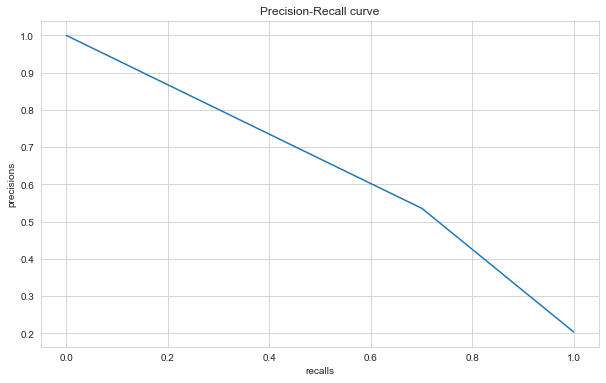

In [70]:
y_pred_proba = grid_model.predict(X_test)
precisions, recalls, thresholds = precision_recall_curve(y_test, y_pred_proba)
plt.plot(recalls, precisions, label='ANN')
plt.xlabel('recalls')
plt.ylabel('precisions')
plt.title('Precision-Recall curve')
plt.show()

In [71]:
average_precision_score(y_test, y_pred_proba)

0.4364314459866343

# Final Model and Model Deployment

In [72]:
import pickle

pickle.dump(scaler, open("scaler_churn", 'wb'))

In [75]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(16, activation="relu"))
model.add(Dense(12, activation="relu"))
model.add(Dense(8, activation="relu"))
model.add(Dense(4, activation="relu"))
model.add(Dense(1, activation="sigmoid"))

opt = Adam(lr=0.003)

model.compile(optimizer=opt,
              loss="binary_crossentropy",
              metrics=["Recall"])

model.fit(x=X_train,
          y=y_train,
          validation_data=(X_test, y_test), 
          callbacks=[early_stop],
          batch_size=128,
          epochs=230,
          verbose=1,
          class_weight=class_weights) 

Epoch 1/230
71/71 [==============================] - 1s 3ms/step - loss: 0.6912 - recall: 0.6023 - val_loss: 0.7158 - val_recall: 0.6373
Epoch 2/230
71/71 [==============================] - 0s 1ms/step - loss: 0.6573 - recall: 0.6841 - val_loss: 0.6591 - val_recall: 0.5343
Epoch 3/230
71/71 [==============================] - 0s 1ms/step - loss: 0.6159 - recall: 0.6159 - val_loss: 0.6599 - val_recall: 0.6667
Epoch 4/230
71/71 [==============================] - 0s 1ms/step - loss: 0.5840 - recall: 0.6470 - val_loss: 0.6455 - val_recall: 0.7059
Epoch 5/230
71/71 [==============================] - 0s 1ms/step - loss: 0.5671 - recall: 0.6978 - val_loss: 0.5306 - val_recall: 0.5735
Epoch 6/230
71/71 [==============================] - 0s 1ms/step - loss: 0.5467 - recall: 0.7059 - val_loss: 0.5658 - val_recall: 0.7402
Epoch 7/230
71/71 [==============================] - 0s 1ms/step - loss: 0.5150 - recall: 0.7485 - val_loss: 0.5483 - val_recall: 0.7696
Epoch 8/230
71/71 [======================

<AxesSubplot:>

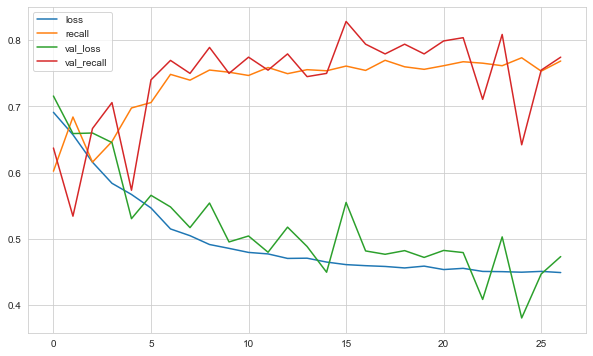

In [76]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot()

In [77]:
y_pred = (model.predict(X_test) > 0.5).astype("int32")
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

32/32 [==============================] - 0s 596us/step
[[607 189]
 [ 95 109]]
              precision    recall  f1-score   support

           0       0.86      0.76      0.81       796
           1       0.37      0.53      0.43       204

    accuracy                           0.72      1000
   macro avg       0.62      0.65      0.62      1000
weighted avg       0.76      0.72      0.73      1000



In [78]:
model.save('model_churn.h5')

## Prediction

In [79]:
single_customer = df.drop('Exited', axis=1).iloc[0]
single_customer

CreditScore            619.000
Age                     42.000
Tenure                   2.000
Balance                  0.000
NumOfProducts            1.000
HasCrCard                1.000
IsActiveMember           1.000
EstimatedSalary     101348.880
Geography_Germany        0.000
Geography_Spain          0.000
Gender_Male              0.000
Name: 1, dtype: float64

In [80]:
single_customer = scaler.transform(single_customer.values.reshape(-1, 11))
single_customer

array([[0.538     , 0.32432432, 0.2       , 0.        , 0.        ,
        1.        , 1.        , 0.50673489, 0.        , 0.        ,
        0.        ]])

In [81]:
y_pred =(model.predict(single_customer) > 0.5).astype("int32")
y_pred

1/1 [==============================] - 0s 11ms/step


array([[0]], dtype=int32)

In [82]:
df["Exited"].iloc[0]

1

___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___